In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

64


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [31]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [32]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [33]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [34]:
df.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,1205755,North America,North America,NaN,3872.0,171.0,NaN,19376.0,NaN,2070299,124899.0,739645.0,NaN,NaN
1,NaN,485681,South America,South America,NaN,533.0,30.0,NaN,11321.0,NaN,878477,40111.0,352685.0,NaN,NaN
2,NaN,858975,Europe,Europe,NaN,NaN,NaN,NaN,8766.0,NaN,2019781,173726.0,987080.0,NaN,NaN
3,NaN,413804,Asia,Asia,NaN,3558.0,63.0,NaN,13593.0,NaN,1140355,30840.0,695711.0,NaN,NaN
4,NaN,81150,Africa,Africa,NaN,189.0,NaN,NaN,344.0,NaN,148964,4245.0,63569.0,NaN,NaN


In [35]:
df.tail()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,413804,Asia,Total:,NaN,3558.0,63.0,NaN,13593.0,NaN,1140355,30840.0,695711.0,NaN,NaN
226,NaN,81150,Africa,Total:,NaN,189.0,NaN,NaN,344.0,NaN,148964,4245.0,63569.0,NaN,NaN
227,NaN,486,Australia/Oceania,Total:,NaN,7.0,NaN,NaN,3.0,NaN,8811,125.0,8200.0,NaN,NaN
228,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,306069,Europe,European Union,283.927802,0.0,0.0,NaN,4209.0,45936.441075,1204043,126419.0,731069.0,20453224.0,2704.192274


In [36]:
dfAll.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,1205755,North America,North America,NaN,3872.0,171.0,NaN,19376.0,NaN,2070299,124899.0,739645.0,NaN,NaN
1,NaN,485681,South America,South America,NaN,533.0,30.0,NaN,11321.0,NaN,878477,40111.0,352685.0,NaN,NaN
2,NaN,858975,Europe,Europe,NaN,NaN,NaN,NaN,8766.0,NaN,2019781,173726.0,987080.0,NaN,NaN
3,NaN,413804,Asia,Asia,NaN,3558.0,63.0,NaN,13593.0,NaN,1140355,30840.0,695711.0,NaN,NaN
4,NaN,81150,Africa,Africa,NaN,189.0,NaN,NaN,344.0,NaN,148964,4245.0,63569.0,NaN,NaN


In [37]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
102,96.0,369,Europe,Lithuania,26.0,0.0,0.0,"2,725,022",17.0,111140.0,1675,70.0,1236.0,302859.0,615.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


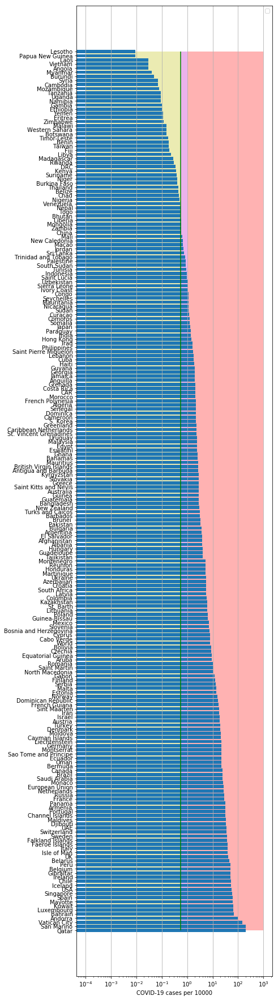

In [38]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


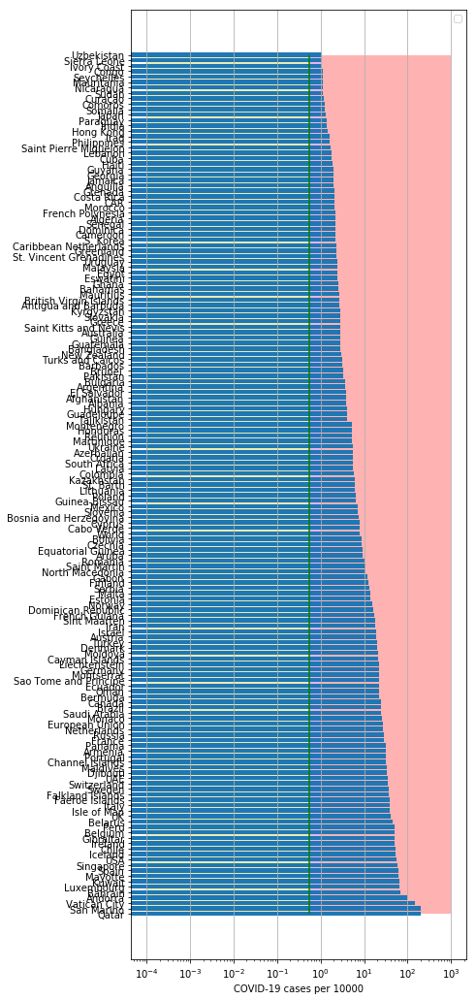

In [39]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

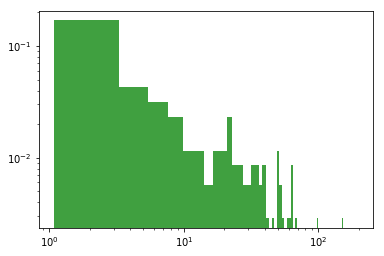

In [40]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [41]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
92 2020-05-27  283849   59773  27118.0
93 2020-05-28  284986   60909  27119.0
94 2020-05-29  285644   61565  27121.0
95 2020-05-30  286308   62225  27125.0
96 2020-05-31  286509   62424  27127.0
GB
          date   cases  active    death
91 2020-05-27  267240       0  37460.0
92 2020-05-28  269127       0  37837.0
93 2020-05-29  271222       0  38161.0
94 2020-05-30  272826       0  38376.0
95 2020-05-31  274762       0  38489.0
IT
          date   cases  active    death
94 2020-05-27  231139   50966  33072.0
95 2020-05-28  231732   47986  33142.0
96 2020-05-29  232248   46175  33229.0
97 2020-05-30  232664   43691  33340.0
98 2020-05-31  232997   42075  33415.0
LT
          date   cases  active  death     tests
79 2020-05-27  1656.0     395   68.0  287982.0
80 2020-05-28  1662.0     370   68.0  294091.0
81 2020-05-29  1670.0     362   70.0  299428.0
82 2020-05-30  1675.0     369   70.0  302859.0
83 2020-05-31  1675.0     369   70.0       NaN


82 2020-05-31  13463  3613.0  336.0
PU
          date   cases   active   death
81 2020-05-27  135905  75753.0  3983.0
82 2020-05-28  141779  78238.0  4099.0
83 2020-05-29  148285  81264.0  4230.0
84 2020-05-30  155671  84853.0  4371.0
85 2020-05-31  164476  92762.0  4506.0
SB
          date  cases  active  death
78 2020-05-27  11275  4758.0  240.0
79 2020-05-28  11300  4621.0  241.0
80 2020-05-29  11354  4588.0  242.0
81 2020-05-30  11381  4533.0  242.0
82 2020-05-31  11412  4471.0  243.0
AG
          date    cases   active  death
84 2020-05-27  13933.0   9084.0  500.0
85 2020-05-28  14702.0   9577.0  508.0
86 2020-05-29  15419.0  10111.0  520.0
87 2020-05-30  16214.0  10898.0  528.0
88 2020-05-31  16851.0  10976.0  539.0
CT
          date   cases  active  death
88 2020-05-27  2244.4    96.0  101.0
89 2020-05-28  2245.0    92.0  102.0
90 2020-05-29  2245.5    83.0  103.0
91 2020-05-30  2246.0    80.0  103.0
92 2020-05-31  2246.0    71.0  103.0
EG
          date  cases  active  death
82

In [42]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [43]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.6808322396037162
intercept: -1.6830830658778542
slope: [0.08097633]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


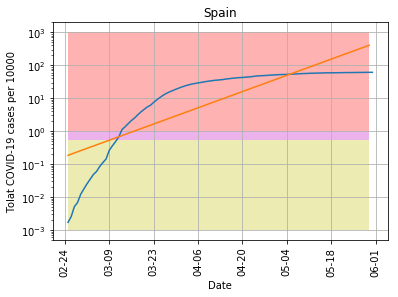

In [44]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-05-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [45]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.8113529967595524
intercept: -3.3185777157307057
slope: [0.09442852]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


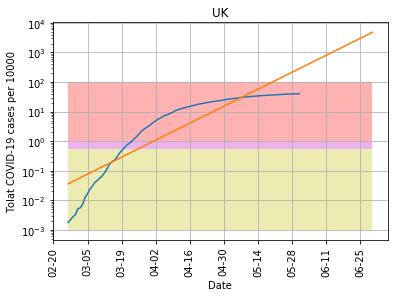

In [46]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-06-30', "pictures/coronaGB.png", model1, 'UK',100)

In [47]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9848825756764091
intercept: 1.7813602038873761
slope: [-0.04745274]


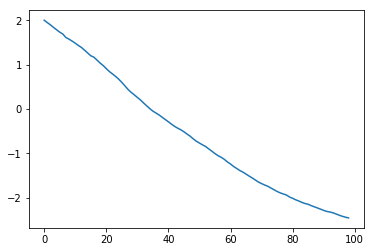

In [48]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


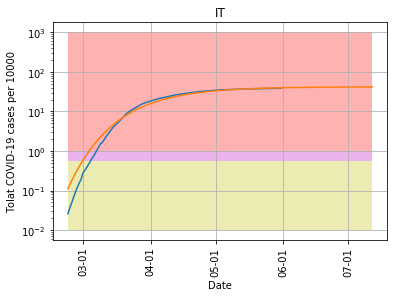

In [49]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [50]:
cs=y_pred11[-1]/10000.*populationIT

In [51]:
cs

252034.85298044243

In [52]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5945888801790363
intercept: -1.604282942107882
slope: [0.0560275]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


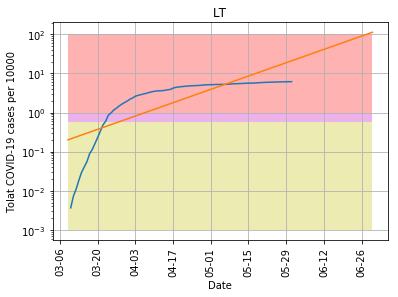

In [53]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-06-30', "pictures/coronaLT.png", model1, 'LT',100)

In [54]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.8166005107071105
intercept: -5.093924113707828
slope: [0.10334074]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


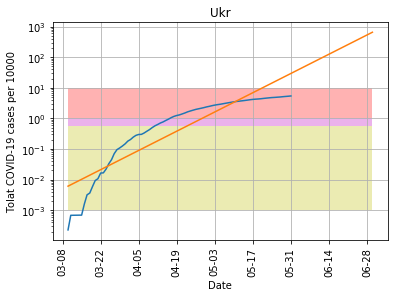

In [55]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-06-30', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


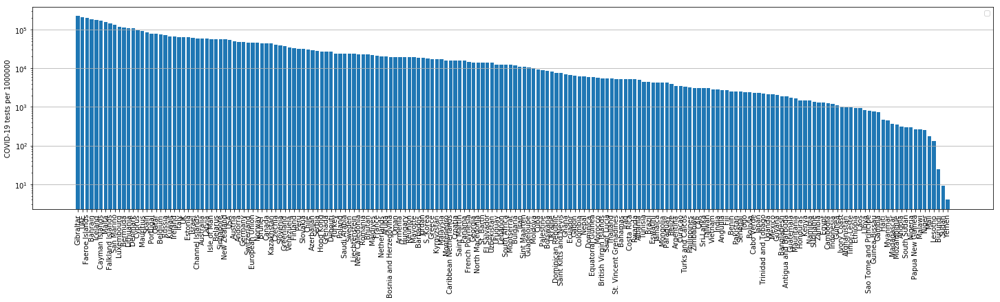

In [56]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [57]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7705419392492774
intercept: -2.7725059813421487
slope: [0.09586961]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


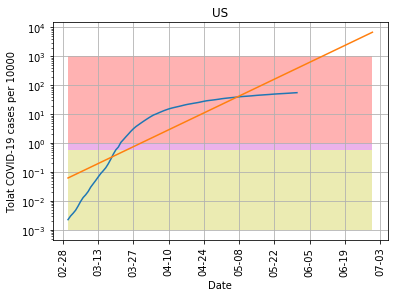

In [58]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-06-30', "pictures/coronaUS.png", model11, 'US',1000)

In [59]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.104995


(0, 0.15)

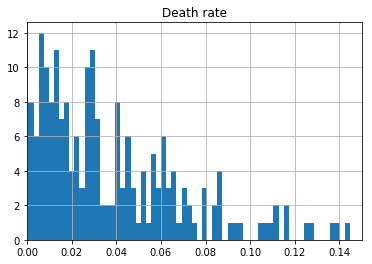

In [60]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

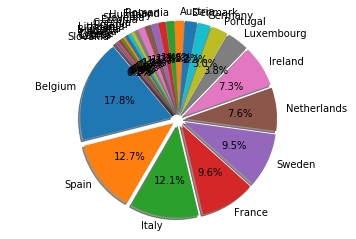

In [61]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [62]:
dfTTh.head()

,Country,Deathsper1Mpop
24,Belgium,817.0
10,Spain,580.0
12,Italy,553.0
14,France,441.0
30,Sweden,435.0


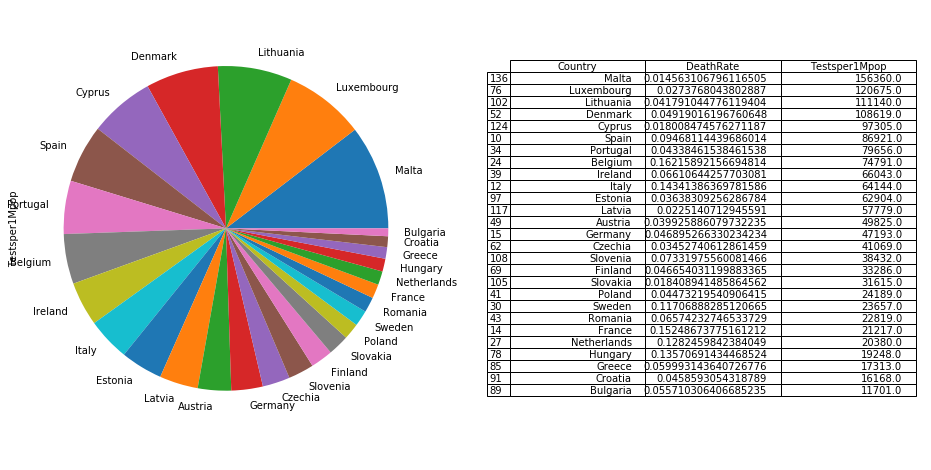

In [63]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

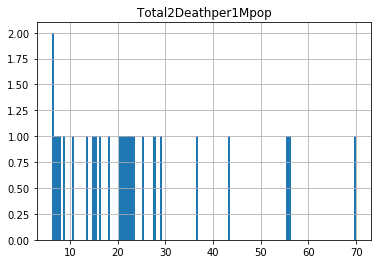

In [64]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [65]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
10,Spain,6128.0,580.0
12,Italy,3853.0,553.0
14,France,2894.0,441.0
15,Germany,2191.0,103.0
24,Belgium,5039.0,817.0


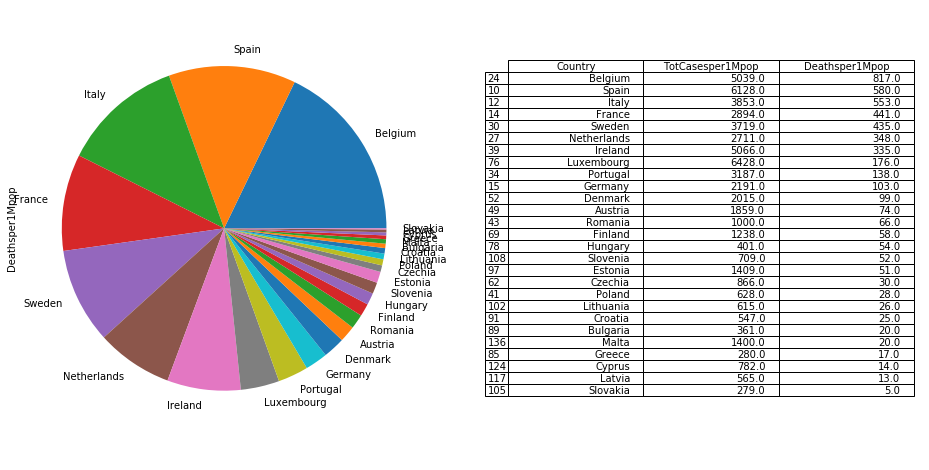

In [66]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [67]:
dfAll.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,1205755,North America,North America,0.0,3872.0,171.0,0,19376.0,0.0,2070299,124899.0,739645.0,0.0,0.0
1,0.0,485681,South America,South America,0.0,533.0,30.0,0,11321.0,0.0,878477,40111.0,352685.0,0.0,0.0
2,0.0,858975,Europe,Europe,0.0,0.0,0.0,0,8766.0,0.0,2019781,173726.0,987080.0,0.0,0.0
3,0.0,413804,Asia,Asia,0.0,3558.0,63.0,0,13593.0,0.0,1140355,30840.0,695711.0,0.0,0.0
4,0.0,81150,Africa,Africa,0.0,189.0,0.0,0,344.0,0.0,148964,4245.0,63569.0,0.0,0.0


In [68]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
10,Spain,0.070501
12,Italy,0.060068
14,France,0.136400
15,Germany,0.046426
24,Belgium,0.067374


In [69]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.157205
      France             0.136400
 Netherlands             0.133023
     Ireland             0.076708
       Spain             0.070501
     Belgium             0.067374
       Italy             0.060068
  Luxembourg             0.053267
     Germany             0.046426
     Romania             0.043823
    Portugal             0.040010
     Austria             0.037311
     Finland             0.037193
     Croatia             0.033832
    Bulgaria             0.030852
      Poland             0.025962
     Estonia             0.022399
     Czechia             0.021086
     Hungary             0.020833
     Denmark             0.018551
    Slovenia             0.018448
      Greece             0.016173
      Latvia             0.009779
       Malta             0.008954
    Slovakia             0.008825
      Cyprus             0.008037
   Lithuania             0.005534


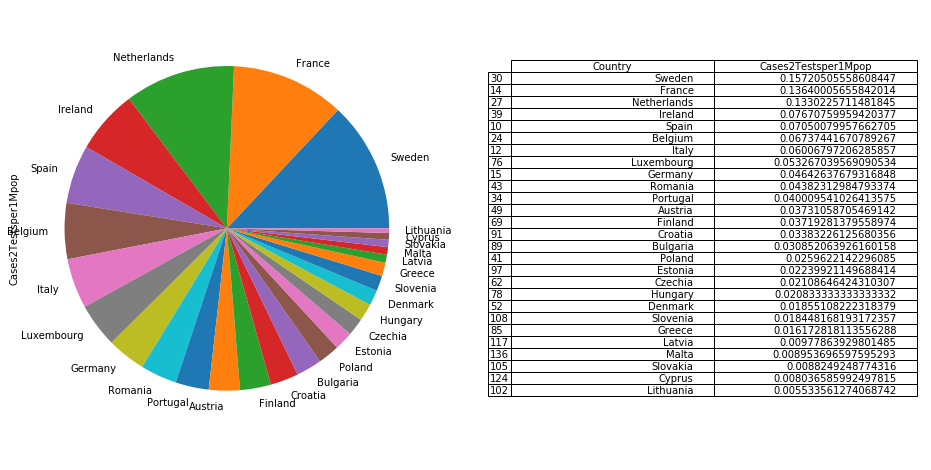

In [70]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [71]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
31,Singapore,0.000659,57246.000000
25,Qatar,0.000668,77194.000000
56,Bahrain,0.001667,185651.000000
120,CAR,0.001978,3115.000000
142,French Guiana,0.002004,0.000000
144,Réunion,0.002123,19223.000000
150,Rwanda,0.002703,5183.000000
100,Maldives,0.002820,21818.000000
57,Kazakhstan,0.003626,44162.000000
115,Hong Kong,0.003687,27087.000000


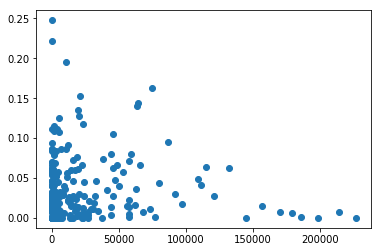

In [72]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


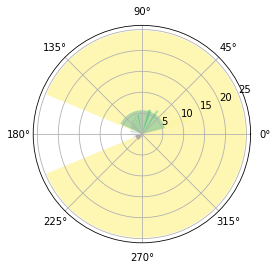

In [73]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

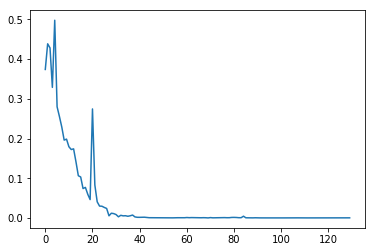

In [74]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [75]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


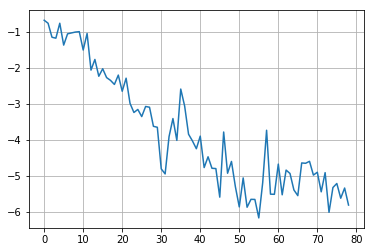

In [76]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

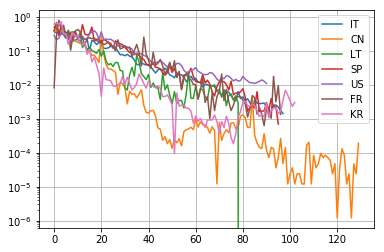

In [77]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

91 91
coefficient of determination: 0.873128147007894
intercept: -8.876992119979738
slope: [-0.13556523]


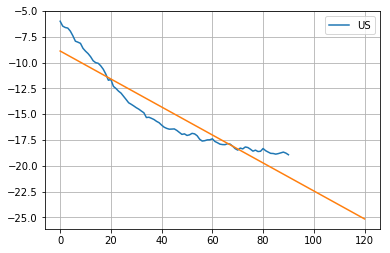

In [78]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

98 98
coefficient of determination: 0.9092946729932391
intercept: -9.609322670296049
slope: [-0.1079036]


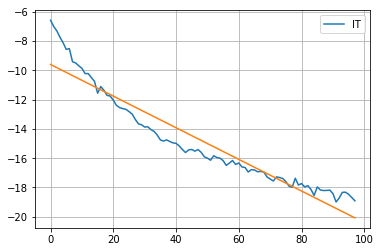

In [79]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [80]:
#model11.coef_

In [81]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

80 80
coefficient of determination: 0.9283049199408318
intercept: -14.944806616895256
slope: [-0.06980607]


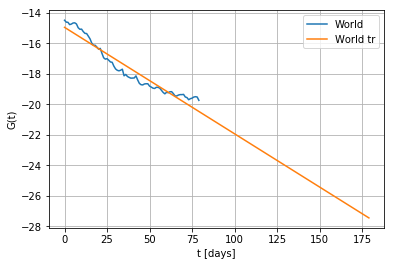

In [82]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

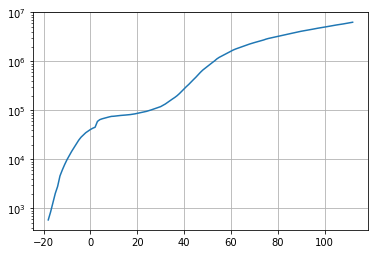

In [83]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [84]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 8.94478759e+06  2.55788483e+00 -7.18398389e+01  1.14027672e-02]


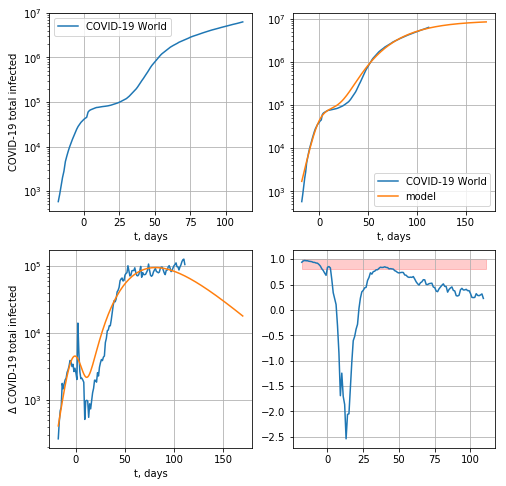

80422.11892768406


In [85]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

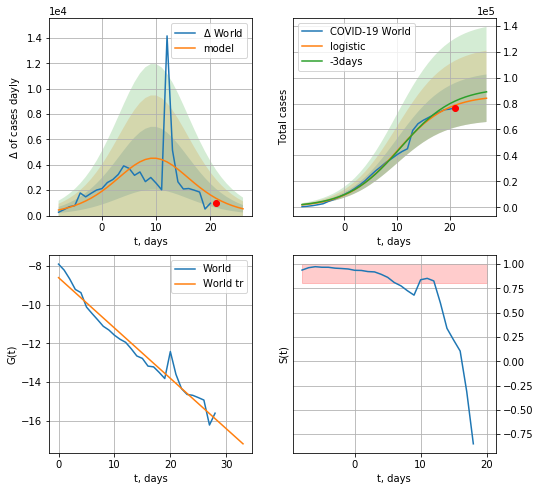

World data at: 2020-05-31
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +6 days
	 deltaDaycases:  535
	 total cases:  84097 ± 18317
	 total death:  5017 ± 3278
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


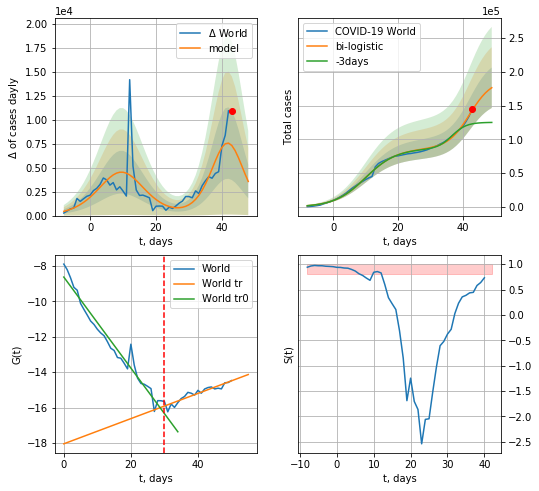

World data at: 2020-05-31
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +6 days
	 deltaDaycases:  3553
	 total cases:  176486 ± 29990
	 total death:  10530 ± 5368
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


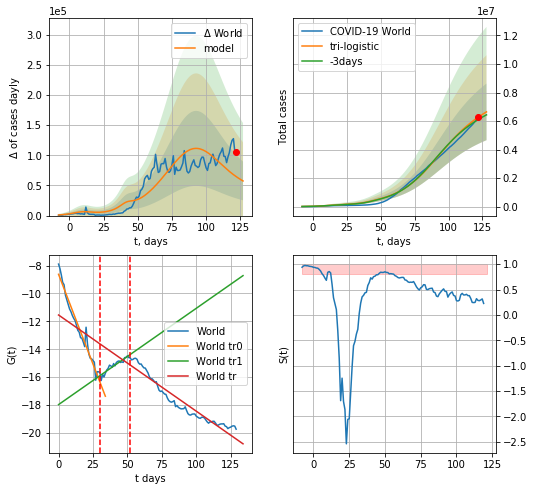

World data at: 2020-05-31
+3 day model MAPE: 0.02810224077546196
model: tri-logistic
coeffs:  [6.44242735e+06 6.62257211e-02 9.18701461e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.29891526788961803
forecast at the end of period: +6 days
	 deltaDaycases:  57433
	 total cases:  6644364 ± 1986101
	 total death:  396453 ± 355517
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.923181
 intercept: -11.546244
 slope: -0.068917


In [86]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*10-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

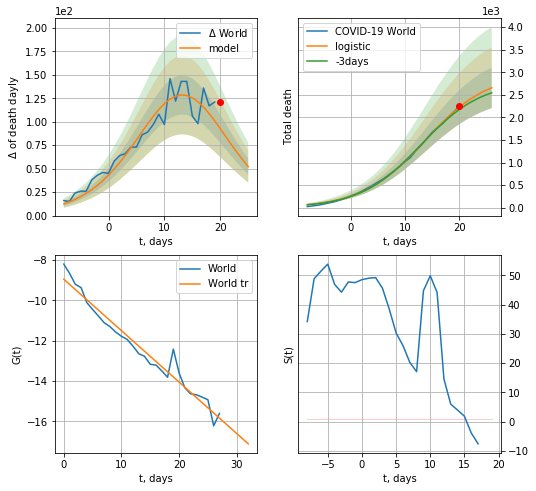

World data at: 2020-05-31
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +6 days
	 total death:  2655 ± 449
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


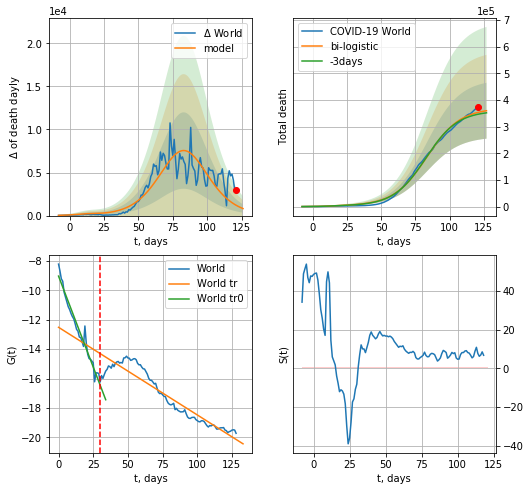

World data at: 2020-05-31
+3 day model MAPE: 0.020374076622019684
model: bi-logistic
coeffs:  [3.66731698e+05 8.24142602e-02 8.33692899e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.29140265341511906
forecast at the end of period: +6 days
	 deltaDaydeath:  817
	 total death:  359907 ± 104877
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.892327
 intercept: -12.512293
 slope: -0.059658


In [87]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*10-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [88]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


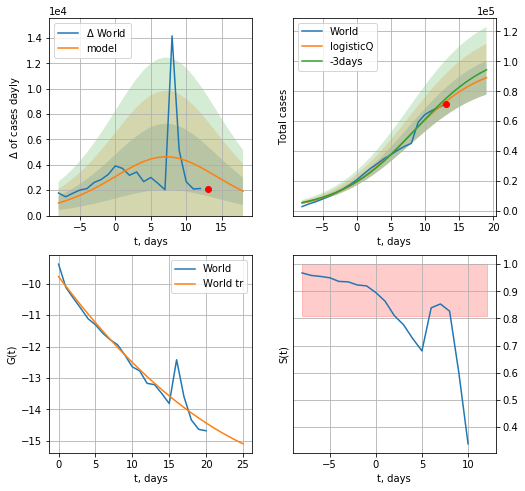

World data at: 2020-05-31
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +6 days
	 deltaDaycases: 1923
	 total cases: 89102 ± 11312
	 total death: 5316 ± 2024
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


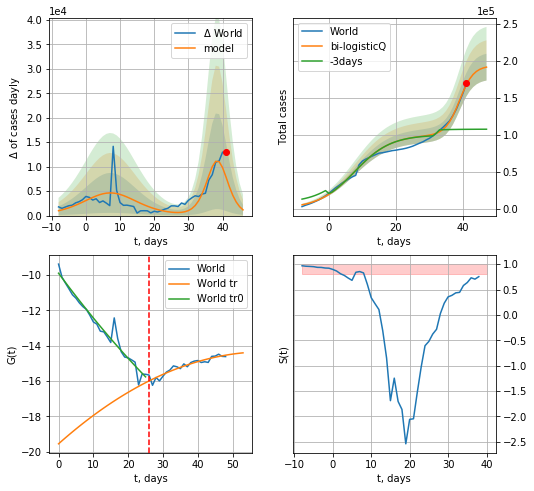

World data at: 2020-05-31
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +6 days
	 deltaDaycases: 1172
	 total cases: 191605 ± 18144
	 total death: 11432 ± 3247
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


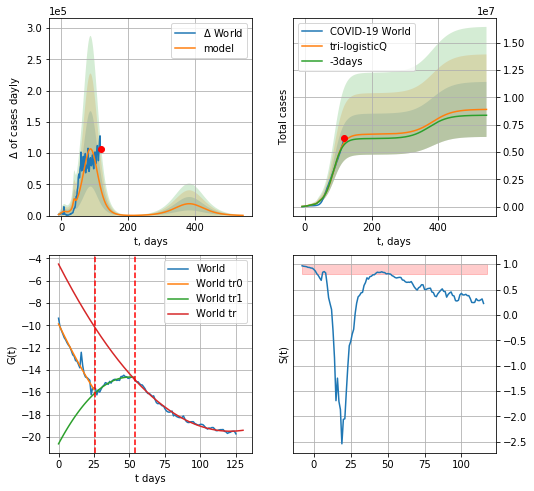

World data at: 2020-05-31
+3 day model MAPE: 0.035986
model: tri-logisticQ
coeffs: [ 6.42505030e+06  4.73890321e-07  8.78305948e+01 -1.40202486e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.283008
forecast at the end of period: +426 days
	 deltaDaycases: 350
	 total cases: 8883887 ± 2514215
	 total death: 530079 ± 450050
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.992167
 intercept_: -4.526598674462239
 coeffs_: [ 0.         -0.24753982  0.00102348]


In [89]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*10-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

131


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


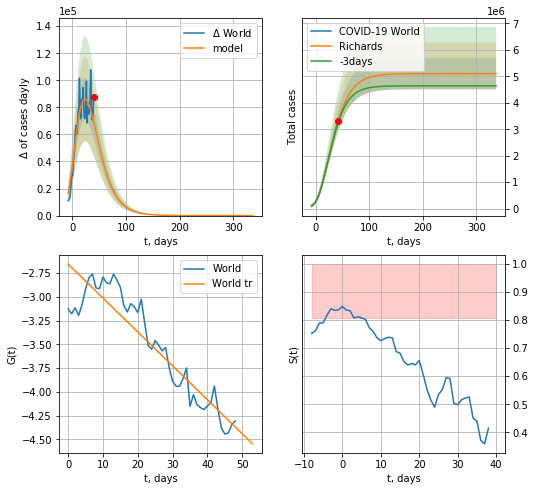

World data at: 2020-05-31
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +296 days
	 deltaDaycases: 0
	 total cases: 5102541 ± 589489
	 total death: 304456 ± 105520
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


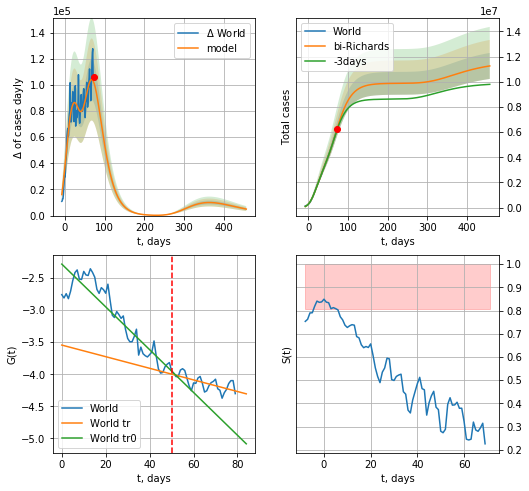

World data at: 2020-05-31
+3 day model MAPE: 0.013835
model: bi-Richards
coeffs: [ 4.77840331e+06  3.25458257e+00 -1.87994534e+01  1.41521786e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.091814
forecast at the end of period: +386 days
	 deltaDaycases: 4981
	 total cases: 11258933 ± 1033730
	 total death: 671793 ± 185040
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.840238
 intercept: -2.282486
 slope: -0.033348
trend coefficient of determination: 0.433791
 intercept: -3.544461
 slope: -0.009051


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


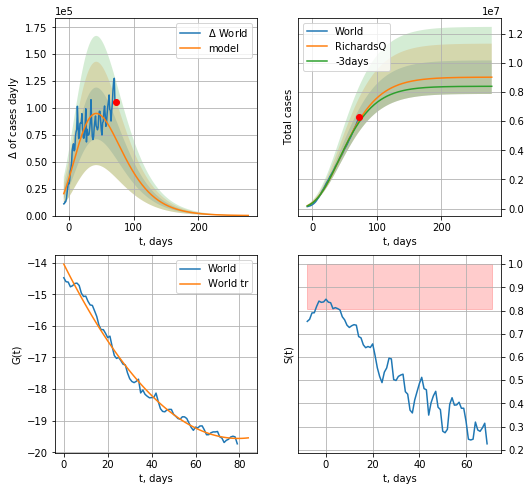

World data at: 2020-05-31
+3 day model MAPE: 0.020296
model: RichardsQ
coeffs: [ 9.02347348e+06  4.56440510e-03 -1.84018967e+02 -1.22576926e+03
  4.20595091e-03]
rational stdev: 0.127593
forecast at the end of period: +206 days
	 deltaDaycases: 132
	 total cases: 9020015 ± 1150891
	 total death: 538202 ± 206012
trend coefficient of determination: 0.990543
 intercept_: -14.046596519631573
 coeffs_: [ 0.         -0.13890579  0.00087472]


In [90]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


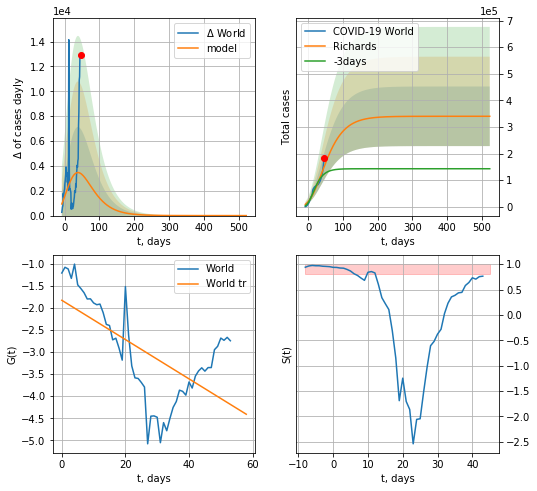

World data at: 2020-05-31
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +476 days
	 deltaDaycases: 0
	 total cases: 340077 ± 111979
	 total death: 20291 ± 20044
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


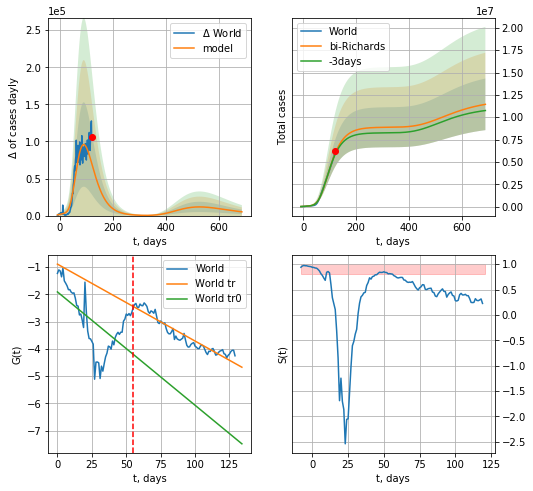

World data at: 2020-05-31
+3 day model MAPE: 0.021728
model: bi-Richards
coeffs: [ 8.54473724e+06  2.70239879e+00 -5.73816418e+01  1.11402844e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.252374
forecast at the end of period: +566 days
	 deltaDaycases: 5065
	 total cases: 11440477 ± 2887283
	 total death: 682625 ± 516831
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.357381
 intercept: -1.913254
 slope: -0.041557
trend coefficient of determination: 0.901074
 intercept: -0.894025
 slope: -0.028208


In [92]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,70*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


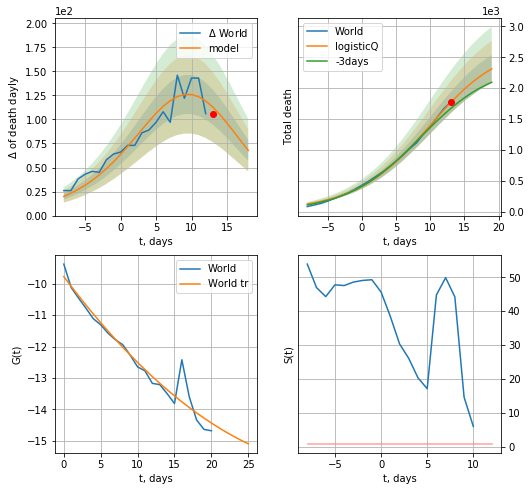

World data at: 2020-05-31
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +6 days
	 total death: 2313 ± 226
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


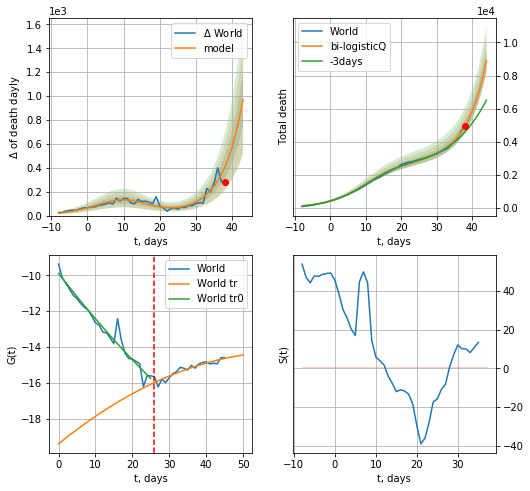

World data at: 2020-05-31
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +6 days
	 total death: 8895 ± 681
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


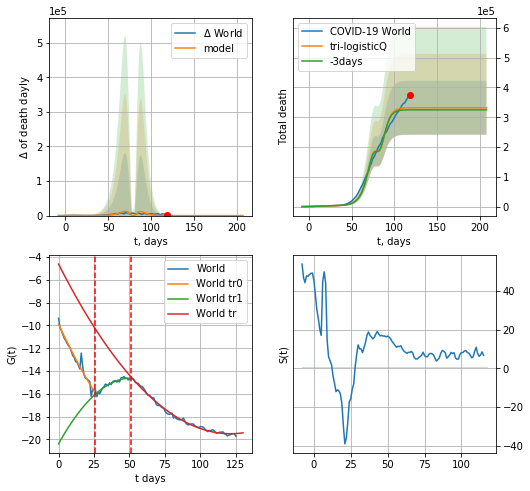

World data at: 2020-05-31
+3 day model MAPE: 0.021434
model: tri-logisticQ
coeffs: [-6.09277502e+06  5.31922855e-04 -3.56685163e+02  7.96175385e+01]
rational stdev: 0.272583
forecast at the end of period: +90 days
	 total death: 331936 ± 90480
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.993462
 intercept_: -4.613201879627054
 coeffs_: [ 0.         -0.2456561   0.00101362]


In [93]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*10-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


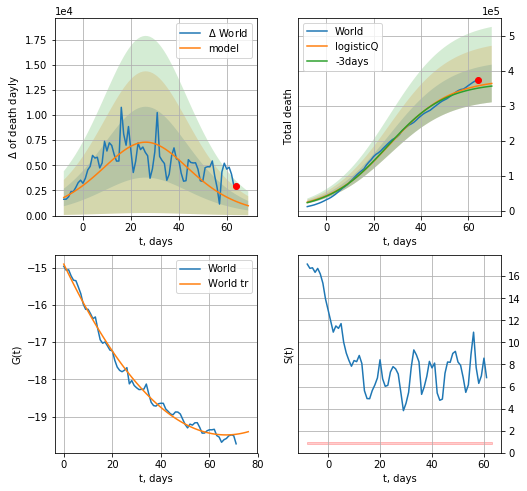

World data at: 2020-05-31
+3 day model MAPE: 0.018990
model: logisticQ
coeffs: [ 3.76412396e+05  1.04568006e-06  2.66669021e+01 -7.41489498e+04]
rational stdev: 0.148333
forecast at the end of period: +6 days
	 total death: 363813 ± 53965
trend coefficient of determination: 0.992169
 intercept_: -14.906483816820932
 coeffs_: [ 0.         -0.13723586  0.0010267 ]


In [94]:
x = forecastRRR("World",dfW[58:],d1,7*10-dT,1.0,False,cases='death')

In [95]:
#trend(dfSP,'SP',10)

In [96]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
          date   cases  active    death
92 2020-05-27  283849   59773  27118.0
93 2020-05-28  284986   60909  27119.0
94 2020-05-29  285644   61565  27121.0
95 2020-05-30  286308   62225  27125.0
96 2020-05-31  286509   62424  27127.0


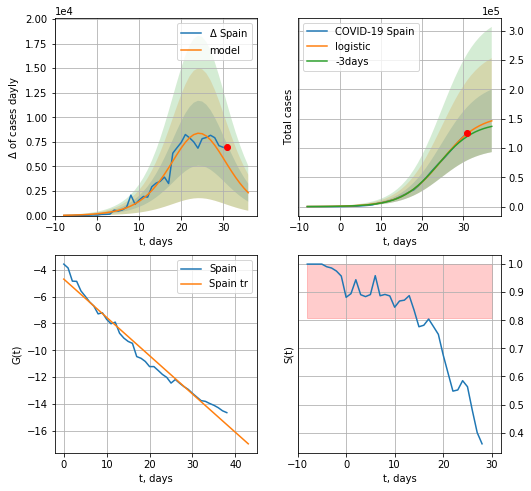

Spain data at: 2020-05-31
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +6 days
	 deltaDaycases:  2326
	 total cases:  146319 ± 53390
	 total death:  13853 ± 15164
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


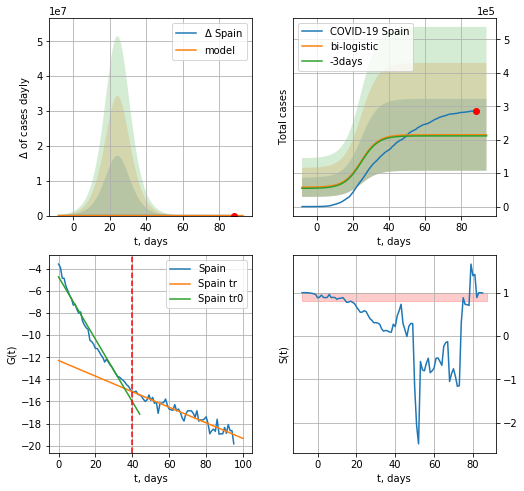

Spain data at: 2020-05-31
+3 day model MAPE: 0.015631096331126568
model: bi-logistic
coeffs:  [ 4.63110623e+04 -4.49128813e+00  1.20653321e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.5006893568405582
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  214846 ± 107571
	 total death:  20341 ± 30553
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.895900
 intercept: -12.300149
 slope: -0.070414


In [97]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*10-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*10-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

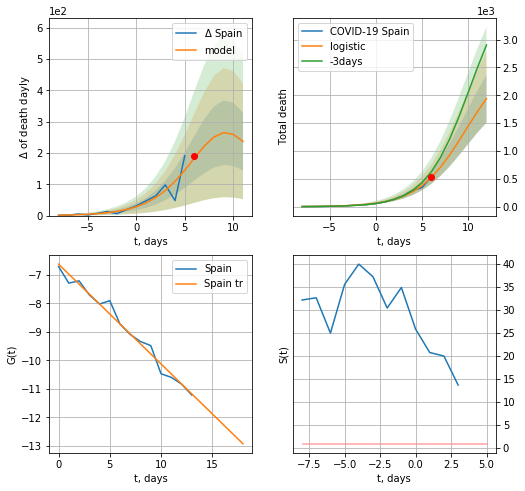

Spain data at: 2020-05-31
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +6 days
	 total death:  1939 ± 429
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


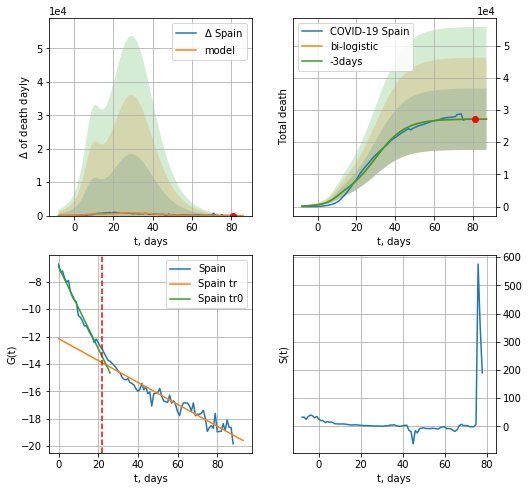

Spain data at: 2020-05-31
+3 day model MAPE: 1.1428162843867325e-05
model: bi-logistic
coeffs:  [2.44133104e+04 1.29451726e-01 2.96906287e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3517733451744432
forecast at the end of period: +6 days
	 deltaDaydeath:  2
	 total death:  27143 ± 9548
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.926834
 intercept: -12.147484
 slope: -0.079957


In [98]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*10-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*10-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


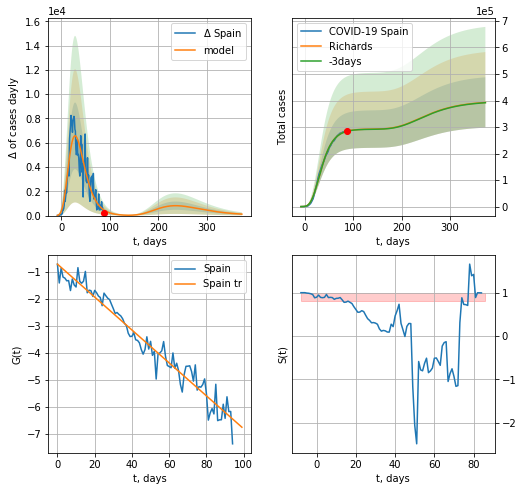

Spain data at: 2020-05-31
+3 day model MAPE: 0.001846
model: Richards
coeffs: [ 2.92468453e+05  8.12223381e+00 -5.08694765e+01  7.54641690e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.241796
forecast at the end of period: +286 days
	 deltaDaycases: 119
	 total cases: 392635 ± 94937
	 total death: 37175 ± 26966
trend coefficient of determination: 0.955504
 intercept: -0.714652
 slope: -0.060898


In [99]:
x = forecastRR('Spain',dfSP[1:],d1,7*50-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


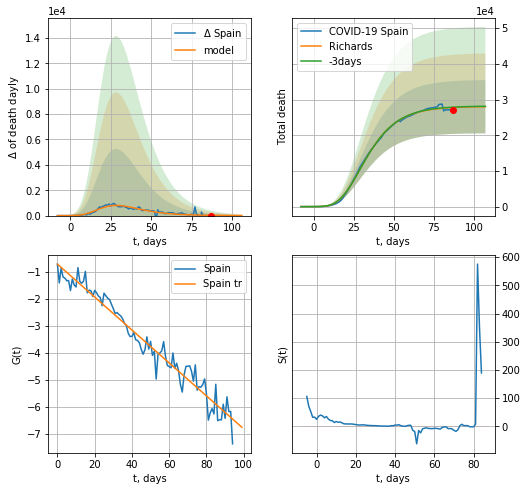

Spain data at: 2020-05-31
+3 day model MAPE: 0.003967
model: Richards
coeffs: [ 2.80581825e+04  9.73492076e+00 -3.30601565e+01  8.02349011e-03]
rational stdev: 0.266372
forecast at the end of period: +20 days
	 total death: 27996 ± 7457
trend coefficient of determination: 0.955584
 intercept: -0.718141
 slope: -0.060933


In [100]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


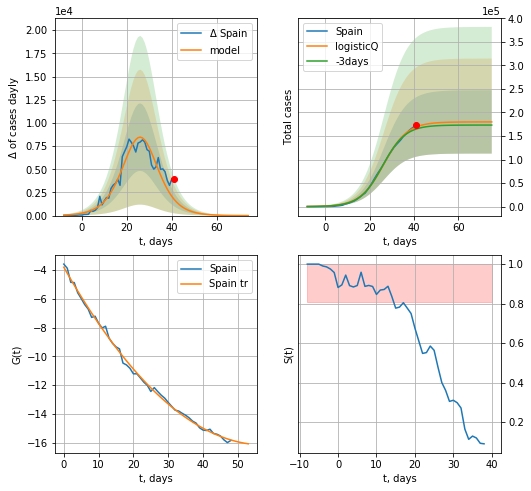

Spain data at: 2020-05-31
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +34 days
	 deltaDaycases: 3
	 total cases: 179925 ± 67278
	 total death: 17035 ± 19109
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


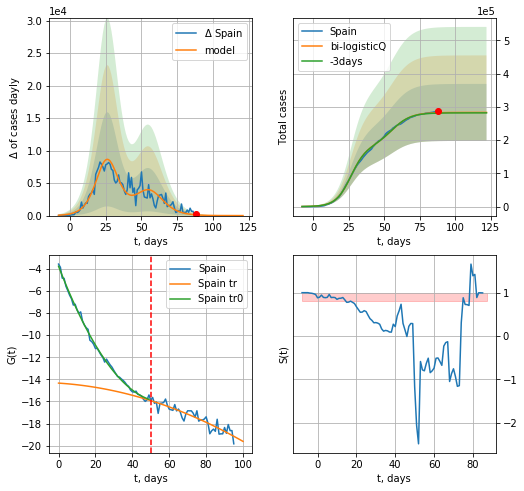

Spain data at: 2020-05-31
+3 day model MAPE: 0.004372
model: bi-logisticQ
coeffs: [ 1.03475882e+05  8.16323957e-07  5.55988325e+01 -1.82071625e+05]
rational stdev: 0.302693
forecast at the end of period: +34 days
	 deltaDaycases: 0
	 total cases: 283414 ± 85787
	 total death: 26834 ± 24367
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.842316
 intercept_: -14.34134037545634
 coeffs_: [ 0.         -0.01068955 -0.00041985]


In [101]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


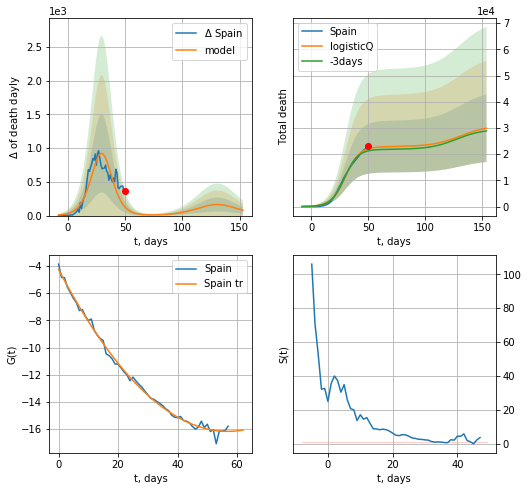

Spain data at: 2020-05-31
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +104 days
	 total death: 29902 ± 12882
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide


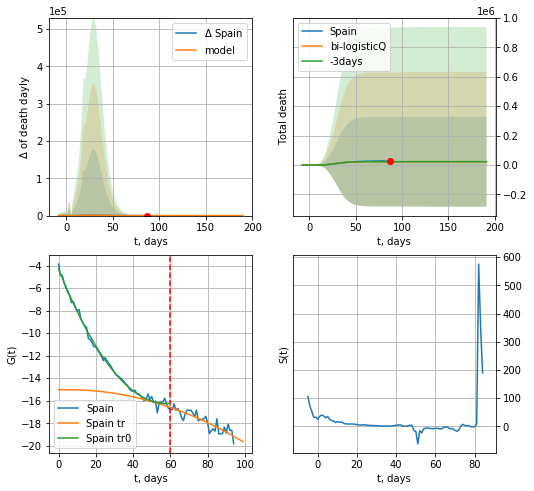

Spain data at: 2020-05-31
+3 day model MAPE: 0.000001
model: bi-logisticQ
coeffs: [-6.82069474e+02 -6.31404589e-02  1.88965634e+01  4.23404306e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 13.335846
forecast at the end of period: +104 days
	 total death: 22879 ± 305121
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.762118
 intercept_: -15.039931910981707
 coeffs_: [ 0.          0.00549847 -0.00052424]


In [102]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


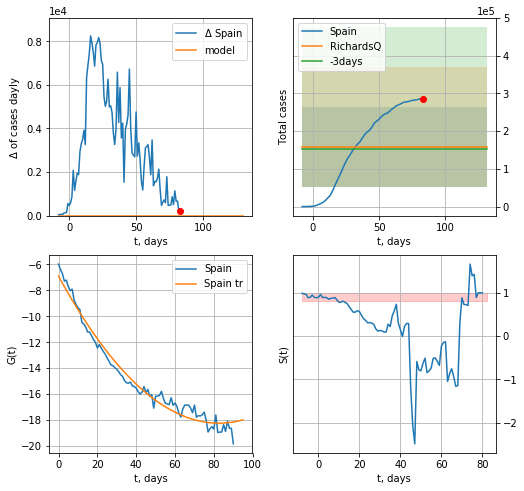

Spain data at: 2020-05-31
+3 day model MAPE: 0.028273
model: RichardsQ
coeffs: [ 1.57598543e+05 -2.38588832e+00 -2.54362985e+01 -9.58929549e+01
 -2.00899544e-01]
rational stdev: 0.674408
forecast at the end of period: +48 days
	 deltaDaycases: 0
	 total cases: 157598 ± 106285
	 total death: 14921 ± 30188
trend coefficient of determination: 0.973628
 intercept_: -6.90453302545587
 coeffs_: [ 0.         -0.27452655  0.00166261]


In [103]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

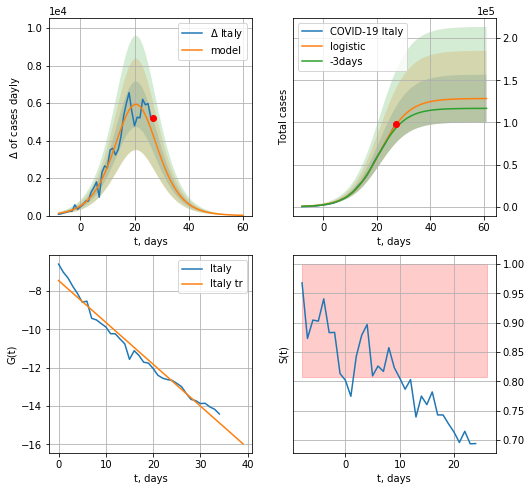

Italy data at: 2020-05-31
+3 day model MAPE: 0.04536229058229775
model: logistic
coeffs:  [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.22074329651570546
forecast at the end of period: +34 days
	 deltaDaycases:  15
	 total cases:  128366 ± 28335
	 total death:  18409 ± 12190
trend coefficient of determination: 0.974900
 intercept: -7.448538
 slope: -0.218710


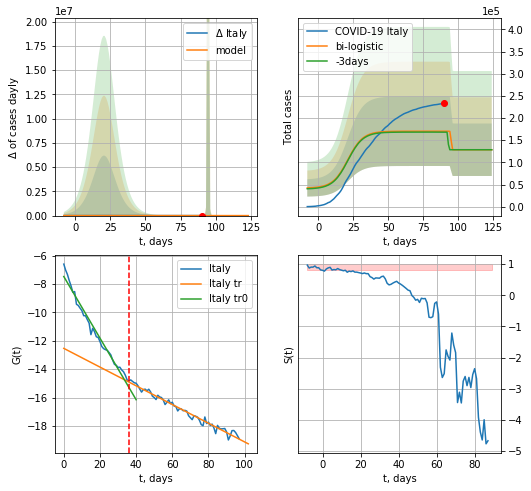

Italy data at: 2020-05-31
+3 day model MAPE: 0.01159440171877467
model: bi-logistic
coeffs:  [ 4.17726813e+04 -4.71924049e+00  9.49791426e+01] [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.4608876650881427
forecast at the end of period: +34 days
	 deltaDaycases:  0
	 total cases:  128444 ± 59198
	 total death:  18420 ± 25468
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975991
 intercept: -7.466382
 slope: -0.217136
trend coefficient of determination: 0.974374
 intercept: -12.531928
 slope: -0.065975


In [104]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,14*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,14*7-dT,x,1.0,vL=vL)

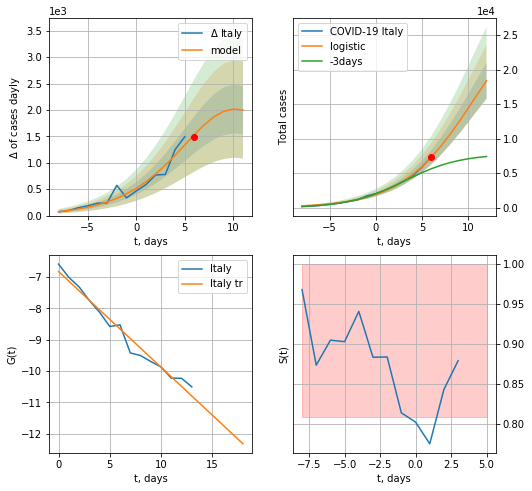

Italy data at: 2020-05-31
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +6 days
	 deltaDaycases:  1996
	 total cases:  18391 ± 2599
	 total death:  2637 ± 1117
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


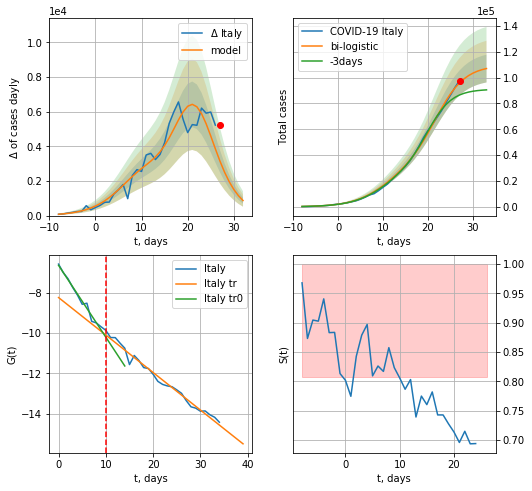

Italy data at: 2020-05-31
+3 day model MAPE: 0.12719416413980916
model: bi-logistic
coeffs:  [7.80633996e+04 3.07326084e-01 2.18190350e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.10039113205484494
forecast at the end of period: +6 days
	 deltaDaycases:  868
	 total cases:  107037 ± 10745
	 total death:  15350 ± 4623
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


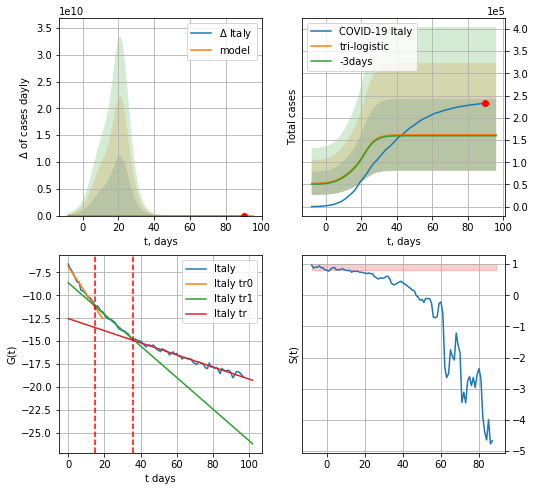

Italy data at: 2020-05-31
+3 day model MAPE: 0.013839379366151393
model: tri-logistic
coeffs:  [ 5.23374531e+04 -3.86188395e+00  1.04902067e+02] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.80633996e+04
 3.07326084e-01 2.18190350e+01]
forecast rational stdev:  0.4998153269506133
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  161911 ± 80925
	 total death:  23220 ± 34817
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.980760
 intercept: -8.621359
 slope: -0.172242
trend coefficient of determination: 0.974374
 intercept: -12.531928
 slope: -0.065975


In [105]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*10-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*10-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

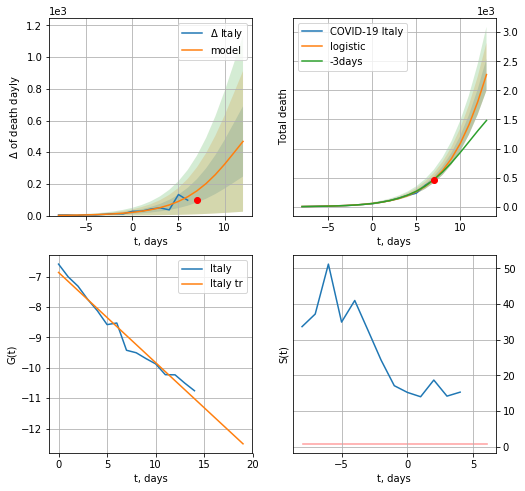

Italy data at: 2020-05-31
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +6 days
	 total death:  2271 ± 272
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


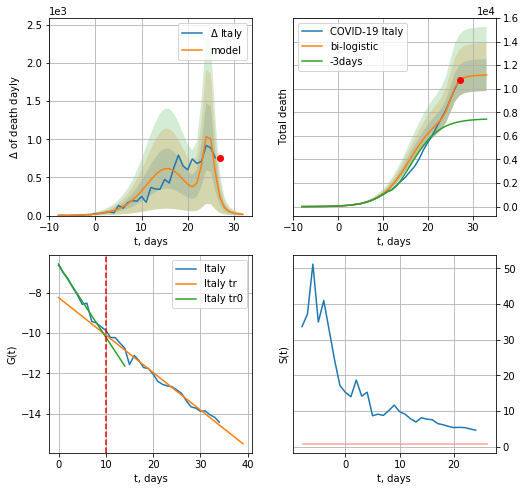

Italy data at: 2020-05-31
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +6 days
	 deltaDaydeath:  15
	 total death:  11169 ± 1360
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


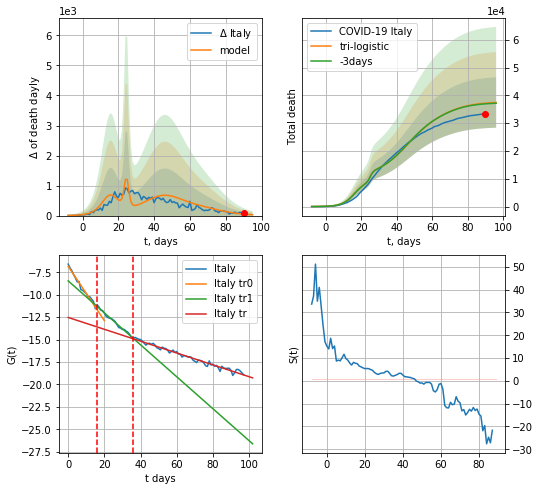

Italy data at: 2020-05-31
+3 day model MAPE: 0.0067716587068948255
model: tri-logistic
coeffs:  [2.11555197e+04 1.20984065e-01 4.56395868e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.24198820878403823
forecast at the end of period: +6 days
	 deltaDaydeath:  28
	 total death:  37425 ± 9056
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.974374
 intercept: -12.531928
 slope: -0.065975


In [106]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*10-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*10-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


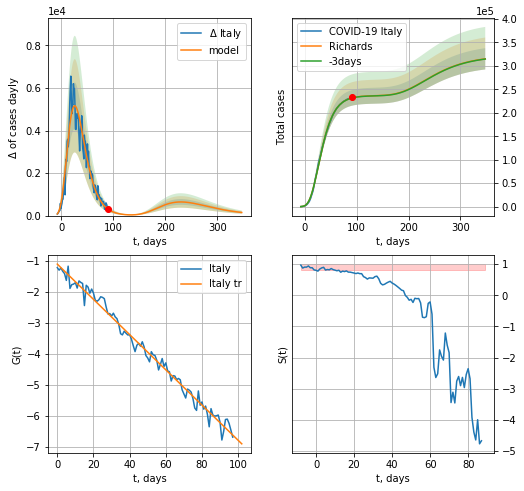

Italy data at: 2020-05-31
+3 day model MAPE: 0.001084
model: Richards
coeffs: [ 2.36754682e+05  5.80117753e+00 -5.07906817e+01  1.02726831e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.071938
forecast at the end of period: +258 days
	 deltaDaycases: 146
	 total cases: 315103 ± 22667
	 total death: 45190 ± 9752
trend coefficient of determination: 0.985934
 intercept: -1.099054
 slope: -0.056789


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


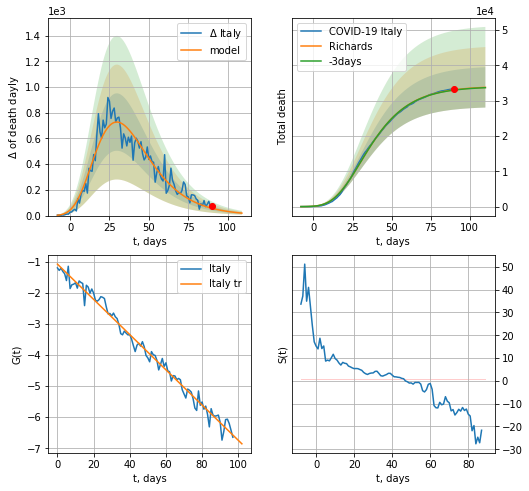

Italy data at: 2020-05-31
+3 day model MAPE: 0.002287
model: Richards
coeffs: [ 3.40685053e+04  7.54004661e+00 -5.32229032e+01  7.73450267e-03]
rational stdev: 0.169026
forecast at the end of period: +20 days
	 total death: 33746 ± 5704
trend coefficient of determination: 0.985825
 intercept: -1.077230
 slope: -0.056658


In [107]:
x = forecastRR('Italy',dfIT[:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


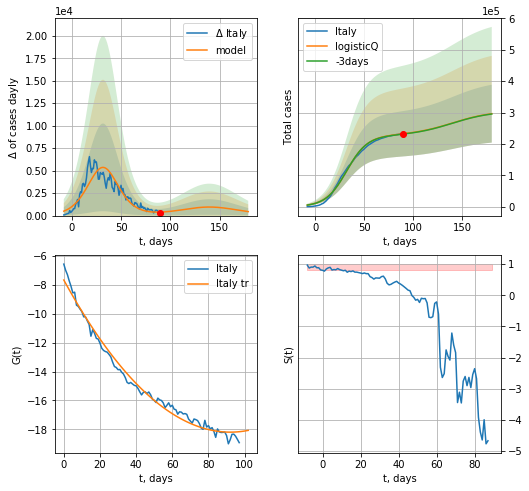

Italy data at: 2020-05-31
+3 day model MAPE: 0.004460
model: logisticQ
coeffs: [ 2.26693737e+05  4.06841700e-07  3.21441070e+01 -2.31525187e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311075
forecast at the end of period: +90 days
	 deltaDaycases: 441
	 total cases: 296452 ± 92218
	 total death: 42515 ± 39676
trend coefficient of determination: 0.985978
 intercept_: -7.687780128625569
 coeffs_: [ 0.         -0.22800591  0.0012382 ]


In [108]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


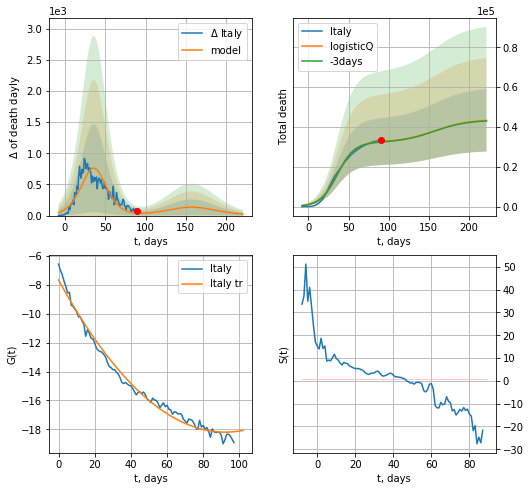

Italy data at: 2020-05-31
+3 day model MAPE: 0.006652
model: logisticQ
coeffs: [ 3.23439342e+04  4.04417138e-07  3.61270582e+01 -2.32522113e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361452
forecast at the end of period: +132 days
	 total death: 43282 ± 15644
trend coefficient of determination: 0.985978
 intercept_: -7.687780128625569
 coeffs_: [ 0.         -0.22800591  0.0012382 ]


In [109]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [110]:
dT

64

FR
           date     cases  active    death
102 2020-05-27  182913.0   87733  28596.0
103 2020-05-28  186238.0   90385  28662.0
104 2020-05-29  186835.0   90318  28714.0
105 2020-05-30  188625.0   91586  28771.0
106 2020-05-31  188882.0   91725  28802.0


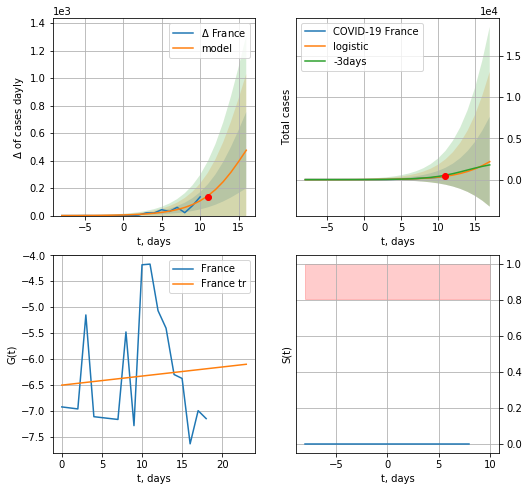

France data at: 2020-05-31
+3 day model MAPE: 0.23575809672955655
model: logistic
coeffs:  [8.54680047e+03 3.19224428e-01 2.03751890e+01]
rational stdev:  2.5037018951863894
forecast at the end of period: +6 days
	 deltaDaycases:  475
	 total cases:  2170 ± 5435
	 total death:  331 ± 2486
trend coefficient of determination: 0.008192
 intercept: -6.507496
 slope: 0.017520


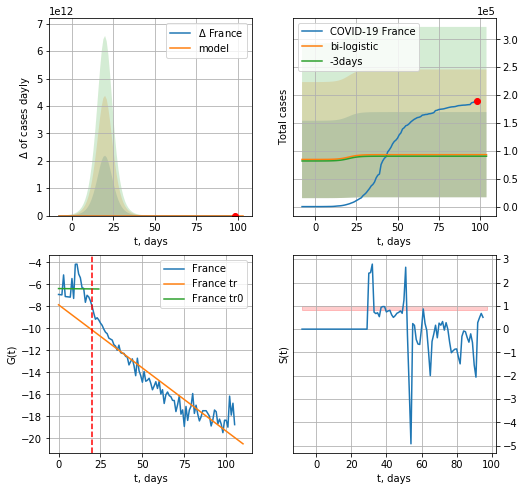

France data at: 2020-05-31
+3 day model MAPE: 0.030337847275076404
model: bi-logistic
coeffs:  [ 8.45446186e+04 -5.61472438e+00  1.46652409e+02] [8.54680047e+03 3.19224428e-01 2.03751890e+01]
rational stdev:  0.8201134533343774
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  93091 ± 76345
	 total death:  14195 ± 34924
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.000072
 intercept: -6.392996
 slope: -0.001563
trend coefficient of determination: 0.889273
 intercept: -7.864083
 slope: -0.114797


In [111]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,10*7-dT,1.0)
xx = forecast2('France',dfFR,d1,10*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [112]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

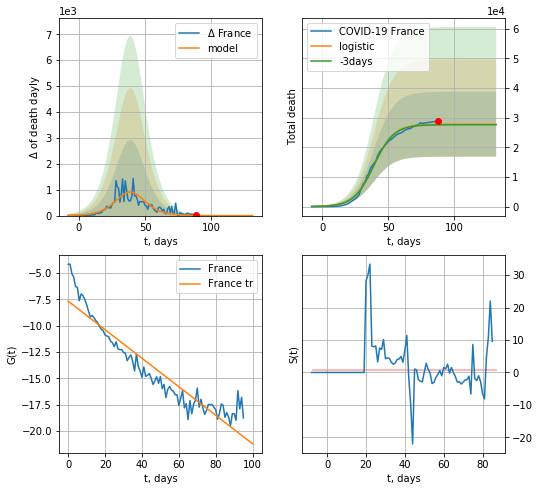

France data at: 2020-05-31
+3 day model MAPE: 0.006041362850668099
model: logistic
coeffs:  [2.77783731e+04 1.31188693e-01 3.92884692e+01]
rational stdev:  0.39388306594507616
forecast at the end of period: +44 days
	 total death:  27778 ± 10941
trend coefficient of determination: 0.887256
 intercept: -7.682539
 slope: -0.135228


In [113]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


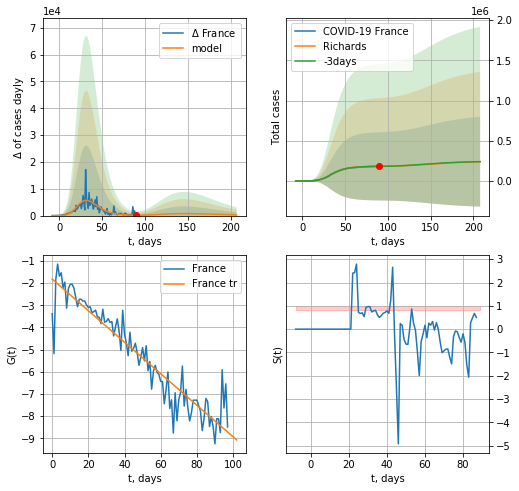

France data at: 2020-05-31
+3 day model MAPE: 0.004946
model: Richards
coeffs: [1.82895508e+05 5.85171517e-01 1.16110602e+01 1.55469780e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 2.326264
forecast at the end of period: +118 days
	 deltaDaycases: 264
	 total cases: 240132 ± 558610
	 total death: 36616 ± 255535
trend coefficient of determination: 0.880272
 intercept: -1.821962
 slope: -0.071085


In [115]:
x = forecastRR('France',dfFR[8:],d1,26*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


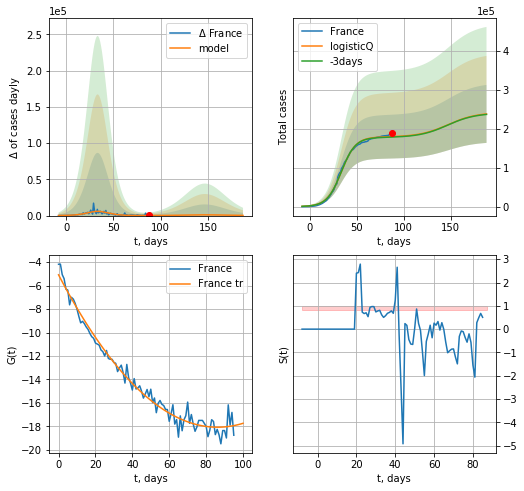

France data at: 2020-05-31
+3 day model MAPE: 0.006985
model: logisticQ
coeffs: [ 1.78652063e+05  7.44189415e-07  3.37539222e+01 -1.76329923e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312869
forecast at the end of period: +100 days
	 deltaDaycases: 253
	 total cases: 237937 ± 74443
	 total death: 36282 ± 34054
trend coefficient of determination: 0.978252
 intercept_: -5.08277540590046
 coeffs_: [ 0.         -0.30117889  0.00174689]


In [116]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


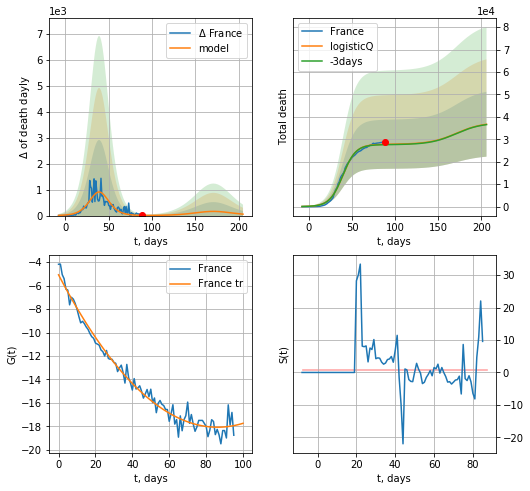

France data at: 2020-05-31
+3 day model MAPE: 0.006096
model: logisticQ
coeffs: [ 2.77781250e+04  6.00036866e-07  3.92889011e+01 -2.18533763e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393963
forecast at the end of period: +118 days
	 total death: 36714 ± 14464
trend coefficient of determination: 0.978252
 intercept_: -5.08277540590046
 coeffs_: [ 0.         -0.30117889  0.00174689]


In [117]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [118]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [119]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


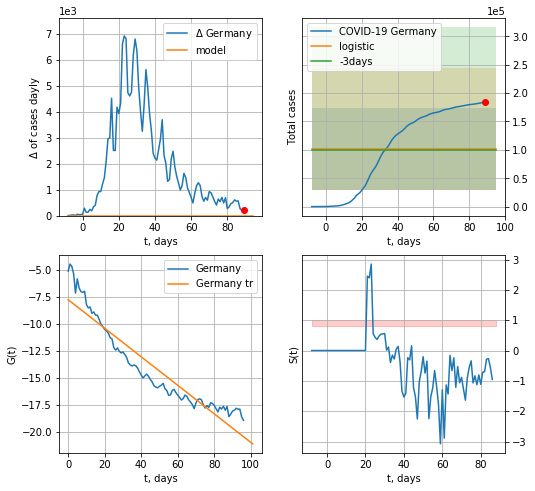

Germany data at: 2020-05-31
+3 day model MAPE: 0.02598155586420212
model: logistic
coeffs:  [ 1.01707939e+05 -4.23369710e+00  1.30124702e+02]
rational stdev:  0.7043027588132988
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  101707 ± 71633
	 total death:  4769 ± 10076
trend coefficient of determination: 0.887187
 intercept: -7.741480
 slope: -0.132425


In [120]:
x = forecast('Germany',dfGR[:],d1,7*10-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


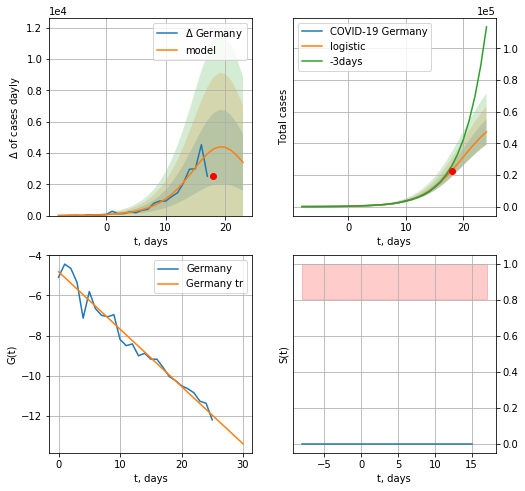

Germany data at: 2020-05-31
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +6 days
	 deltaDaycases:  3392
	 total cases:  47257 ± 8059
	 total death:  2216 ± 1133
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


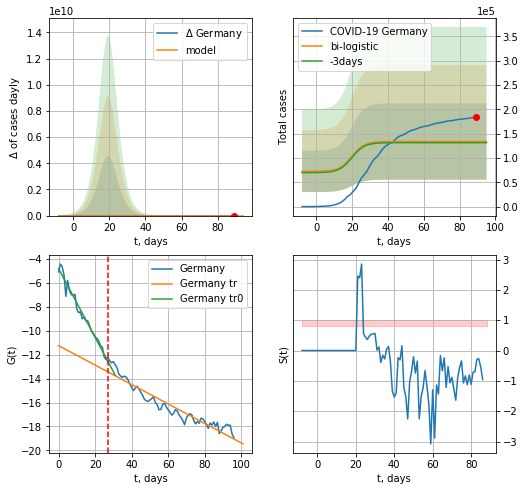

Germany data at: 2020-05-31
+3 day model MAPE: 0.01913194305064353
model: bi-logistic
coeffs:  [ 5.78971210e+04 -7.95890473e+00  9.59295105e+01] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.5862438736810598
forecast at the end of period: +6 days
	 deltaDaycases:  -35
	 total cases:  133975 ± 78542
	 total death:  6282 ± 11048
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.906629
 intercept: -11.246608
 slope: -0.081225


In [121]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,10*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*10-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
93 2020-05-27  181895   10562  8533.0
94 2020-05-28  182452   10682  8570.0
95 2020-05-29  183019   10325  8594.0
96 2020-05-30  183294    9794  8600.0
97 2020-05-31  183494    9689  8605.0


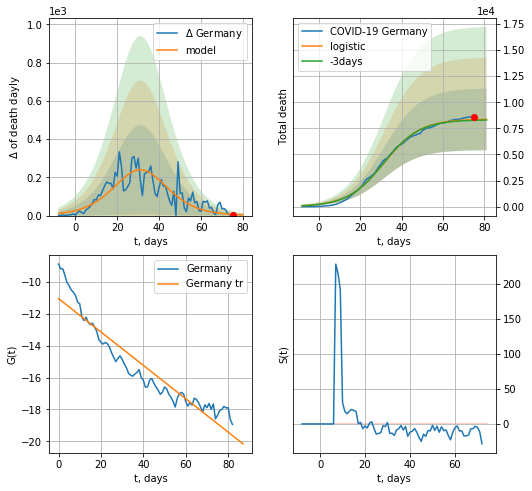

Germany data at: 2020-05-31
+3 day model MAPE: 0.007563145698227539
model: logistic
coeffs:  [8.39043099e+03 1.14088294e-01 3.15603970e+01]
rational stdev:  0.35314360335894984
forecast at the end of period: +6 days
	 total death:  8360 ± 2952
trend coefficient of determination: 0.891997
 intercept: -11.044619
 slope: -0.104779


In [122]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,10*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


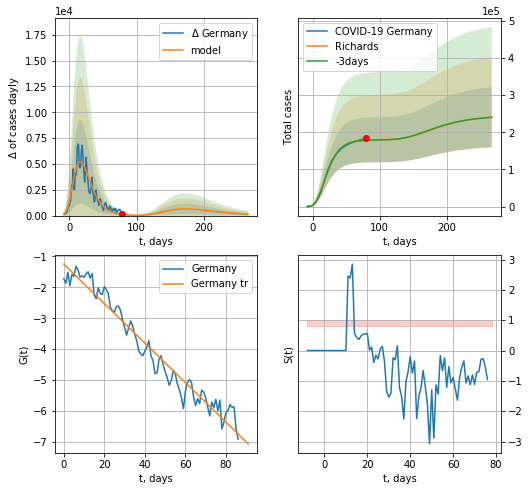

Germany data at: 2020-05-31
+3 day model MAPE: 0.003945
model: Richards
coeffs: [ 1.80311210e+05  1.09388158e+01 -4.52529709e+01  7.23526154e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.336576
forecast at the end of period: +188 days
	 deltaDaycases: 131
	 total cases: 240665 ± 81002
	 total death: 11286 ± 11395
trend coefficient of determination: 0.954701
 intercept: -1.247111
 slope: -0.063888


In [123]:
x = forecastRR('Germany',dfGR[10:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


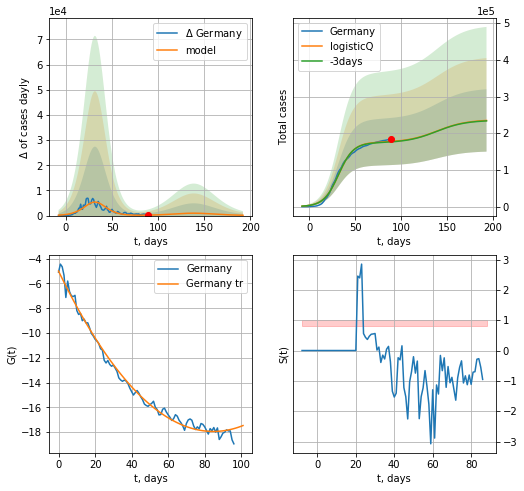

Germany data at: 2020-05-31
+3 day model MAPE: 0.006126
model: logisticQ
coeffs: [ 1.74933088e+05  4.26657062e-07  3.19023729e+01 -2.87955112e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361910
forecast at the end of period: +104 days
	 deltaDaycases: 130
	 total cases: 234758 ± 84961
	 total death: 11009 ± 11952
trend coefficient of determination: 0.990246
 intercept_: -5.002839633551455
 coeffs_: [ 0.         -0.30539953  0.00180186]


In [124]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


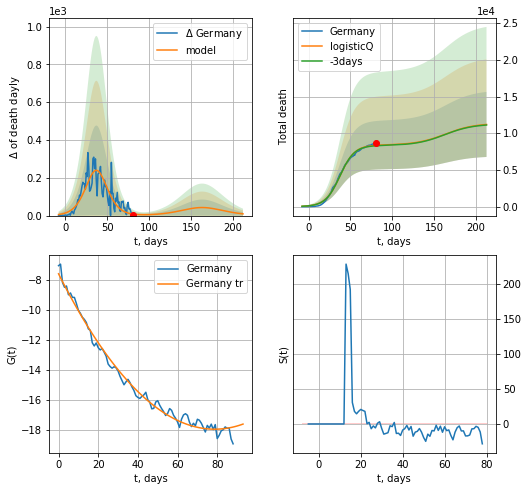

Germany data at: 2020-05-31
+3 day model MAPE: 0.007655
model: logisticQ
coeffs: [ 8.38817512e+03  1.17320814e-06  3.75556431e+01 -9.72960776e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.395831
forecast at the end of period: +132 days
	 total death: 11193 ± 4430
trend coefficient of determination: 0.988134
 intercept_: -7.602651165996266
 coeffs_: [ 0.         -0.26334571  0.00167288]


In [125]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

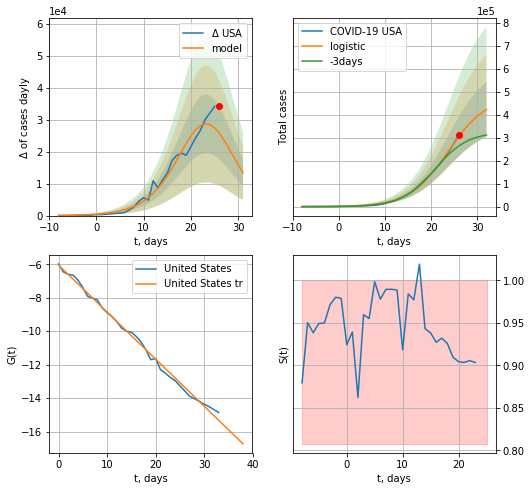

USA data at: 2020-05-31
+3 day model MAPE: 0.19535827238289116
model: logistic
coeffs:  [4.82026100e+05 2.38779089e-01 2.37021772e+01]
rational stdev:  0.2829911701138887
forecast at the end of period: +6 days
	 deltaDaycases:  13405
	 total cases:  423616 ± 119879
	 total death:  24486 ± 20787
trend coefficient of determination: 0.994973
 intercept: -6.048067
 slope: -0.281243


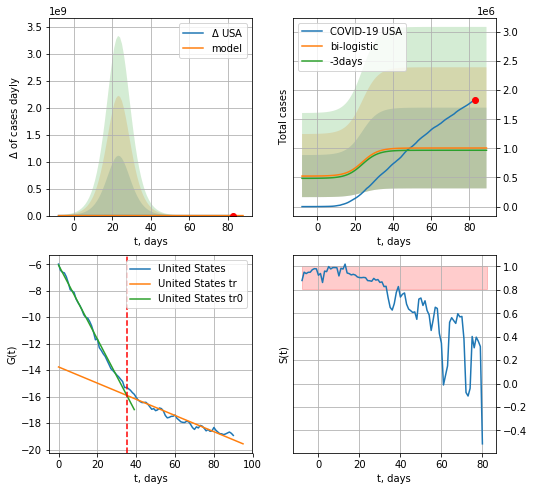

USA data at: 2020-05-31
+3 day model MAPE: 0.03984620310956029
model: bi-logistic
coeffs:  [ 4.19054414e+05 -5.95888990e+00  1.54574755e+02] [4.82026100e+05 2.38779089e-01 2.37021772e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6889644877223097
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  1005844 ± 692990
	 total death:  58141 ± 120171
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995079
 intercept: -6.063262
 slope: -0.279862
trend coefficient of determination: 0.941016
 intercept: -13.756945
 slope: -0.061093


In [126]:
vL=35
x = forecast('USA',dfUS[:vL],d1,10*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

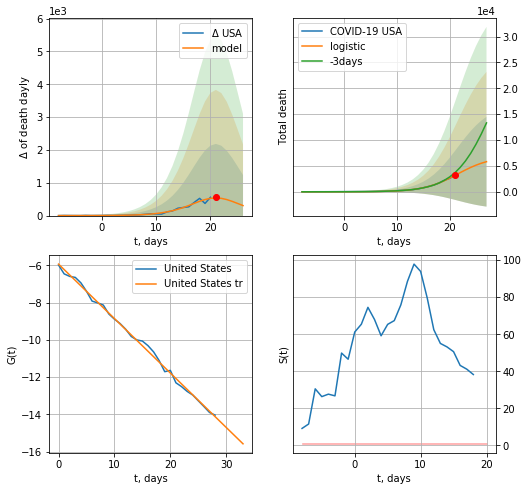

USA data at: 2020-05-31
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +6 days
	 total death:  5815 ± 8682
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


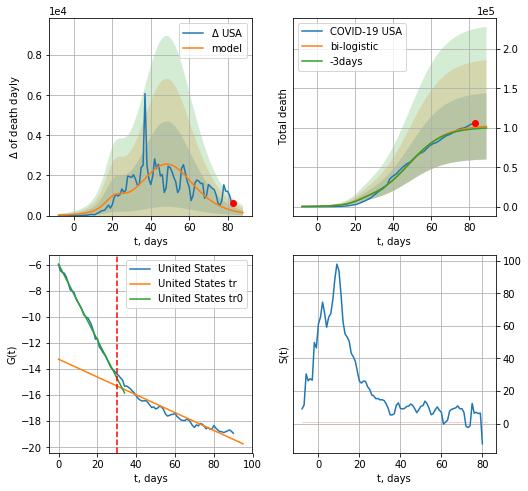

USA data at: 2020-05-31
+3 day model MAPE: 0.020185630762908965
model: bi-logistic
coeffs:  [9.63351647e+04 1.06705462e-01 4.87393275e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.41308698095578755
forecast at the end of period: +6 days
	 deltaDaydeath:  143
	 total death:  101874 ± 42083
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.926514
 intercept: -13.245317
 slope: -0.068305


In [127]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*10-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*10-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


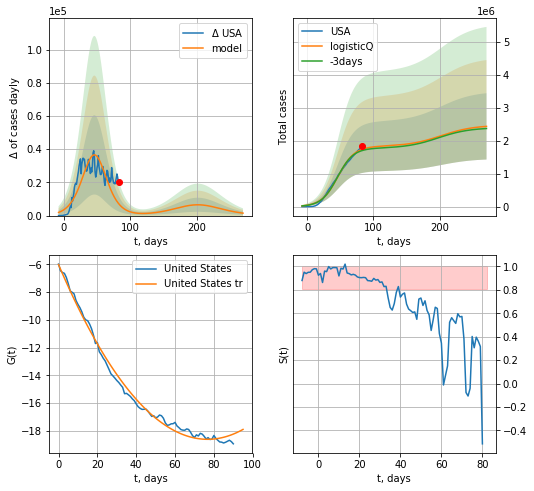

USA data at: 2020-05-31
+3 day model MAPE: 0.022683
model: logisticQ
coeffs: [ 1.82397955e+06  4.65159957e-07  4.63988193e+01 -1.72202893e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.413129
forecast at the end of period: +188 days
	 deltaDaycases: 1468
	 total cases: 2431943 ± 1004705
	 total death: 140575 ± 174226
trend coefficient of determination: 0.992804
 intercept_: -6.0260088797035944
 coeffs_: [ 0.         -0.32777696  0.00213574]


In [128]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


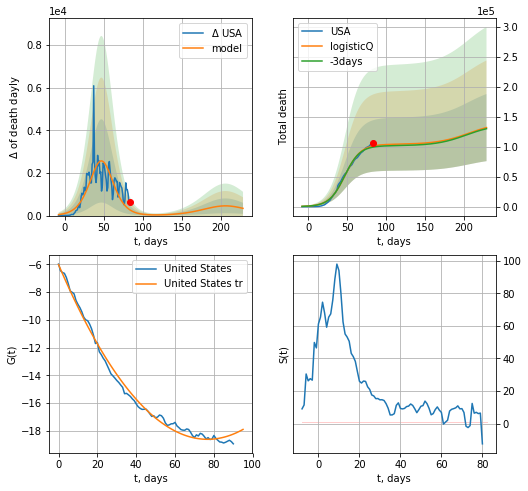

USA data at: 2020-05-31
+3 day model MAPE: 0.018891
model: logisticQ
coeffs: [ 1.03880311e+05  6.29704126e-07  4.72652396e+01 -1.56756982e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.424673
forecast at the end of period: +146 days
	 total death: 131768 ± 55958
trend coefficient of determination: 0.992804
 intercept_: -6.0260088797035944
 coeffs_: [ 0.         -0.32777696  0.00213574]


In [129]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


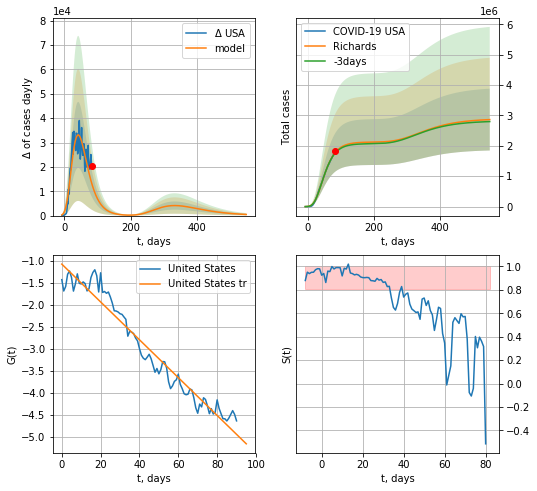

USA data at: 2020-05-31
+3 day model MAPE: 0.011853
model: Richards
coeffs: [ 2.12487022e+06  4.36826624e+00 -6.66768572e+01  9.75105082e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.354969
forecast at the end of period: +468 days
	 deltaDaycases: 458
	 total cases: 2862997 ± 1016275
	 total death: 165491 ± 176232
trend coefficient of determination: 0.952846
 intercept: -1.077320
 slope: -0.043037


In [130]:
x = forecastRR('USA',dfUS[:],d1,7*76-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


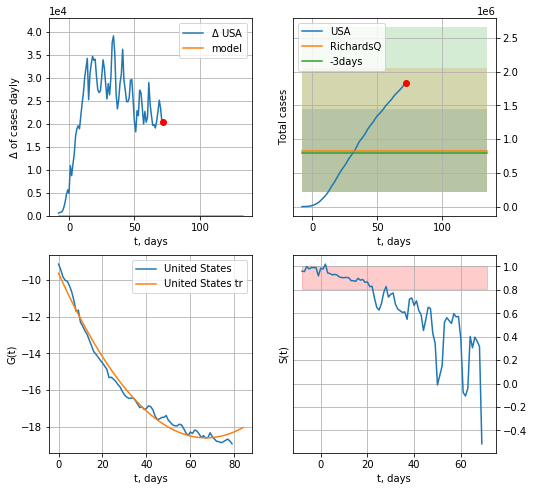

USA data at: 2020-05-31
+3 day model MAPE: 0.047676
model: RichardsQ
coeffs: [ 8.31743519e+05  3.06637078e+00 -2.14871908e+03  1.81787461e+03
 -3.04337461e+00]
rational stdev: 0.734230
forecast at the end of period: +62 days
	 deltaDaycases: 0
	 total cases: 831743 ± 610690
	 total death: 48077 ± 105898
trend coefficient of determination: 0.986010
 intercept_: -9.622293504678492
 coeffs_: [ 0.         -0.26734328  0.00198994]


In [131]:
x = forecastQR('USA',dfUS[11:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
          date   cases  active    death
91 2020-05-27  267240       0  37460.0
92 2020-05-28  269127       0  37837.0
93 2020-05-29  271222       0  38161.0
94 2020-05-30  272826       0  38376.0
95 2020-05-31  274762       0  38489.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


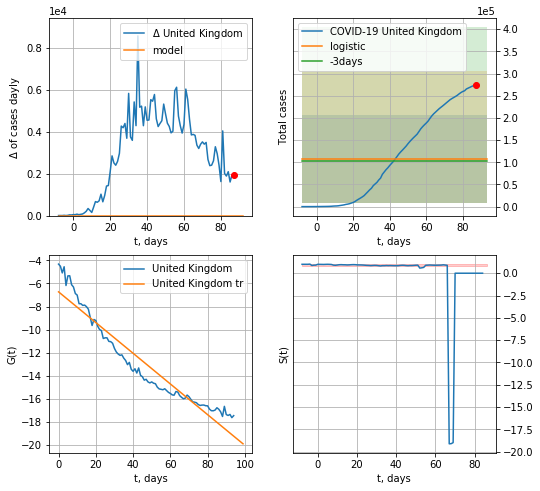

United Kingdom data at: 2020-05-31
+3 day model MAPE: 0.05191627499309186
model: logistic
coeffs:  [ 1.07881219e+05 -6.79922944e+00  1.81574810e+02]
rational stdev:  0.9185823115764598
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  107881 ± 99097
	 total death:  15112 ± 41644
trend coefficient of determination: 0.917271
 intercept: -6.727188
 slope: -0.133324


In [132]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*10-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


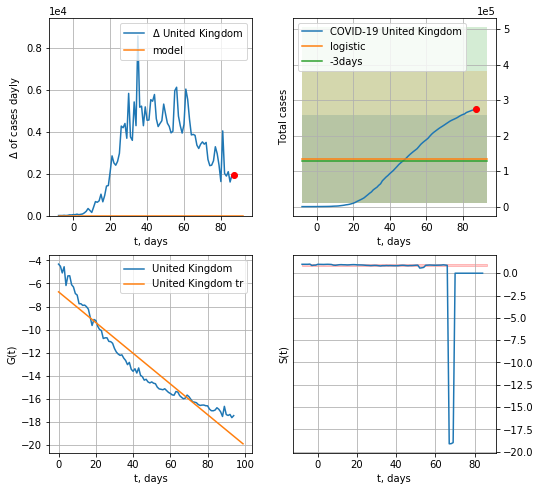

United Kingdom data at: 2020-05-31
+3 day model MAPE: 0.05191627499309191
model: logistic
coeffs:  [ 1.07881219e+05 -6.79922944e+00  1.81574810e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9185823115764598
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  134851 ± 123872
	 total death:  18890 ± 52056
trend coefficient of determination: 0.917271
 intercept: -6.727188
 slope: -0.133324


In [133]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


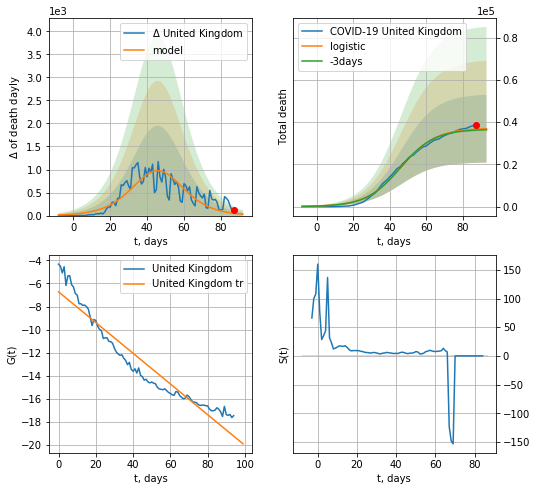

United Kingdom data at: 2020-05-31
+3 day model MAPE: 0.01357877241222757
model: logistic
coeffs:  [3.71592164e+04 1.04995862e-01 4.61681684e+01]
rational stdev:  0.4354543890377047
forecast at the end of period: +6 days
	 total death:  36889 ± 16063
trend coefficient of determination: 0.917271
 intercept: -6.727188
 slope: -0.133324


In [134]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


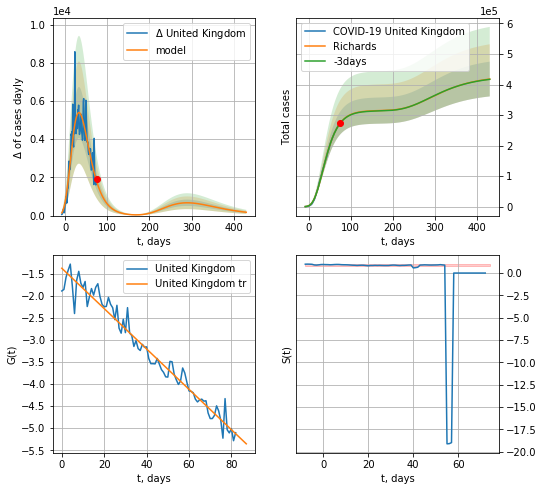

United Kingdom data at: 2020-05-31
+3 day model MAPE: 0.001811
model: Richards
coeffs: [ 3.15269180e+05  3.97707596e+00 -6.17091134e+01  1.17666384e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.136106
forecast at the end of period: +356 days
	 deltaDaycases: 174
	 total cases: 418117 ± 56908
	 total death: 58570 ± 23915
trend coefficient of determination: 0.962195
 intercept: -1.379924
 slope: -0.045677


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


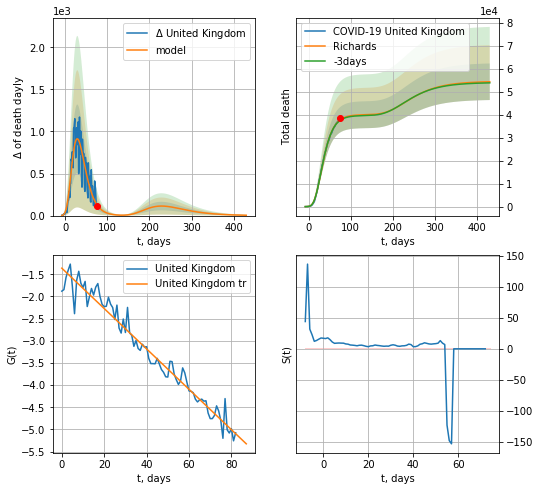

United Kingdom data at: 2020-05-31
+3 day model MAPE: 0.006359
model: Richards
coeffs: [ 4.00433329e+04  6.39521064e+00 -4.50930150e+01  9.74102269e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.146413
forecast at the end of period: +356 days
	 total death: 54359 ± 7958
trend coefficient of determination: 0.961861
 intercept: -1.363456
 slope: -0.045540


In [135]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


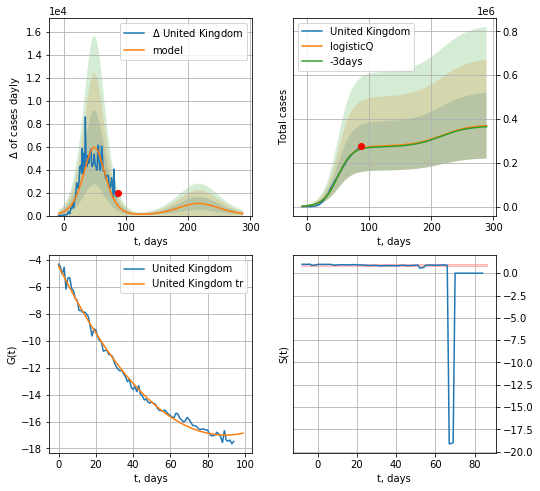

United Kingdom data at: 2020-05-31
+3 day model MAPE: 0.012386
model: logisticQ
coeffs: [ 2.76365342e+05  5.77533087e-07  4.98259940e+01 -1.48696150e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.405827
forecast at the end of period: +202 days
	 deltaDaycases: 177
	 total cases: 370041 ± 150172
	 total death: 51835 ± 63108
trend coefficient of determination: 0.993710
 intercept_: -4.441647583410042
 coeffs_: [ 0.         -0.28078598  0.00156879]


In [136]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


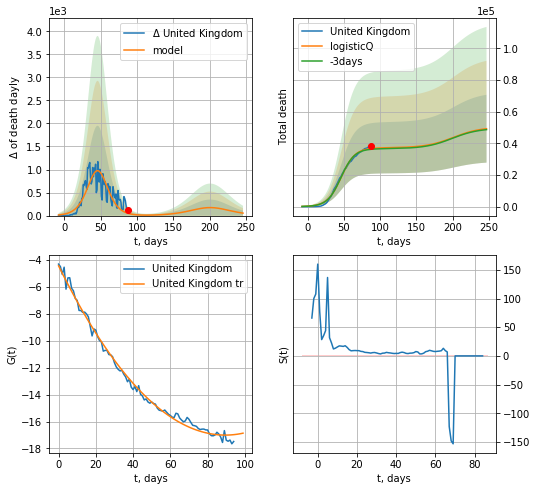

United Kingdom data at: 2020-05-31
+3 day model MAPE: 0.013620
model: logisticQ
coeffs: [ 3.71577600e+04  5.94614029e-07  4.61680466e+01 -1.76491787e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.435484
forecast at the end of period: +160 days
	 total death: 49240 ± 21443
trend coefficient of determination: 0.993710
 intercept_: -4.441647583410042
 coeffs_: [ 0.         -0.28078598  0.00156879]


In [137]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [138]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [139]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [140]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [141]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [142]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [143]:
dT

64

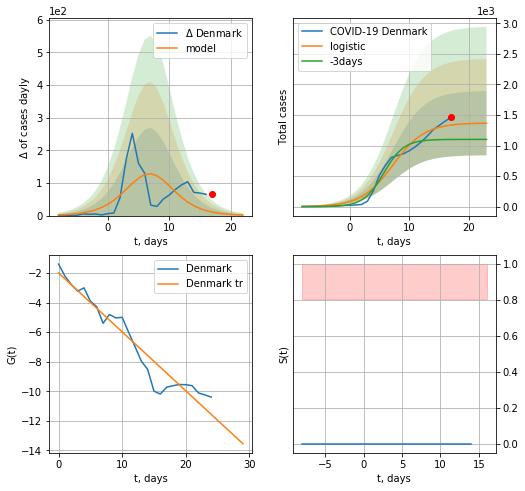

Denmark data at: 2020-05-31
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +6 days
	 deltaDaycases:  1
	 total cases:  1365 ± 525
	 total death:  67 ± 77
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


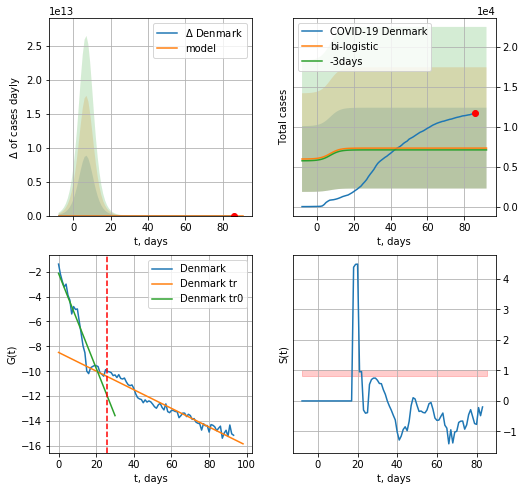

Denmark data at: 2020-05-31
+3 day model MAPE: 0.03152308998809193
model: bi-logistic
coeffs:  [ 4.76733944e+03 -3.36296767e+00  9.84724178e+01] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.690471051824858
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  7328 ± 5060
	 total death:  360 ± 745
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.944865
 intercept: -8.487030
 slope: -0.074969


In [144]:
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*10-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


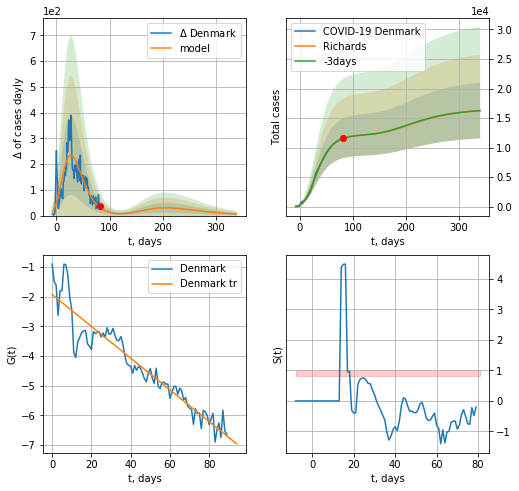

Denmark data at: 2020-05-31
+3 day model MAPE: 0.002458
model: Richards
coeffs: [ 1.21966028e+04  5.97970810e-01 -1.60307971e+01  9.15079393e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.290133
forecast at the end of period: +258 days
	 deltaDaycases: 6
	 total cases: 16268 ± 4720
	 total death: 800 ± 696
trend coefficient of determination: 0.901628
 intercept: -1.932735
 slope: -0.053438


In [145]:
x = forecastRR('Denmark',dfDK[4:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


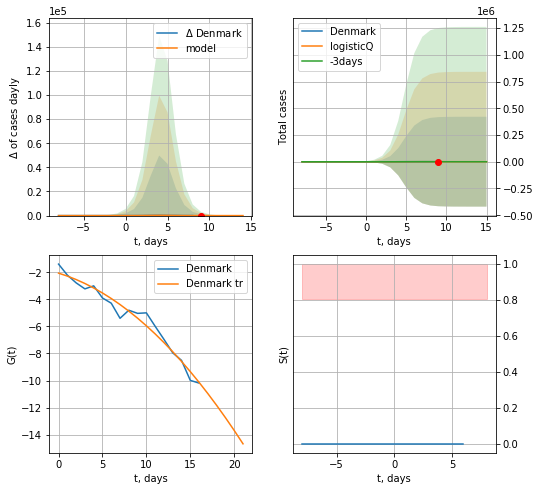

Denmark data at: 2020-05-31
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 862 ± 420256
	 total death: 42 ± 61395
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


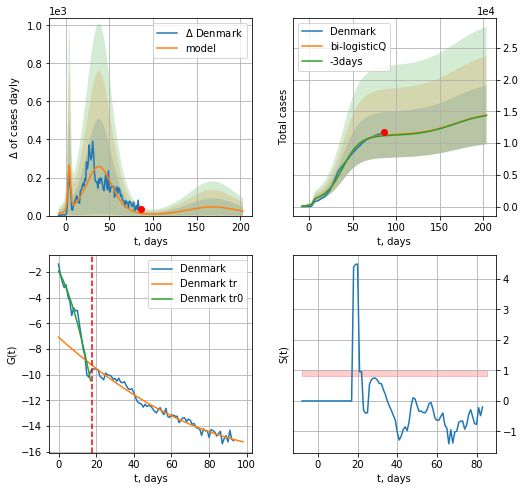

Denmark data at: 2020-05-31
+3 day model MAPE: 0.009293
model: bi-logisticQ
coeffs: [ 1.04174168e+04  3.97939665e-07  3.86714544e+01 -2.48609006e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.320135
forecast at the end of period: +118 days
	 deltaDaycases: 23
	 total cases: 14429 ± 4619
	 total death: 709 ± 680
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.974310
 intercept_: -7.076570976391713
 coeffs_: [ 0.         -0.13184723  0.00049701]


In [146]:
x = forecastRRR('Denmark',dfDK[:18],d1,10*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
          date  cases  active  death
91 2020-05-27   8401     439  235.0
92 2020-05-28   8411     448  236.0
93 2020-05-29   8422     459  236.0
94 2020-05-30   8437     474  236.0
95 2020-05-31   8440     477  236.0


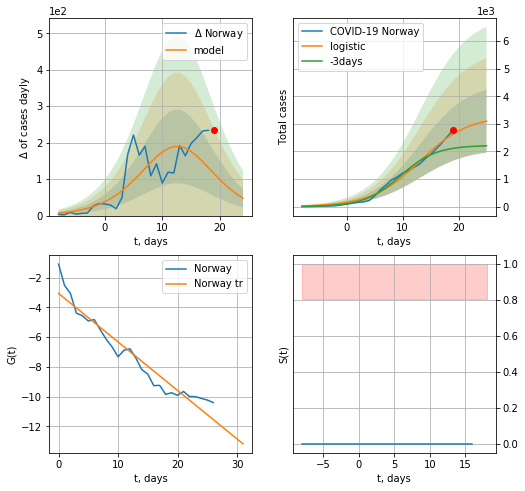

Norway data at: 2020-05-31
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +6 days
	 deltaDaycases:  47
	 total cases:  3100 ± 1139
	 total death:  86 ± 94
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


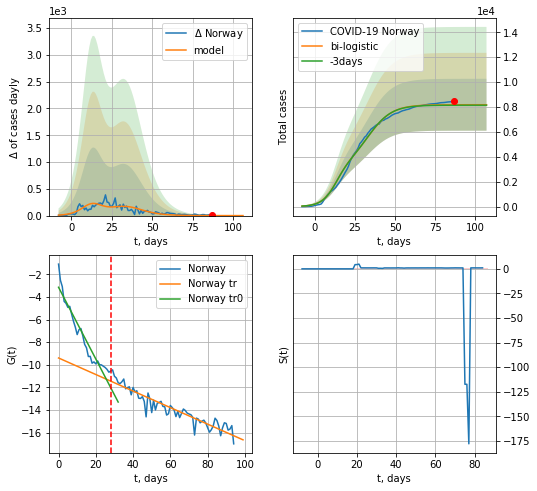

Norway data at: 2020-05-31
+3 day model MAPE: 0.004285112725399005
model: bi-logistic
coeffs:  [4.88177291e+03 1.35789432e-01 3.37291557e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.25464871201886824
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  8179 ± 2082
	 total death:  228 ± 174
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.877439
 intercept: -9.395390
 slope: -0.073090


In [147]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*10-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,12*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

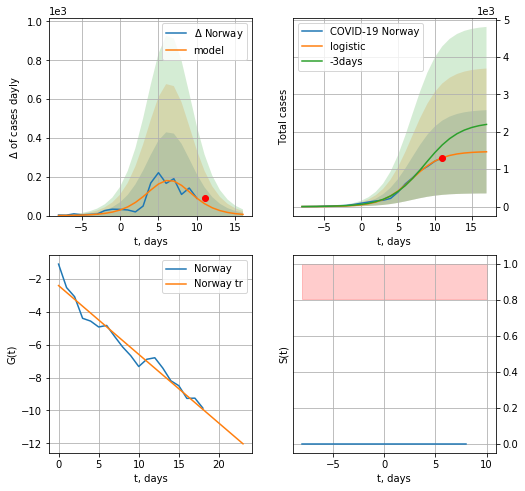

Norway data at: 2020-05-31
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +6 days
	 deltaDaycases:  6
	 total cases:  1465 ± 1112
	 total death:  40 ± 91
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


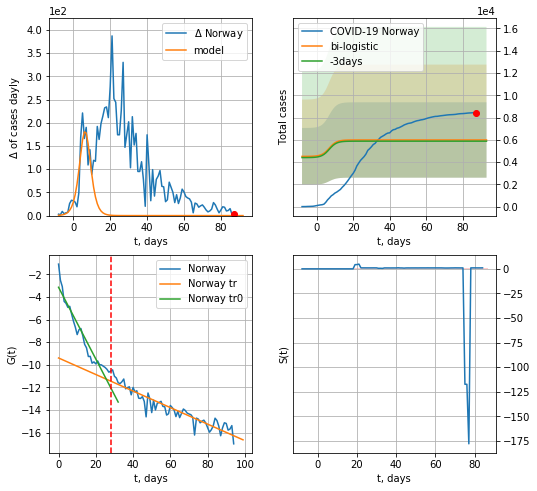

Norway data at: 2020-05-31
+3 day model MAPE: 0.018229742807629474
model: bi-logistic
coeffs:  [ 4.00683278e+03 -2.13020773e+00  9.87788705e+01] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5656201672290777
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  5982 ± 3383
	 total death:  167 ± 283
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.877439
 intercept: -9.395390
 slope: -0.073090


In [148]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*10-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


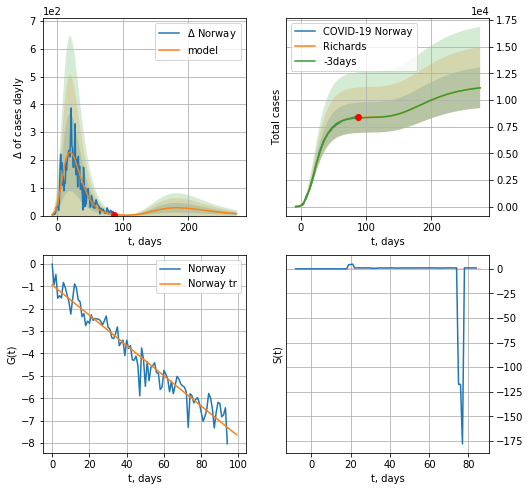

Norway data at: 2020-05-31
+3 day model MAPE: 0.001825
model: Richards
coeffs: [ 8.38632888e+03  7.27892835e+00 -4.19155218e+01  1.02039579e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.170759
forecast at the end of period: +188 days
	 deltaDaycases: 6
	 total cases: 11146 ± 1903
	 total death: 311 ± 159
trend coefficient of determination: 0.940553
 intercept: -0.942750
 slope: -0.067601


In [149]:
x = forecastRR('Norway',dfNG[:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


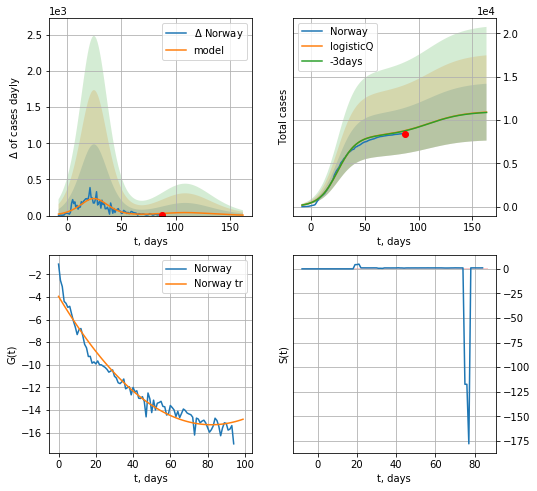

Norway data at: 2020-05-31
+3 day model MAPE: 0.003066
model: logisticQ
coeffs: [ 8.14667738e+03  4.84815052e-07  2.50546420e+01 -2.37436279e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.300836
forecast at the end of period: +76 days
	 deltaDaycases: 6
	 total cases: 10909 ± 3281
	 total death: 305 ± 275
trend coefficient of determination: 0.959272
 intercept_: -3.9497747993872228
 coeffs_: [ 0.         -0.27667236  0.00168657]


In [150]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


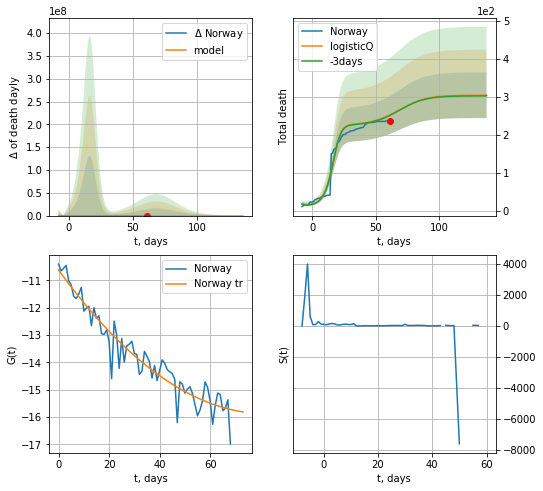

Norway data at: 2020-05-31
+3 day model MAPE: 0.004011
model: logisticQ
coeffs: [ 2.24303490e+02  6.88255704e-03  1.55782416e+01 -2.34137437e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.197284
forecast at the end of period: +76 days
	 total death: 303 ± 59
trend coefficient of determination: 0.915828
 intercept_: -10.617466089456315
 coeffs_: [ 0.         -0.12770404  0.00077413]


In [151]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

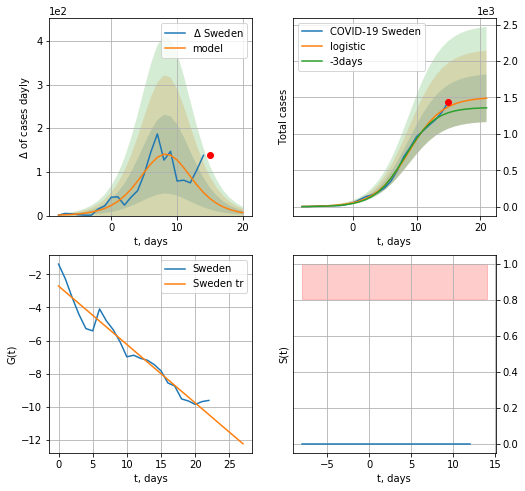

Sweden data at: 2020-05-31
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +6 days
	 deltaDaycases:  6
	 total cases:  1489 ± 326
	 total death:  174 ± 114
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


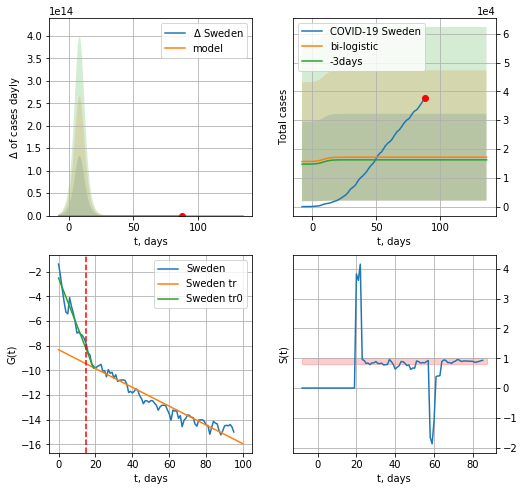

Sweden data at: 2020-05-31
+3 day model MAPE: 0.056571194148393115
model: bi-logistic
coeffs:  [ 1.25181777e+04 -5.38110212e+00  1.44719312e+02] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8789499229189163
forecast at the end of period: +48 days
	 deltaDaycases:  0
	 total cases:  17152 ± 15076
	 total death:  2008 ± 5294
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.928654
 intercept: -8.329093
 slope: -0.076319


In [152]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,7*10-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
92 2020-05-27  35088   25897  4220.0
93 2020-05-28  35727   26490  4266.0
94 2020-05-29  36476   27155  4350.0
95 2020-05-30  37113   27747  4395.0
96 2020-05-31  37542   28176  4395.0


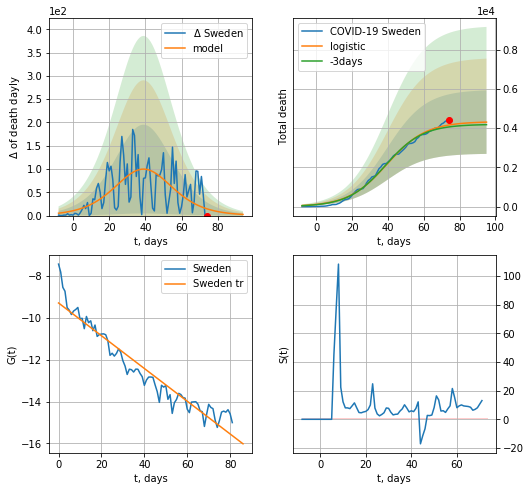

Sweden data at: 2020-05-31
+3 day model MAPE: 0.024796190316939307
model: logistic
coeffs:  [4.33481992e+03 9.21613892e-02 3.94606338e+01]
rational stdev:  0.3758283224577069
forecast at the end of period: +21 days
	 total death:  4309 ± 1619
trend coefficient of determination: 0.922758
 intercept: -9.304391
 slope: -0.078034


In [153]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


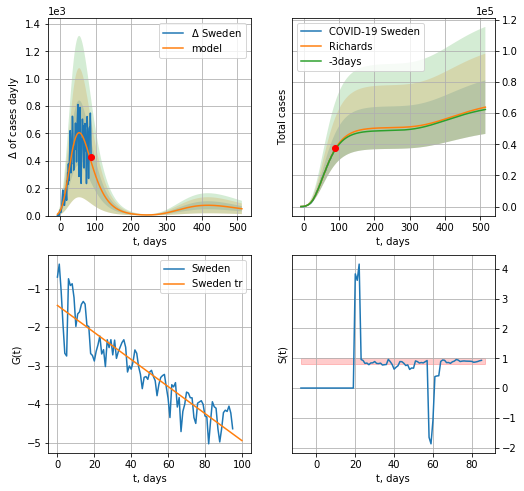

Sweden data at: 2020-05-31
+3 day model MAPE: 0.012228
model: Richards
coeffs: [ 5.07852843e+04  2.08070342e+00 -7.32456355e+01  1.57061050e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.268986
forecast at the end of period: +426 days
	 deltaDaycases: 49
	 total cases: 63879 ± 17182
	 total death: 7478 ± 6034
trend coefficient of determination: 0.842079
 intercept: -1.439083
 slope: -0.035054


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


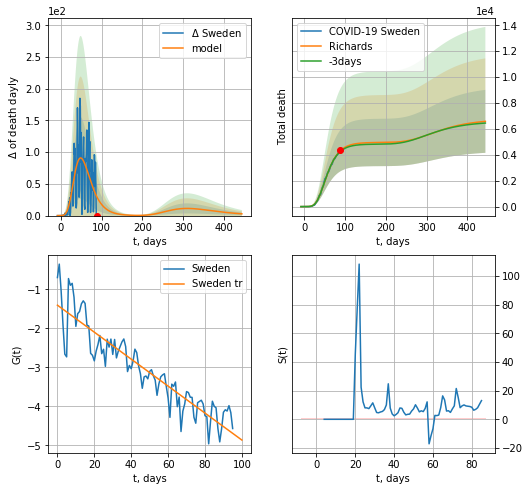

Sweden data at: 2020-05-31
+3 day model MAPE: 0.013544
model: Richards
coeffs: [ 4.95655250e+03  5.32481812e+00 -4.38764461e+01  9.41056589e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.369242
forecast at the end of period: +356 days
	 total death: 6582 ± 2430
trend coefficient of determination: 0.839686
 intercept: -1.408171
 slope: -0.034590


In [154]:
x = forecastRR('Sweden',dfSW[:],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('Sweden',dfSW[:],d1,60*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs,cases='death')
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


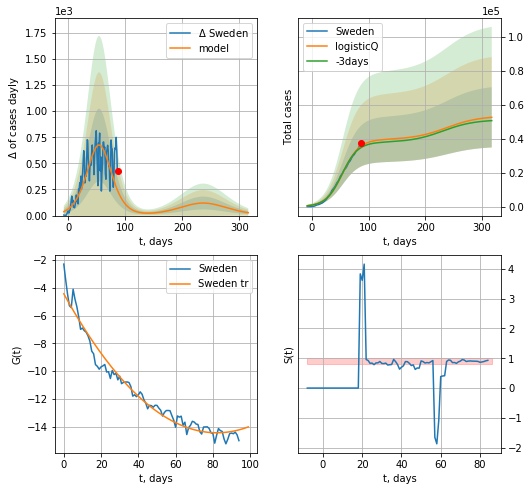

Sweden data at: 2020-05-31
+3 day model MAPE: 0.025796
model: logisticQ
coeffs: [ 3.94132584e+04  5.28414220e-07  5.44442957e+01 -1.29539925e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.337532
forecast at the end of period: +230 days
	 deltaDaycases: 27
	 total cases: 52529 ± 17730
	 total death: 6149 ± 6226
trend coefficient of determination: 0.966899
 intercept_: -4.422592656860663
 coeffs_: [ 0.         -0.24386564  0.00148455]


In [155]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


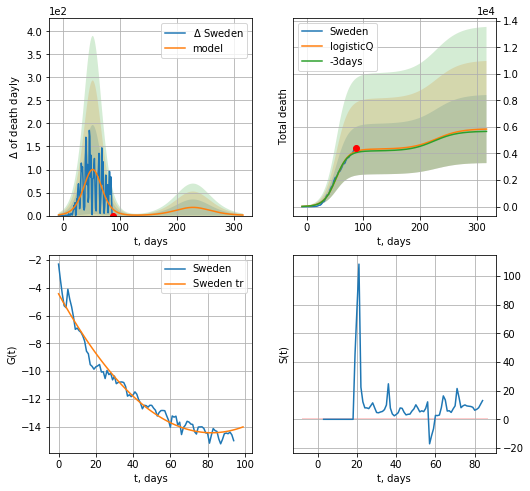

Sweden data at: 2020-05-31
+3 day model MAPE: 0.024851
model: logisticQ
coeffs: [ 4.33019676e+03  5.97208595e-07  5.24311881e+01 -1.54704449e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.439145
forecast at the end of period: +230 days
	 total death: 5839 ± 2564
trend coefficient of determination: 0.966899
 intercept_: -4.422592656860663
 coeffs_: [ 0.         -0.24386564  0.00148455]


In [156]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
126 2020-05-27  82995.0      73  4634.0
127 2020-05-28  82995.1      70  4634.0
128 2020-05-29  82999.0      63  4634.0
129 2020-05-30  83001.0      63  4634.0
130 2020-05-31  83017.0      76  4634.0


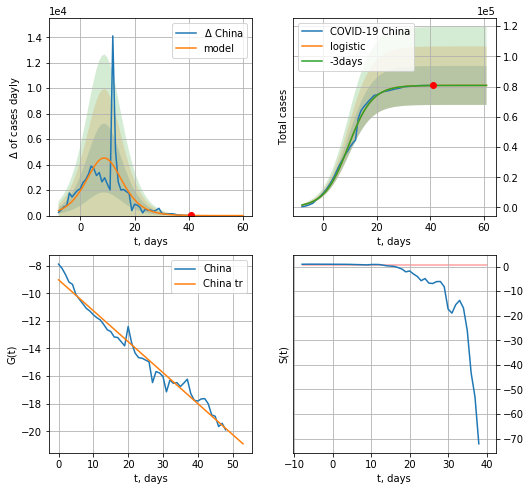

China data at: 2020-05-31
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  80809 ± 12906
	 total death:  4510 ± 2160
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


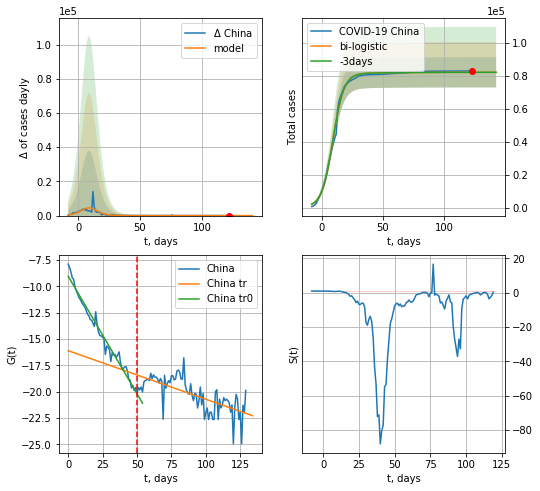

China data at: 2020-05-31
+3 day model MAPE: 0.0002079963815339895
model: bi-logistic
coeffs:  [1.40754272e+03 3.81826873e-02 1.73535454e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.11182357036202029
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  82205 ± 9192
	 total death:  4588 ± 1539
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.456064
 intercept: -16.108644
 slope: -0.046126


In [157]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*12-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [158]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

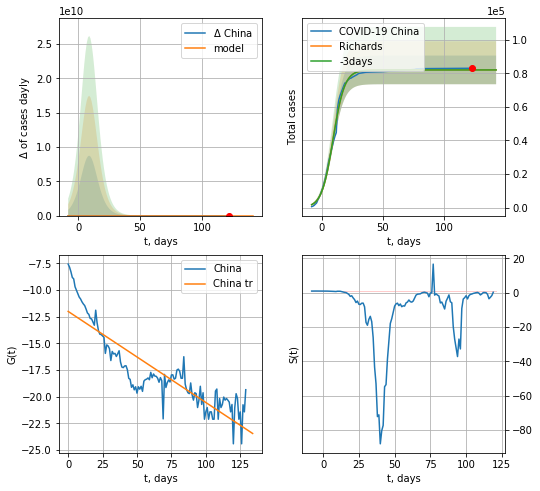

China data at: 2020-05-31
+3 day model MAPE: 0.000404
model: Richards
coeffs: [8.20535820e+04 2.23662886e-01 9.16379327e+00 9.53103853e-01]
rational stdev: 0.104048
forecast at the end of period: +20 days
	 deltaDaycases: 0
	 total cases: 82053 ± 8537
	 total death: 4580 ± 1429
trend coefficient of determination: 0.780040
 intercept: -12.007488
 slope: -0.085426


In [159]:
x = forecastRR('China',dfCN[:],d1,12*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

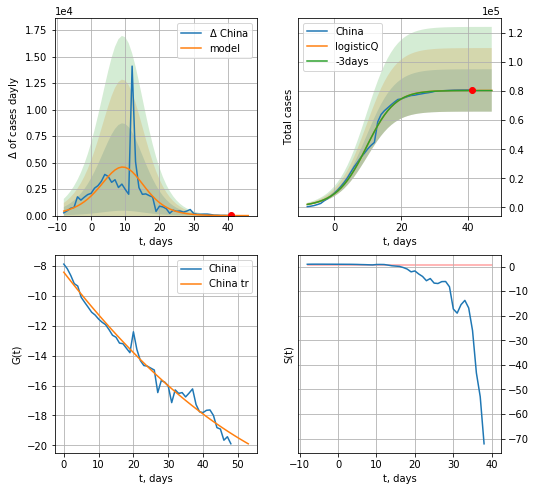

China data at: 2020-05-31
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +6 days
	 deltaDaycases: 1
	 total cases: 80414 ± 14556
	 total death: 4488 ± 2437
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


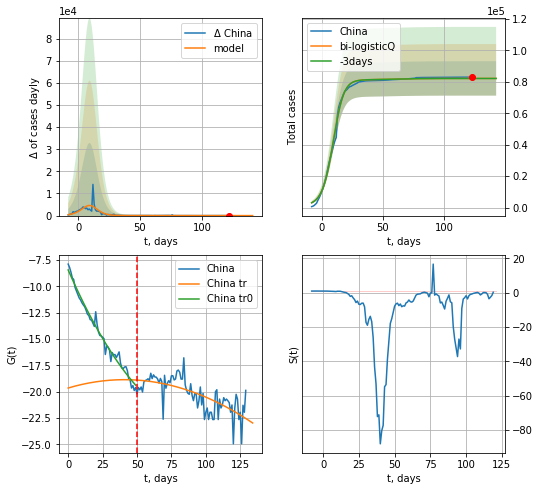

China data at: 2020-05-31
+3 day model MAPE: 0.000464
model: bi-logisticQ
coeffs: [ 1.78791858e+03  5.72239945e-04  2.48106184e+01 -2.79079850e-02]
rational stdev: 0.133000
forecast at the end of period: +20 days
	 deltaDaycases: 0
	 total cases: 82205 ± 10933
	 total death: 4588 ± 1830
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.476669
 intercept_: -19.655736561274292
 coeffs_: [ 0.          0.03879308 -0.00047441]


In [160]:
x = forecastRRR('China',dfCN[:50],d1,7*10-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)

In [161]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
102 2020-05-27  11344   735.0  269.0
103 2020-05-28  11402   770.0  269.0
104 2020-05-29  11441   774.0  269.0
105 2020-05-30  11468   793.0  270.0
106 2020-05-31  11503   810.0  271.0


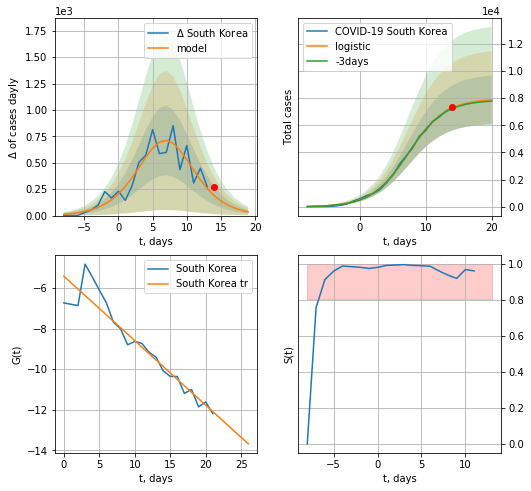

South Korea data at: 2020-05-31
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +6 days
	 deltaDaycases:  35
	 total cases:  7857 ± 1788
	 total death:  185 ± 126
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


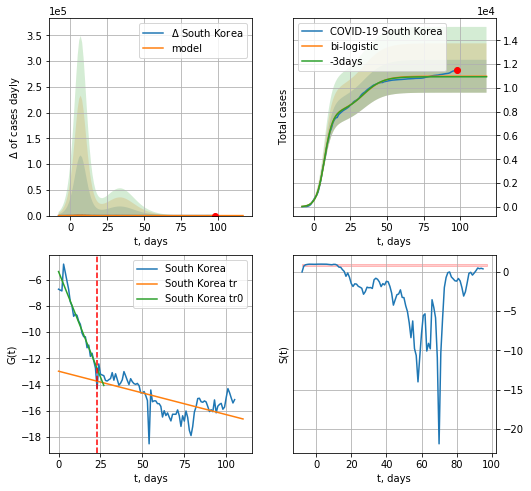

South Korea data at: 2020-05-31
+3 day model MAPE: 0.004123900031623507
model: bi-logistic
coeffs:  [3.03538901e+03 1.44254107e-01 3.41419571e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.12583259096878324
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  10976 ± 1381
	 total death:  258 ± 97
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.399407
 intercept: -12.979511
 slope: -0.033062


In [163]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*10-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,12*7-dT,x,1.0,vL=23)

In [164]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

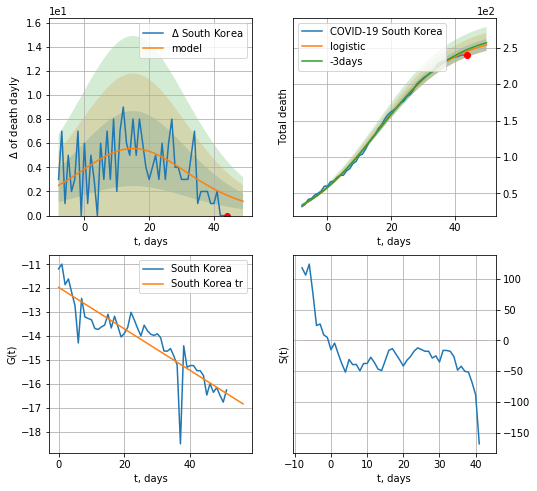

South Korea data at: 2020-05-31
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +6 days
	 total death:  253 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


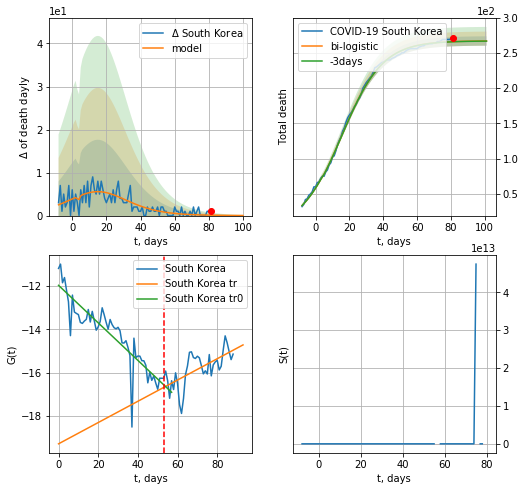

South Korea data at: 2020-05-31
+3 day model MAPE: 0.000645824894139809
model: bi-logistic
coeffs:  [-1.45731274  2.88829712  4.19502493] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.024947455379863214
forecast at the end of period: +20 days
	 deltaDaydeath:  0
	 total death:  266 ± 6
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.424668
 intercept: -19.282267
 slope: 0.049046


In [165]:
x = forecast('South Korea',dfKR[17:70],d1,10*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,12*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


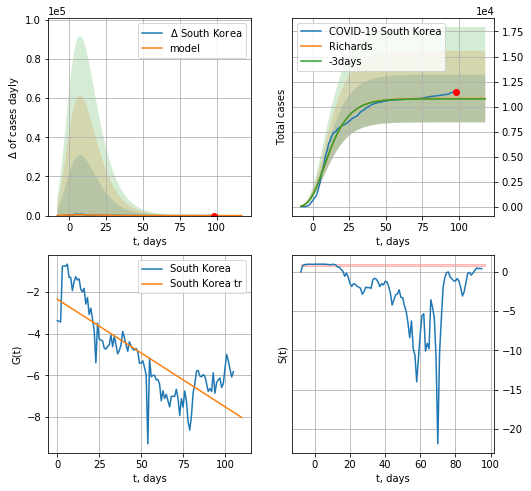

South Korea data at: 2020-05-31
+3 day model MAPE: 0.003972
model: Richards
coeffs: [ 1.08147897e+04  3.06415140e+01 -4.77731114e+01  3.34448143e-03]
rational stdev: 0.220070
forecast at the end of period: +20 days
	 deltaDaycases: 0
	 total cases: 10814 ± 2379
	 total death: 254 ± 167
trend coefficient of determination: 0.650191
 intercept: -2.356100
 slope: -0.051508


In [166]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


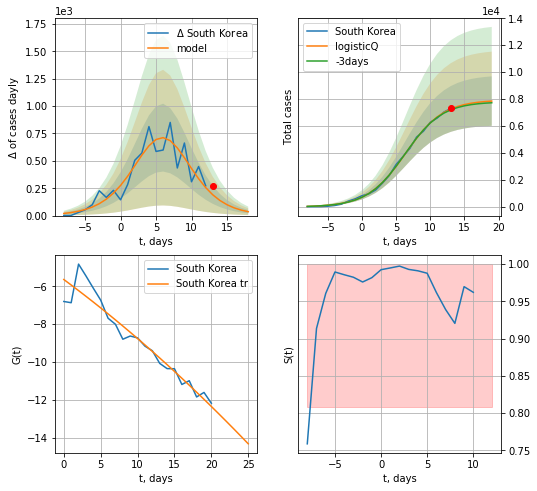

South Korea data at: 2020-05-31
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +6 days
	 deltaDaycases: 35
	 total cases: 7853 ± 1834
	 total death: 185 ± 129
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


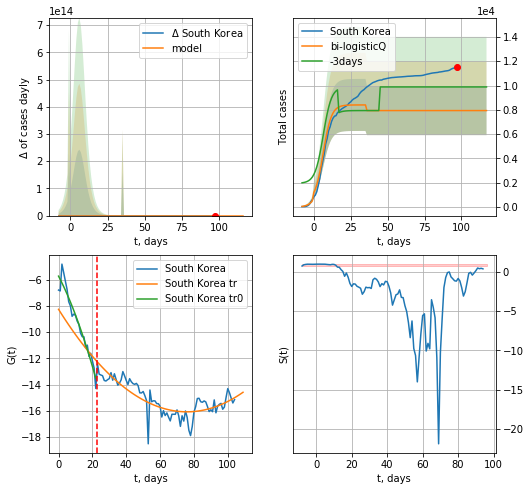

South Korea data at: 2020-05-31
+3 day model MAPE: 0.196864
model: bi-logisticQ
coeffs: [ 4.64056581e+02 -1.97693989e+00  3.55972876e+01 -3.24665829e-01]
rational stdev: 0.254927
forecast at the end of period: +20 days
	 deltaDaycases: 0
	 total cases: 7936 ± 2023
	 total death: 186 ± 142
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.691010
 intercept_: -8.267136444564484
 coeffs_: [ 0.         -0.20574021  0.00135577]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [167]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,10*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,12*7-dT,x,1.0,vL=vL)

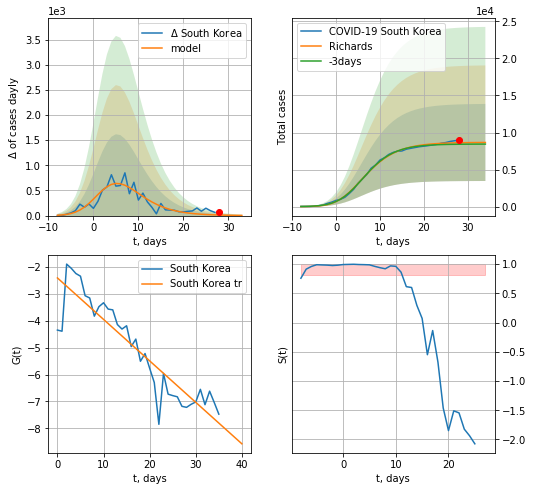

South Korea data at: 2020-05-31
+3 day model MAPE: 0.024309
model: Richards
coeffs: [8.67151677e+03 8.21539864e-01 1.26405006e-01 2.78237807e-01]
rational stdev: 0.600538
forecast at the end of period: +6 days
	 deltaDaycases: 3
	 total cases: 8658 ± 5199
	 total death: 203 ± 365
trend coefficient of determination: 0.823737
 intercept: -2.408294
 slope: -0.154215


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


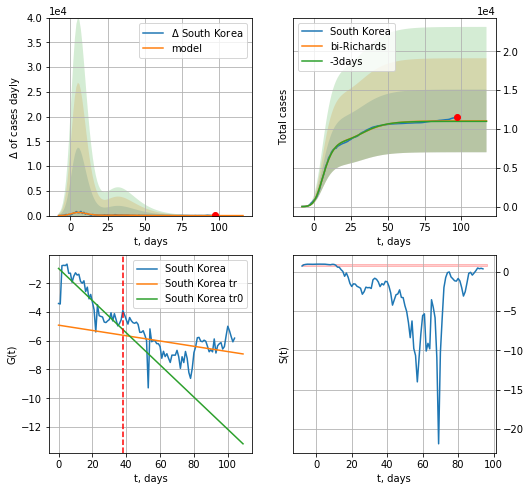

South Korea data at: 2020-05-31
+3 day model MAPE: 0.005179
model: bi-Richards
coeffs: [ 2.37249740e+03  3.88968179e+01 -2.55514574e+01  2.59216471e-03]
rational stdev: 0.365525
forecast at the end of period: +20 days
	 deltaDaycases: 0
	 total cases: 11043 ± 4036
	 total death: 260 ± 285
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.699474
 intercept: -0.968910
 slope: -0.111953
trend coefficient of determination: 0.113187
 intercept: -4.917024
 slope: -0.018363


In [168]:
vL=38
x = forecastRR('South Korea',dfKR[1:vL],d1,10*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[1:],d1,12*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


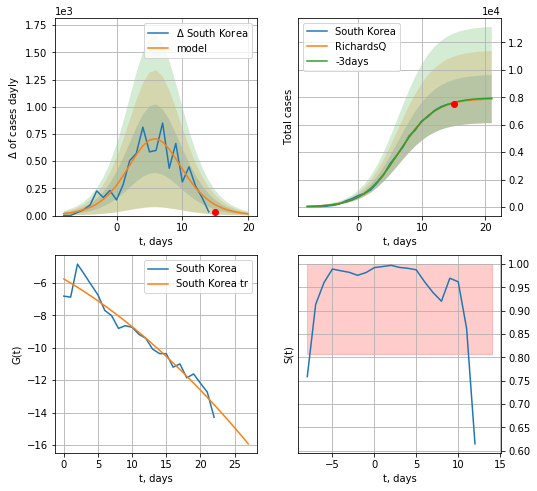

South Korea data at: 2020-05-31
+3 day model MAPE: 0.006079
model: RichardsQ
coeffs: [ 7.90607495e+03  3.14377481e-03 -1.32150046e+02  5.22462480e+00
  7.59593205e-01]
rational stdev: 0.222738
forecast at the end of period: +6 days
	 deltaDaycases: 15
	 total cases: 7873 ± 1753
	 total death: 185 ± 123
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:296: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:296: RuntimeWarning: overflow encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


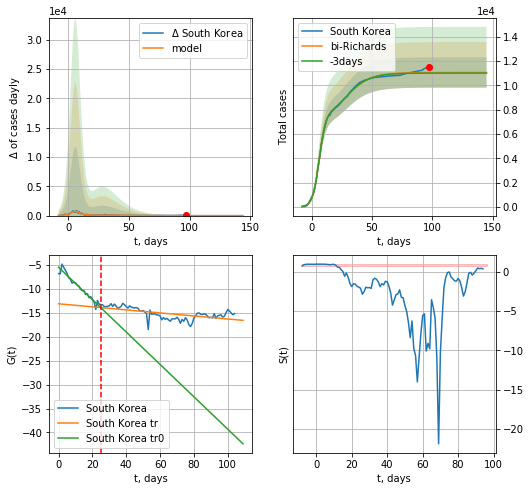

South Korea data at: 2020-05-31
+3 day model MAPE: 0.004630
model: bi-Richards
coeffs: [ 3.14917074e+03  1.94916784e-01 -6.86053273e+01 -1.39219101e+03
  3.00864945e-04]
rational stdev: 0.112894
forecast at the end of period: +48 days
	 deltaDaycases: 0
	 total cases: 11055 ± 1248
	 total death: 260 ± 88
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936460
 intercept: -5.478818
 slope: -0.338423
trend coefficient of determination: 0.361926
 intercept: -13.115959
 slope: -0.031730


In [169]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,10*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

In [170]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


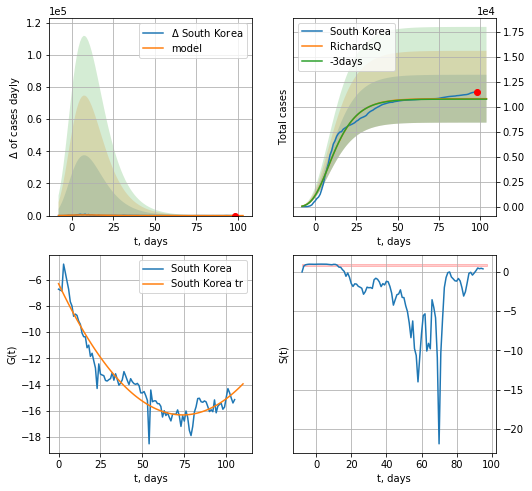

South Korea data at: 2020-05-31
+3 day model MAPE: 0.004001
model: RichardsQ
coeffs: [ 1.08091735e+04  1.36630527e-01 -7.47576862e+01 -2.57000876e+03
  2.81018959e-04]
rational stdev: 0.221153
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 10808 ± 2390
	 total death: 254 ± 168
trend coefficient of determination: 0.923708
 intercept_: -6.316361552807137
 coeffs_: [ 0.         -0.27004925  0.00182451]


In [171]:
x = forecastQR('South Korea',dfKR[:],d1,10*7-dT,1.0)

SG
           date  cases  active  death
125 2020-05-27  32876   15577   23.0
126 2020-05-28  33249   14932   23.0
127 2020-05-29  33860   14206   23.0
128 2020-05-30  34366   13616   23.0
129 2020-05-31  34884   13162   23.0


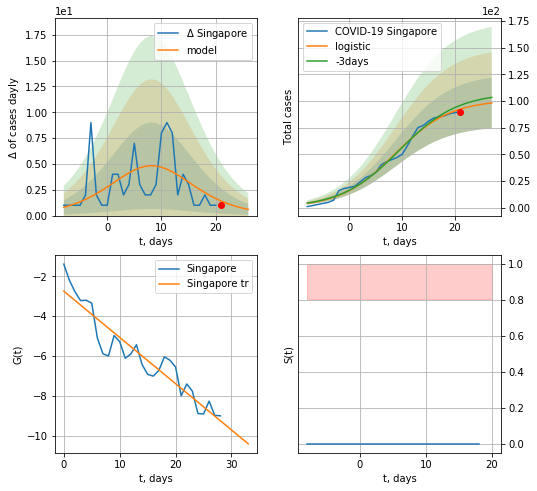

Singapore data at: 2020-05-31
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  98 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


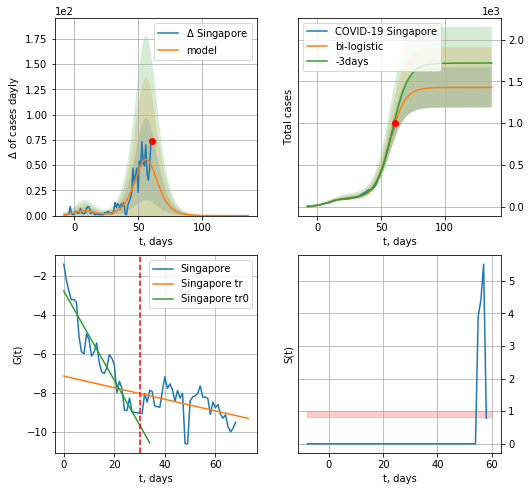

Singapore data at: 2020-05-31
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +76 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


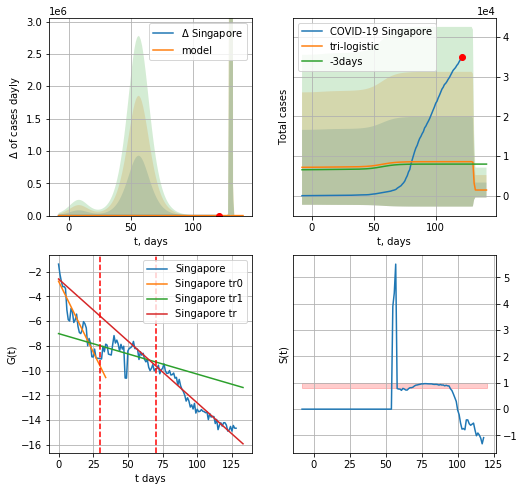

Singapore data at: 2020-05-31
+3 day model MAPE: 0.07640471684547817
model: tri-logistic
coeffs:  [ 7.15407225e+03 -5.06713290e+00  1.30778940e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  1.3210523762262312
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  1427 ± 1886
	 total death:  0 ± 0
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.940248
 intercept: -2.589353
 slope: -0.100305


In [172]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,7*10-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


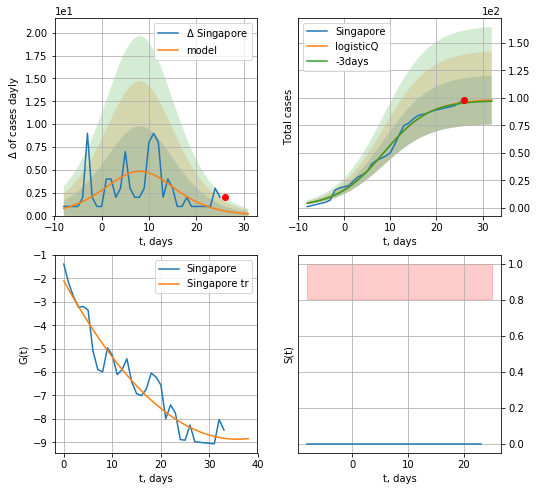

Singapore data at: 2020-05-31
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


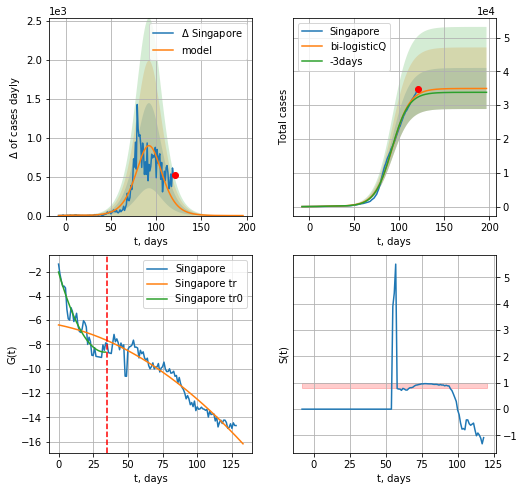

Singapore data at: 2020-05-31
+3 day model MAPE: 0.024382
model: bi-logisticQ
coeffs: [ 3.48379862e+04  9.71461941e-07  9.24694571e+01 -1.06035852e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.173768
forecast at the end of period: +76 days
	 deltaDaycases: 0
	 total cases: 34936 ± 6070
	 total death: 23 ± 11
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.939115
 intercept_: -6.3915856836755305
 coeffs_: [ 0.         -0.02338491 -0.0003771 ]


In [173]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*10-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [174]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

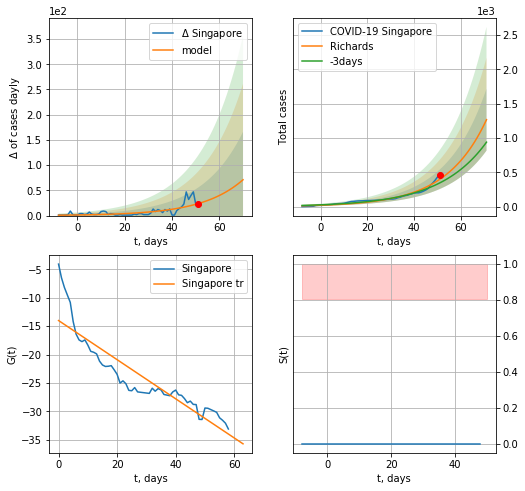

Singapore data at: 2020-05-31
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +20 days
	 deltaDaycases: 71
	 total cases: 1266 ± 450
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


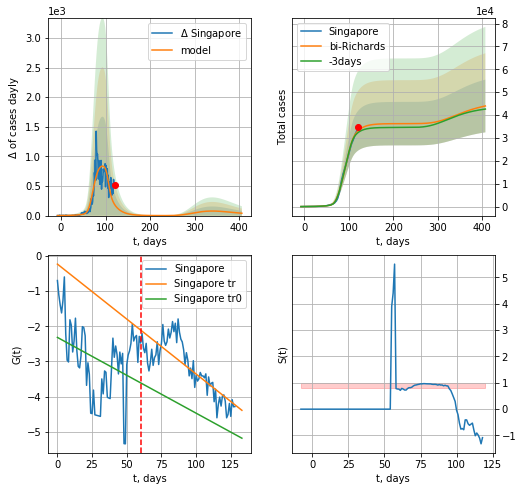

Singapore data at: 2020-05-31
+3 day model MAPE: 0.025537
model: bi-Richards
coeffs: [2.69571120e+04 8.68275566e+00 8.56122647e+00 7.23042742e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.261958
forecast at the end of period: +286 days
	 deltaDaycases: 39
	 total cases: 43970 ± 11518
	 total death: 28 ± 22
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.124871
 intercept: -2.317452
 slope: -0.021573
trend coefficient of determination: 0.659593
 intercept: -0.230698
 slope: -0.031296


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


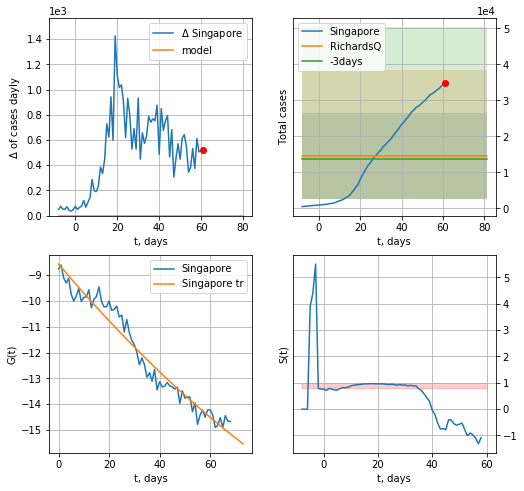

Singapore data at: 2020-05-31
+3 day model MAPE: 0.064735
model: RichardsQ
coeffs: [ 1.45768286e+04  7.76069600e+00 -2.29761886e+03  2.05206919e+03
 -3.83127631e+00]
rational stdev: 0.819292
forecast at the end of period: +20 days
	 deltaDaycases: 0
	 total cases: 14576 ± 11942
	 total death: 9 ± 22
trend coefficient of determination: 0.956733
 intercept_: -8.57025554133001
 coeffs_: [ 0.         -0.11522651  0.00027109]


In [175]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,12*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,50*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


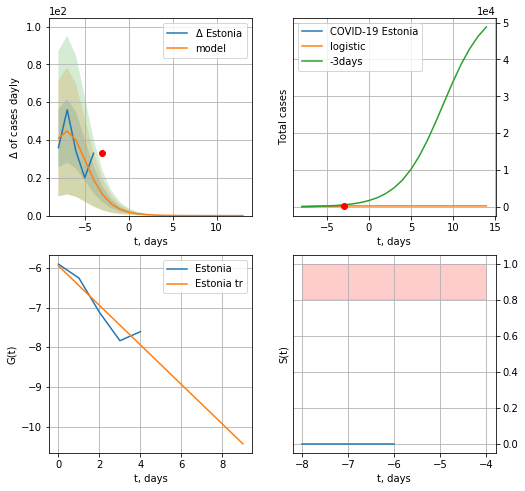

Estonia data at: 2020-05-31
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  10 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


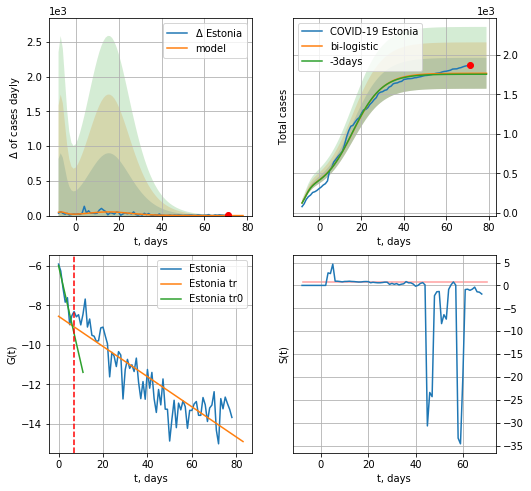

Estonia data at: 2020-05-31
+3 day model MAPE: 0.0066220500109086125
model: bi-logistic
coeffs:  [1.49021192e+03 1.42086921e-01 1.59184564e+01] [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.11081089496141658
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  1767 ± 195
	 total death:  64 ± 21
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.770210
 intercept: -8.551322
 slope: -0.076521


In [176]:
shift = 1.0
x = forecast('Estonia',dfES[1:7],d1,17,1.)
xx = forecast2('Estonia',dfES[1:],d1,12*6-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)

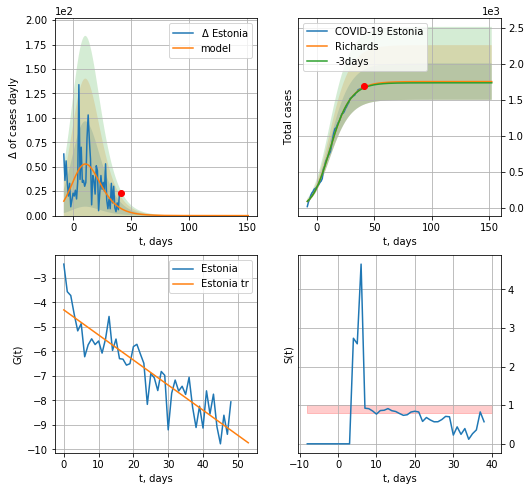

Estonia data at: 2020-05-31
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 63 ± 27
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


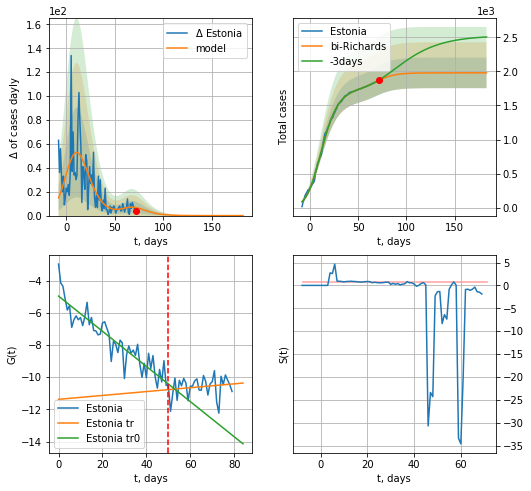

Estonia data at: 2020-05-31
+3 day model MAPE: 0.003628
model: bi-Richards
coeffs: [2.28106403e+02 1.63156287e-01 6.45701280e+01 6.29384043e-01]
rational stdev: 0.113532
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 1978 ± 224
	 total death: 71 ± 24
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.836423
 intercept: -4.962801
 slope: -0.109238
trend coefficient of determination: 0.026942
 intercept: -11.374798
 slope: 0.012033


In [177]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*25-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


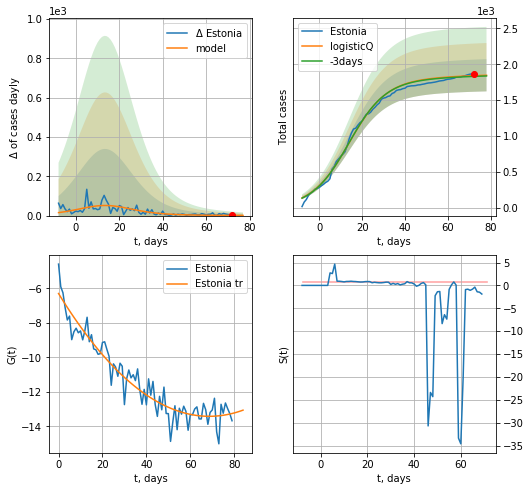

Estonia data at: 2020-05-31
+3 day model MAPE: 0.005348
model: logisticQ
coeffs: [ 1.78609491e+03  7.42142280e-07  1.38516015e+01 -1.54358722e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.121643
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 1846 ± 224
	 total death: 67 ± 24
trend coefficient of determination: 0.908026
 intercept_: -6.302244612708839
 coeffs_: [ 0.         -0.20748331  0.00151156]


In [178]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
          date   cases  active  death
81 2020-05-27  1061.0     296   24.0
82 2020-05-28  1064.0     295   24.0
83 2020-05-29  1065.0     296   24.0
84 2020-05-30  1066.0     297   24.0
85 2020-05-31  1066.0     297   24.0


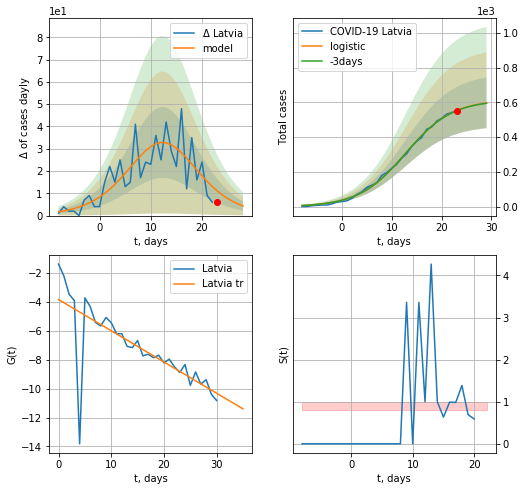

Latvia data at: 2020-05-31
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +6 days
	 deltaDaycases:  4
	 total cases:  597 ± 145
	 total death:  13 ± 9
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


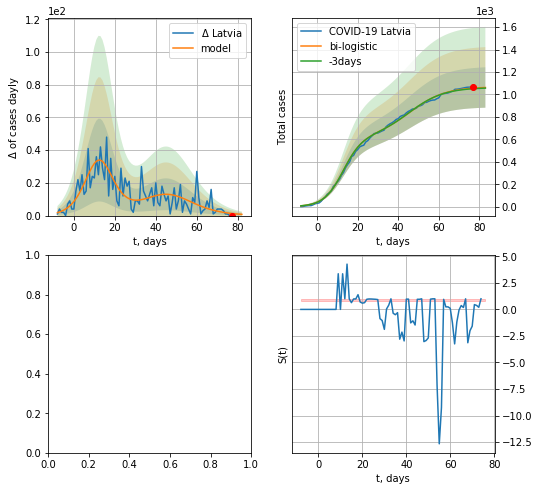

In [179]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

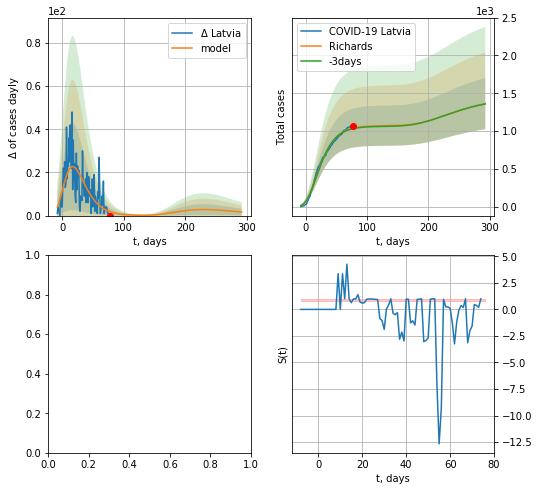

In [180]:
x = forecastRR('Latvia',dfLV[:],d1,7*40-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


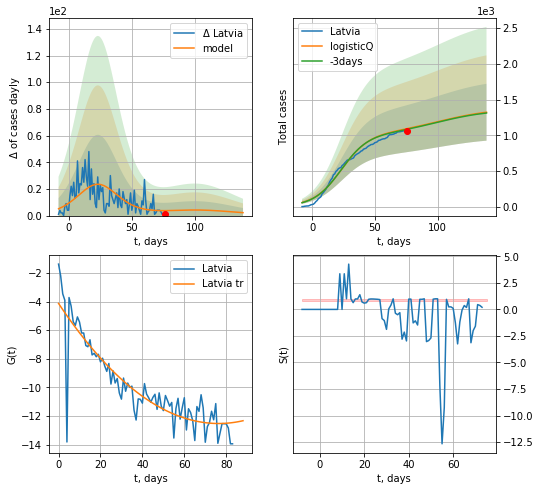

Latvia data at: 2020-05-30
+3 day model MAPE: 0.008455
model: logisticQ
coeffs: [ 1.01771677e+03  2.91307472e-07  2.34028053e+01 -3.11297504e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301125
forecast at the end of period: +63 days
	 deltaDaycases: 2
	 total cases: 1321 ± 398
	 total death: 29 ± 26
trend coefficient of determination: 0.792325
 intercept_: -4.133324924234106
 coeffs_: [ 0.         -0.21975093  0.00143873]


In [408]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


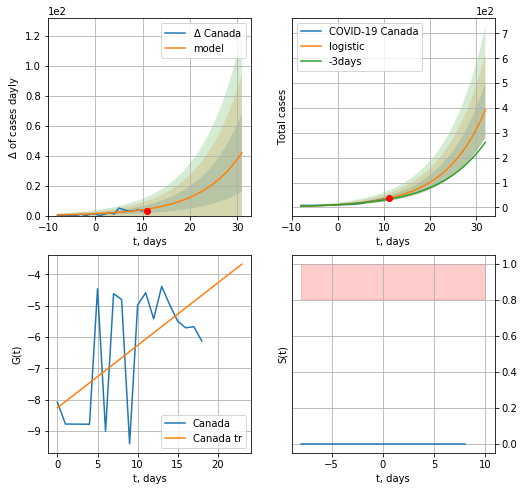

Canada data at: 2020-05-31
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  31 ± 26
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


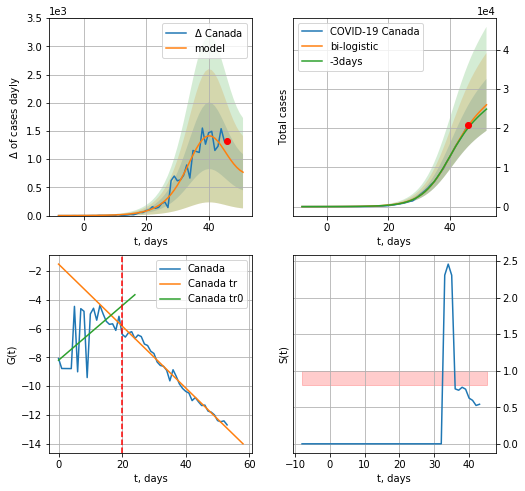

Canada data at: 2020-05-31
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +6 days
	 deltaDaycases:  768
	 total cases:  25947 ± 6614
	 total death:  2081 ± 1591
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


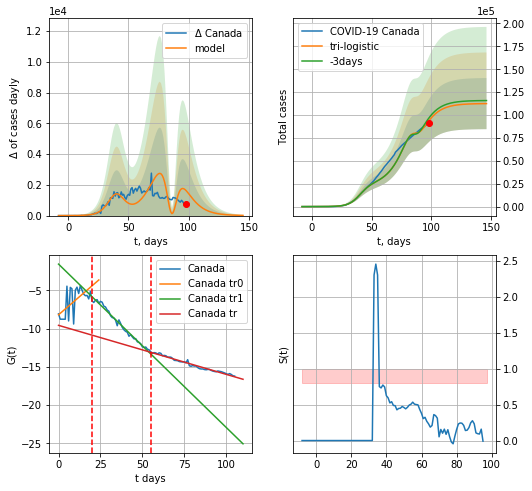

Canada data at: 2020-05-31
+3 day model MAPE: 0.03132565369489082
model: tri-logistic
coeffs:  [-3.67458253e+04  3.58258319e-01  8.62793542e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.24817078580006496
forecast at the end of period: +48 days
	 deltaDaycases:  11
	 total cases:  112511 ± 27921
	 total death:  9024 ± 6718
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.974177
 intercept: -9.577129
 slope: -0.064068


In [181]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,10*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date    cases  active   death
102 2020-05-27  87519.0   34590  6765.0
103 2020-05-28  88512.0   34795  6877.0
104 2020-05-29  89418.0   34921  6979.0
105 2020-05-30  90190.0   35014  7073.0
106 2020-05-31  90947.0   34773  7295.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


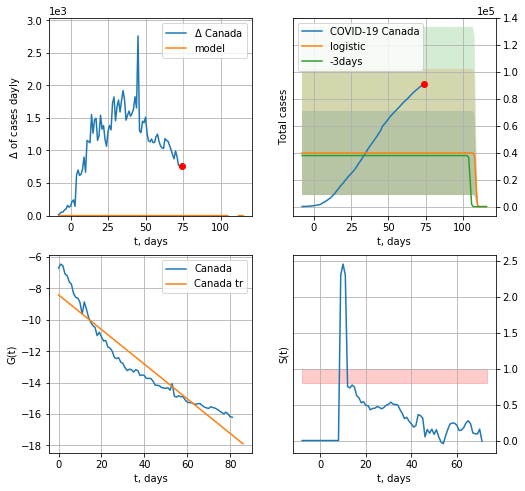

Canada data at: 2020-05-31
+3 day model MAPE: 0.05001188979481467
model: logistic
coeffs:  [ 3.97268193e+04 -3.36837838e+00  1.08870969e+02]
rational stdev:  0.7844040242668164
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.905392
 intercept: -8.406659
 slope: -0.110380


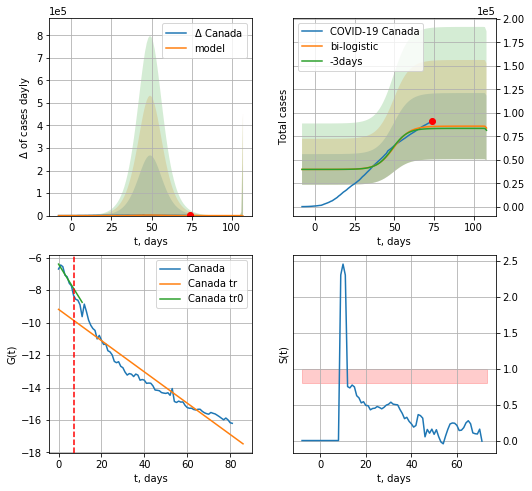

Canada data at: 2020-05-31
+3 day model MAPE: 0.026774176532654594
model: bi-logistic
coeffs:  [4.60974132e+04 1.95236132e-01 4.95717253e+01] [ 3.97268193e+04 -3.36837838e+00  1.08870969e+02]
rational stdev:  0.4106638547581877
forecast at the end of period: +34 days
	 deltaDaycases:  -1933
	 total cases:  83817 ± 34420
	 total death:  6723 ± 8282
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.918747
 intercept: -9.181363
 slope: -0.096387


In [182]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31-24,cases='cases')

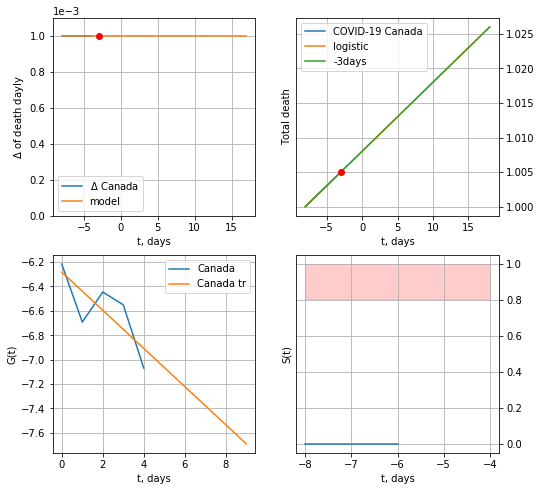

Canada data at: 2020-05-31
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


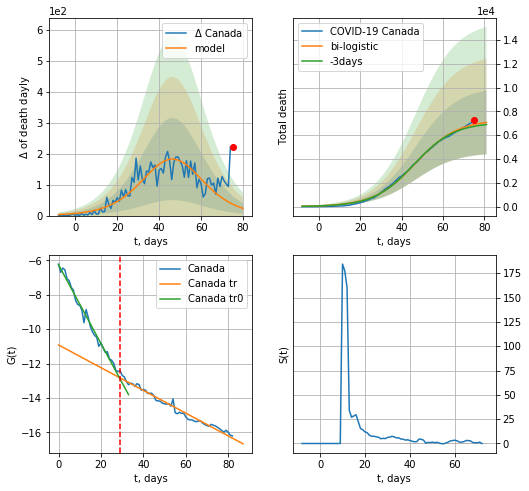

Canada data at: 2020-05-31
+3 day model MAPE: 0.0231385451047395
model: bi-logistic
coeffs:  [7.29646290e+03 1.00026299e-01 4.68025531e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.37834126233583115
forecast at the end of period: +6 days
	 deltaDaydeath:  23
	 total death:  7066 ± 2673
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.974126
 intercept: -10.918455
 slope: -0.066105


In [183]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


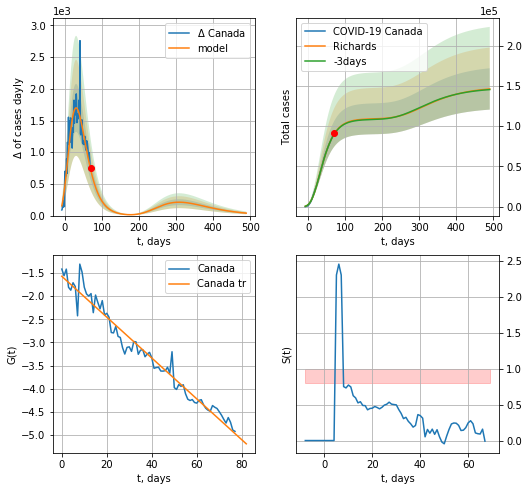

Canada data at: 2020-05-31
+3 day model MAPE: 0.003201
model: Richards
coeffs: [ 1.09297418e+05  3.55274771e+00 -7.30607073e+01  1.19699884e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.175431
forecast at the end of period: +420 days
	 deltaDaycases: 38
	 total cases: 146168 ± 25642
	 total death: 11724 ± 6170
trend coefficient of determination: 0.964529
 intercept: -1.569156
 slope: -0.044212


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


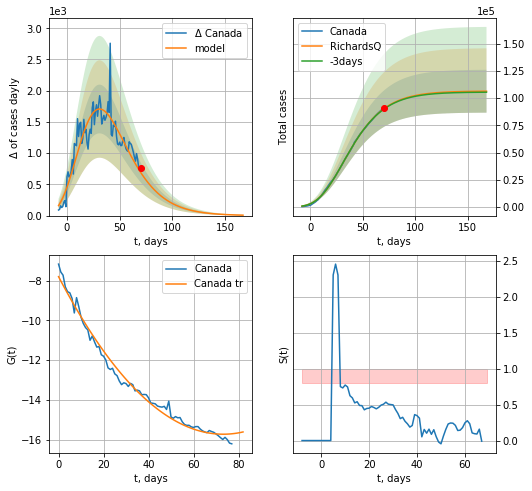

Canada data at: 2020-05-31
+3 day model MAPE: 0.003899
model: RichardsQ
coeffs: [ 1.06491263e+05  1.10426473e-02 -1.18882111e+02 -8.85931086e+02
  3.70717928e-03]
rational stdev: 0.185334
forecast at the end of period: +98 days
	 deltaDaycases: 6
	 total cases: 106370 ± 19714
	 total death: 8532 ± 4743
trend coefficient of determination: 0.986771
 intercept_: -7.805543974435029
 coeffs_: [ 0.         -0.21625019  0.00147643]


In [184]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


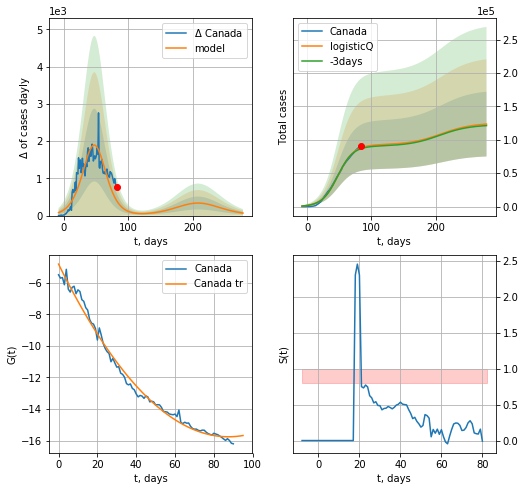

Canada data at: 2020-05-31
+3 day model MAPE: 0.015129
model: logisticQ
coeffs: [ 9.24946772e+04  6.21756531e-07  4.78657280e+01 -1.31685656e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392428
forecast at the end of period: +196 days
	 deltaDaycases: 68
	 total cases: 123543 ± 48482
	 total death: 9909 ± 11665
trend coefficient of determination: 0.990103
 intercept_: -4.814827280031921
 coeffs_: [ 0.         -0.25024278  0.00143021]


In [185]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
          date  cases  active   death
86 2020-05-27  31292   11587  1356.0
87 2020-05-28  31596   11590  1369.0
88 2020-05-29  31946   11652  1383.0
89 2020-05-30  32203   11621  1396.0
90 2020-05-31  32500   11681  1410.0


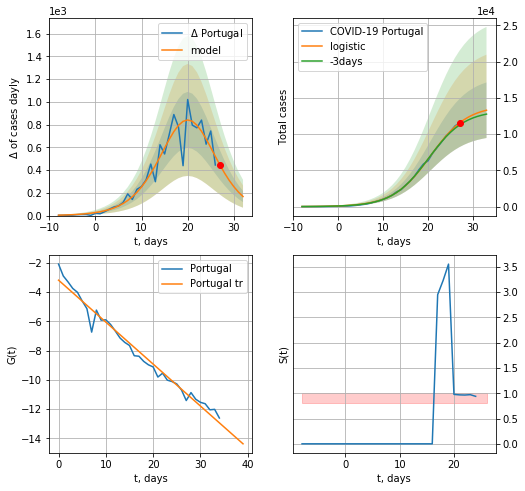

Portugal data at: 2020-05-31
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +6 days
	 deltaDaycases:  167
	 total cases:  13292 ± 3829
	 total death:  576 ± 497
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


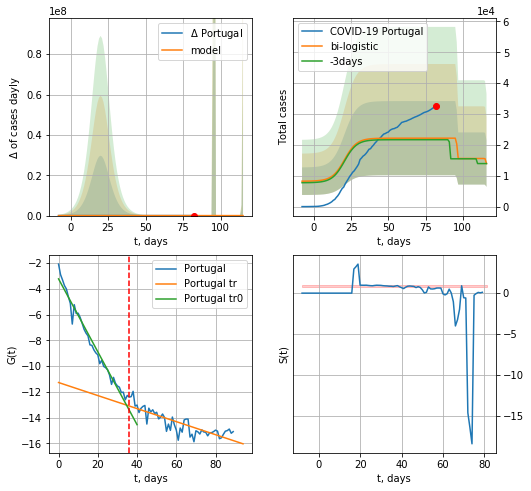

Portugal data at: 2020-05-31
+3 day model MAPE: 0.022988326308419658
model: bi-logistic
coeffs:  [6581.50098673   -9.65016675   96.09485744] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5419352172482623
forecast at the end of period: +34 days
	 deltaDaycases:  -1567
	 total cases:  13945 ± 7557
	 total death:  605 ± 983
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.692580
 intercept: -11.271826
 slope: -0.050627


In [186]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,10*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


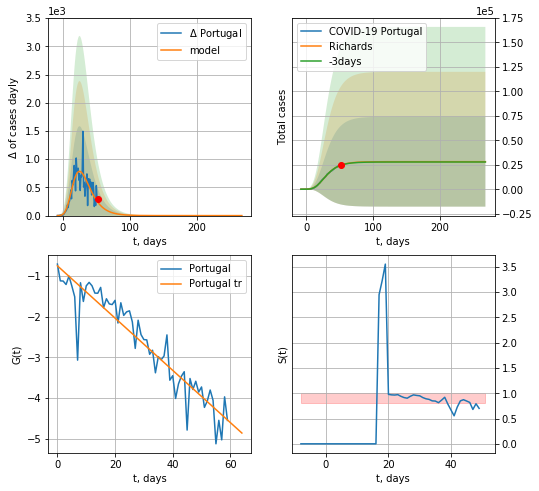

Portugal data at: 2020-05-31
+3 day model MAPE: 0.005985
model: Richards
coeffs: [ 2.81684838e+04  5.82693578e+00 -3.14773431e+01  1.30834824e-02]
rational stdev: 1.629434
forecast at the end of period: +216 days
	 deltaDaycases: 0
	 total cases: 28168 ± 45898
	 total death: 1222 ± 5973
trend coefficient of determination: 0.876328
 intercept: -0.753757
 slope: -0.064134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


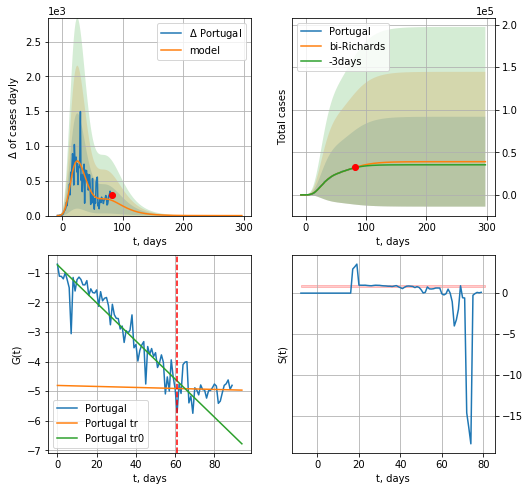

Portugal data at: 2020-05-31
+3 day model MAPE: 0.012466
model: bi-Richards
coeffs: [ 1.08322413e+04  4.67765093e+00 -1.41799859e+01  1.04281716e-02]
rational stdev: 1.352598
forecast at the end of period: +216 days
	 deltaDaycases: 0
	 total cases: 39000 ± 52751
	 total death: 1692 ± 6865
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.880598
 intercept: -0.732332
 slope: -0.064349
trend coefficient of determination: 0.001201
 intercept: -4.808655
 slope: -0.001679


In [187]:
vL=61
x = forecastRR('Portugal',dfPT[:vL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


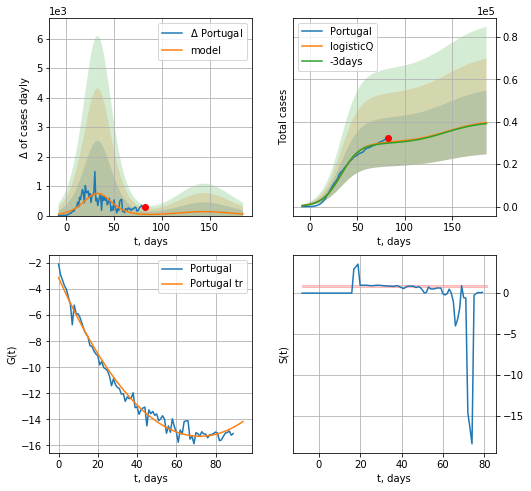

Portugal data at: 2020-05-31
+3 day model MAPE: 0.016390
model: logisticQ
coeffs: [ 3.01664955e+04  3.73704195e-07  3.32428834e+01 -2.66551225e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378777
forecast at the end of period: +104 days
	 deltaDaycases: 54
	 total cases: 39643 ± 15015
	 total death: 1719 ± 1953
trend coefficient of determination: 0.984543
 intercept_: -3.118337732336002
 coeffs_: [ 0.         -0.3382532   0.00234932]


In [188]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

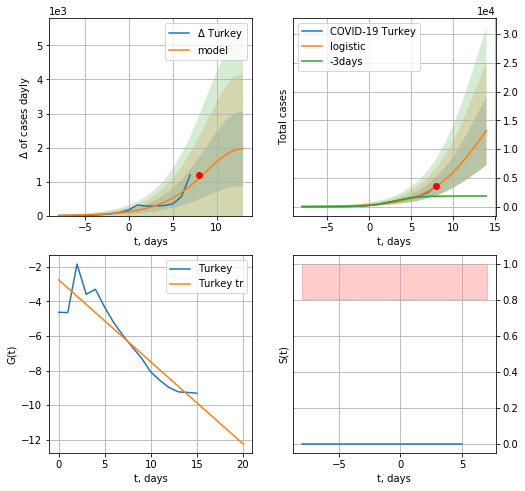

Turkey data at: 2020-05-31
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +6 days
	 deltaDaycases:  1970
	 total cases:  13211 ± 6013
	 total death:  365 ± 498
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


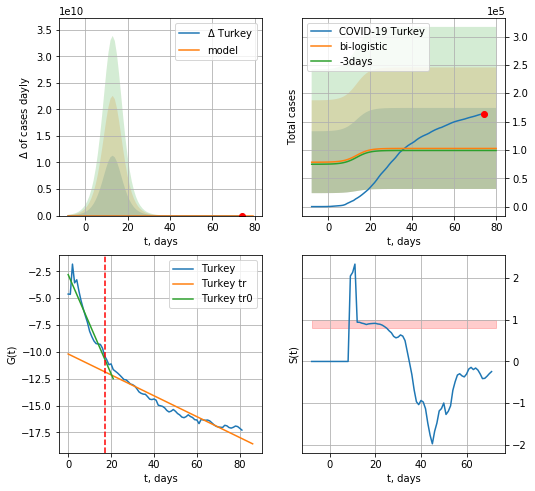

Turkey data at: 2020-05-31
+3 day model MAPE: 0.03606552890593783
model: bi-logistic
coeffs:  [ 6.26295402e+04 -2.97825134e+00  9.21091270e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6967752834773744
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  102554 ± 71457
	 total death:  2840 ± 5936
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.920741
 intercept: -10.199299
 slope: -0.097192


In [189]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*10-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,10*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


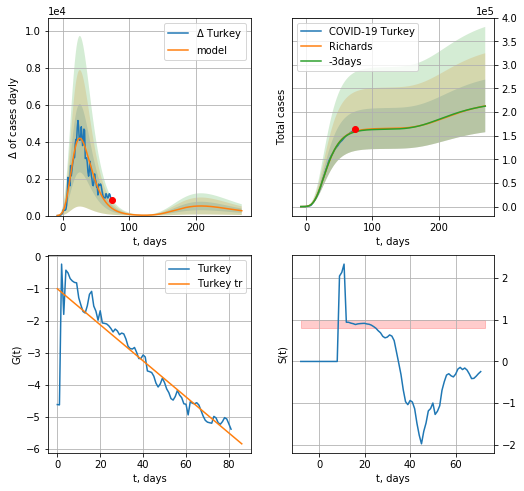

Turkey data at: 2020-05-31
+3 day model MAPE: 0.007564
model: Richards
coeffs: [ 1.65598603e+05  7.68475562e+00 -4.20783724e+01  8.96943602e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.261491
forecast at the end of period: +196 days
	 deltaDaycases: 263
	 total cases: 213132 ± 55732
	 total death: 5902 ± 4629
trend coefficient of determination: 0.807717
 intercept: -1.009769
 slope: -0.056139


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


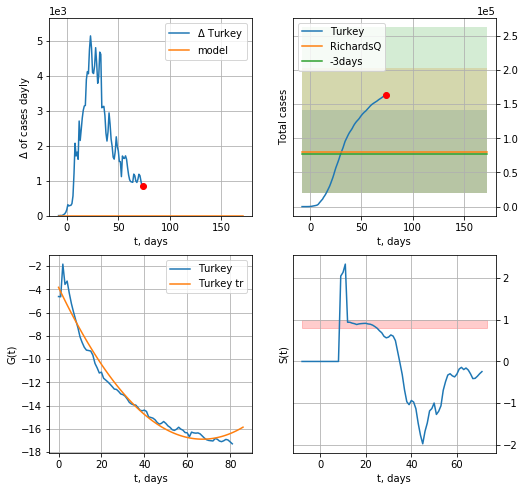

Turkey data at: 2020-05-31
+3 day model MAPE: 0.040018
model: RichardsQ
coeffs: [ 8.04775183e+04  1.99490315e+00 -7.98670286e+02  6.65461270e+02
 -1.28260074e+00]
rational stdev: 0.756958
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 80477 ± 60918
	 total death: 2228 ± 5059
trend coefficient of determination: 0.973943
 intercept_: -3.83366343642712
 coeffs_: [ 0.         -0.3888546   0.00289672]


In [190]:
x = forecastRR('Turkey',dfTR[:],d1,28*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


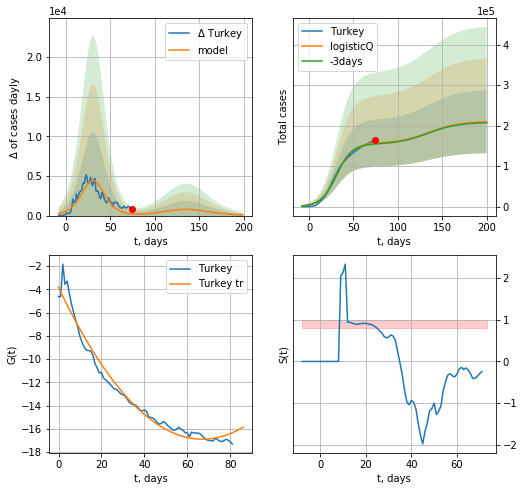

Turkey data at: 2020-05-31
+3 day model MAPE: 0.013366
model: logisticQ
coeffs: [ 1.55920577e+05  5.61225611e-07  3.10987427e+01 -2.02021094e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371583
forecast at the end of period: +126 days
	 deltaDaycases: 77
	 total cases: 209780 ± 77950
	 total death: 5809 ± 6475
trend coefficient of determination: 0.973943
 intercept_: -3.83366343642712
 coeffs_: [ 0.         -0.3888546   0.00289672]


In [191]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [192]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.0225140712945591

In [193]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

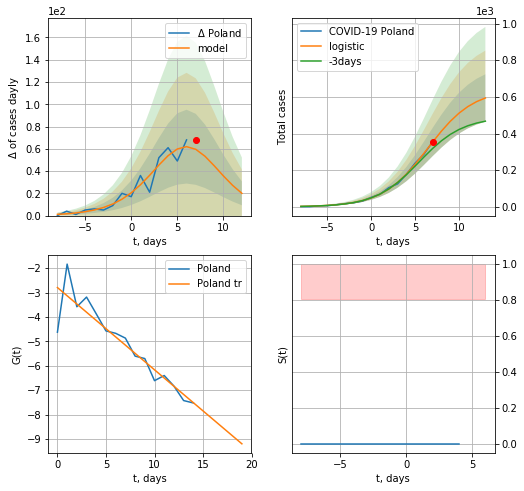

Poland data at: 2020-05-31
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +6 days
	 deltaDaycases:  19
	 total cases:  593 ± 129
	 total death:  26 ± 16
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


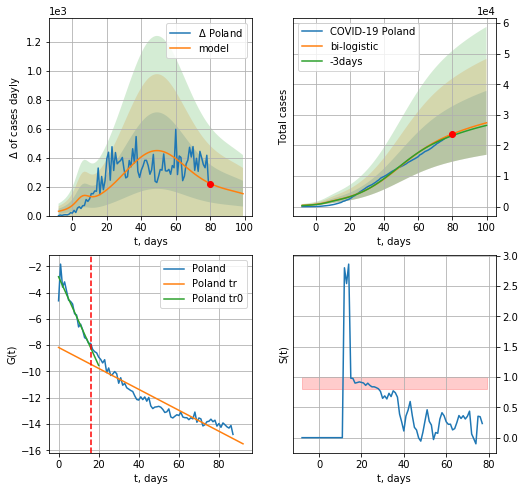

Poland data at: 2020-05-31
+3 day model MAPE: 0.02385402236700971
model: bi-logistic
coeffs:  [2.40851956e+04 7.24224986e-02 4.88693592e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3814568610273721
forecast at the end of period: +20 days
	 deltaDaycases:  150
	 total cases:  27403 ± 10453
	 total death:  1225 ± 1401
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.887961
 intercept: -8.170660
 slope: -0.079655


In [194]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*10-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


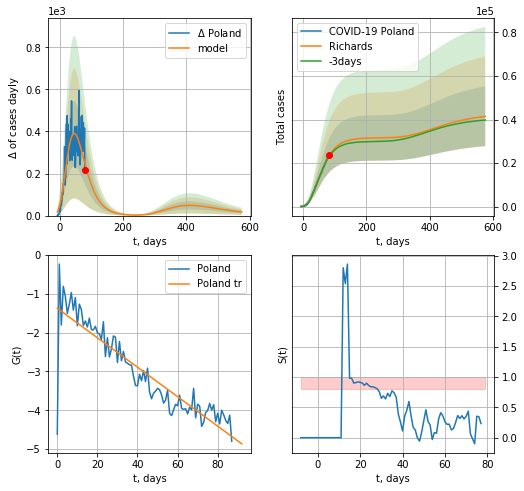

Poland data at: 2020-05-31
+3 day model MAPE: 0.018303
model: Richards
coeffs: [ 3.16019045e+04  3.78182580e+00 -9.40045366e+01  8.91810762e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.330332
forecast at the end of period: +496 days
	 deltaDaycases: 17
	 total cases: 41462 ± 13696
	 total death: 1854 ± 1837
trend coefficient of determination: 0.799572
 intercept: -1.377122
 slope: -0.037892


In [195]:
x =  forecastRR('Poland',dfPL[:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


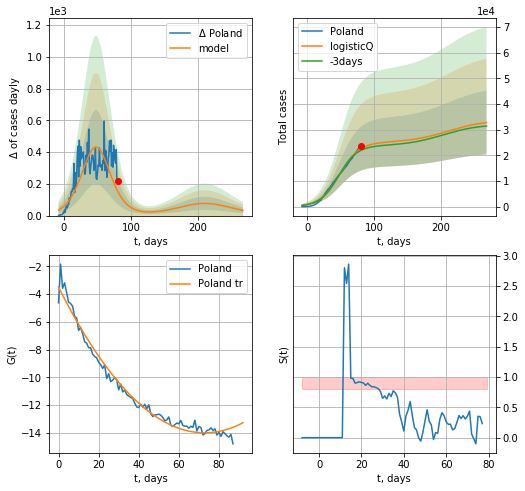

Poland data at: 2020-05-31
+3 day model MAPE: 0.031344
model: logisticQ
coeffs: [ 2.49713717e+04  4.42560866e-07  4.82762685e+01 -1.55990386e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378992
forecast at the end of period: +188 days
	 deltaDaycases: 32
	 total cases: 32761 ± 12416
	 total death: 1465 ± 1665
trend coefficient of determination: 0.979870
 intercept_: -3.4885059367285267
 coeffs_: [ 0.         -0.28840426  0.00198016]


In [196]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
          date    cases  active  death
95 2020-05-27  16793.0    1942  281.0
96 2020-05-28  16872.0    1909  284.0
97 2020-05-29  16987.0    1927  284.0
98 2020-05-30  17024.0    1928  284.0
99 2020-05-31  17071.0    1974  285.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


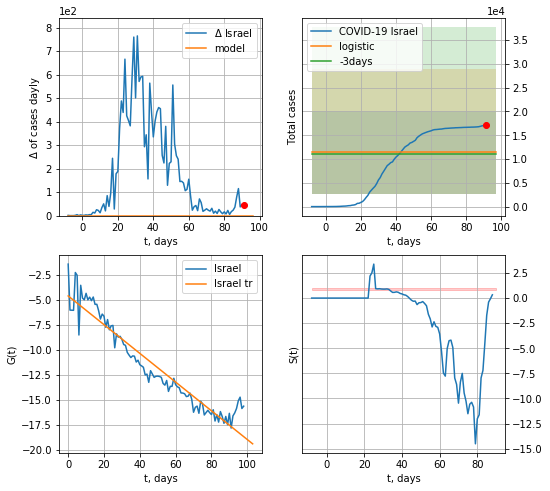

Israel data at: 2020-05-31
+3 day model MAPE: 0.027573965669405526
model: logistic
coeffs:  [ 9.11706071e+03 -4.20093573e+00  1.19669188e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7717174855720911
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  11396 ± 8794
	 total death:  190 ± 439
trend coefficient of determination: 0.911339
 intercept: -4.579521
 slope: -0.144062


In [197]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


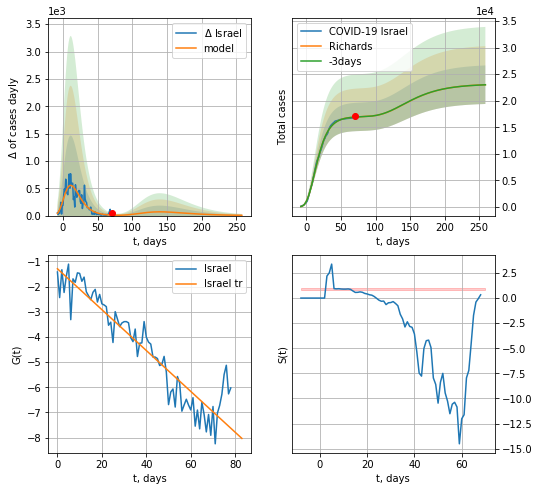

Israel data at: 2020-05-31
+3 day model MAPE: 0.000912
model: Richards
coeffs: [ 1.70167351e+04  6.69643267e+00 -3.69902007e+01  1.32857015e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.157667
forecast at the end of period: +188 days
	 deltaDaycases: 5
	 total cases: 23019 ± 3629
	 total death: 384 ± 181
trend coefficient of determination: 0.872786
 intercept: -1.291422
 slope: -0.081186


In [198]:
x = forecastRR('Israel',dfIS[20:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


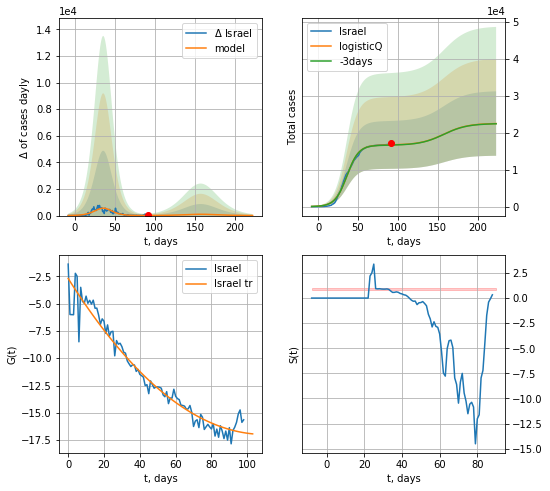

Israel data at: 2020-05-31
+3 day model MAPE: 0.003002
model: logisticQ
coeffs: [ 1.66270471e+04  7.57720089e-07  3.61578582e+01 -1.77499609e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.387853
forecast at the end of period: +132 days
	 deltaDaycases: 4
	 total cases: 22446 ± 8705
	 total death: 374 ± 435
trend coefficient of determination: 0.951732
 intercept_: -2.700233297396032
 coeffs_: [ 0.         -0.26031322  0.00118627]


In [199]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


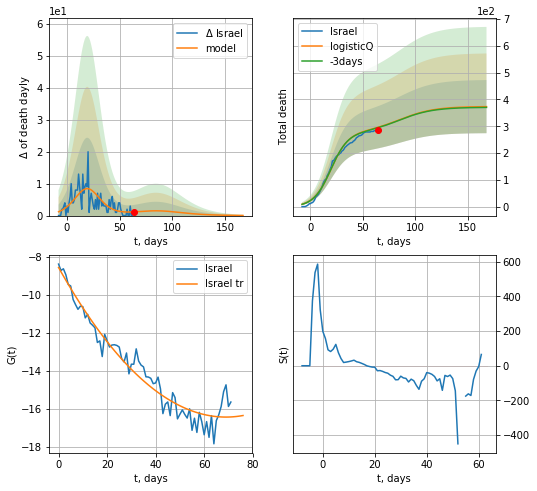

Israel data at: 2020-05-31
+3 day model MAPE: 0.005659
model: logisticQ
coeffs: [ 2.76190452e+02  7.40010552e-07  1.95838772e+01 -1.63420199e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.265114
forecast at the end of period: +104 days
	 total death: 373 ± 98
trend coefficient of determination: 0.941812
 intercept_: -8.560471957180273
 coeffs_: [ 0.         -0.22827765  0.00165502]


In [200]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


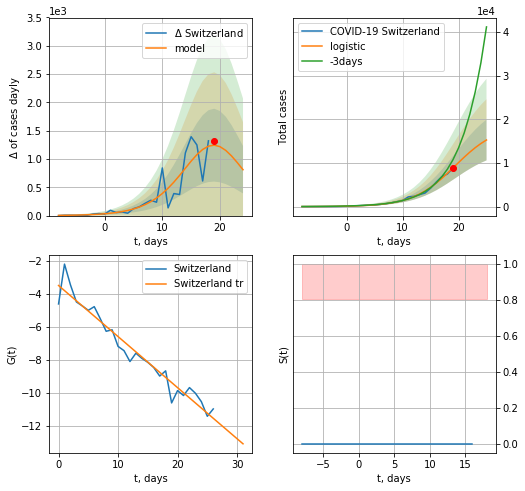

Switzerland data at: 2020-05-31
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +6 days
	 deltaDaycases:  810
	 total cases:  15272 ± 4674
	 total death:  950 ± 872
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


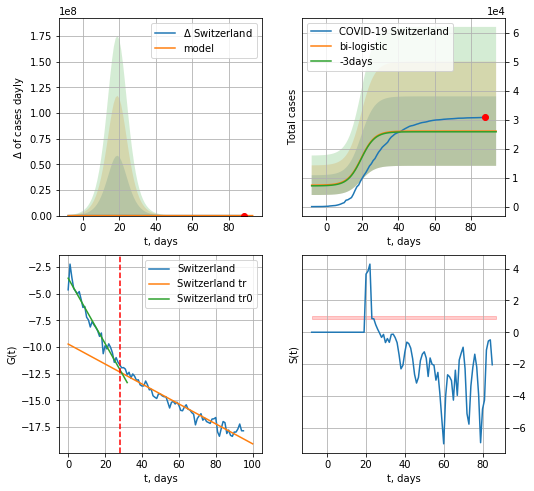

Switzerland data at: 2020-05-31
+3 day model MAPE: 0.009564104215322316
model: bi-logistic
coeffs:  [ 5.93502842e+03 -1.07300893e+00  1.07745927e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.459868542083592
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  26124 ± 12014
	 total death:  1625 ± 2241
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.947445
 intercept: -9.709930
 slope: -0.093526


In [201]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*10-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


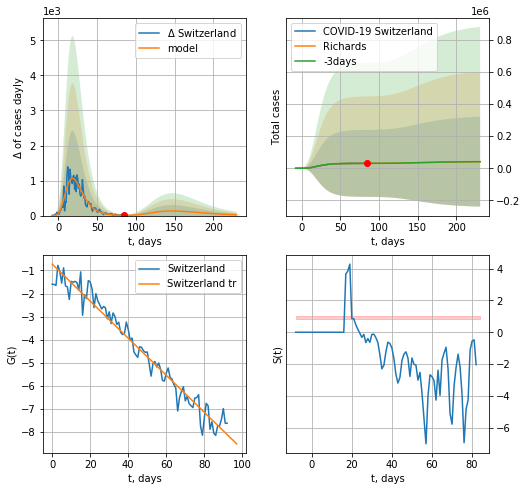

Switzerland data at: 2020-05-31
+3 day model MAPE: 0.000714
model: Richards
coeffs: [ 3.07254506e+04  8.02497842e+00 -2.81150548e+01  1.18146241e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 6.795071
forecast at the end of period: +146 days
	 deltaDaycases: 22
	 total cases: 41142 ± 279563
	 total death: 2559 ± 52165
trend coefficient of determination: 0.962622
 intercept: -0.723081
 slope: -0.080381


In [202]:
x = forecastRR('Switzerland',dfSZ[3:],d1,7*30-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


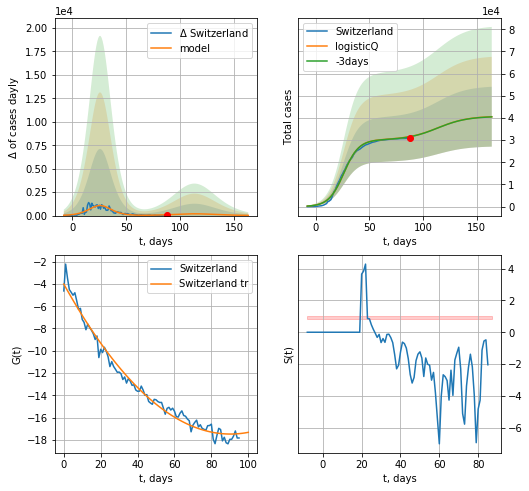

Switzerland data at: 2020-05-31
+3 day model MAPE: 0.001869
model: logisticQ
coeffs: [ 3.01637607e+04  6.83695159e-07  2.60572214e+01 -2.08677625e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332951
forecast at the end of period: +76 days
	 deltaDaycases: 20
	 total cases: 40568 ± 13507
	 total death: 2523 ± 2520
trend coefficient of determination: 0.982714
 intercept_: -4.008774252120036
 coeffs_: [ 0.         -0.29838064  0.00165141]


In [203]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=True,xcoef=koreaCoeffs)

In [204]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
78 2020-05-27  21905.0   13252  658.0
79 2020-05-28  22382.0   13274  669.0
80 2020-05-29  22811.0   13198  679.0
81 2020-05-30  23204.0   13197  696.0
82 2020-05-31  23672.0   13426  708.0


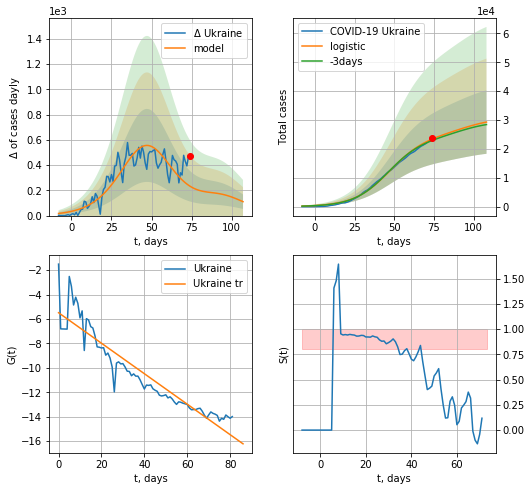

Ukraine data at: 2020-05-31
+3 day model MAPE: 0.021582743068323494
model: logistic
coeffs:  [2.46660995e+04 8.87678190e-02 4.72624574e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3751852010186362
forecast at the end of period: +34 days
	 deltaDaycases:  110
	 total cases:  29289 ± 10988
	 total death:  876 ± 985
trend coefficient of determination: 0.873713
 intercept: -5.486047
 slope: -0.124869


In [205]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


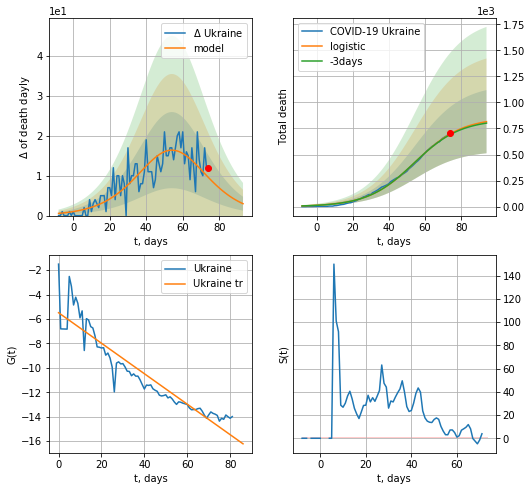

Ukraine data at: 2020-05-31
+3 day model MAPE: 0.009733706022792376
model: logistic
coeffs:  [8.54445864e+02 7.68467539e-02 5.45485055e+01]
rational stdev:  0.37193020357109946
forecast at the end of period: +20 days
	 total death:  815 ± 303
trend coefficient of determination: 0.873713
 intercept: -5.486047
 slope: -0.124869


In [206]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


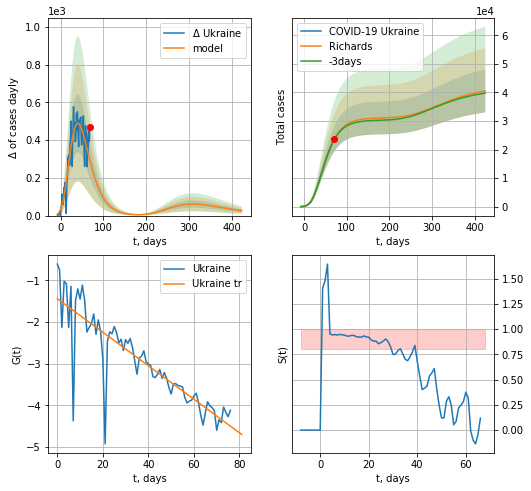

Ukraine data at: 2020-05-31
+3 day model MAPE: 0.008958
model: Richards
coeffs: [ 3.11157007e+04  2.20861771e+00 -5.05487116e+01  1.95587114e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.184963
forecast at the end of period: +356 days
	 deltaDaycases: 25
	 total cases: 40505 ± 7491
	 total death: 1211 ± 671
trend coefficient of determination: 0.748854
 intercept: -1.439147
 slope: -0.040295


In [207]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*60-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


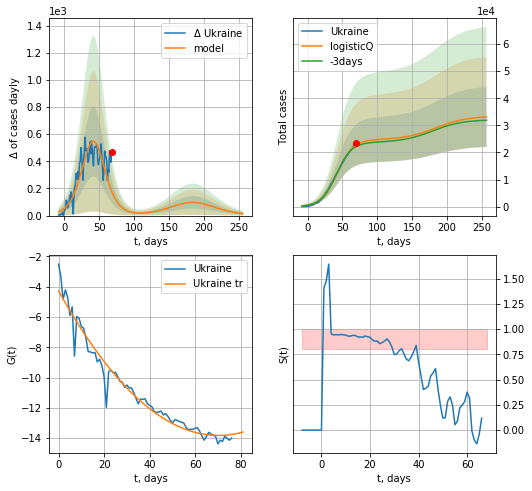

Ukraine data at: 2020-05-31
+3 day model MAPE: 0.025657
model: logisticQ
coeffs: [ 2.46861449e+04  1.04666517e-06  4.22872673e+01 -8.45857722e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334884
forecast at the end of period: +188 days
	 deltaDaycases: 14
	 total cases: 33099 ± 11084
	 total death: 989 ± 993
trend coefficient of determination: 0.959918
 intercept_: -4.275708582521502
 coeffs_: [ 0.         -0.27183623  0.00193569]


In [208]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*36-dT,addpred=True,xcoef=koreaCoeffs)

In [209]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

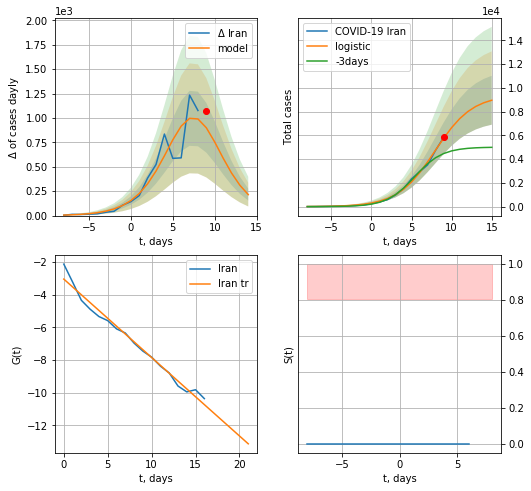

Iran data at: 2020-05-31
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +6 days
	 deltaDaycases:  214
	 total cases:  8956 ± 2057
	 total death:  461 ± 317
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


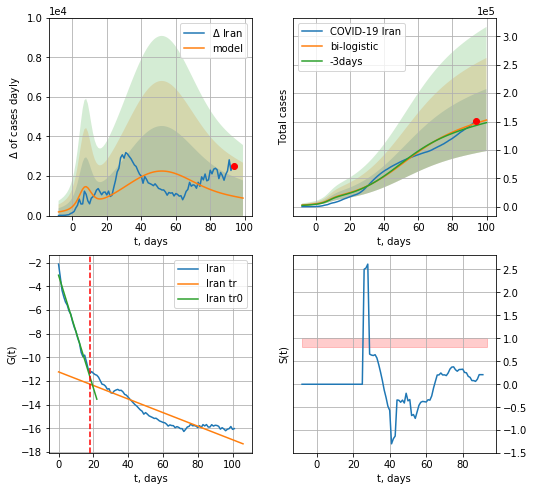

Iran data at: 2020-05-31
+3 day model MAPE: 0.028233869047138357
model: bi-logistic
coeffs:  [1.33429553e+05 6.53390964e-02 5.13658171e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35846227934017405
forecast at the end of period: +6 days
	 deltaDaycases:  883
	 total cases:  152670 ± 54726
	 total death:  7859 ± 8451
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.834507
 intercept: -11.230505
 slope: -0.057359


In [210]:
x = forecast('Iran',dfIN[:18],d1,7*10-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


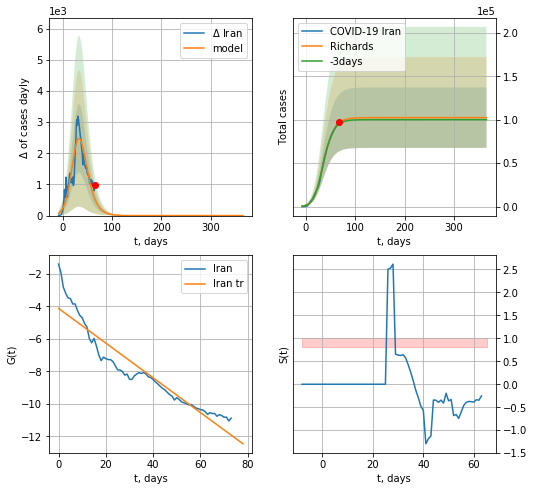

Iran data at: 2020-05-31
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +300 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 5275 ± 5379
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


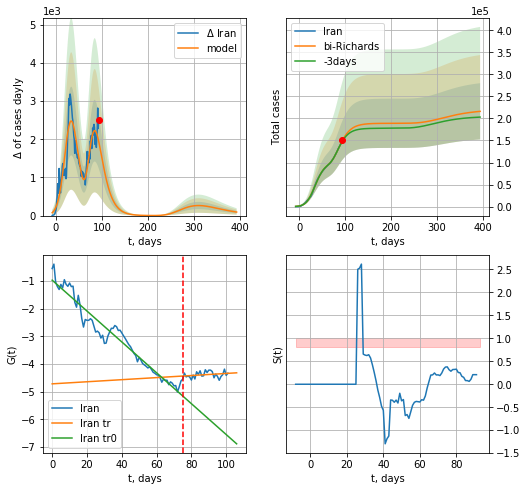

Iran data at: 2020-05-31
+3 day model MAPE: 0.012158
model: bi-Richards
coeffs: [8.65631126e+04 3.44175759e+00 2.69846160e+01 1.94476324e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.295549
forecast at the end of period: +300 days
	 deltaDaycases: 92
	 total cases: 216090 ± 63865
	 total death: 11123 ± 9862
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949211
 intercept: -0.963131
 slope: -0.055892
trend coefficient of determination: 0.064840
 intercept: -4.716240
 slope: 0.003762


In [211]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,52*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


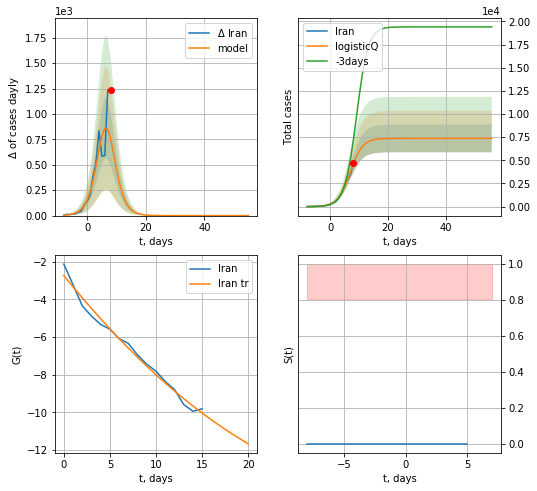

Iran data at: 2020-05-31
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +48 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 379 ± 230
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


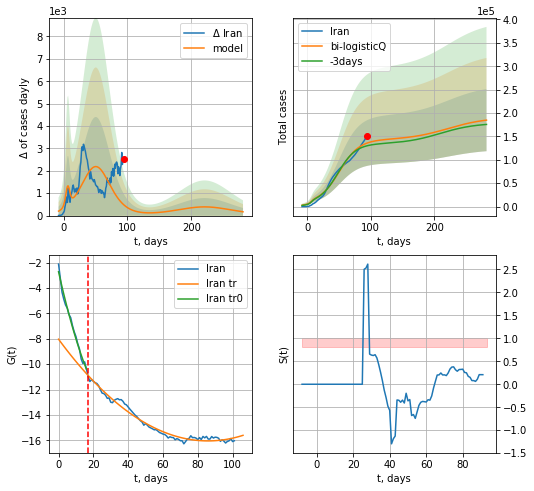

Iran data at: 2020-05-31
+3 day model MAPE: 0.045188
model: bi-logisticQ
coeffs: [ 1.35374754e+05  1.76795155e-07  5.07599748e+01 -3.64986911e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359297
forecast at the end of period: +188 days
	 deltaDaycases: 168
	 total cases: 184834 ± 66410
	 total death: 9514 ± 10255
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.977919
 intercept_: -8.030367470935271
 coeffs_: [ 0.         -0.18649009  0.00108576]


In [212]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
          date     cases  active   death
88 2020-05-27  370680.0  224504  3968.0
89 2020-05-28  379051.0  223916  4142.0
90 2020-05-29  387623.0  223992  4374.0
91 2020-05-30  396575.0  224551  4555.0
92 2020-05-31  405843.0  229267  4693.0


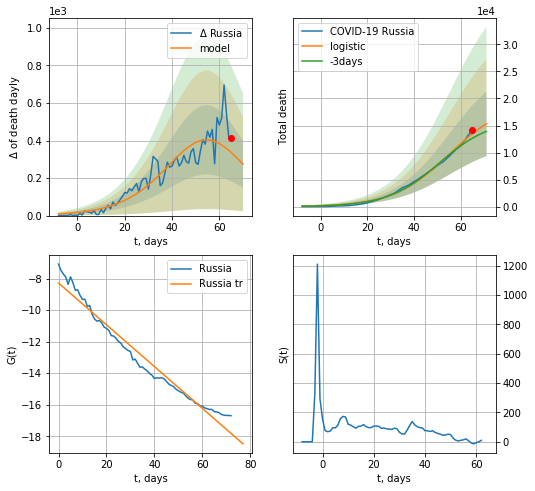

Russia data at: 2020-05-31
+3 day model MAPE: 0.07160468771333729
model: logistic
coeffs:  [1.94060098e+04 8.32009799e-02 5.50899216e+01]
rational stdev:  0.3895256755374385
forecast at the end of period: +6 days
	 total death:  15326 ± 5970
trend coefficient of determination: 0.965564
 intercept: -8.277571
 slope: -0.132496


In [213]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


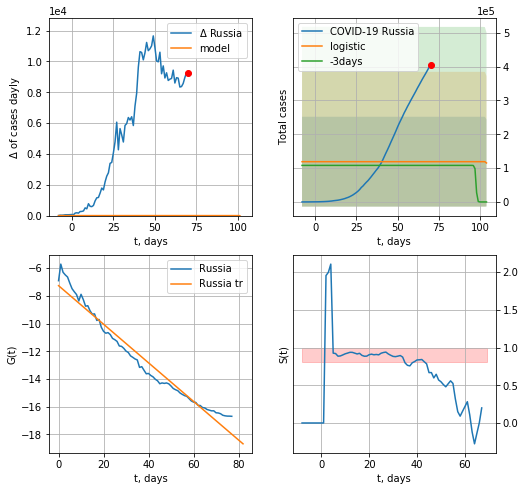

Russia data at: 2020-05-31
+3 day model MAPE: 0.10149672645383064
model: logistic
coeffs:  [ 1.18968734e+05 -3.71429388e+00  1.04916855e+02]
rational stdev:  1.115492927093503
forecast at the end of period: +34 days
	 deltaDaycases:  -3725
	 total cases:  115146 ± 128445
	 total death:  1331 ± 4454
trend coefficient of determination: 0.962857
 intercept: -7.259109
 slope: -0.139283


In [214]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


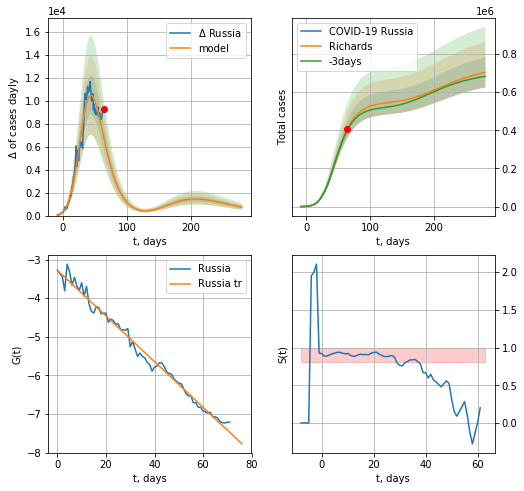

Russia data at: 2020-05-31
+3 day model MAPE: 0.010548
model: Richards
coeffs: [5.46773060e+05 2.21581827e-01 2.21031401e+01 2.65395540e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.112555
forecast at the end of period: +216 days
	 deltaDaycases: 733
	 total cases: 703995 ± 79238
	 total death: 8140 ± 2748
trend coefficient of determination: 0.986957
 intercept: -3.278620
 slope: -0.059070


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


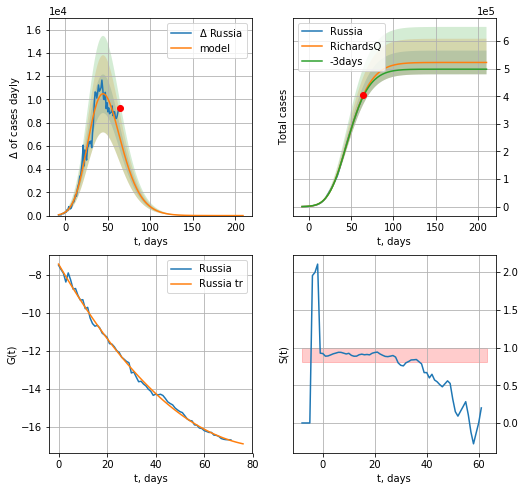

Russia data at: 2020-05-31
+3 day model MAPE: 0.011045
model: RichardsQ
coeffs: [ 5.22733558e+05  5.31160232e-03 -9.94342500e+01 -5.32878409e+01
  4.37731851e-02]
rational stdev: 0.082158
forecast at the end of period: +146 days
	 deltaDaycases: 0
	 total cases: 522733 ± 42946
	 total death: 6044 ± 1489
trend coefficient of determination: 0.997691
 intercept_: -7.420955248752485
 coeffs_: [ 0.         -0.22159606  0.00127487]


In [215]:
x = forecastRR('Russia',dfRS[20:],d1,40*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


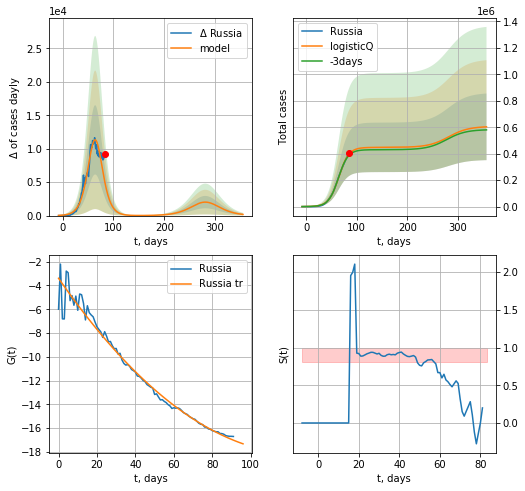

Russia data at: 2020-05-31
+3 day model MAPE: 0.023438
model: logisticQ
coeffs: [ 4.47931611e+05  2.09347032e-06  6.45004622e+01 -4.82937430e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.417596
forecast at the end of period: +272 days
	 deltaDaycases: 175
	 total cases: 603137 ± 251867
	 total death: 6974 ± 8736
trend coefficient of determination: 0.974041
 intercept_: -3.397406378915033
 coeffs_: [ 0.         -0.23311318  0.00091853]


In [216]:
x = forecastRRR('Russia',dfRS[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
126 2020-05-27  16651.0    1820  858.0
127 2020-05-28  16683.0    1669  867.0
128 2020-05-29  16719.0    1591  874.0
129 2020-05-30  16804.0    1512  886.0
130 2020-05-31  16851.0    1501  891.0


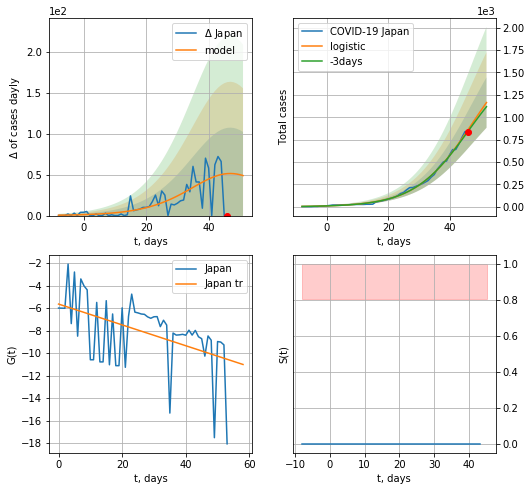

Japan data at: 2020-05-31
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +6 days
	 deltaDaycases:  48
	 total cases:  1163 ± 281
	 total death:  61 ± 44
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


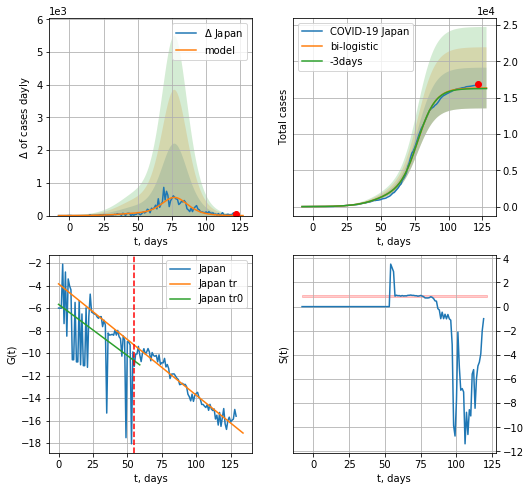

Japan data at: 2020-05-31
+3 day model MAPE: 0.004679356762393618
model: bi-logistic
coeffs:  [1.44819918e+04 1.51344604e-01 7.73472927e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.17170787741469148
forecast at the end of period: +6 days
	 deltaDaycases:  1
	 total cases:  16341 ± 2805
	 total death:  864 ± 445
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.938122
 intercept: -3.850825
 slope: -0.098957


In [218]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*10-dT)
    xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


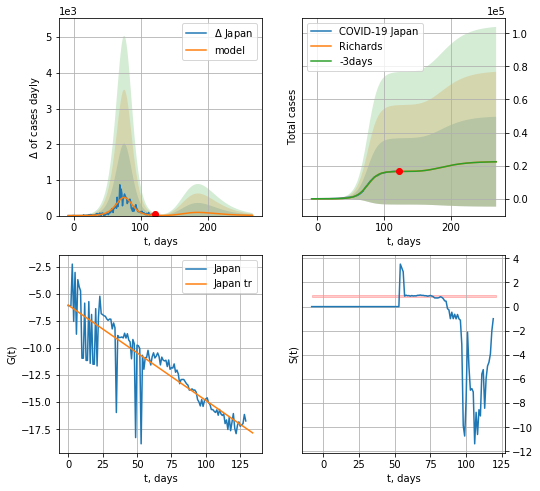

Japan data at: 2020-05-31
+3 day model MAPE: 0.003949
model: Richards
coeffs: [1.65710890e+04 1.14221934e-01 7.68147576e+01 1.11502073e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.211170
forecast at the end of period: +146 days
	 deltaDaycases: 7
	 total cases: 22410 ± 27143
	 total death: 1184 ± 4302
trend coefficient of determination: 0.770073
 intercept: -6.036633
 slope: -0.088040


In [219]:
x = forecastRR('Japan',dfJP[:],d1,30*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


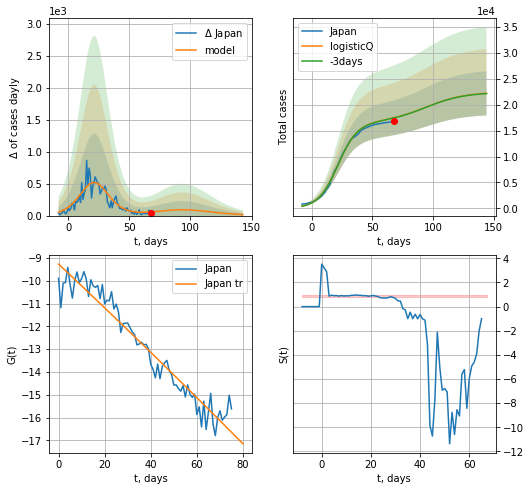

Japan data at: 2020-05-31
+3 day model MAPE: 0.002453
model: logisticQ
coeffs: [ 1.65865649e+04  4.16045779e-06  2.15615523e+01 -2.97168678e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.192226
forecast at the end of period: +76 days
	 deltaDaycases: 15
	 total cases: 22210 ± 4269
	 total death: 1174 ± 677
trend coefficient of determination: 0.938487
 intercept_: -9.27048340710948
 coeffs_: [ 0.00000000e+00 -9.50044743e-02 -4.31289895e-05]


In [220]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


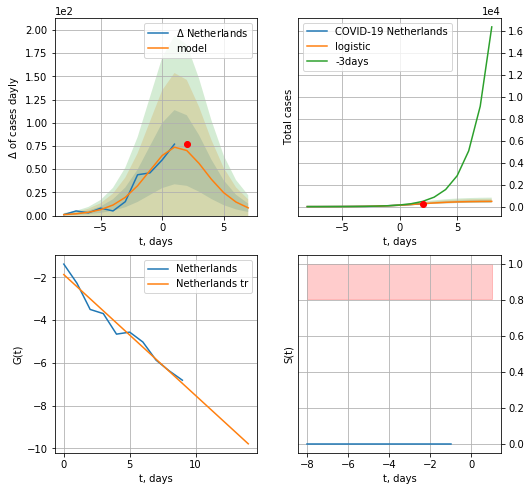

Netherlands data at: 2020-05-31
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +6 days
	 deltaDaycases:  8
	 total cases:  477 ± 113
	 total death:  61 ± 43
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


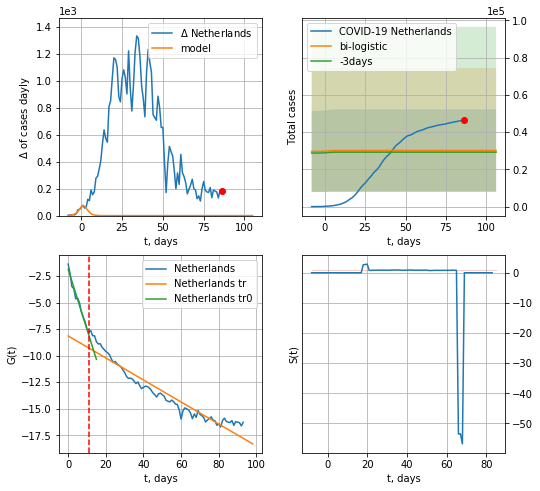

Netherlands data at: 2020-05-31
+3 day model MAPE: 0.030744634605388156
model: bi-logistic
coeffs:  [ 2.37269687e+04 -4.97138215e+00  1.50037638e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7336427644217351
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  30146 ± 22116
	 total death:  3866 ± 8508
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.922917
 intercept: -8.146782
 slope: -0.103594


In [222]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,10*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
90 2020-05-27  45768       0  5871.0
91 2020-05-28  45950       0  5903.0
92 2020-05-29  46126       0  5931.0
93 2020-05-30  46257       0  5951.0
94 2020-05-31  46442       0  5956.0


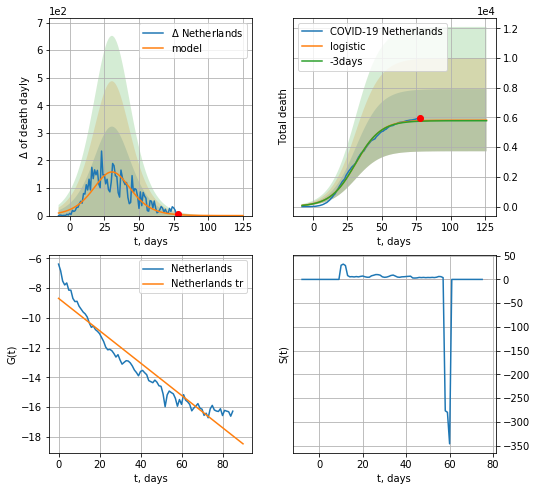

Netherlands data at: 2020-05-31
+3 day model MAPE: 0.005873888796292644
model: logistic
coeffs:  [5.81533211e+03 1.08893665e-01 3.09590795e+01]
rational stdev:  0.35971961510235007
forecast at the end of period: +48 days
	 total death:  5815 ± 2091
trend coefficient of determination: 0.918677
 intercept: -8.681734
 slope: -0.108722


In [223]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


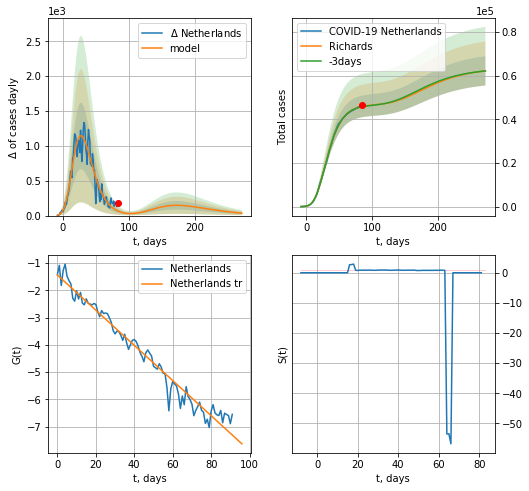

Netherlands data at: 2020-05-31
+3 day model MAPE: 0.003295
model: Richards
coeffs: [ 4.67419163e+04  7.35761443e-01 -5.69587411e+00  9.48031113e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.107935
forecast at the end of period: +188 days
	 deltaDaycases: 35
	 total cases: 62152 ± 6708
	 total death: 7970 ± 2580
trend coefficient of determination: 0.968422
 intercept: -1.440249
 slope: -0.064414


In [224]:
x = forecastRR('Netherlands',dfNL[2:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


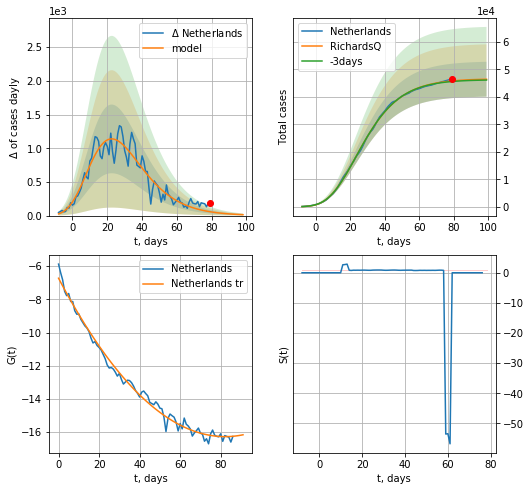

Netherlands data at: 2020-05-31
+3 day model MAPE: 0.004793
model: RichardsQ
coeffs: [ 4.65394921e+04  1.09097898e-02 -5.78604403e+01 -6.02769014e+02
  8.67485198e-03]
rational stdev: 0.136808
forecast at the end of period: +20 days
	 deltaDaycases: 13
	 total cases: 46379 ± 6345
	 total death: 5947 ± 2440
trend coefficient of determination: 0.990621
 intercept_: -6.726806109945812
 coeffs_: [ 0.         -0.2325591   0.00141544]


In [225]:
x = forecastQR('Netherlands',dfNL[7:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


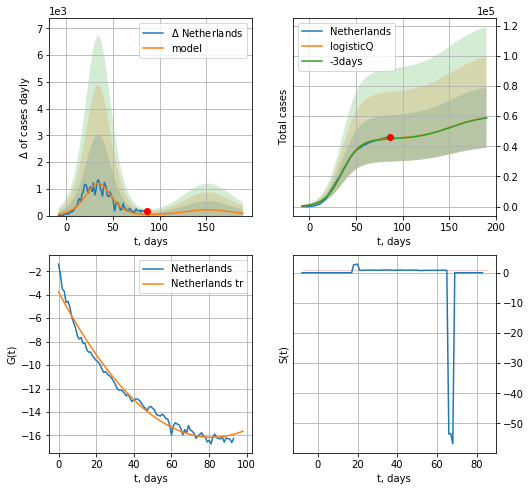

Netherlands data at: 2020-05-31
+3 day model MAPE: 0.006077
model: logisticQ
coeffs: [ 4.48799053e+04  6.87532781e-07  3.48497942e+01 -1.55644466e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339985
forecast at the end of period: +104 days
	 deltaDaycases: 88
	 total cases: 58964 ± 20047
	 total death: 7561 ± 7711
trend coefficient of determination: 0.980032
 intercept_: -3.7667026663132415
 coeffs_: [ 0.         -0.3043969   0.00187027]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


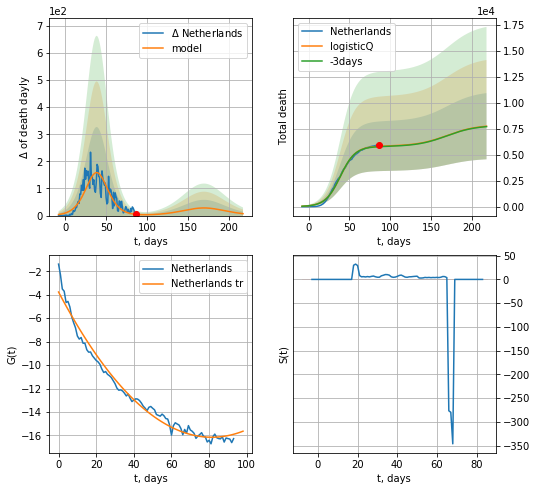

Netherlands data at: 2020-05-31
+3 day model MAPE: 0.005946
model: logisticQ
coeffs: [ 5.81309555e+03  6.77652446e-07  3.89519517e+01 -1.60972662e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.411695
forecast at the end of period: +132 days
	 total death: 7735 ± 3184
trend coefficient of determination: 0.980032
 intercept_: -3.7667026663132415
 coeffs_: [ 0.         -0.3043969   0.00187027]


In [226]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [227]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


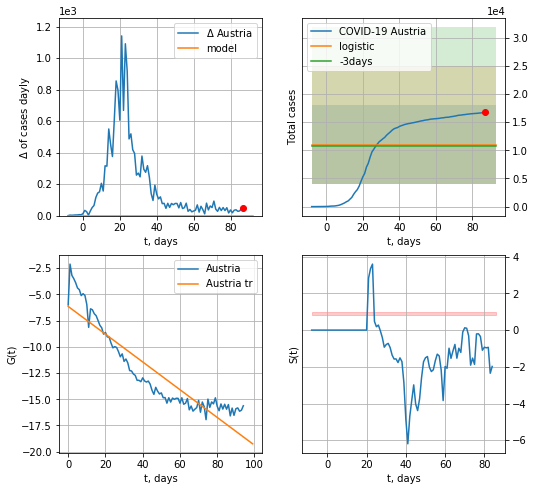

Austria data at: 2020-05-31
+3 day model MAPE: 0.020042055031678763
model: logistic
coeffs:  [ 1.03724897e+04 -3.27734671e+00  1.16646072e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.632107559184197
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  11020 ± 6966
	 total death:  440 ± 834
trend coefficient of determination: 0.840239
 intercept: -6.156433
 slope: -0.132244


In [228]:
x = forecast('Austria',dfAT[:],d1,7*10-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


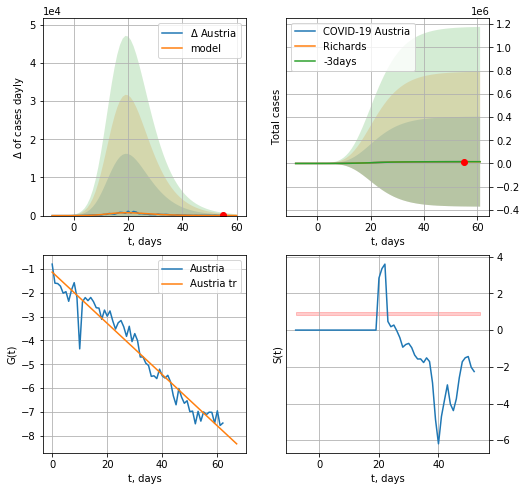

Austria data at: 2020-05-31
+3 day model MAPE: 0.006853
model: Richards
coeffs: [1.52399553e+04 8.17697795e-01 8.10432479e+00 1.79496396e-01]
rational stdev: 25.448318
forecast at the end of period: +6 days
	 deltaDaycases: 5
	 total cases: 15203 ± 386914
	 total death: 607 ± 46341
trend coefficient of determination: 0.949604
 intercept: -1.138894
 slope: -0.107415


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


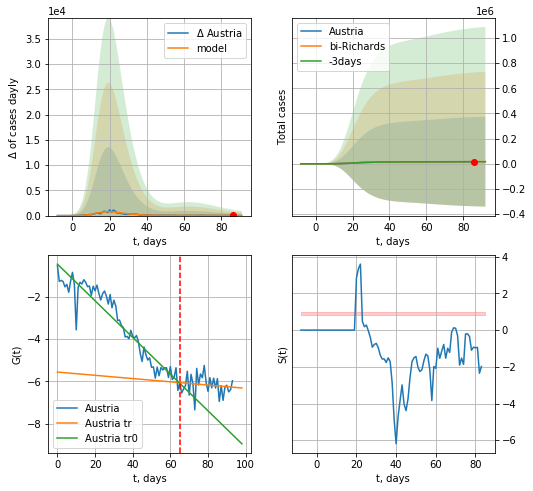

Austria data at: 2020-05-31
+3 day model MAPE: 0.000937
model: bi-Richards
coeffs: [ 1.82205557e+03  8.88812504e+00 -2.07314038e+00  8.08498166e-03]
rational stdev: 21.242508
forecast at the end of period: +6 days
	 deltaDaycases: 16
	 total cases: 16818 ± 357265
	 total death: 671 ± 42761
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.902456
 intercept: -0.451295
 slope: -0.086832
trend coefficient of determination: 0.019430
 intercept: -5.563348
 slope: -0.007687


In [229]:
vL=65
x = forecastRR('Austria',dfAT[1:vL],d1,10*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[1:],d1,10*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


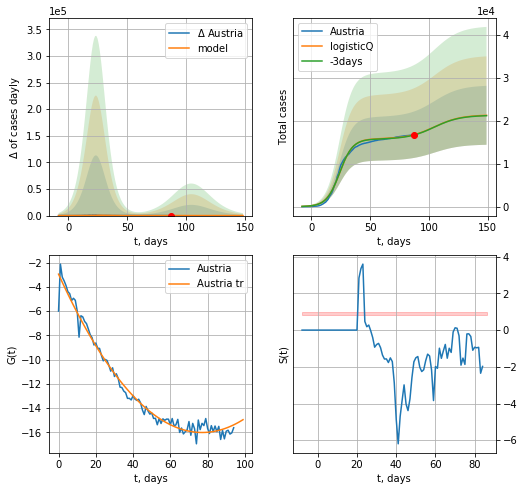

Austria data at: 2020-05-31
+3 day model MAPE: 0.003894
model: logisticQ
coeffs: [ 1.57902965e+04  6.06959068e-07  2.40252154e+01 -2.94046599e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322774
forecast at the end of period: +62 days
	 deltaDaycases: 9
	 total cases: 21279 ± 6868
	 total death: 849 ± 822
trend coefficient of determination: 0.979995
 intercept_: -2.9534036190113557
 coeffs_: [ 0.         -0.33890063  0.00219853]


In [230]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


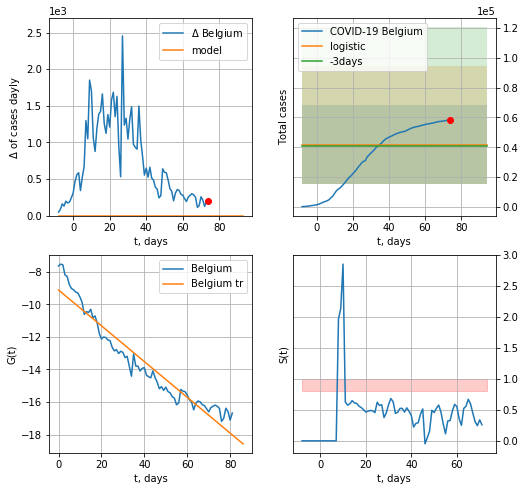

Belgium data at: 2020-05-31
+3 day model MAPE: 0.028701064579421783
model: logistic
coeffs:  [ 3.33767590e+04 -6.89653096e+00  2.33514153e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.6311200506201732
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  41720 ± 26330
	 total death:  6765 ± 12808
trend coefficient of determination: 0.924079
 intercept: -9.127354
 slope: -0.109782


In [231]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
87 2020-05-27  57592   32763  9364.0
88 2020-05-28  57849   32889  9388.0
89 2020-05-29  58061   32949  9430.0
90 2020-05-30  58186   32964  9453.0
91 2020-05-31  58381   33027  9467.0


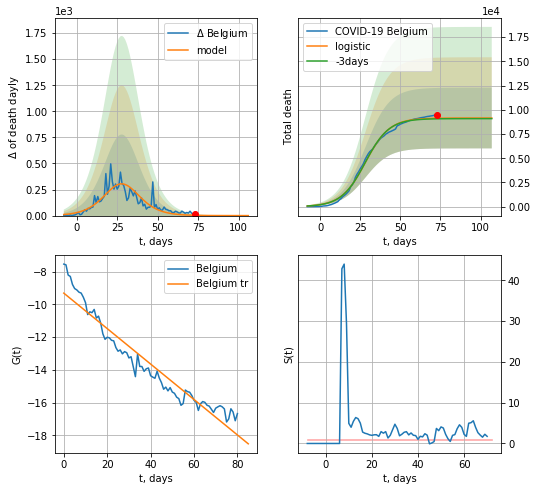

Belgium data at: 2020-05-31
+3 day model MAPE: 0.006711097728762505
model: logistic
coeffs:  [9.15193990e+03 1.33197251e-01 2.82532594e+01]
rational stdev:  0.3427337955430543
forecast at the end of period: +34 days
	 total death:  9151 ± 3136
trend coefficient of determination: 0.923367
 intercept: -9.310159
 slope: -0.108413


In [232]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


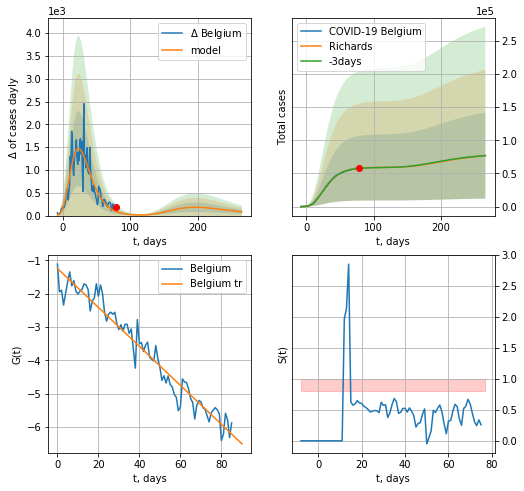

Belgium data at: 2020-05-31
+3 day model MAPE: 0.002440
model: Richards
coeffs: [ 5.92027674e+04  4.39673945e+00 -3.76272214e+01  1.54644702e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.843406
forecast at the end of period: +188 days
	 deltaDaycases: 82
	 total cases: 76756 ± 64737
	 total death: 12446 ± 31491
trend coefficient of determination: 0.949339
 intercept: -1.244231
 slope: -0.058398


In [233]:
x = forecastRR('Belgium',dfBG[5:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


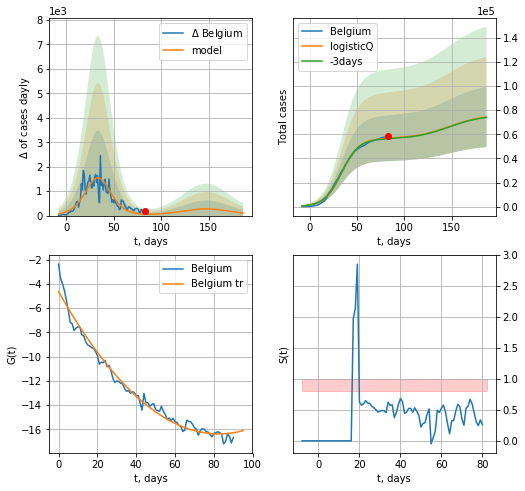

Belgium data at: 2020-05-31
+3 day model MAPE: 0.006731
model: logisticQ
coeffs: [ 5.64357292e+04  5.91066867e-07  3.38835213e+01 -1.84879469e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.335157
forecast at the end of period: +104 days
	 deltaDaycases: 103
	 total cases: 74359 ± 24922
	 total death: 12058 ± 12123
trend coefficient of determination: 0.980316
 intercept_: -4.636846076978271
 coeffs_: [ 0.         -0.28467826  0.0017264 ]


In [234]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

In [235]:
dfBZ.tail()

,date,cases,active,death
92,2020-05-27,414661.0,222317,25697.0
93,2020-05-28,438812.0,218867,26764.0
94,2020-05-29,468338.0,247213,27944.0
95,2020-05-30,499966.0,265746,28849.0
96,2020-05-31,514992.0,279096,29341.0


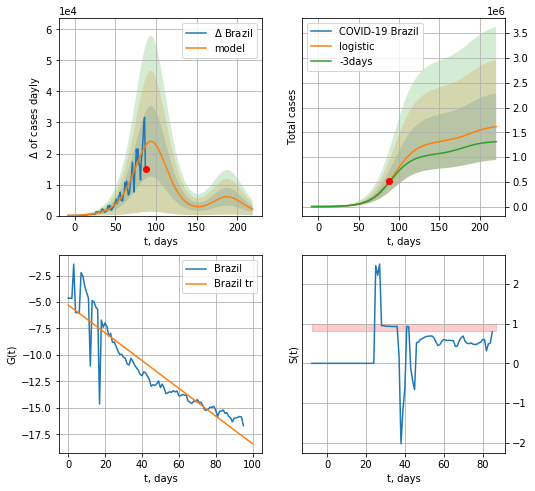

Brazil data at: 2020-05-31
+3 day model MAPE: 0.036870962613449014
model: logistic
coeffs:  [1.31458111e+06 7.26497100e-02 9.42277182e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.416205558918753
forecast at the end of period: +132 days
	 deltaDaycases:  2061
	 total cases:  1612911 ± 671302
	 total death:  91893 ± 114739
trend coefficient of determination: 0.853801
 intercept: -5.285133
 slope: -0.131204


In [236]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


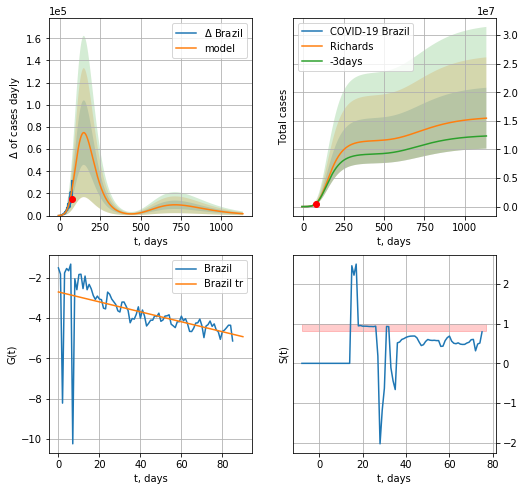

Brazil data at: 2020-05-31
+3 day model MAPE: 0.014255
model: Richards
coeffs: [1.15595912e+07 1.53594648e-01 3.63465675e+01 1.21527625e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.344106
forecast at the end of period: +1056 days
	 deltaDaycases: 1719
	 total cases: 15470447 ± 5323481
	 total death: 881408 ± 909894
trend coefficient of determination: 0.236528
 intercept: -2.703413
 slope: -0.024637


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


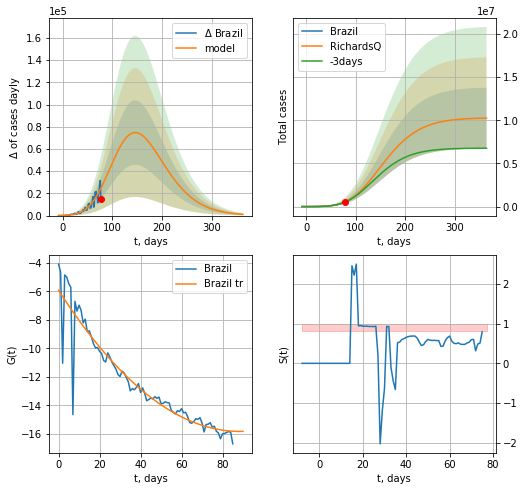

Brazil data at: 2020-05-31
+3 day model MAPE: 0.015340
model: RichardsQ
coeffs: [ 1.02885621e+07  1.22312537e-03 -2.52066639e+02 -2.52176226e+02
  2.06472597e-02]
rational stdev: 0.343192
forecast at the end of period: +286 days
	 deltaDaycases: 1076
	 total cases: 10254416 ± 3519238
	 total death: 584232 ± 601512
trend coefficient of determination: 0.882027
 intercept_: -5.929761949448972
 coeffs_: [ 0.         -0.22368663  0.00126505]


In [237]:
x = forecastRR('Brazil',dfBZ[10:],d1,160*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


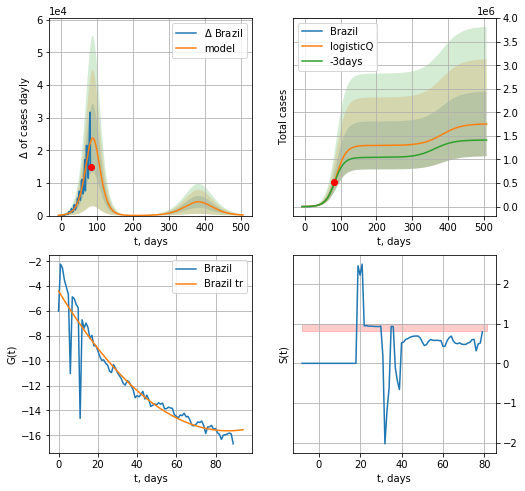

Brazil data at: 2020-05-31
+3 day model MAPE: 0.037443
model: logisticQ
coeffs: [ 1.29857111e+06  6.53065231e-06  8.79160908e+01 -1.11125104e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.391693
forecast at the end of period: +426 days
	 deltaDaycases: 174
	 total cases: 1753761 ± 686935
	 total death: 99918 ± 117411
trend coefficient of determination: 0.896163
 intercept_: -4.397821237393954
 coeffs_: [ 0.         -0.26037376  0.00150776]


In [238]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [239]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
102 2020-05-27  7150.0     468  103.0
103 2020-05-28  7165.0     482  103.0
104 2020-05-29  7184.0     476  103.0
105 2020-05-30  7195.0     478  103.0
106 2020-05-31  7202.0     481  103.0


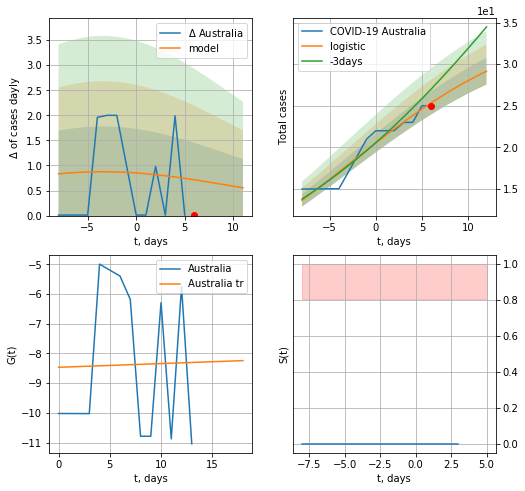

Australia data at: 2020-05-31
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  29 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


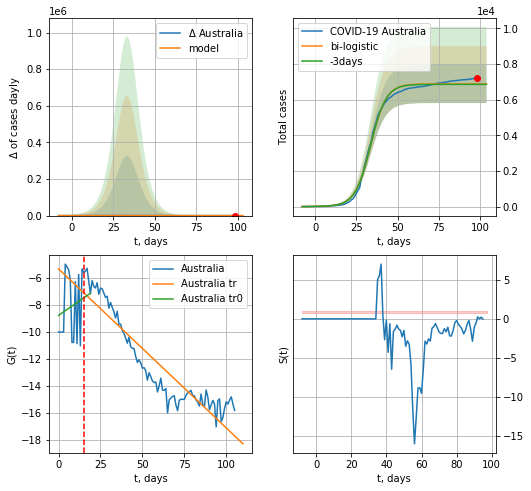

Australia data at: 2020-05-31
+3 day model MAPE: 0.003218668514523021
model: bi-logistic
coeffs:  [6.84299244e+03 2.12081277e-01 3.36664438e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.15488717824410891
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  6878 ± 1065
	 total death:  98 ± 45
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.851115
 intercept: -5.348032
 slope: -0.117676


In [241]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,10*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,10*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


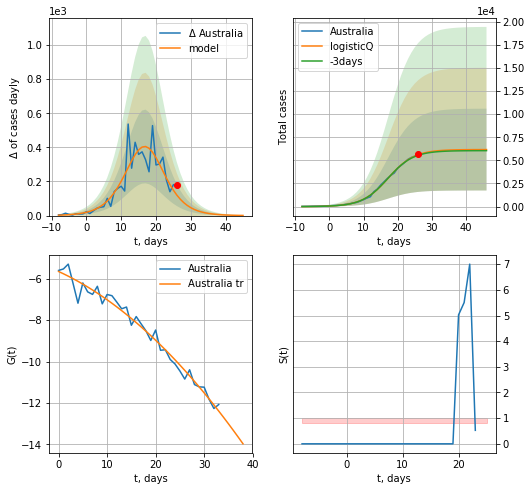

Australia data at: 2020-05-31
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +20 days
	 deltaDaycases: 0
	 total cases: 6165 ± 4418
	 total death: 88 ± 189
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


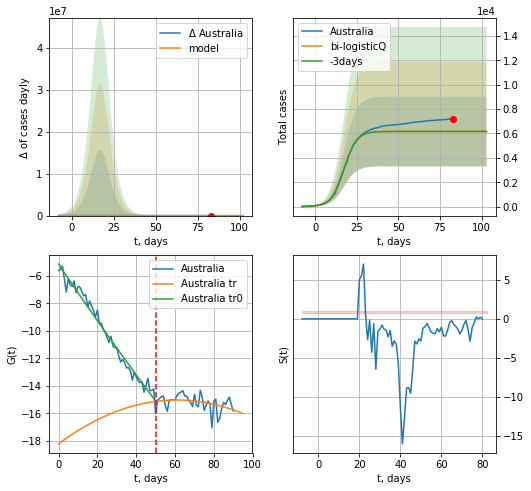

Australia data at: 2020-05-31
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-7.5899672  -1.39180339 22.58332152  1.74017167]
rational stdev: 0.463067
forecast at the end of period: +20 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2856
	 total death: 88 ± 122
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.135193
 intercept_: -18.201734861753835
 coeffs_: [ 0.          0.10435153 -0.00085575]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [242]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,12*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,12*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

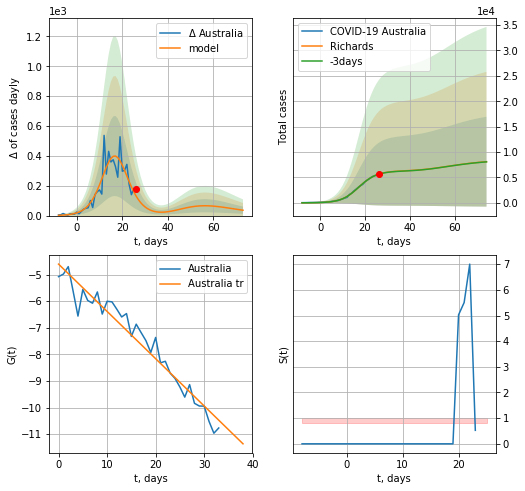

Australia data at: 2020-05-31
+3 day model MAPE: 0.004122
model: Richards
coeffs: [6.29844024e+03 2.85463605e-01 1.64695760e+01 8.48736456e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.092498
forecast at the end of period: +48 days
	 deltaDaycases: 36
	 total cases: 8098 ± 8847
	 total death: 115 ± 376
trend coefficient of determination: 0.945167
 intercept: -4.606318
 slope: -0.177832


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


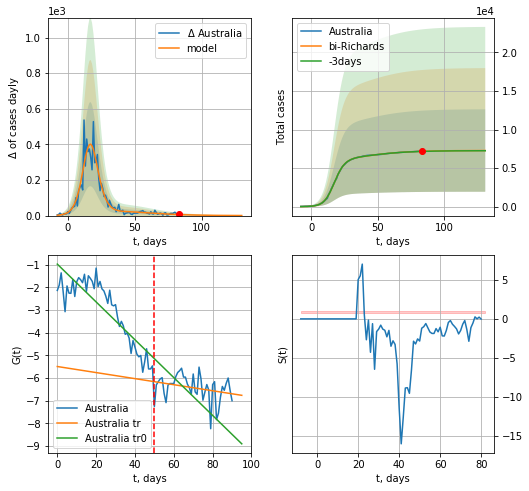

Australia data at: 2020-05-31
+3 day model MAPE: 0.001948
model: bi-Richards
coeffs: [ 9.83430145e+02  8.02528943e+00 -4.24422582e+01  7.04214656e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.734616
forecast at the end of period: +48 days
	 deltaDaycases: 0
	 total cases: 7274 ± 5343
	 total death: 104 ± 229
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.755055
 intercept: -0.972895
 slope: -0.083457
trend coefficient of determination: 0.076281
 intercept: -5.490635
 slope: -0.013376


In [243]:
x = forecastRR('Australia',dfAS[15:50],d1,16*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[15:],d1,16*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=50)

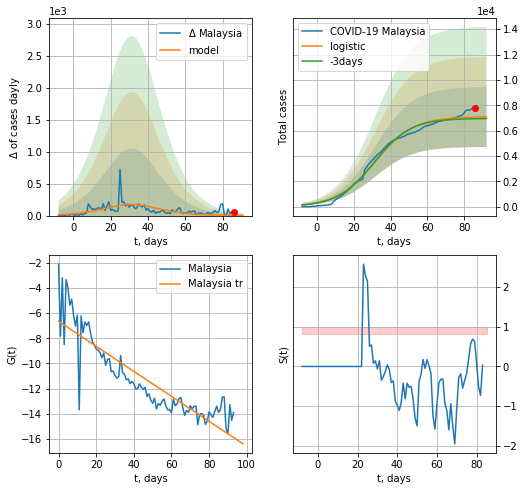

Malaysia data at: 2020-05-31
+3 day model MAPE: 0.018244109630870673
model: logistic
coeffs:  [7.09543806e+03 9.74280061e-02 3.16579574e+01]
rational stdev:  0.33466066808010464
forecast at the end of period: +6 days
	 deltaDaycases:  2
	 total cases:  7075 ± 2367
	 total death:  104 ± 104
trend coefficient of determination: 0.773204
 intercept: -6.659896
 slope: -0.099136


In [244]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


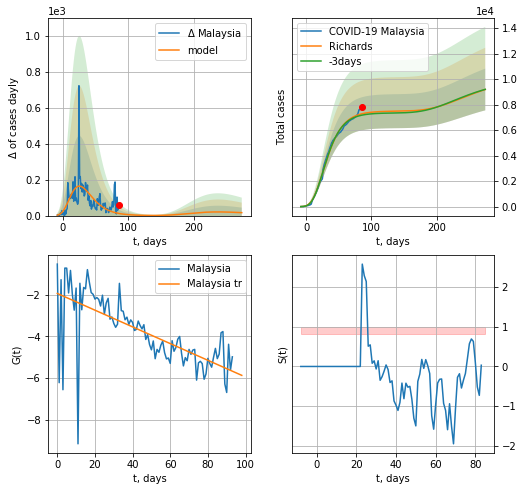

Malaysia data at: 2020-05-31
+3 day model MAPE: 0.015165
model: Richards
coeffs: [ 7.49594996e+03  8.76652134e+00 -5.74849522e+01  6.81281443e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.178073
forecast at the end of period: +188 days
	 deltaDaycases: 16
	 total cases: 9190 ± 1636
	 total death: 135 ± 72
trend coefficient of determination: 0.462009
 intercept: -1.933672
 slope: -0.040213


In [245]:
x = forecastRR('Malaysia',dfML[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


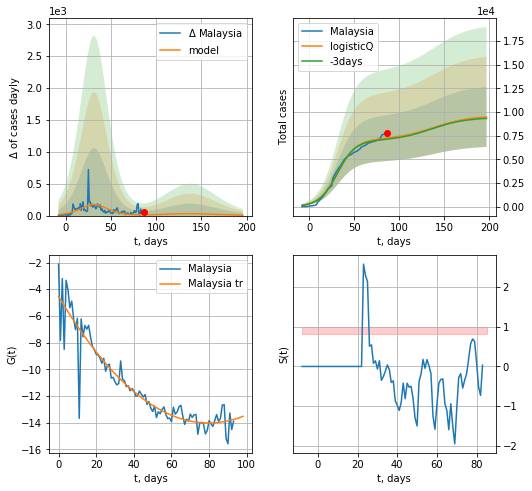

Malaysia data at: 2020-05-31
+3 day model MAPE: 0.017567
model: logisticQ
coeffs: [ 7.09536260e+03  3.28897851e-07  3.16585102e+01 -2.96112446e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334717
forecast at the end of period: +111 days
	 deltaDaycases: 6
	 total cases: 9476 ± 3171
	 total death: 139 ± 139
trend coefficient of determination: 0.876342
 intercept_: -4.533033600998151
 coeffs_: [ 0.         -0.23785163  0.0014916 ]


In [246]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
          date    cases  active  death
89 2020-05-27  1504.35       8   22.0
90 2020-05-28  1504.40       1   22.0
91 2020-05-29  1504.00       1   22.0
92 2020-05-30  1504.00       1   22.0
93 2020-05-31  1504.00       1   22.0


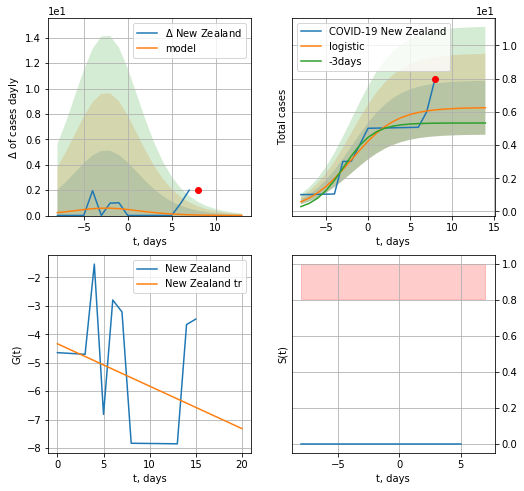

New Zealand data at: 2020-05-31
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: invalid value encountered in log


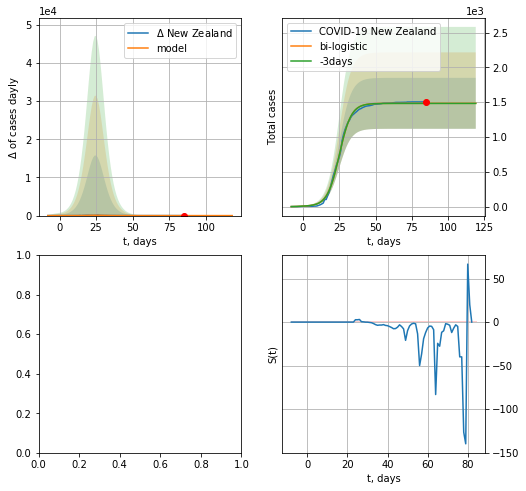

In [248]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,10*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

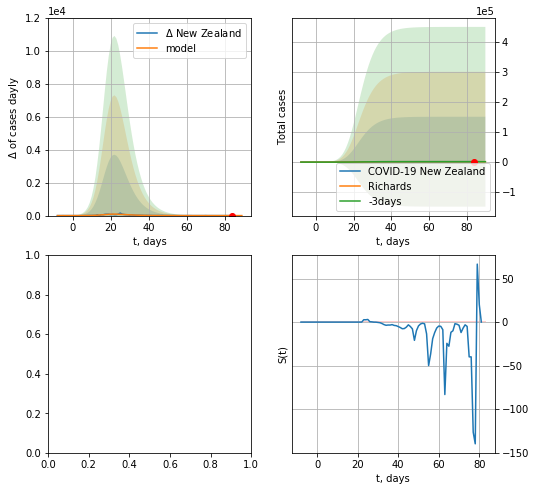

In [251]:
x = forecastRR('New Zealand',dfZL[18:],d1,10*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

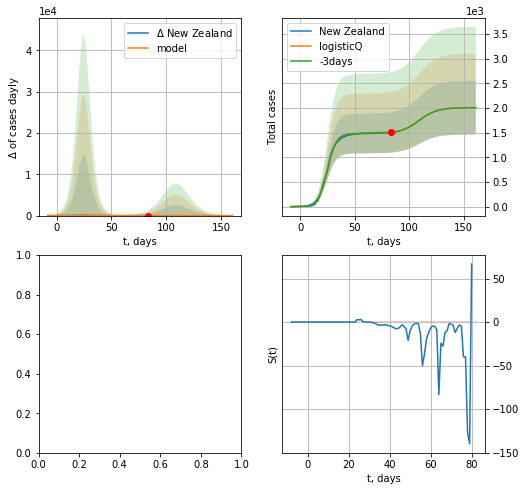

In [253]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
          date    cases  active  death
89 2020-05-27  38956.0   22819  214.0
90 2020-05-28  39858.0   22979  219.0
91 2020-05-29  40764.0   23150  224.0
92 2020-05-30  41658.0   23465  229.0
93 2020-05-31  42556.0   23807  235.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


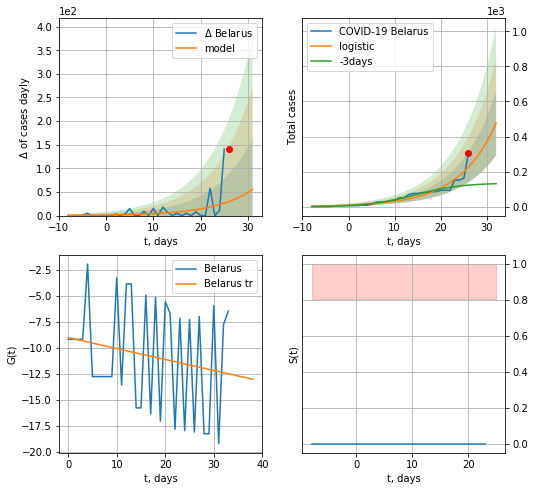

Belarus data at: 2020-05-31
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +6 days
	 deltaDaycases:  55
	 total cases:  475 ± 182
	 total death:  2 ± 2
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


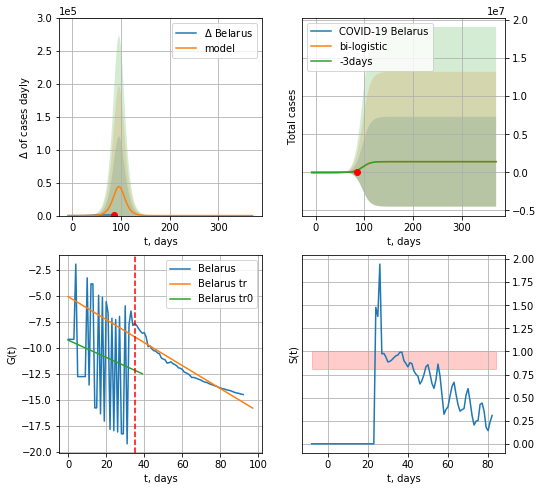

Belarus data at: 2020-05-31
+3 day model MAPE: 0.021457840379900985
model: bi-logistic
coeffs:  [-1.65842493e+04  8.89914489e+00 -1.96701009e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  4.196826036376789
forecast at the end of period: +286 days
	 deltaDaycases:  0
	 total cases:  1405395 ± 5898199
	 total death:  7760 ± 97702
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.932533
 intercept: -5.101965
 slope: -0.110499


In [252]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*10-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
          date    cases  active  death
89 2020-05-27  38956.0   22819  214.0
90 2020-05-28  39858.0   22979  219.0
91 2020-05-29  40764.0   23150  224.0
92 2020-05-30  41658.0   23465  229.0
93 2020-05-31  42556.0   23807  235.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


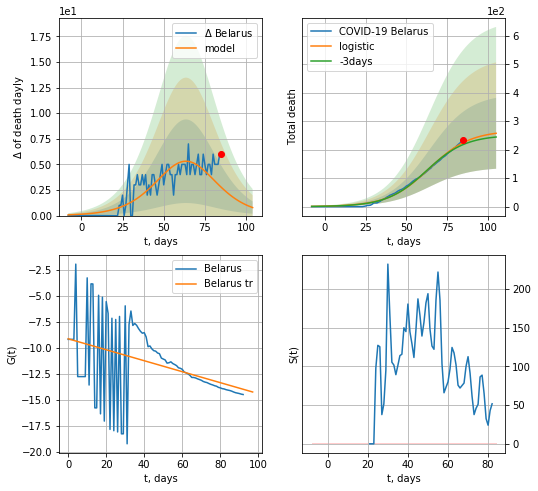

Belarus data at: 2020-05-31
+3 day model MAPE: 0.03212962953775273
model: logistic
coeffs:  [2.67102909e+02 7.95268066e-02 6.39994932e+01]
rational stdev:  0.4836448816940087
forecast at the end of period: +20 days
	 total death:  257 ± 124
trend coefficient of determination: 0.156243
 intercept: -9.157260
 slope: -0.052744


In [253]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,12*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


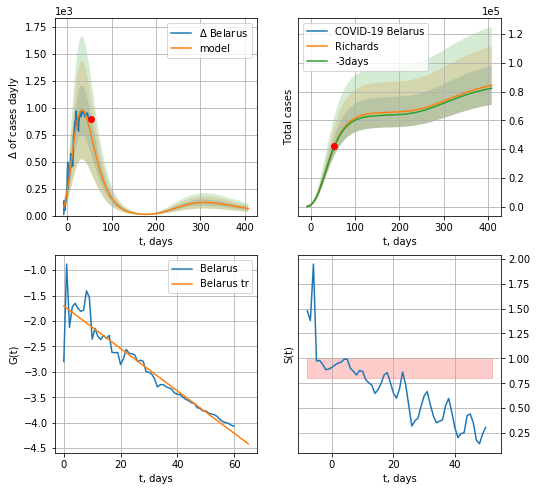

Belarus data at: 2020-05-31
+3 day model MAPE: 0.008524
model: Richards
coeffs: [ 6.57801392e+04  2.08021348e+00 -6.24454816e+01  1.96922715e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.160160
forecast at the end of period: +356 days
	 deltaDaycases: 64
	 total cases: 84376 ± 13513
	 total death: 465 ± 223
trend coefficient of determination: 0.905655
 intercept: -1.704903
 slope: -0.041713


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


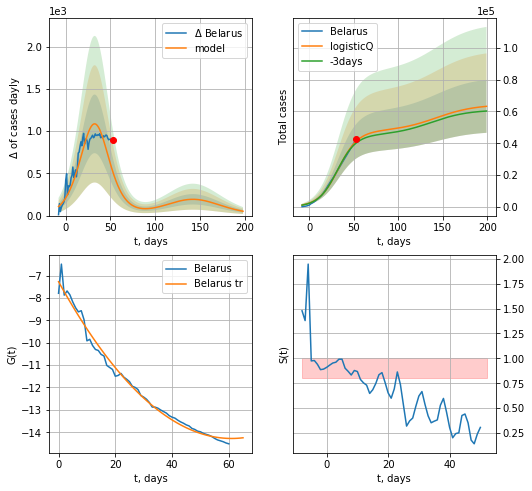

Belarus data at: 2020-05-31
+3 day model MAPE: 0.028948
model: logisticQ
coeffs: [ 4.75457295e+04  1.30364987e-06  3.27119433e+01 -6.97276685e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.263391
forecast at the end of period: +146 days
	 deltaDaycases: 51
	 total cases: 63199 ± 16646
	 total death: 348 ± 274
trend coefficient of determination: 0.987601
 intercept_: -7.270415201064716
 coeffs_: [ 0.         -0.22988186  0.00188528]


In [254]:
x = forecastRR('Belarus',dfBR[32:],d1,60*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


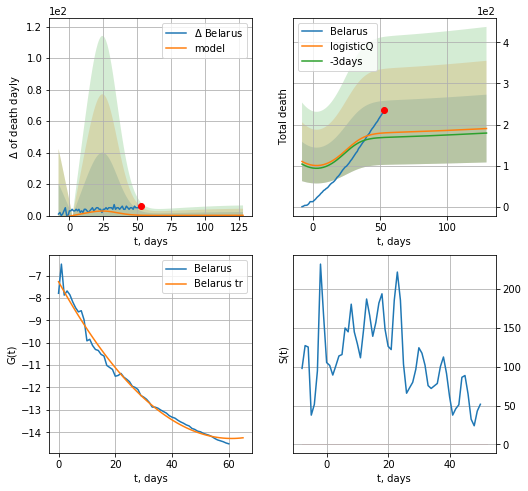

Belarus data at: 2020-05-31
+3 day model MAPE: 0.065744
model: logisticQ
coeffs: [ 1.52265445e+02  2.20203231e-03  7.25395492e+00 -1.59014685e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.431771
forecast at the end of period: +76 days
	 total death: 190 ± 82
trend coefficient of determination: 0.987601
 intercept_: -7.270415201064716
 coeffs_: [ 0.         -0.22988186  0.00188528]


In [255]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

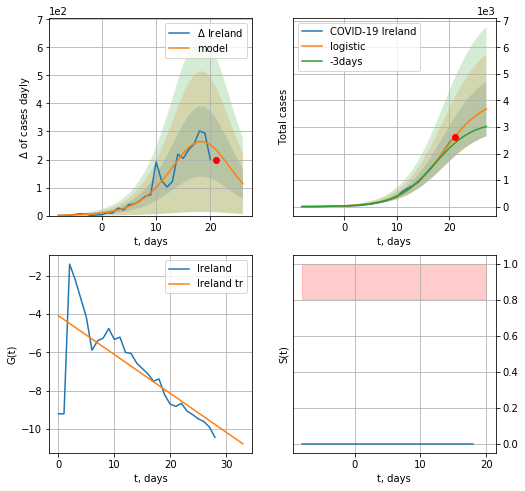

Ireland data at: 2020-05-31
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +6 days
	 deltaDaycases:  113
	 total cases:  3678 ± 1029
	 total death:  243 ± 203
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


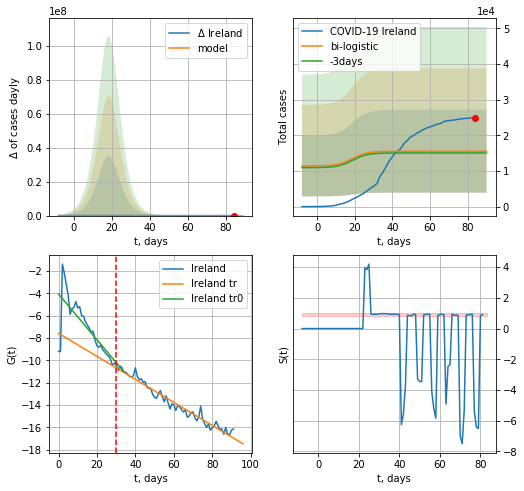

Ireland data at: 2020-05-31
+3 day model MAPE: 0.032316902083991184
model: bi-logistic
coeffs:  [ 9.12944163e+03 -8.59450919e+00  2.19650811e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7484030280052129
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  15539 ± 11629
	 total death:  1027 ± 2305
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.958811
 intercept: -7.588227
 slope: -0.103080


In [256]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


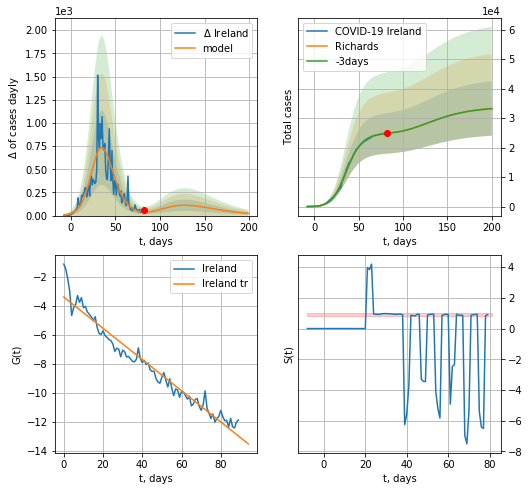

Ireland data at: 2020-05-31
+3 day model MAPE: 0.002203
model: Richards
coeffs: [2.49227613e+04 1.76576378e-01 2.97433781e+01 5.79303315e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.277261
forecast at the end of period: +118 days
	 deltaDaycases: 24
	 total cases: 33247 ± 9218
	 total death: 2197 ± 1827
trend coefficient of determination: 0.956553
 intercept: -3.377968
 slope: -0.107948


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


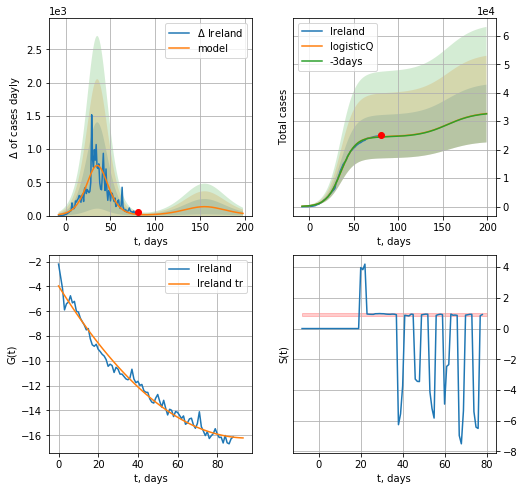

Ireland data at: 2020-05-31
+3 day model MAPE: 0.003811
model: logisticQ
coeffs: [ 2.45538029e+04  1.27617852e-06  3.56746980e+01 -9.61272646e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.310233
forecast at the end of period: +118 days
	 deltaDaycases: 32
	 total cases: 32695 ± 10143
	 total death: 2161 ± 2011
trend coefficient of determination: 0.983279
 intercept_: -3.958378272259756
 coeffs_: [ 0.         -0.25753947  0.00135232]


In [257]:
x = forecastRR('Ireland',dfIR[2:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

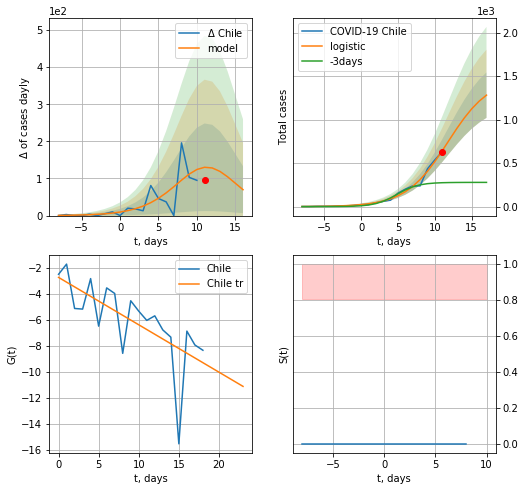

Chile data at: 2020-05-31
+3 day model MAPE: 1.792944169915196
model: logistic
coeffs:  [1.48337612e+03 3.52807696e-01 1.17654757e+01]
rational stdev:  0.20396784879776983
forecast at the end of period: +6 days
	 deltaDaycases:  69
	 total cases:  1281 ± 261
	 total death:  13 ± 7
trend coefficient of determination: 0.458420
 intercept: -2.731631
 slope: -0.364960


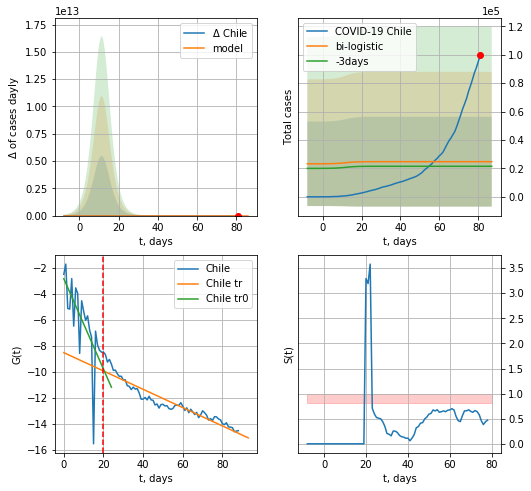

Chile data at: 2020-05-31
+3 day model MAPE: 0.1503109499829611
model: bi-logistic
coeffs:  [ 1.85995263e+04 -4.38416235e+00  1.19150280e+02] [1.48337612e+03 3.52807696e-01 1.17654757e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2783356501502279
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  24732 ± 31616
	 total death:  261 ± 1000
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.470301
 intercept: -2.832141
 slope: -0.348208
trend coefficient of determination: 0.896742
 intercept: -8.528354
 slope: -0.070573


In [258]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,7*10-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


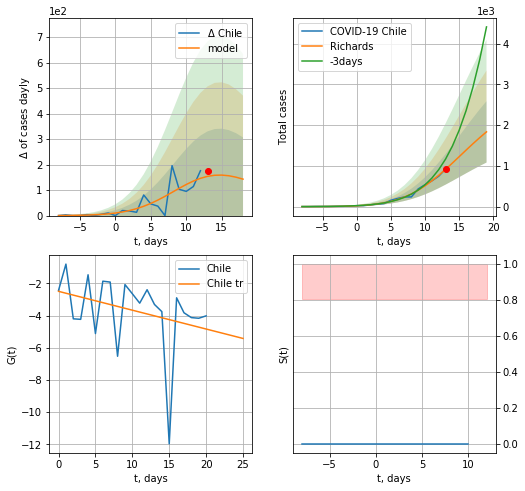

Chile data at: 2020-05-31
+3 day model MAPE: 0.280244
model: Richards
coeffs: [2.96603660e+03 4.92800903e-01 8.96517979e+00 3.45895404e-01]
rational stdev: 0.410204
forecast at the end of period: +6 days
	 deltaDaycases: 142
	 total cases: 1834 ± 752
	 total death: 19 ± 23
trend coefficient of determination: 0.098210
 intercept: -2.493671
 slope: -0.117098


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


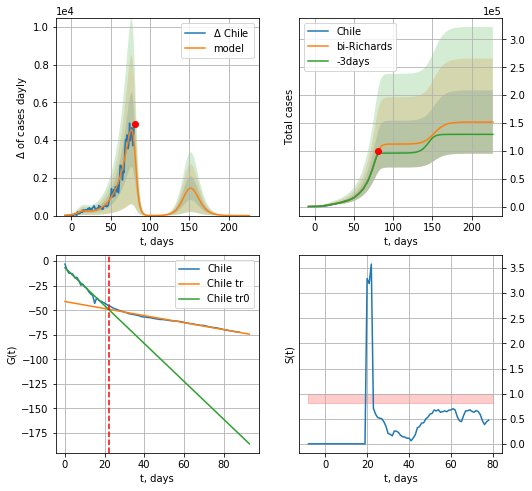

Chile data at: 2020-05-31
+3 day model MAPE: 0.076136
model: bi-Richards
coeffs: [1.09216278e+05 6.72936145e-02 8.13539405e+01 6.01820640e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.374724
forecast at the end of period: +146 days
	 deltaDaycases: 0
	 total cases: 151763 ± 56869
	 total death: 1604 ± 1803
bi-Richards approximation splitting point: 22
trend coefficient of determination: 0.968552
 intercept: -6.665222
 slope: -1.928399
trend coefficient of determination: 0.980723
 intercept: -41.085866
 slope: -0.357719


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


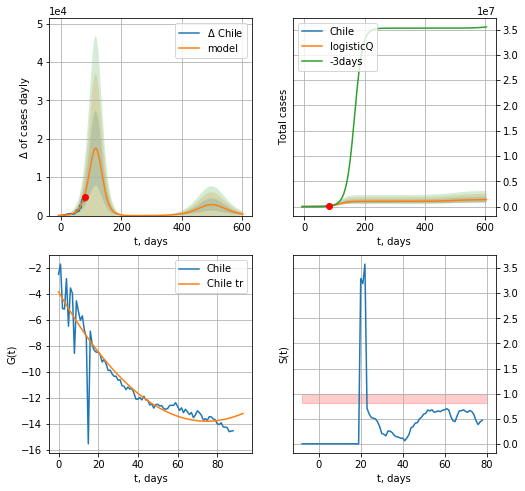

Chile data at: 2020-05-31
+3 day model MAPE: 0.039043
model: logisticQ
coeffs: [ 1.03418687e+06  6.27463991e-05  1.14732508e+02 -9.64856441e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.412310
forecast at the end of period: +524 days
	 deltaDaycases: 403
	 total cases: 1387434 ± 572053
	 total death: 14669 ± 18144
trend coefficient of determination: 0.875970
 intercept_: -3.841309692110965
 coeffs_: [ 0.         -0.26693173  0.00178739]


In [259]:
vL = 22
x = forecastRR('Chile',dfCL[:vL],d1,10*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Chile',dfCL[:],d1,30*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

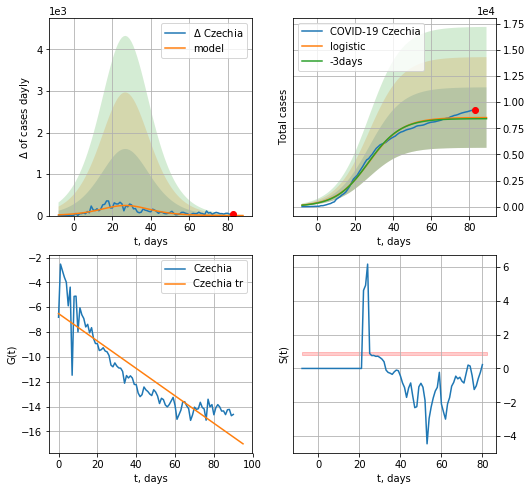

Czechia data at: 2020-05-31
+3 day model MAPE: 0.012428703101026659
model: logistic
coeffs:  [8.52551312e+03 1.14242367e-01 2.72180274e+01]
rational stdev:  0.3394046746094868
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  8518 ± 2891
	 total death:  294 ± 299
trend coefficient of determination: 0.803948
 intercept: -6.514781
 slope: -0.110328


In [260]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


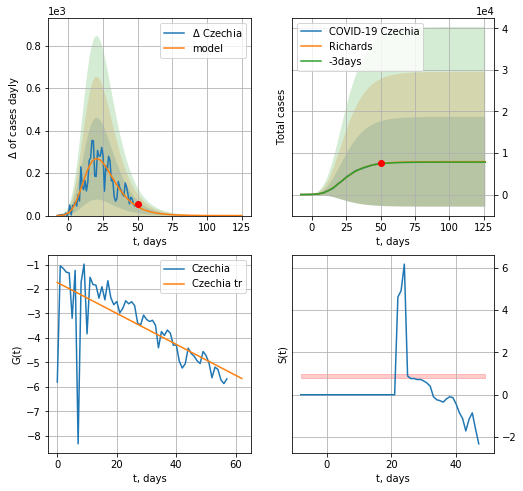

Czechia data at: 2020-05-31
+3 day model MAPE: 0.007369
model: Richards
coeffs: [ 7.90689533e+03  1.12645119e+00 -4.69210858e+00  8.53971991e-02]
rational stdev: 1.366945
forecast at the end of period: +76 days
	 deltaDaycases: 0
	 total cases: 7906 ± 10807
	 total death: 272 ± 1115
trend coefficient of determination: 0.470375
 intercept: -1.735202
 slope: -0.063324


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


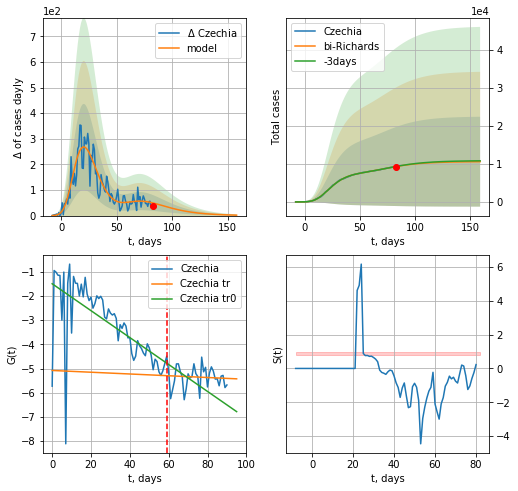

Czechia data at: 2020-05-31
+3 day model MAPE: 0.002964
model: bi-Richards
coeffs: [2.68425426e+03 2.64681260e+00 6.44638241e-01 1.99320774e-02]
rational stdev: 1.116913
forecast at the end of period: +76 days
	 deltaDaycases: 1
	 total cases: 10559 ± 11794
	 total death: 364 ± 1219
bi-Richards approximation splitting point: 59
trend coefficient of determination: 0.407615
 intercept: -1.499424
 slope: -0.055575
trend coefficient of determination: 0.005512
 intercept: -5.079702
 slope: -0.003633


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


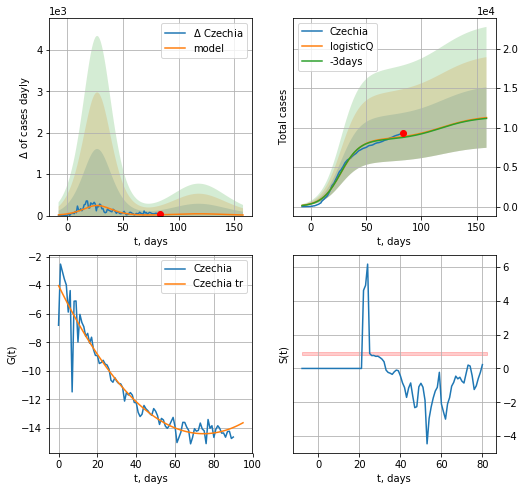

Czechia data at: 2020-05-31
+3 day model MAPE: 0.011319
model: logisticQ
coeffs: [ 8.52549036e+03  3.53728725e-07  2.72187272e+01 -3.22841093e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339462
forecast at the end of period: +76 days
	 deltaDaycases: 14
	 total cases: 11274 ± 3827
	 total death: 389 ± 396
trend coefficient of determination: 0.929752
 intercept_: -4.0356209585148175
 coeffs_: [ 0.         -0.27747091  0.0018572 ]


In [261]:
vL= 59
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

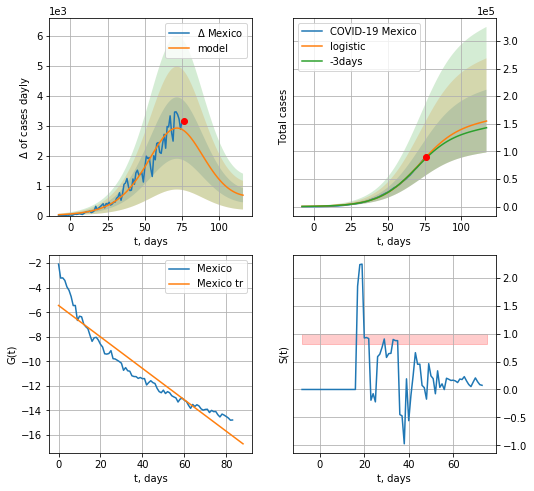

Mexico data at: 2020-05-31
+3 day model MAPE: 0.02550835438018266
model: logistic
coeffs:  [1.55567296e+05 7.47916056e-02 7.19560603e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36676158018823224
forecast at the end of period: +41 days
	 deltaDaycases:  681
	 total cases:  154973 ± 56838
	 total death:  16973 ± 18675
trend coefficient of determination: 0.907312
 intercept: -5.446422
 slope: -0.128050


In [262]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


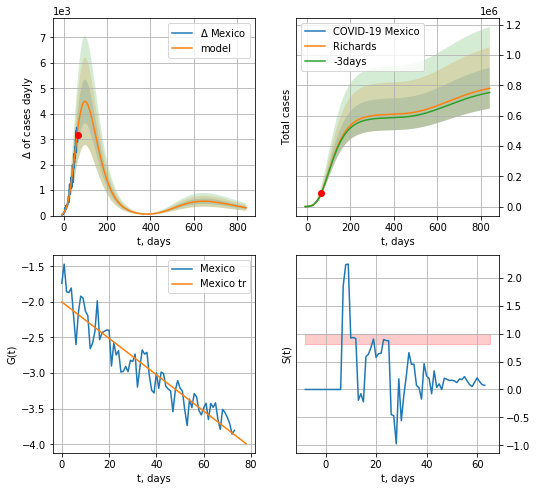

Mexico data at: 2020-05-31
+3 day model MAPE: 0.003877
model: Richards
coeffs: [ 6.10246068e+05  5.23143543e-01 -5.97688468e+01  3.89522172e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.172556
forecast at the end of period: +776 days
	 deltaDaycases: 304
	 total cases: 781648 ± 134877
	 total death: 85610 ± 44317
trend coefficient of determination: 0.880886
 intercept: -2.001329
 slope: -0.025527


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


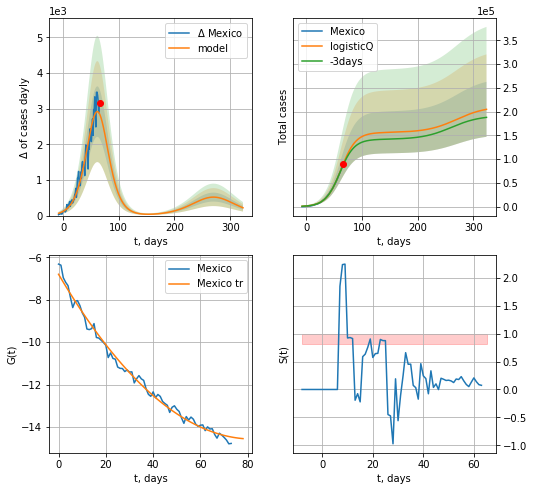

Mexico data at: 2020-05-31
+3 day model MAPE: 0.025458
model: logisticQ
coeffs: [ 1.56047496e+05  3.05862554e-06  6.20374739e+01 -2.43692316e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.282310
forecast at the end of period: +258 days
	 deltaDaycases: 218
	 total cases: 204793 ± 57815
	 total death: 22430 ± 18996
trend coefficient of determination: 0.990978
 intercept_: -6.801743545535031
 coeffs_: [ 0.         -0.18893065  0.00114919]


In [263]:
x = forecastRR('Mexico',dfMX[10:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date   cases  active  death     tests
79 2020-05-27  1656.0     395   68.0  287982.0
80 2020-05-28  1662.0     370   68.0  294091.0
81 2020-05-29  1670.0     362   70.0  299428.0
82 2020-05-30  1675.0     369   70.0  302859.0
83 2020-05-31  1675.0     369   70.0       NaN
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


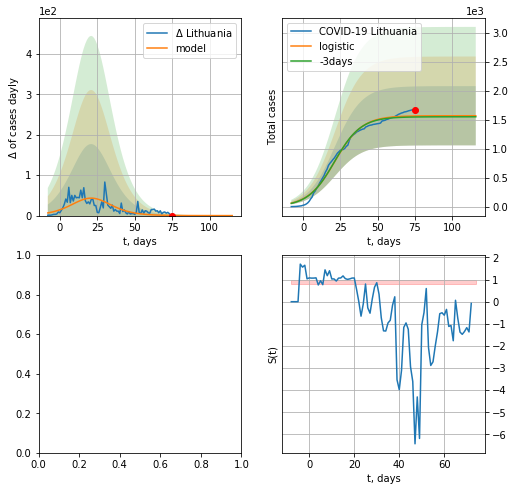

In [264]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [58]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [59]:
#np.diff(dfLT["cases"])

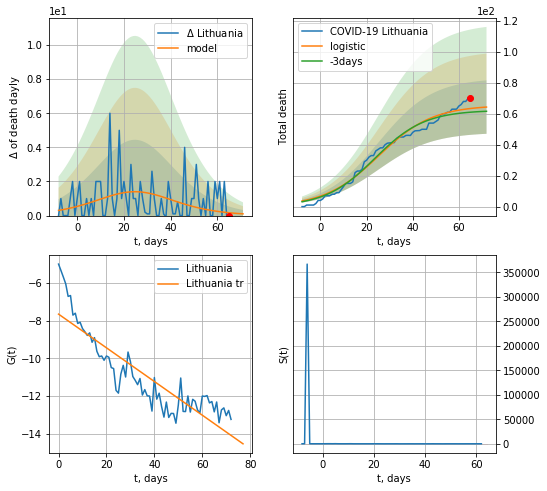

Lithuania data at: 2020-05-30
+3 day model MAPE: 0.040003115881798494
model: logistic
coeffs:  [65.54499416  0.08542899 25.19516391]
rational stdev:  0.2684553198783402
forecast at the end of period: +7 days
	 total death:  64 ± 17
trend coefficient of determination: 0.779068
 intercept: -7.655716
 slope: -0.089306


In [398]:
x = forecast('Lithuania',dfLT[9:],d1,7*10-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


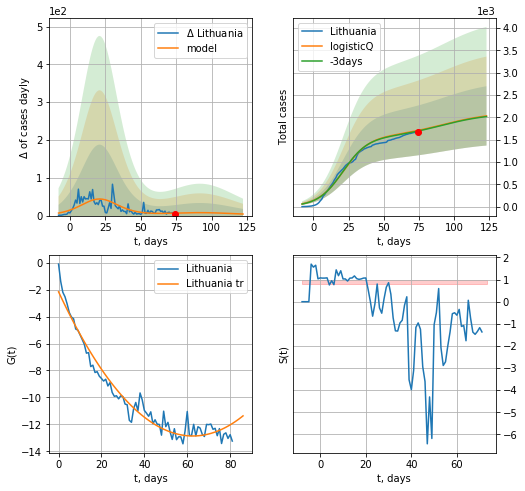

Lithuania data at: 2020-05-30
+3 day model MAPE: 0.007859
model: logisticQ
coeffs: [ 1.56412574e+03  3.93545091e-07  2.12630022e+01 -2.82106888e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.326875
forecast at the end of period: +49 days
	 deltaDaycases: 4
	 total cases: 2032 ± 664
	 total death: 85 ± 83
trend coefficient of determination: 0.957590
 intercept_: -2.1591073678181205
 coeffs_: [ 0.         -0.34178787  0.0027293 ]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


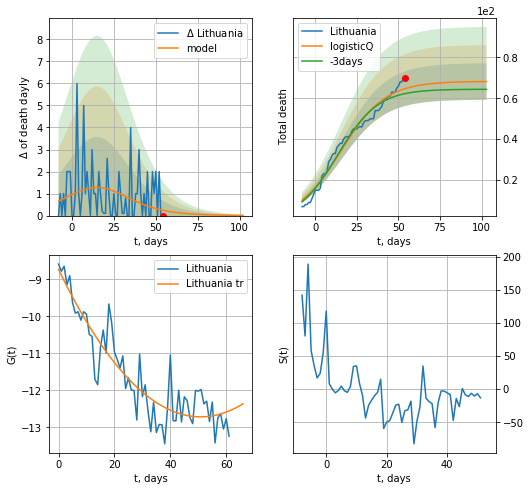

Lithuania data at: 2020-05-30
+3 day model MAPE: 0.040105
model: logisticQ
coeffs: [ 6.83033317e+01  4.86419796e-07  1.53539639e+01 -1.53770897e+05]
rational stdev: 0.130670
forecast at the end of period: +49 days
	 total death: 68 ± 8
trend coefficient of determination: 0.829069
 intercept_: -8.732210036037257
 coeffs_: [ 0.         -0.15660113  0.00154016]


In [399]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


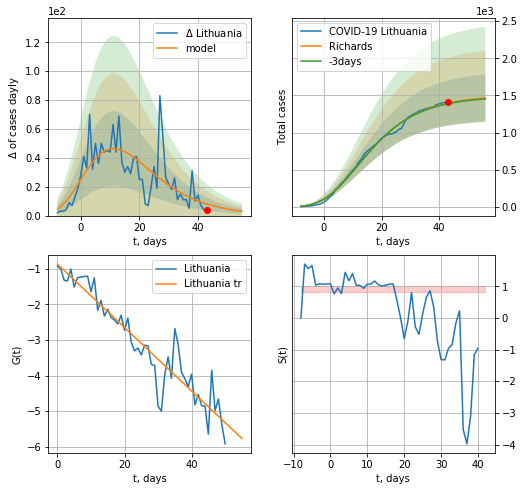

Lithuania data at: 2020-05-30
+3 day model MAPE: 0.007012
model: Richards
coeffs: [ 1.50132611e+03  1.12493927e+01 -4.63966164e+01  7.48936262e-03]
rational stdev: 0.217638
forecast at the end of period: +13 days
	 deltaDaycases: 3
	 total cases: 1465 ± 319
	 total death: 61 ± 39
trend coefficient of determination: 0.886584
 intercept: -0.865642
 slope: -0.089154


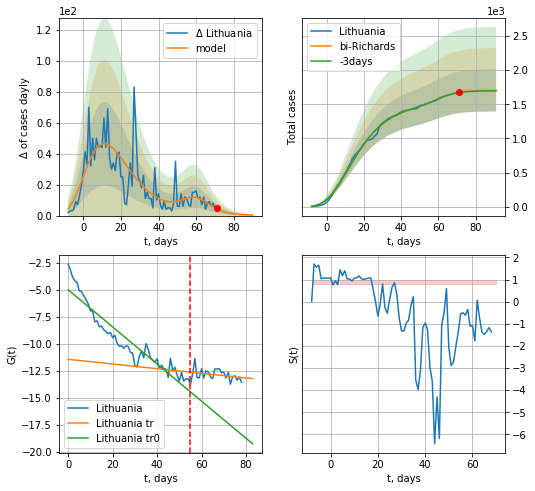

Lithuania data at: 2020-05-30
+3 day model MAPE: 0.001990
model: bi-Richards
coeffs: [2.04882962e+02 1.84667006e-01 6.03156447e+01 1.04473837e+00]
rational stdev: 0.181495
forecast at the end of period: +20 days
	 deltaDaycases: 0
	 total cases: 1703 ± 309
	 total death: 71 ± 38
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.890856
 intercept: -4.983620
 slope: -0.172264
trend coefficient of determination: 0.079983
 intercept: -11.439832
 slope: -0.021597


In [405]:
vL = 55
x = forecastRR('Lithuania',dfLT[3:vL],d1,11*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,12*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


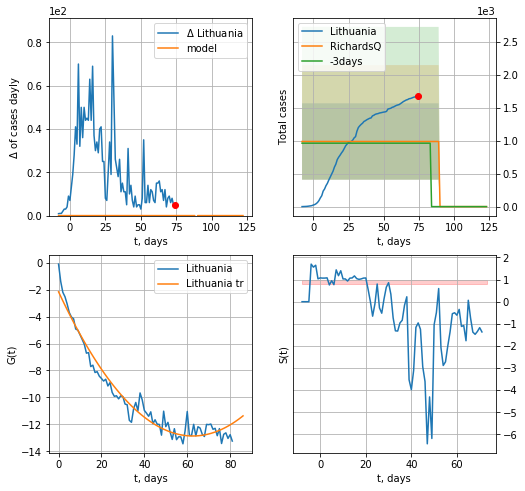

Lithuania data at: 2020-05-30
+3 day model MAPE: 0.026600
model: RichardsQ
coeffs: [ 9.87013253e+02 -2.09908907e+00 -1.15628255e+02  8.94768432e+01
  2.81976358e-01]
rational stdev: 0.586707
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 0 ± 0
	 total death: 0 ± 0
trend coefficient of determination: 0.957590
 intercept_: -2.1591073678181205
 coeffs_: [ 0.         -0.34178787  0.0027293 ]


In [402]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
81 2020-05-27  4001.0     100  110.0
82 2020-05-28  4008.0      95  110.0
83 2020-05-29  4012.0      87  110.0
84 2020-05-30  4016.0      91  110.0
85 2020-05-31  4018.0      75  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


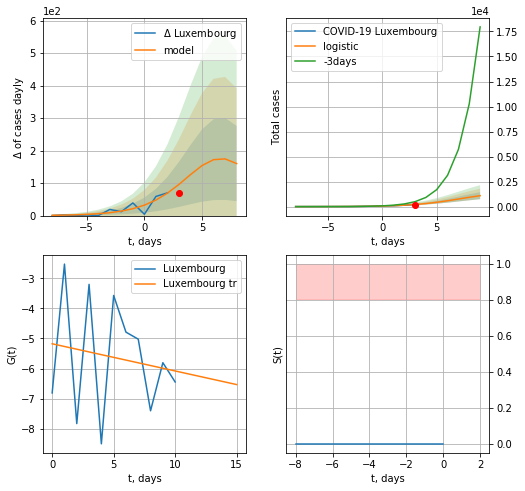

Luxembourg data at: 2020-05-31
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +6 days
	 deltaDaycases:  160
	 total cases:  1092 ± 351
	 total death:  29 ± 27
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


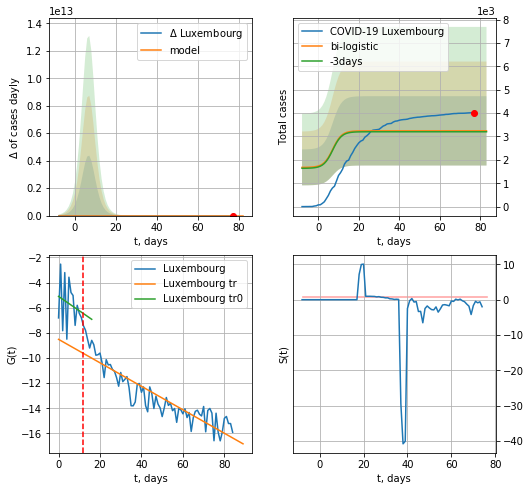

Luxembourg data at: 2020-05-31
+3 day model MAPE: 0.012204029365005836
model: bi-logistic
coeffs:  [1491.41329766   -6.05958472  231.84035386] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4569774391685488
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  3240 ± 1480
	 total death:  88 ± 120
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.826222
 intercept: -8.513316
 slope: -0.093352


In [266]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,10*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,10*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


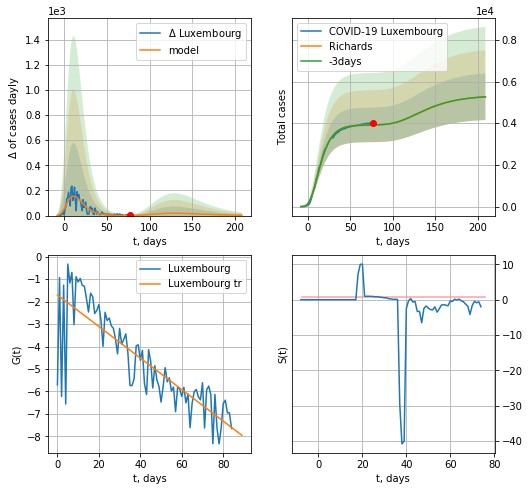

Luxembourg data at: 2020-05-31
+3 day model MAPE: 0.002398
model: Richards
coeffs: [ 3.92417364e+03  2.15469902e+01 -3.80928424e+01  4.98001924e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.211598
forecast at the end of period: +132 days
	 deltaDaycases: 2
	 total cases: 5271 ± 1115
	 total death: 144 ± 91
trend coefficient of determination: 0.694247
 intercept: -1.704156
 slope: -0.070236


In [267]:
x = forecastRR("Luxembourg",dfLX[:],d1,28*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


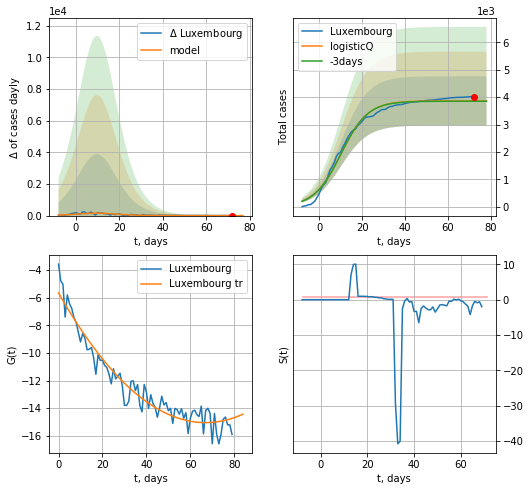

Luxembourg data at: 2020-05-31
+3 day model MAPE: 0.003537
model: logisticQ
coeffs: [ 3.86375531e+03  5.97163861e-07  1.01857394e+01 -2.66073411e+05]
rational stdev: 0.232759
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 3863 ± 899
	 total death: 105 ± 73
trend coefficient of determination: 0.929508
 intercept_: -5.658293475286481
 coeffs_: [ 0.         -0.28071907  0.00209778]


In [268]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,10*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
          date    cases   active   death
88 2020-05-27  38103.0  16403.0  3275.0
89 2020-05-28  38471.0  16733.0  3313.0
90 2020-05-29  38571.0  16047.0  3334.0
91 2020-05-30  38571.5  16047.0  3334.0
92 2020-05-31  39098.0  16148.0  3358.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


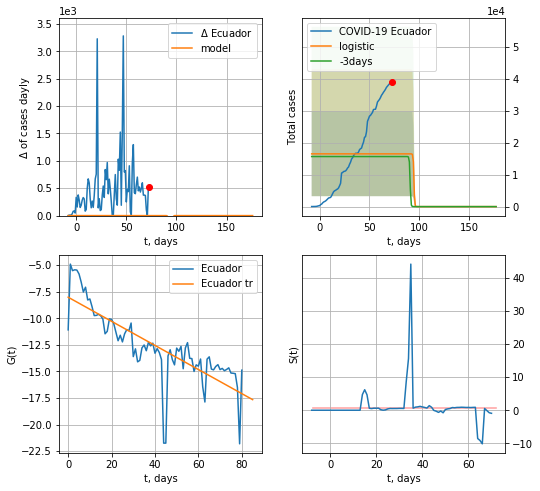

Ecuador data at: 2020-05-31
+3 day model MAPE: 0.05377845631946931
model: logistic
coeffs:  [ 1.65309703e+04 -2.96571148e+00  9.45827315e+01]
rational stdev:  0.8020892863873055
forecast at the end of period: +104 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.638219
 intercept: -8.015053
 slope: -0.113411


In [270]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


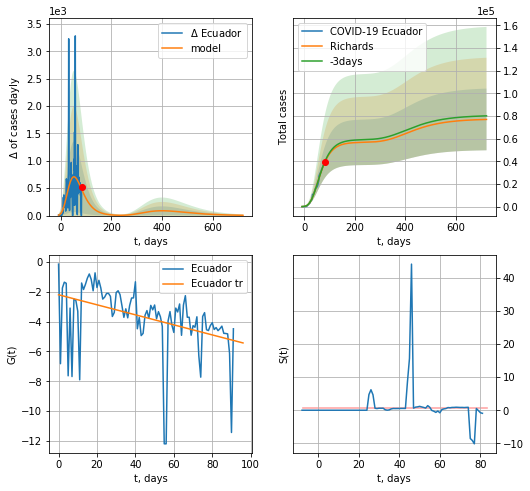

Ecuador data at: 2020-05-31
+3 day model MAPE: 0.013516
model: Richards
coeffs: [ 5.68633778e+04  2.04547114e+00 -6.65952558e+01  1.67073911e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.353793
forecast at the end of period: +636 days
	 deltaDaycases: 5
	 total cases: 76983 ± 27236
	 total death: 6611 ± 7016
trend coefficient of determination: 0.168627
 intercept: -2.205305
 slope: -0.033621


In [271]:
x = forecastRR("Ecuador",dfED[:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


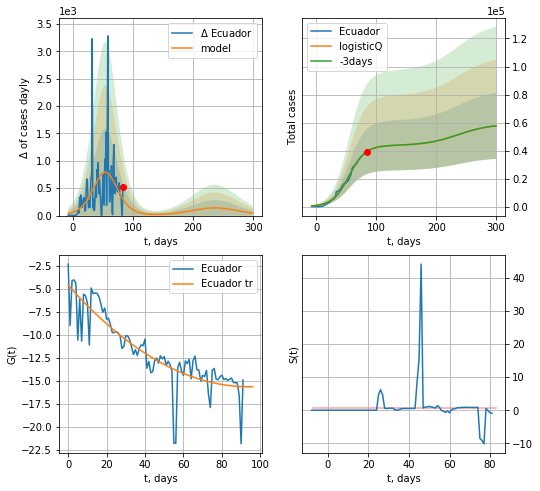

Ecuador data at: 2020-05-31
+3 day model MAPE: 0.000868
model: logisticQ
coeffs: [ 4.35536953e+04  9.38346013e-07  5.42338053e+01 -7.77745399e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.408710
forecast at the end of period: +216 days
	 deltaDaycases: 46
	 total cases: 57619 ± 23549
	 total death: 4948 ± 6066
trend coefficient of determination: 0.745542
 intercept_: -4.591964584287569
 coeffs_: [ 0.         -0.23434993  0.00124518]


In [272]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
          date   cases  active  death
92 2020-05-27  6692.0    1279  313.0
93 2020-05-28  6743.0     930  313.0
94 2020-05-29  6776.0     962  314.0
95 2020-05-30  6826.0    1010  316.0
96 2020-05-31  6859.0    1039  320.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


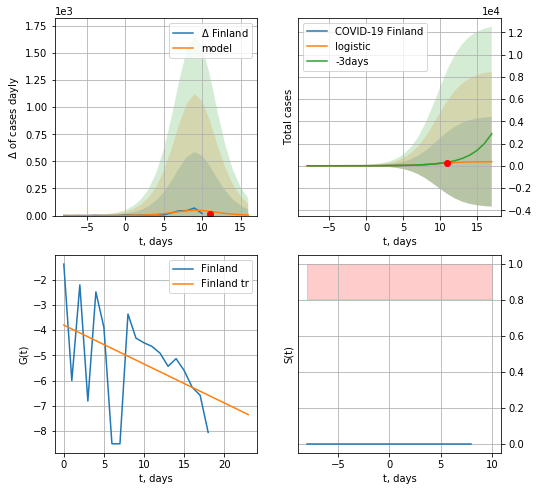

Finland data at: 2020-05-31
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +6 days
	 deltaDaycases:  4
	 total cases:  366 ± 4039
	 total death:  17 ± 562
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


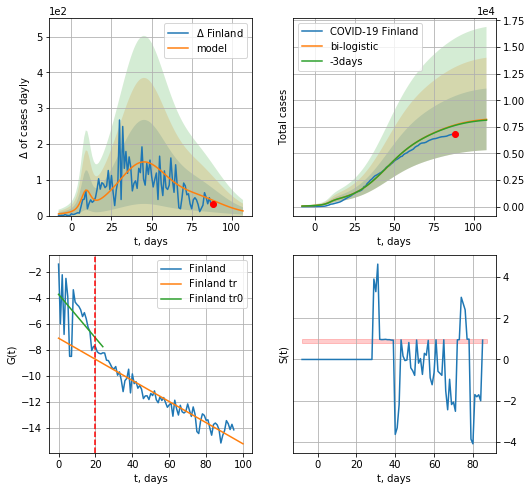

Finland data at: 2020-05-31
+3 day model MAPE: 0.005920902673990684
model: bi-logistic
coeffs:  [6.38131756e+03 9.07316620e-02 4.50280980e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3532067691017947
forecast at the end of period: +20 days
	 deltaDaycases:  13
	 total cases:  8201 ± 2896
	 total death:  382 ± 404
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.914214
 intercept: -7.099825
 slope: -0.081482


In [273]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*10-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


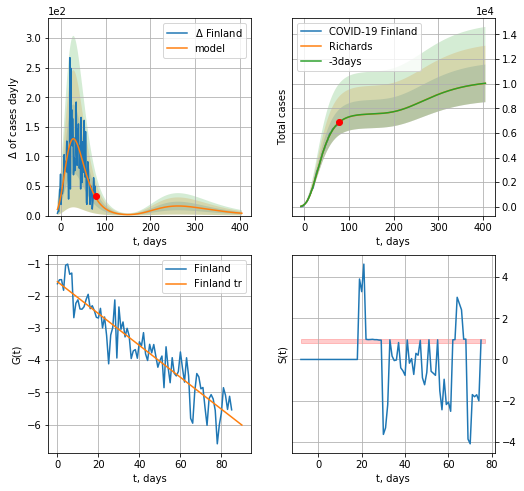

Finland data at: 2020-05-31
+3 day model MAPE: 0.000782
model: Richards
coeffs: [ 7.54929599e+03  2.03296050e+00 -5.11960190e+01  2.32880393e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.152422
forecast at the end of period: +328 days
	 deltaDaycases: 3
	 total cases: 10028 ± 1528
	 total death: 467 ± 213
trend coefficient of determination: 0.878108
 intercept: -1.563545
 slope: -0.049473


In [274]:
x = forecastRR("Finland",dfFI[10:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


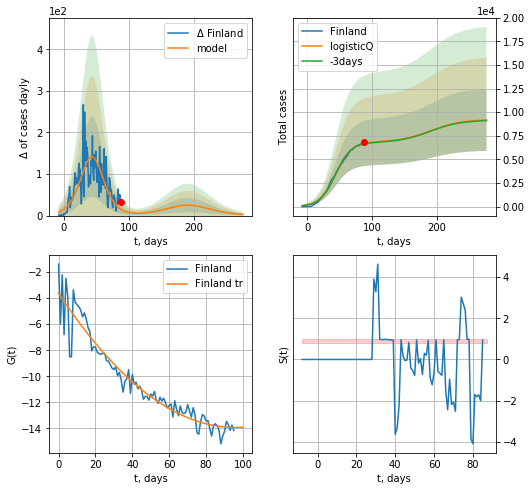

Finland data at: 2020-05-31
+3 day model MAPE: 0.007412
model: logisticQ
coeffs: [ 6.83002563e+03  5.85539540e-07  4.36871557e+01 -1.41443059e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357408
forecast at the end of period: +188 days
	 deltaDaycases: 2
	 total cases: 9182 ± 3281
	 total death: 428 ± 458
trend coefficient of determination: 0.919215
 intercept_: -3.6094395326026163
 coeffs_: [ 0.         -0.21507738  0.00112043]


In [275]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
          date  cases  active  death
78 2020-05-27   2477  1378.0  134.0
79 2020-05-28   2485  1333.0  136.0
80 2020-05-29   2499  1296.0  139.0
81 2020-05-30   2513  1299.0  140.0
82 2020-05-31   2513  1299.0  140.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


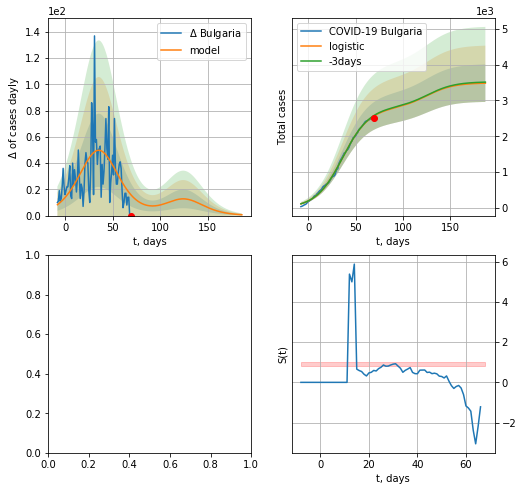

In [276]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


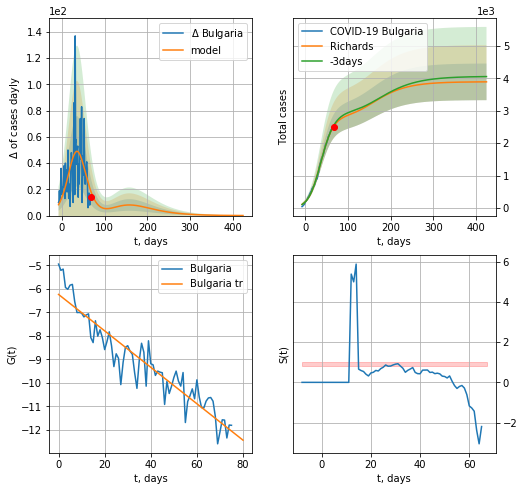

Bulgaria data at: 2020-05-30
+3 day model MAPE: 0.012168
model: Richards
coeffs: [2.86159527e+03 7.72241437e-02 3.30387896e+01 8.44338616e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.145271
forecast at the end of period: +357 days
	 deltaDaycases: 0
	 total cases: 3895 ± 565
	 total death: 217 ± 94
trend coefficient of determination: 0.882057
 intercept: -6.238080
 slope: -0.077440


In [283]:
x = forecastRR('Bulgaria',dfBL[5:],d1,60*7-dT,shift=1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


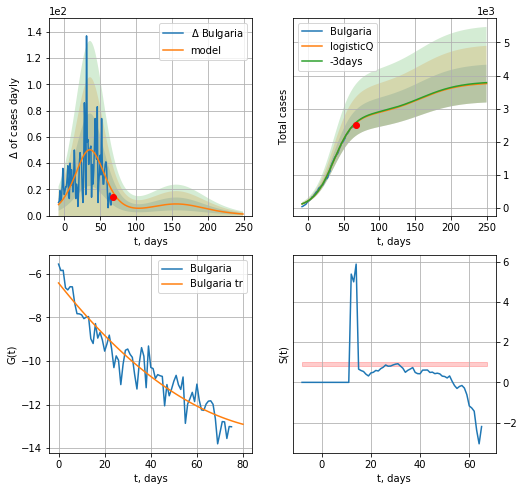

Bulgaria data at: 2020-05-30
+3 day model MAPE: 0.004586
model: logisticQ
coeffs: [ 2.79894852e+03  3.75072392e-06  3.59546129e+01 -1.89152398e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.151894
forecast at the end of period: +182 days
	 deltaDaycases: 1
	 total cases: 3756 ± 570
	 total death: 209 ± 95
trend coefficient of determination: 0.911542
 intercept_: -6.425861061056347
 coeffs_: [ 0.         -0.13332582  0.00065415]


In [284]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
          date   cases  active  death
90 2020-05-27  3065.0    63.0   57.0
91 2020-05-28  3076.0    74.0   57.0
92 2020-05-29  3077.0    59.0   57.0
93 2020-05-30  3081.0    61.0   57.0
94 2020-05-31  3082.0    60.0   57.0


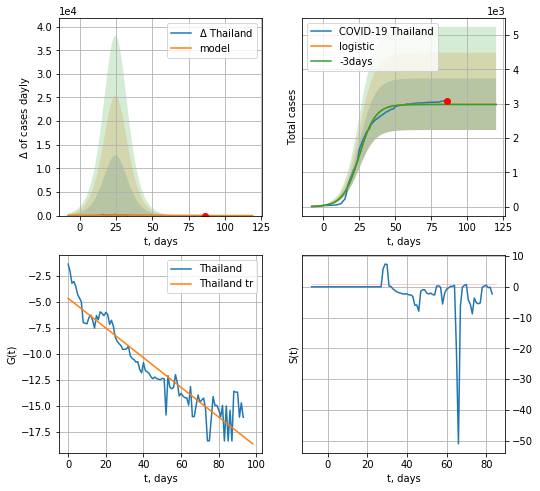

Thailand data at: 2020-05-31
+3 day model MAPE: 0.0028168546028383397
model: logistic
coeffs:  [2.98035493e+03 1.78630167e-01 2.50455902e+01]
rational stdev:  0.25179770904758153
forecast at the end of period: +34 days
	 deltaDaycases:  0
	 total cases:  2980 ± 750
	 total death:  55 ± 41
trend coefficient of determination: 0.879667
 intercept: -4.665795
 slope: -0.142303


In [277]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [278]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


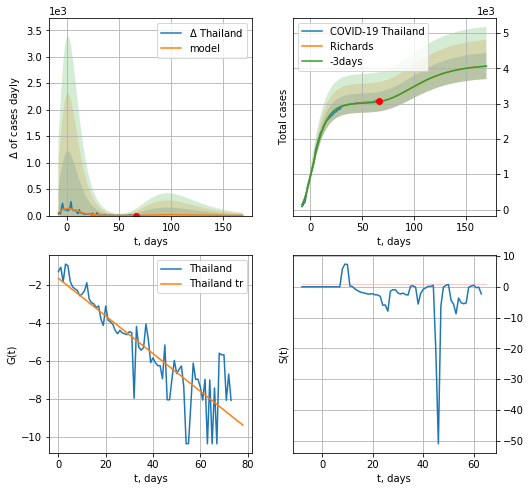

Thailand data at: 2020-05-31
+3 day model MAPE: 0.000723
model: Richards
coeffs: [ 3.02235439e+03  1.73023122e+01 -3.99732032e+01  6.92177204e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.090891
forecast at the end of period: +104 days
	 deltaDaycases: 2
	 total cases: 4063 ± 369
	 total death: 75 ± 20
trend coefficient of determination: 0.766992
 intercept: -1.656023
 slope: -0.099198


In [279]:
x = forecastRR("Thailand",dfTH[20:],d1,24*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


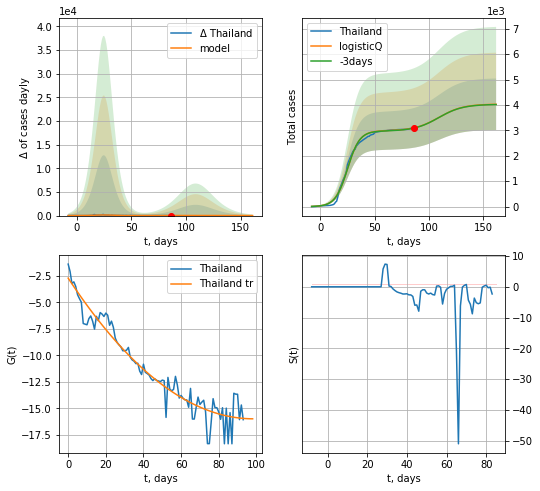

Thailand data at: 2020-05-31
+3 day model MAPE: 0.002614
model: logisticQ
coeffs: [ 2.98034413e+03  8.55897194e-07  2.50457769e+01 -2.08606376e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252019
forecast at the end of period: +76 days
	 deltaDaycases: 0
	 total cases: 4026 ± 1014
	 total death: 74 ± 55
trend coefficient of determination: 0.927829
 intercept_: -2.7100703170961395
 coeffs_: [ 0.         -0.26985767  0.0013716 ]


In [280]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

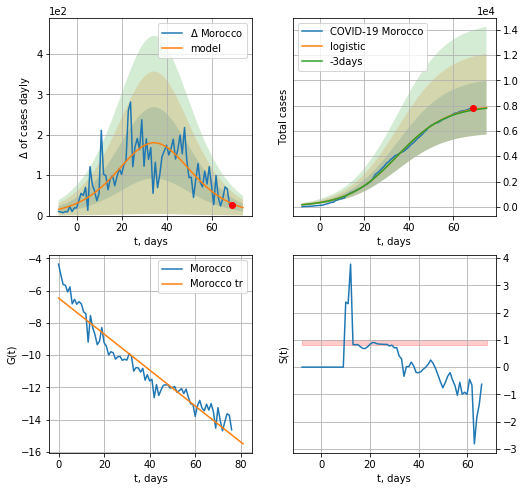

Morocco data at: 2020-05-31
+3 day model MAPE: 0.006287492640275446
model: logistic
coeffs:  [8.05694592e+03 8.94577837e-02 3.49486559e+01]
rational stdev:  0.27117911555262353
forecast at the end of period: +6 days
	 deltaDaycases:  19
	 total cases:  7839 ± 2125
	 total death:  205 ± 166
trend coefficient of determination: 0.925355
 intercept: -6.464343
 slope: -0.111547


In [281]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


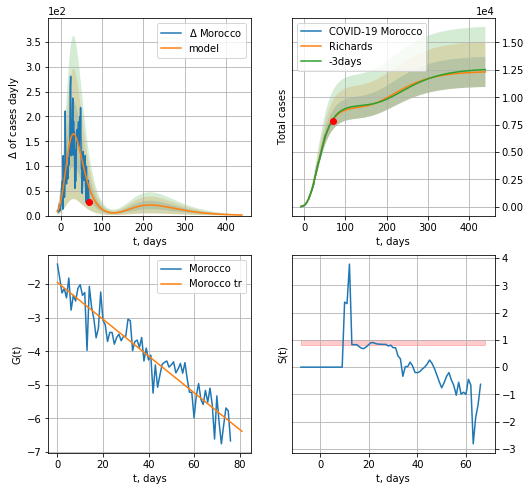

Morocco data at: 2020-05-31
+3 day model MAPE: 0.006767
model: Richards
coeffs: [ 9.08076689e+03  4.67334411e-01 -1.06834181e+01  1.11546239e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.111254
forecast at the end of period: +370 days
	 deltaDaycases: 1
	 total cases: 12309 ± 1369
	 total death: 323 ± 107
trend coefficient of determination: 0.896343
 intercept: -1.948808
 slope: -0.054735


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


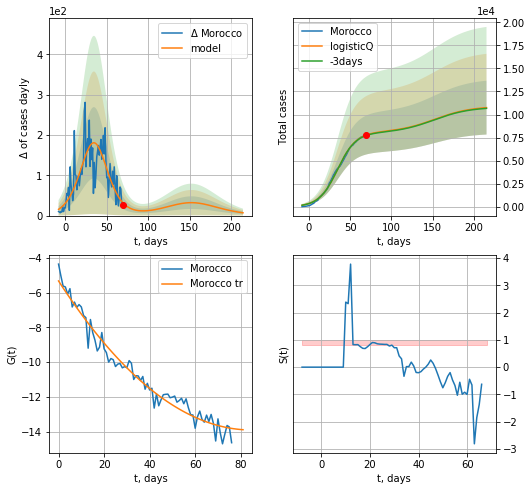

Morocco data at: 2020-05-31
+3 day model MAPE: 0.006206
model: logisticQ
coeffs: [ 8.05578122e+03  1.11688896e-06  3.49460818e+01 -8.00553465e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.271335
forecast at the end of period: +146 days
	 deltaDaycases: 6
	 total cases: 10748 ± 2916
	 total death: 282 ± 229
trend coefficient of determination: 0.967249
 intercept_: -5.331017360052231
 coeffs_: [ 0.         -0.20222364  0.00119319]


In [282]:
x = forecastRR("Morocco",dfMR[5:],d1,62*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

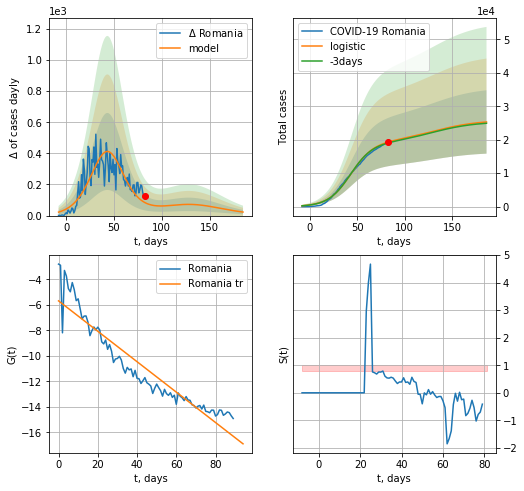

Romania data at: 2020-05-31
+3 day model MAPE: 0.013288761687529347
model: logistic
coeffs:  [1.91812387e+04 8.45417091e-02 4.33693004e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.37425524789578585
forecast at the end of period: +104 days
	 deltaDaycases:  22
	 total cases:  25316 ± 9474
	 total death:  1664 ± 1868
trend coefficient of determination: 0.887972
 intercept: -5.685071
 slope: -0.119273


In [283]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


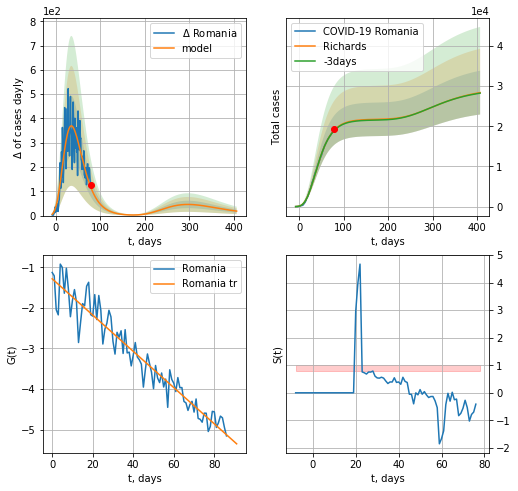

Romania data at: 2020-05-31
+3 day model MAPE: 0.004378
model: Richards
coeffs: [ 2.17460598e+04  4.11506853e+00 -6.09512153e+01  1.12925883e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.192056
forecast at the end of period: +328 days
	 deltaDaycases: 18
	 total cases: 28366 ± 5447
	 total death: 1864 ± 1073
trend coefficient of determination: 0.924014
 intercept: -1.282906
 slope: -0.044714


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


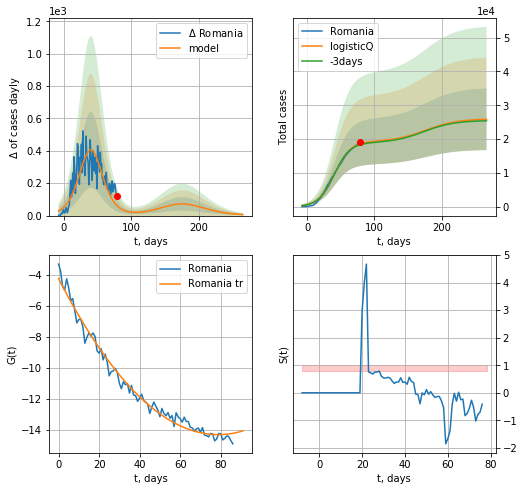

Romania data at: 2020-05-31
+3 day model MAPE: 0.014082
model: logisticQ
coeffs: [ 1.91908786e+04  5.52479583e-07  4.03852352e+01 -1.52681740e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.352526
forecast at the end of period: +188 days
	 deltaDaycases: 5
	 total cases: 25847 ± 9111
	 total death: 1699 ± 1796
trend coefficient of determination: 0.983970
 intercept_: -4.231972172150557
 coeffs_: [ 0.         -0.25605407  0.00162526]


In [284]:
x = forecastRR("Romania",dfRM[8:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [285]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
109 2020-05-27  1183737  307802  125193.0
110 2020-05-28  1191580  308479  125547.0
111 2020-05-29  1196230  307739  125930.0
112 2020-05-30  1201370  306992  126251.0
113 2020-05-31  1204043  306069  126419.0


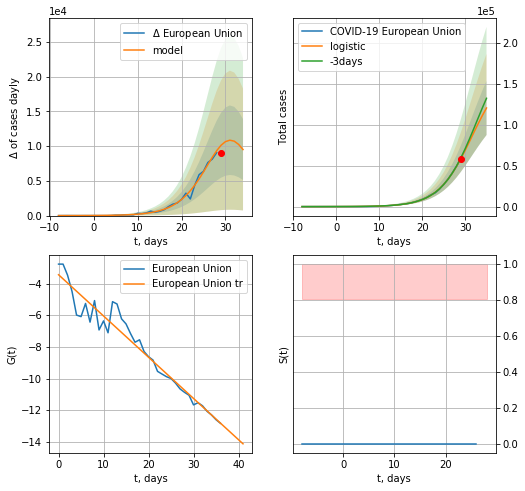

European Union data at: 2020-05-31
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +6 days
	 deltaDaycases:  9510
	 total cases:  120460 ± 33020
	 total death:  12647 ± 10400
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


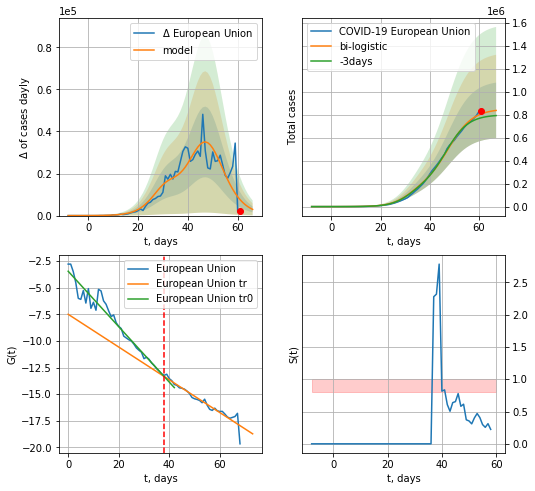

European Union data at: 2020-05-31
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +6 days
	 deltaDaycases:  2948
	 total cases:  838252 ± 242692
	 total death:  88012 ± 76444
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


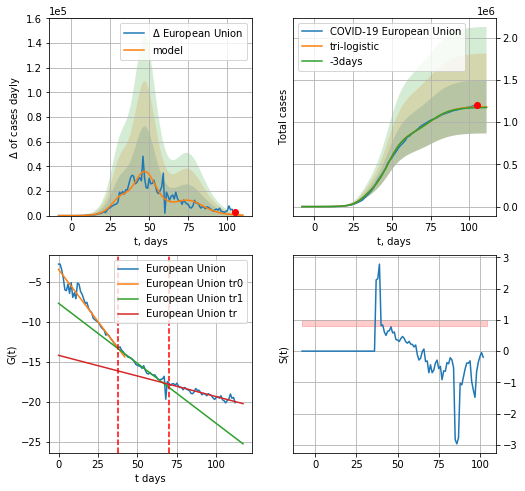

European Union data at: 2020-05-31
+3 day model MAPE: 0.007559987997986731
model: tri-logistic
coeffs:  [3.33244302e+05 1.43863255e-01 7.54129909e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.2665608212908037
forecast at the end of period: +6 days
	 deltaDaycases:  304
	 total cases:  1183016 ± 315345
	 total death:  124211 ± 99329
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.867280
 intercept: -14.182317
 slope: -0.051654


In [286]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,10*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


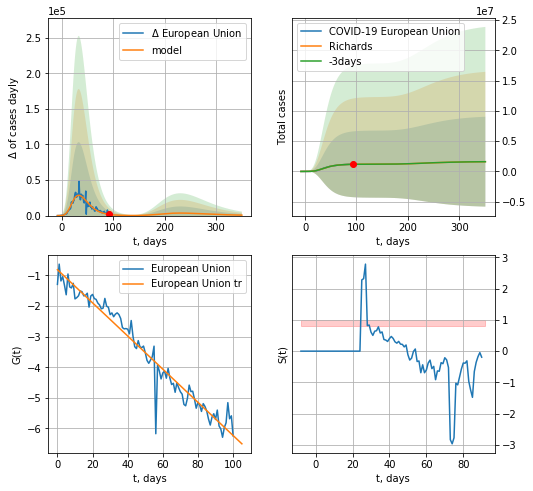

European Union data at: 2020-05-31
+3 day model MAPE: 0.004166
model: Richards
coeffs: [ 1.20443460e+06  6.73539918e+00 -3.79532739e+01  9.61746754e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 4.606348
forecast at the end of period: +258 days
	 deltaDaycases: 638
	 total cases: 1611330 ± 7422350
	 total death: 169182 ± 2337933
trend coefficient of determination: 0.953065
 intercept: -0.809607
 slope: -0.054236


In [287]:
x = forecastRR("European Union",dfEU[12:],d1,46*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


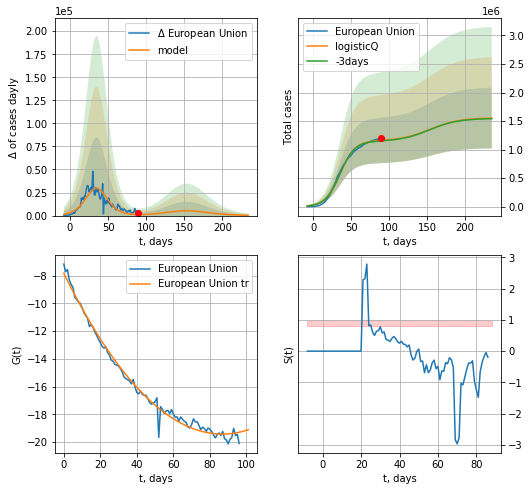

European Union data at: 2020-05-31
+3 day model MAPE: 0.007855
model: logisticQ
coeffs: [ 1.15112817e+06  4.31408053e-07  3.52648005e+01 -2.39473421e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342800
forecast at the end of period: +146 days
	 deltaDaycases: 308
	 total cases: 1552950 ± 532351
	 total death: 163052 ± 167682
trend coefficient of determination: 0.989112
 intercept_: -7.82490419879035
 coeffs_: [ 0.         -0.26748963  0.00154155]


In [288]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/numpy/lib/function_base.py:1269: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


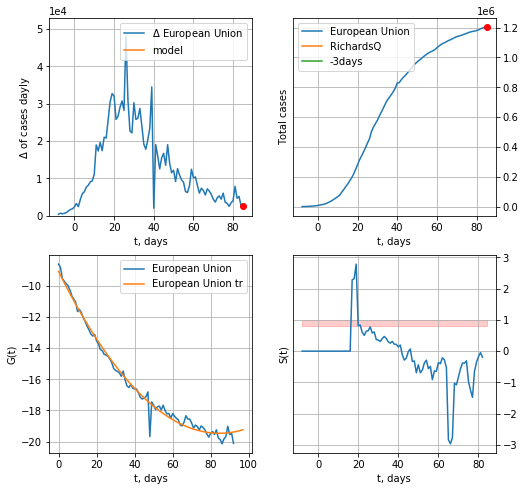

European Union data at: 2020-05-31
+3 day model MAPE: nan
model: RichardsQ
coeffs: [ 6.56156052e+05  4.34732772e+00 -1.28785737e+03  1.09737646e+03
 -2.22974953e+00]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: 0.681016
forecast at the end of period: +34 days


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:115: RuntimeWarning: invalid value encountered in double_scalars


ValueError: cannot convert float NaN to integer

In [289]:
x = forecastQR("European Union",dfEU[20:],d1,14*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [ ]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [ ]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [ ]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [ ]:
#dfIC[:]

IC
          date   cases  active  death
87 2020-05-27  1805.0       3   10.0
88 2020-05-28  1805.1       3   10.0
89 2020-05-29  1805.2       1   10.0
90 2020-05-30  1806.0       2   10.0
91 2020-05-31  1806.0       2   10.0


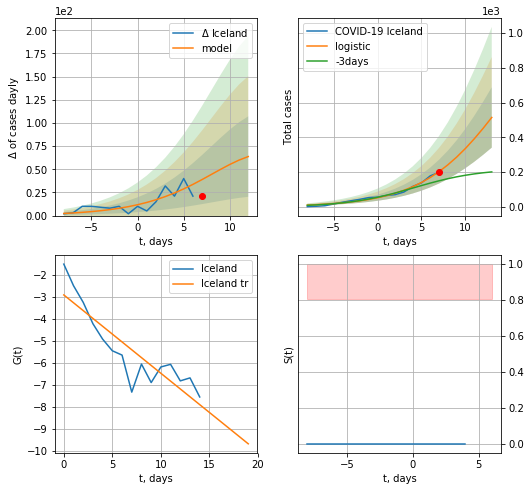

Iceland data at: 2020-05-31
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +6 days
	 deltaDaycases:  63
	 total cases:  514 ± 173
	 total death:  2 ± 2
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


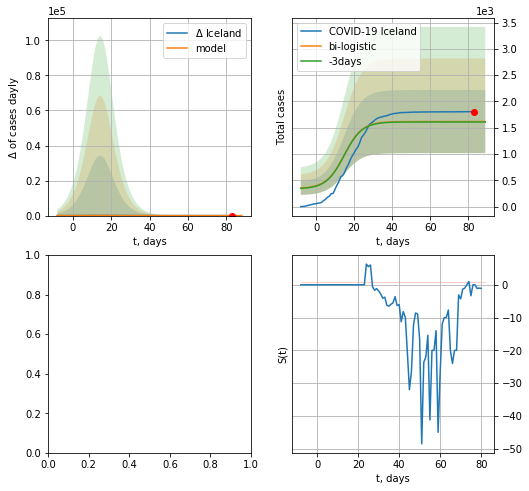

In [290]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


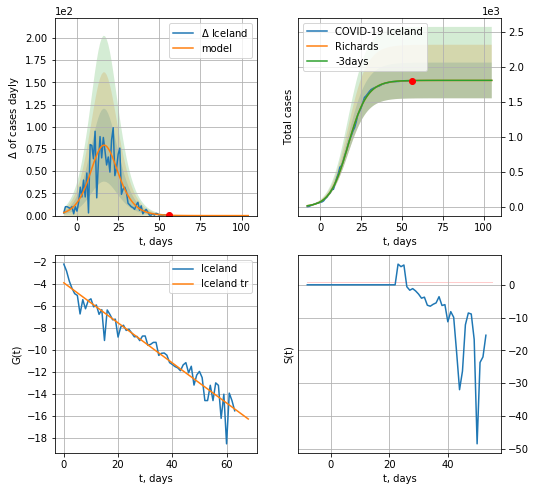

Iceland data at: 2020-05-30
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 10 ± 4
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


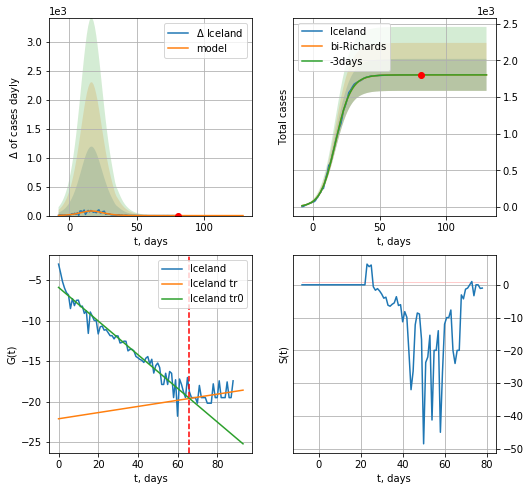

Iceland data at: 2020-05-30
+3 day model MAPE: 0.000218
model: bi-Richards
coeffs: [-3.16858656  1.19363782 35.06135176  1.29585741]
rational stdev: 0.121173
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 1803 ± 218
	 total death: 9 ± 3
bi-Richards approximation splitting point: 66
trend coefficient of determination: 0.942959
 intercept: -5.892752
 slope: -0.207871
trend coefficient of determination: 0.082667
 intercept: -22.128589
 slope: 0.038025


In [302]:
vL = 66
x = forecastRR("Iceland",dfIC[1:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[1:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


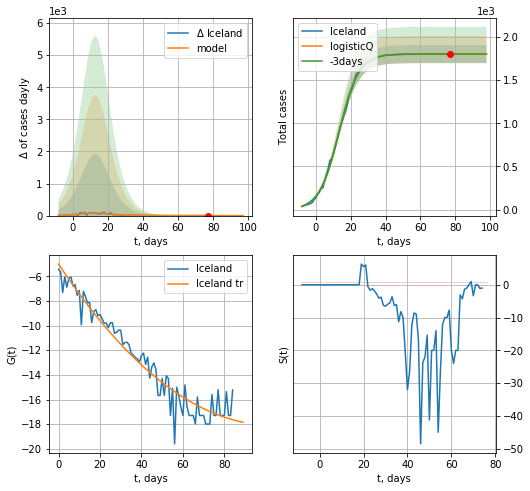

Iceland data at: 2020-05-30
+3 day model MAPE: 0.000117
model: logisticQ
coeffs: [ 1.80267683e+03  8.35445177e-06  1.33258395e+01 -2.11907264e+04]
rational stdev: 0.058147
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1802 ± 104
	 total death: 9 ± 1
trend coefficient of determination: 0.933689
 intercept_: -5.015116946837249
 coeffs_: [ 0.         -0.25356125  0.00122989]


In [303]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
          date  cases  active  death
78 2020-05-27  11728  4034.0  315.0
79 2020-05-28  12131  4432.0  320.0
80 2020-05-29  12531  4665.0  326.0
81 2020-05-30  13018  3274.0  330.0
82 2020-05-31  13463  3613.0  336.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


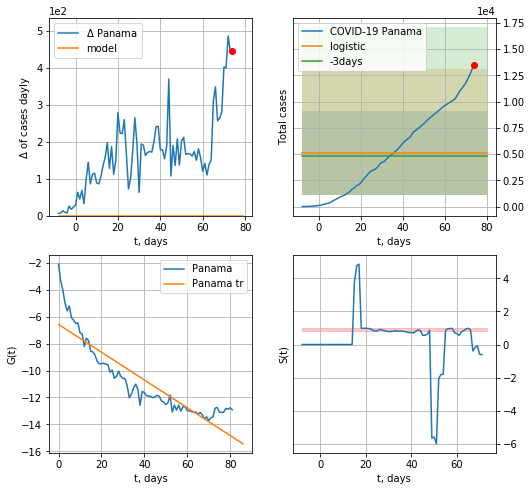

Panama data at: 2020-05-31
+3 day model MAPE: 0.06203508676052481
model: logistic
coeffs:  [ 5.08437350e+03 -3.69906994e+00  1.17388141e+02]
rational stdev:  0.788248850597083
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  5084 ± 4007
	 total death:  126 ± 297
trend coefficient of determination: 0.808028
 intercept: -6.578971
 slope: -0.103061


In [291]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


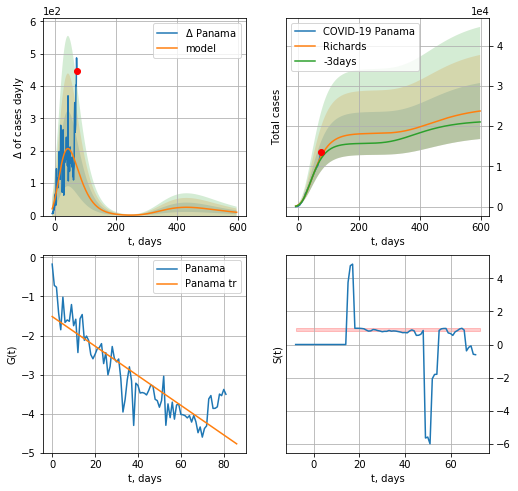

Panama data at: 2020-05-31
+3 day model MAPE: 0.046018
model: Richards
coeffs: [ 1.82135958e+04  3.18924054e+00 -1.05194977e+02  9.72887593e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.293237
forecast at the end of period: +524 days
	 deltaDaycases: 10
	 total cases: 23759 ± 6967
	 total death: 592 ± 520
trend coefficient of determination: 0.771039
 intercept: -1.514140
 slope: -0.037842


In [292]:
x = forecastRR("Panama",dfPM[:],d1,84*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


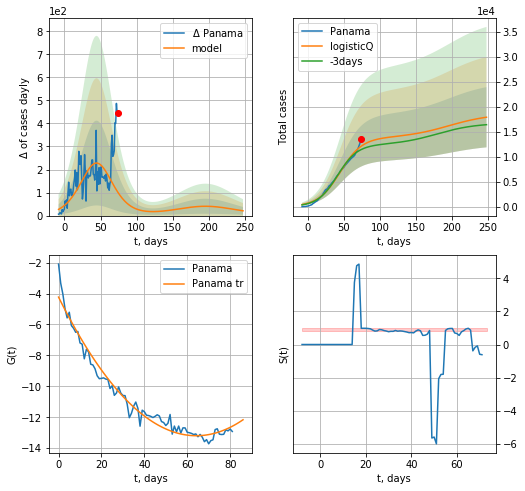

Panama data at: 2020-05-31
+3 day model MAPE: 0.061087
model: logisticQ
coeffs: [ 1.37381295e+04  4.22897724e-07  4.48849894e+01 -1.56294618e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336811
forecast at the end of period: +174 days
	 deltaDaycases: 20
	 total cases: 17878 ± 6021
	 total death: 446 ± 450
trend coefficient of determination: 0.969060
 intercept_: -4.232808754597535
 coeffs_: [ 0.         -0.27903564  0.0021726 ]


In [293]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

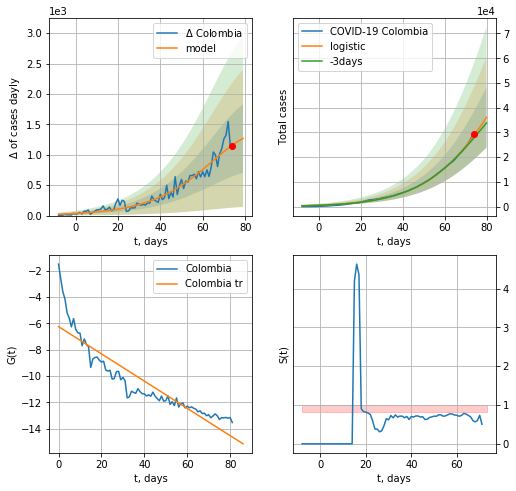

Colombia data at: 2020-05-31
+3 day model MAPE: 0.04093970471647719
model: logistic
coeffs:  [9.39072413e+04 5.74421389e-02 8.82119681e+01]
rational stdev:  0.33798967646855627
forecast at the end of period: +6 days
	 deltaDaycases:  1267
	 total cases:  36080 ± 12194
	 total death:  1153 ± 1169
trend coefficient of determination: 0.822625
 intercept: -6.245537
 slope: -0.103480


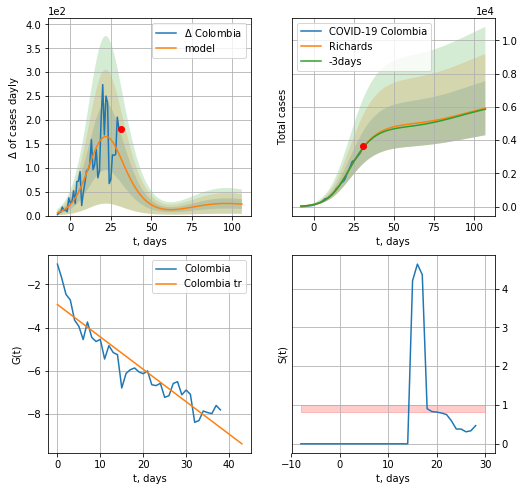

Colombia data at: 2020-05-31
+3 day model MAPE: 0.003462
model: Richards
coeffs: [4.99315067e+03 1.95979830e-01 1.78374870e+01 5.90307623e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.275146
forecast at the end of period: +76 days
	 deltaDaycases: 23
	 total cases: 5923 ± 1629
	 total death: 189 ± 156
trend coefficient of determination: 0.874880
 intercept: -2.931794
 slope: -0.150492


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


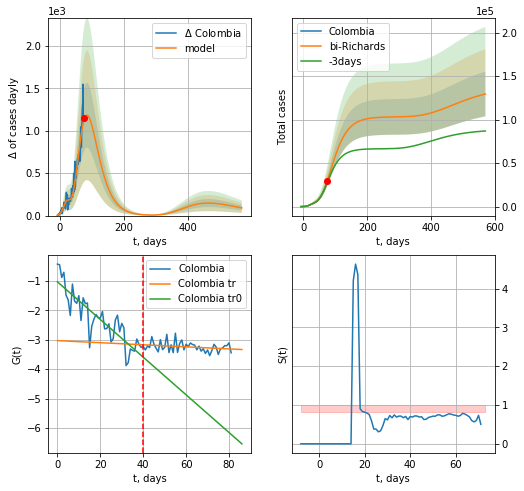

Colombia data at: 2020-05-31
+3 day model MAPE: 0.050356
model: bi-Richards
coeffs: [ 9.82115862e+04  1.69932997e+00 -3.42194051e+01  1.94442717e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.198496
forecast at the end of period: +496 days
	 deltaDaycases: 90
	 total cases: 129454 ± 25696
	 total death: 4137 ± 2463
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.747954
 intercept: -1.029426
 slope: -0.064061
trend coefficient of determination: 0.062373
 intercept: -3.029008
 slope: -0.003520


In [294]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,10*7-dT)
x = forecastRR("Colombia",dfCB[:40],d1,20*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,80*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


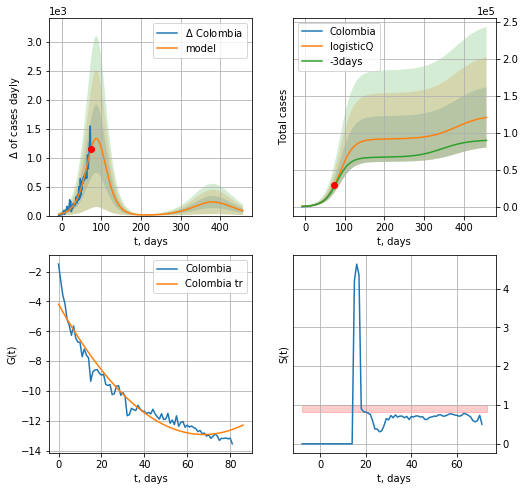

Colombia data at: 2020-05-31
+3 day model MAPE: 0.041286
model: logisticQ
coeffs: [ 9.15946237e+04  5.77499842e-06  8.74571299e+01 -9.96852454e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338285
forecast at the end of period: +384 days
	 deltaDaycases: 83
	 total cases: 120885 ± 40893
	 total death: 3863 ± 3920
trend coefficient of determination: 0.947204
 intercept_: -4.192097239866308
 coeffs_: [ 0.         -0.25749893  0.00190154]


In [295]:
x = forecastRRR("Colombia",dfCB[:],d1,64*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date   cases  active  death
84 2020-05-27  8857.0  3105.0  623.0
85 2020-05-28  8997.0  3090.0  630.0
86 2020-05-29  9134.0  3074.0  638.0
87 2020-05-30  9267.0  3072.0  646.0
88 2020-05-31  9394.0  2993.0  653.0


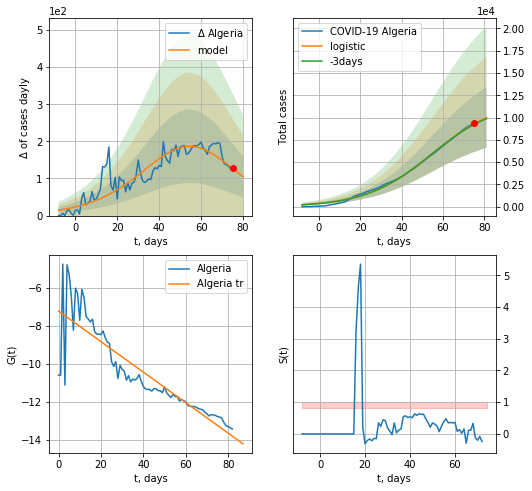

Algeria data at: 2020-05-31
+3 day model MAPE: 0.009119310947143964
model: logistic
coeffs:  [1.19649298e+04 6.24452425e-02 5.49685546e+01]
rational stdev:  0.33935540698858435
forecast at the end of period: +6 days
	 deltaDaycases:  104
	 total cases:  9997 ± 3392
	 total death:  694 ± 706
trend coefficient of determination: 0.776159
 intercept: -7.213073
 slope: -0.080622


In [296]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,10*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


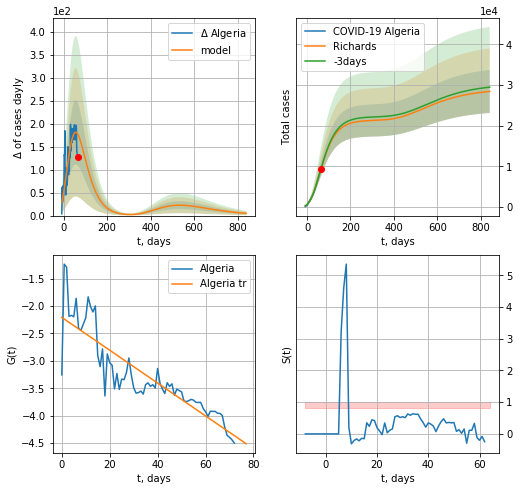

Algeria data at: 2020-05-31
+3 day model MAPE: 0.006171
model: Richards
coeffs: [ 2.13425519e+04  1.09105073e+00 -1.08062673e+02  2.14327273e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.186178
forecast at the end of period: +776 days
	 deltaDaycases: 4
	 total cases: 28439 ± 5294
	 total death: 1976 ± 1103
trend coefficient of determination: 0.767488
 intercept: -2.205898
 slope: -0.029976


In [297]:
x = forecastRR("Algeria",dfAR[15:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


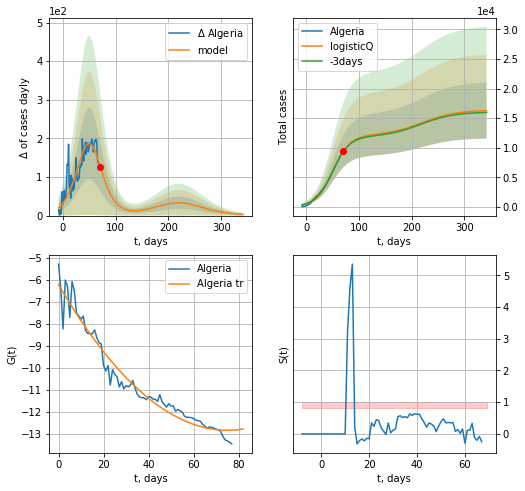

Algeria data at: 2020-05-31
+3 day model MAPE: 0.007792
model: logisticQ
coeffs: [ 1.20887587e+04  1.18331485e-06  5.03534530e+01 -5.21000344e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.289972
forecast at the end of period: +272 days
	 deltaDaycases: 2
	 total cases: 16276 ± 4719
	 total death: 1131 ± 983
trend coefficient of determination: 0.953767
 intercept_: -6.199744148214468
 coeffs_: [ 0.         -0.17627163  0.00117103]


In [298]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

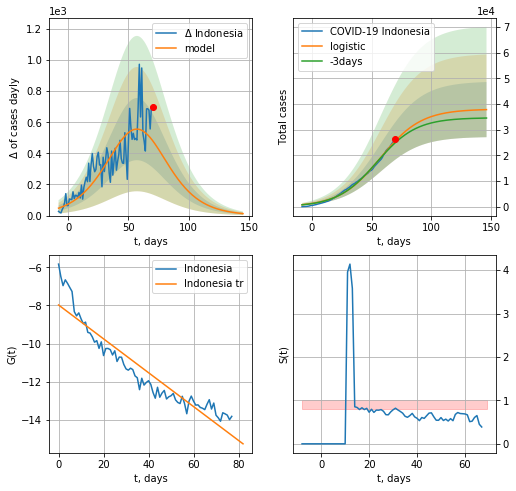

Indonesia data at: 2020-05-31
+3 day model MAPE: 0.02987446261389289
model: logistic
coeffs:  [3.80227916e+04 5.84906010e-02 5.74422732e+01]
rational stdev:  0.2837610192688172
forecast at the end of period: +76 days
	 deltaDaycases:  12
	 total cases:  37809 ± 10728
	 total death:  2303 ± 1960
trend coefficient of determination: 0.890291
 intercept: -7.975700
 slope: -0.088796


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


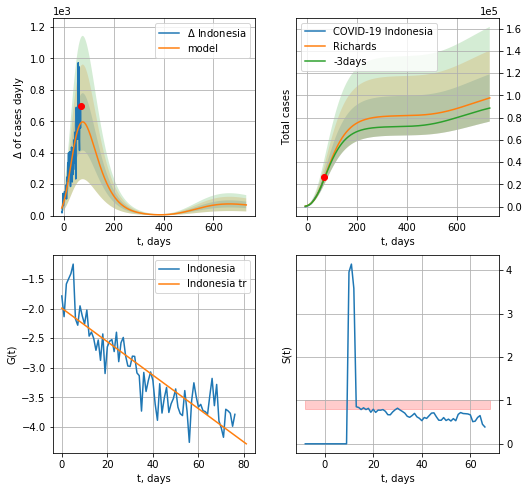

Indonesia data at: 2020-05-31
+3 day model MAPE: 0.015725
model: Richards
coeffs: [ 8.19039418e+04  1.34476730e+00 -1.34841957e+02  1.48293722e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.217617
forecast at the end of period: +664 days
	 deltaDaycases: 67
	 total cases: 97716 ± 21264
	 total death: 5953 ± 3886
trend coefficient of determination: 0.800718
 intercept: -1.994728
 slope: -0.028228


In [299]:
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,104*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


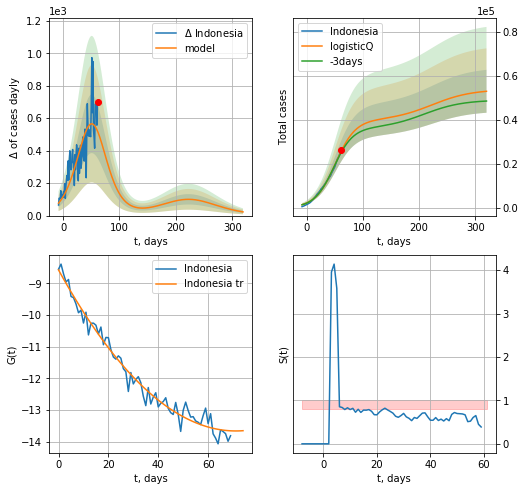

Indonesia data at: 2020-05-31
+3 day model MAPE: 0.025566
model: logisticQ
coeffs: [ 3.98015658e+04  2.23476370e-06  5.11393773e+01 -2.52360065e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.184306
forecast at the end of period: +258 days
	 deltaDaycases: 22
	 total cases: 53056 ± 9778
	 total death: 3232 ± 1787
trend coefficient of determination: 0.975869
 intercept_: -8.574852698846717
 coeffs_: [ 0.         -0.14312556  0.00100594]


In [300]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


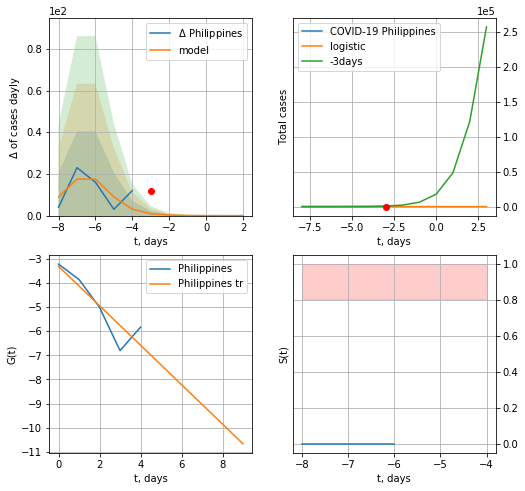

Philippines data at: 2020-05-31
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  3 ± 1
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


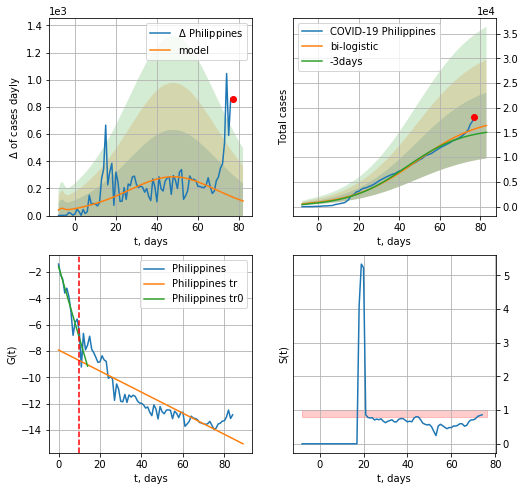

Philippines data at: 2020-05-31
+3 day model MAPE: 0.07765536854177907
model: bi-logistic
coeffs:  [1.81985214e+04 6.28136932e-02 4.83648814e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.40514371663148796
forecast at the end of period: +6 days
	 deltaDaycases:  107
	 total cases:  16404 ± 6646
	 total death:  868 ± 1054
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.769304
 intercept: -7.918450
 slope: -0.080170


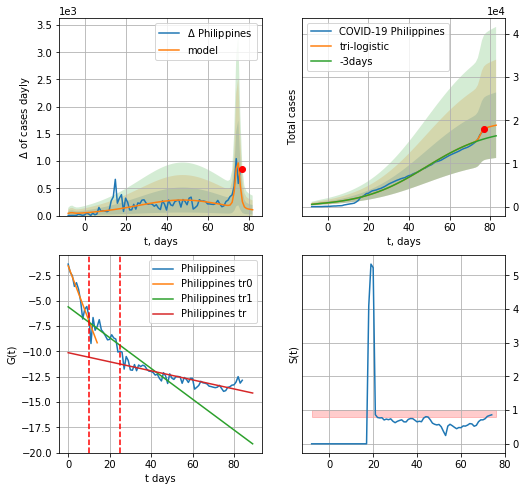

Philippines data at: 2020-05-31
+3 day model MAPE: 0.15312713317156418
model: tri-logistic
coeffs:  [2.45902790e+03 1.46650566e+00 7.51637309e+01] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  1.81985214e+04
  6.28136932e-02  4.83648814e+01]
forecast rational stdev:  0.40245466414967707
forecast at the end of period: +6 days
	 deltaDaycases:  107
	 total cases:  18863 ± 7591
	 total death:  998 ± 1204
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.721756
 intercept: -10.126307
 slope: -0.044700


In [301]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,10*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,10*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


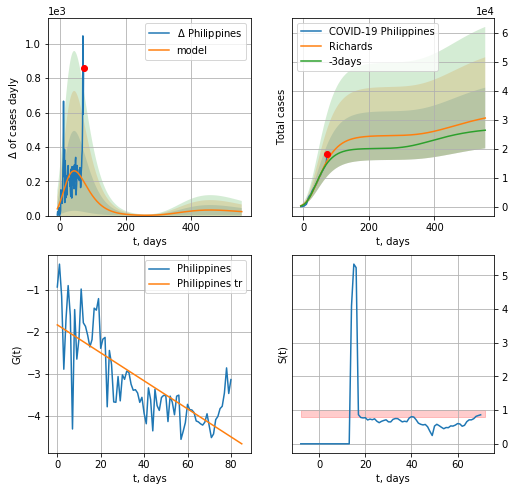

Philippines data at: 2020-05-31
+3 day model MAPE: 0.061593
model: Richards
coeffs: [ 2.45707175e+04  3.04814912e+00 -1.16886419e+02  9.50070662e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.342764
forecast at the end of period: +482 days
	 deltaDaycases: 23
	 total cases: 30626 ± 10497
	 total death: 1620 ± 1665
trend coefficient of determination: 0.586299
 intercept: -1.837213
 slope: -0.033234


In [302]:
x = forecastRR("Philippines",dfPH[4:],d1,78*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


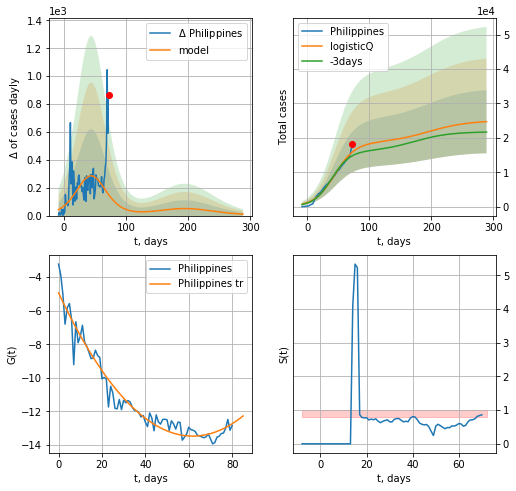

Philippines data at: 2020-05-31
+3 day model MAPE: 0.074730
model: logisticQ
coeffs: [ 1.85095118e+04  4.83838486e-07  4.47598635e+01 -1.26569239e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371546
forecast at the end of period: +216 days
	 deltaDaycases: 10
	 total cases: 24721 ± 9185
	 total death: 1308 ± 1457
trend coefficient of determination: 0.947815
 intercept_: -4.935737443626983
 coeffs_: [ 0.         -0.27650093  0.0022365 ]


In [303]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
          date  cases  active  death
88 2020-05-27   2903    1356  173.0
89 2020-05-28   2906    1357  175.0
90 2020-05-29   2909    1360  175.0
91 2020-05-30   2915    1366  175.0
92 2020-05-31   2917    1368  175.0


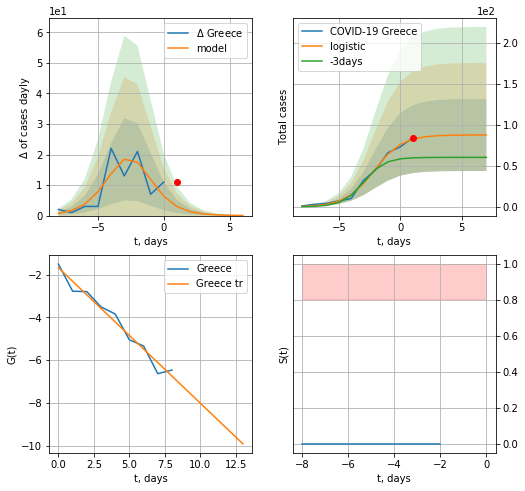

Greece data at: 2020-05-31
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  5 ± 7
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


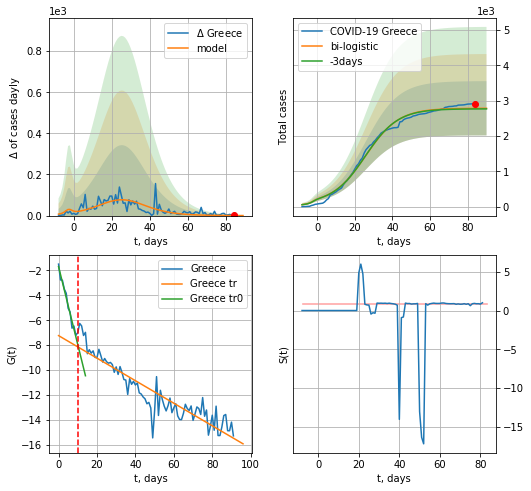

Greece data at: 2020-05-31
+3 day model MAPE: 0.006166585368158228
model: bi-logistic
coeffs:  [2.69879292e+03 1.14060564e-01 2.57579744e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.27580352143643444
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  2784 ± 767
	 total death:  167 ± 138
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.843012
 intercept: -7.230868
 slope: -0.090294


In [304]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,10*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


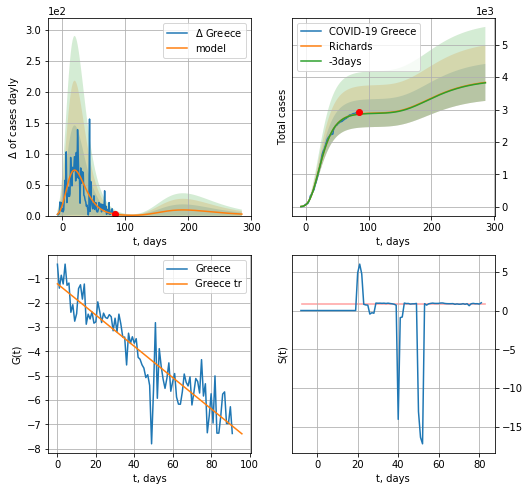

Greece data at: 2020-05-31
+3 day model MAPE: 0.003039
model: Richards
coeffs: [ 2.89627034e+03  6.43956769e+00 -4.55564274e+01  1.07759591e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.148969
forecast at the end of period: +202 days
	 deltaDaycases: 2
	 total cases: 3838 ± 571
	 total death: 230 ± 102
trend coefficient of determination: 0.843618
 intercept: -1.222379
 slope: -0.064183


In [305]:
x = forecastRR("Greece",dfGC[:],d1,38*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


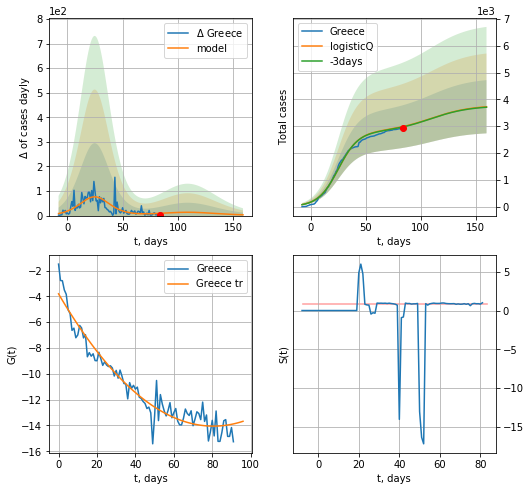

Greece data at: 2020-05-31
+3 day model MAPE: 0.004590
model: logisticQ
coeffs: [ 2.79524114e+03  4.63257916e-07  2.51115562e+01 -2.34580210e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266412
forecast at the end of period: +76 days
	 deltaDaycases: 3
	 total cases: 3726 ± 992
	 total death: 223 ± 178
trend coefficient of determination: 0.933671
 intercept_: -3.8074685925749847
 coeffs_: [ 0.         -0.25431868  0.00157794]


In [306]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
82 2020-05-27   3816    1311  509.0
83 2020-05-28   3841    1300  517.0
84 2020-05-29   3867    1201  524.0
85 2020-05-30   3876    1203  526.0
86 2020-05-31   3876    1203  526.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


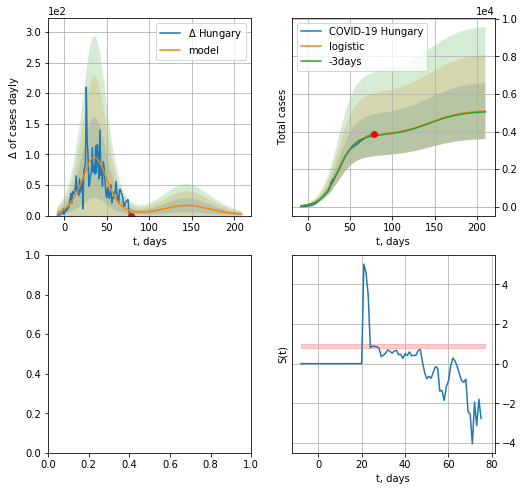

In [307]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


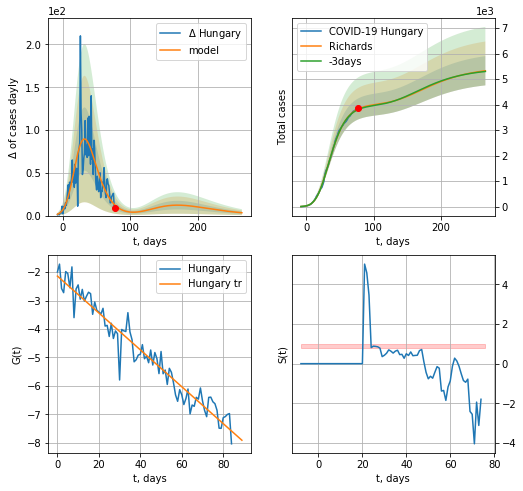

Hungary data at: 2020-05-30
+3 day model MAPE: 0.006003
model: Richards
coeffs: [4.02092457e+03 2.83306966e-01 1.13689484e+01 2.38661850e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.107498
forecast at the end of period: +189 days
	 deltaDaycases: 3
	 total cases: 5326 ± 572
	 total death: 721 ± 232
trend coefficient of determination: 0.940030
 intercept: -2.137623
 slope: -0.064875


In [410]:
x = forecastRR("Hungary",dfHG[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


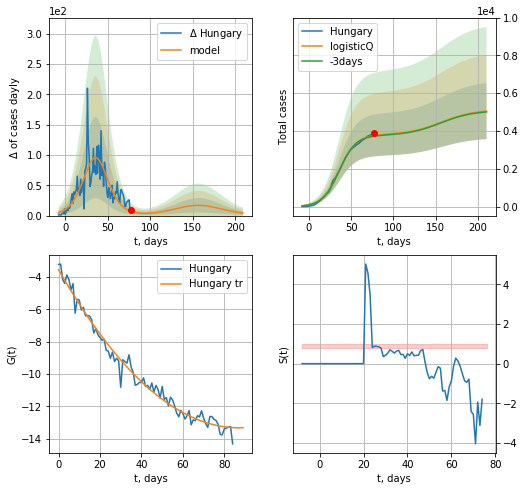

Hungary data at: 2020-05-30
+3 day model MAPE: 0.009957
model: logisticQ
coeffs: [ 3.79798733e+03  8.70542878e-07  3.59967627e+01 -1.15281277e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.293289
forecast at the end of period: +133 days
	 deltaDaycases: 4
	 total cases: 5056 ± 1483
	 total death: 685 ± 602
trend coefficient of determination: 0.980987
 intercept_: -3.5453652266708797
 coeffs_: [ 0.         -0.22514847  0.00129455]


In [411]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


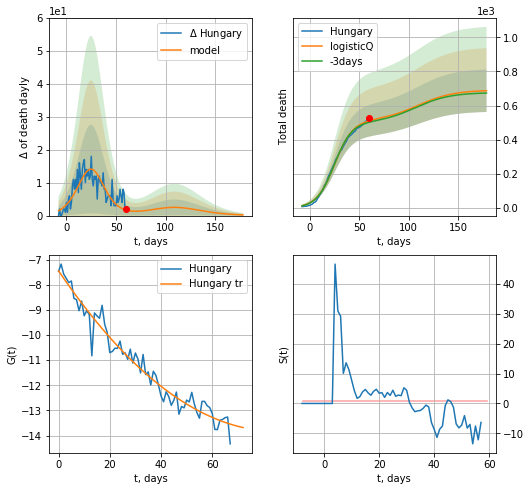

Hungary data at: 2020-05-30
+3 day model MAPE: 0.017285
model: logisticQ
coeffs: [ 5.10319779e+02  1.08218131e-06  2.50881072e+01 -1.01448843e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.181339
forecast at the end of period: +119 days
	 total death: 687 ± 124
trend coefficient of determination: 0.957639
 intercept_: -7.444725699103337
 coeffs_: [ 0.         -0.15011557  0.00088207]


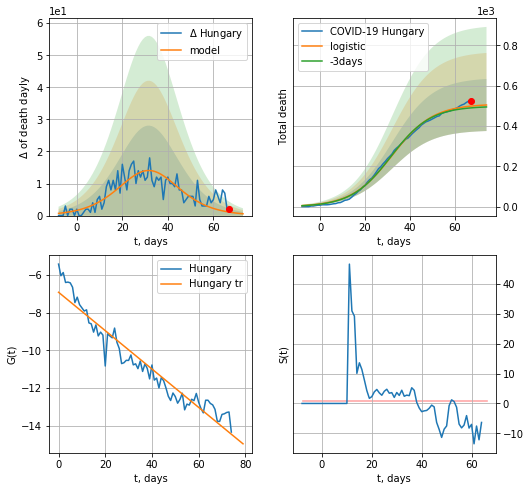

Hungary data at: 2020-05-30
+3 day model MAPE: 0.018142183161544884
model: logistic
coeffs:  [5.09708928e+02 1.10415933e-01 3.20613545e+01]
rational stdev:  0.2556816537553598
forecast at the end of period: +7 days
	 total death:  504 ± 129
trend coefficient of determination: 0.928346
 intercept: -6.918368
 slope: -0.101657


In [413]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,10*7-dT,cases='death')

MT
          date  cases  active  death
80 2020-05-27  612.0     114    7.0
81 2020-05-28  616.0     108    7.0
82 2020-05-29  616.5      93    9.0
83 2020-05-30  618.0      84    9.0
84 2020-05-31  618.0      75    9.0


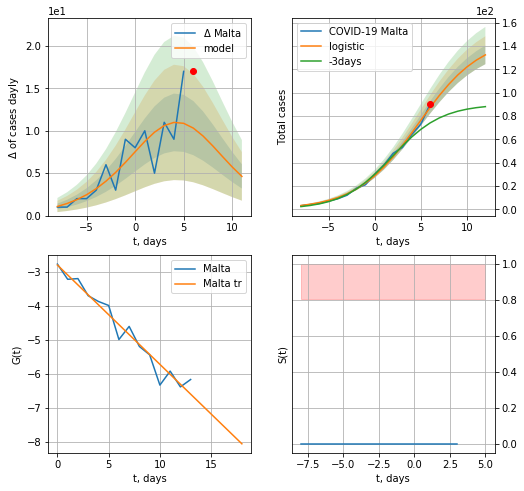

Malta data at: 2020-05-31
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +6 days
	 deltaDaycases:  4
	 total cases:  132 ± 7
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

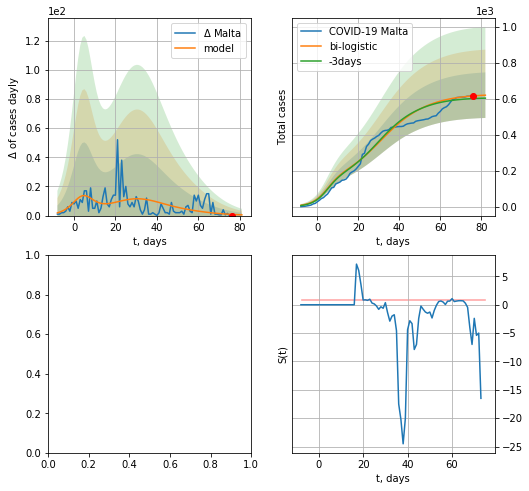

In [308]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,7*10-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*10-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


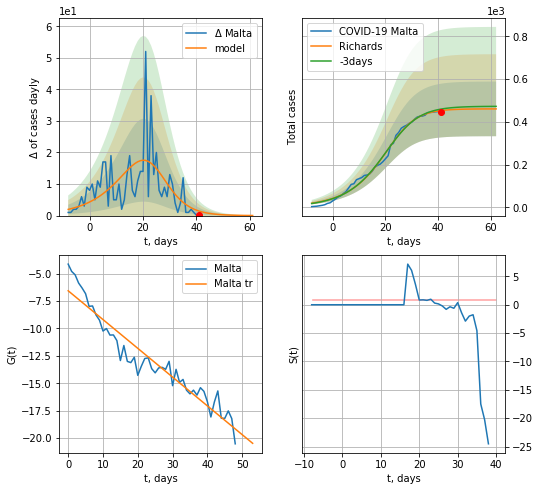

Malta data at: 2020-05-30
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 460 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


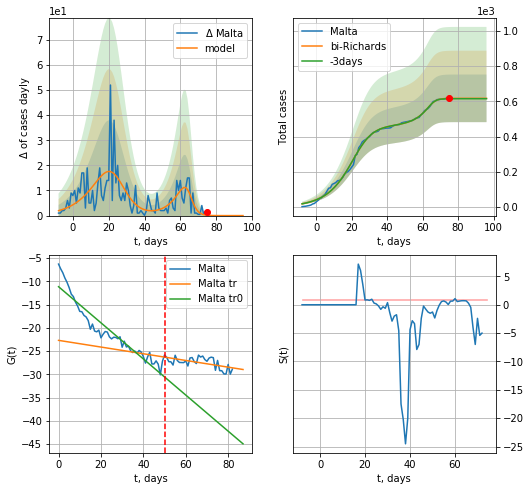

Malta data at: 2020-05-30
+3 day model MAPE: 0.003244
model: bi-Richards
coeffs: [1.55676260e+02 1.41909865e-01 6.54583222e+01 3.55634193e+00]
rational stdev: 0.218789
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 616 ± 134
	 total death: 8 ± 5
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.900665
 intercept: -11.167990
 slope: -0.388221
trend coefficient of determination: 0.315796
 intercept: -22.705218
 slope: -0.072000


In [329]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,12*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


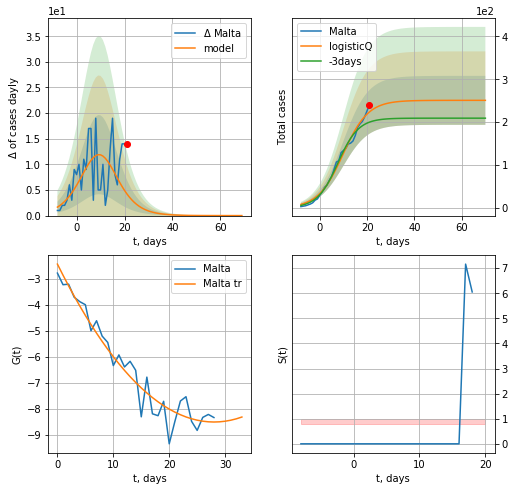

Malta data at: 2020-05-30
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 250 ± 57
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


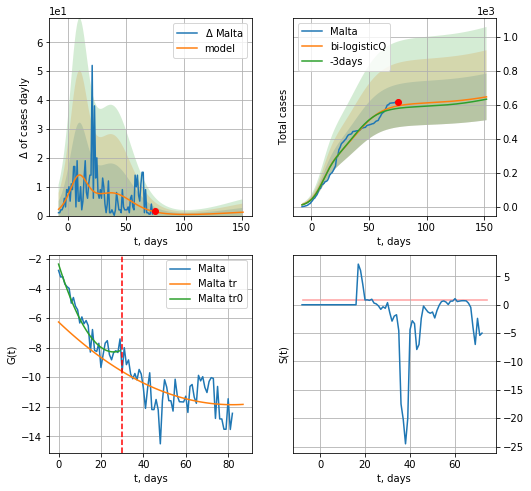

Malta data at: 2020-05-30
+3 day model MAPE: 0.025747
model: bi-logisticQ
coeffs: [ 3.56215405e+02  2.45924628e-07  3.90309705e+01 -3.50318380e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.211452
forecast at the end of period: +77 days
	 deltaDaycases: 1
	 total cases: 646 ± 136
	 total death: 9 ± 5
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.269854
 intercept_: -6.263653535178101
 coeffs_: [ 0.         -0.13658134  0.0008327 ]


In [330]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
          date   cases  active  death
78 2020-05-27  1520.0   160.0   28.0
79 2020-05-28  1520.3   160.0   28.0
80 2020-05-29  1520.6   154.0   28.0
81 2020-05-30  1521.0   137.0   28.0
82 2020-05-31  1521.3   127.0   28.0


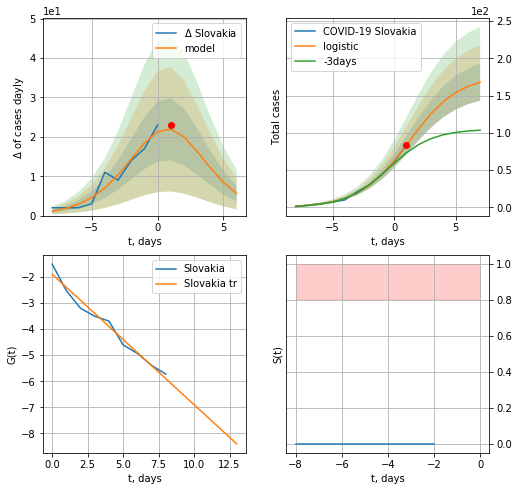

Slovakia data at: 2020-05-31
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +6 days
	 deltaDaycases:  5
	 total cases:  167 ± 24
	 total death:  3 ± 1
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


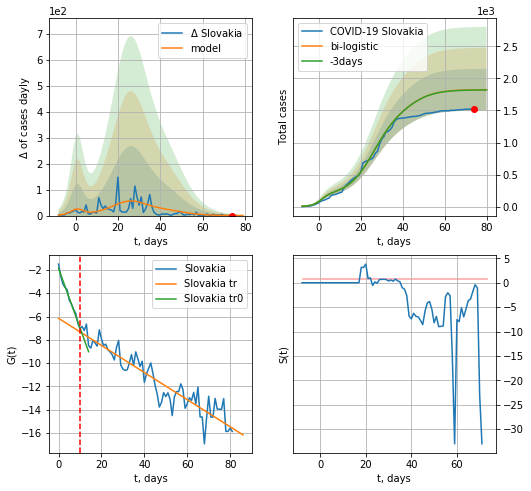

Slovakia data at: 2020-05-31
+3 day model MAPE: 0.0022251243916912382
model: bi-logistic
coeffs:  [1.31827566e+03 1.62739445e-01 2.60590039e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.17892974103027712
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  1823 ± 326
	 total death:  33 ± 17
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.874248
 intercept: -6.153474
 slope: -0.116305


In [311]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,10*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


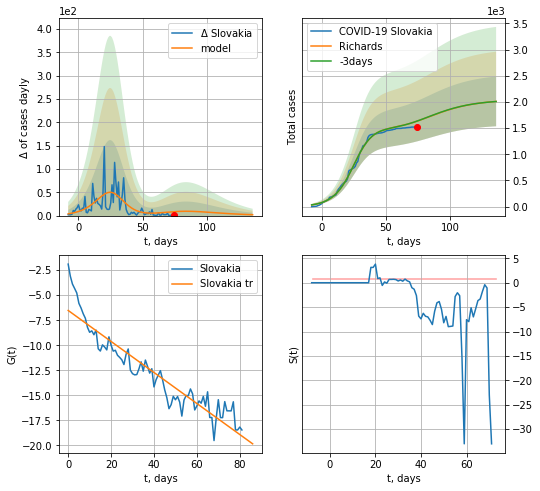

Slovakia data at: 2020-05-31
+3 day model MAPE: 0.001294
model: Richards
coeffs: [1.50398660e+03 1.08632944e-01 2.70522087e+01 1.35498655e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.236006
forecast at the end of period: +62 days
	 deltaDaycases: 1
	 total cases: 2010 ± 474
	 total death: 37 ± 26
trend coefficient of determination: 0.877811
 intercept: -6.522066
 slope: -0.154890


In [312]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


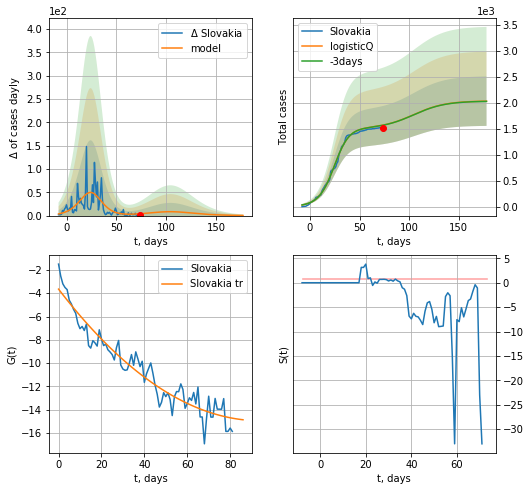

Slovakia data at: 2020-05-31
+3 day model MAPE: 0.001696
model: logisticQ
coeffs: [ 1.50526247e+03  3.40659916e-04  2.39609195e+01 -3.60892940e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.234529
forecast at the end of period: +104 days
	 deltaDaycases: 0
	 total cases: 2033 ± 476
	 total death: 37 ± 26
trend coefficient of determination: 0.920739
 intercept_: -3.6499397002206493
 coeffs_: [ 0.         -0.23958326  0.00127037]


In [313]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date   cases  active  death
83 2020-05-27  1471.1     9.0  108.0
84 2020-05-28  1473.0     9.0  108.0
85 2020-05-29  1473.0     8.0  108.0
86 2020-05-30  1473.0     8.0  108.0
87 2020-05-31  1473.0     7.0  108.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


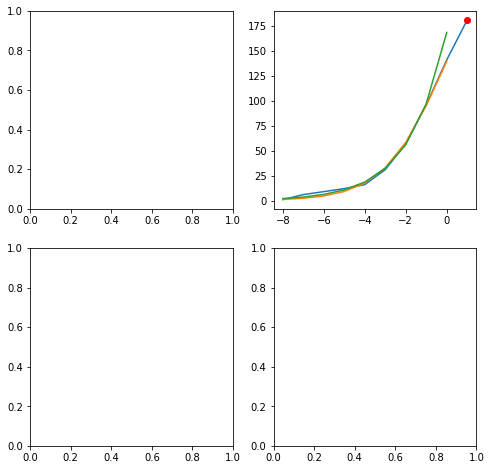

In [314]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*9-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


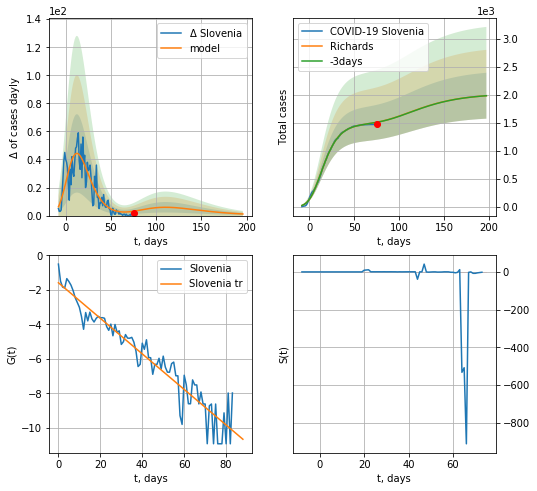

Slovenia data at: 2020-05-28
+3 day model MAPE: 0.000498
model: Richards
coeffs: [ 1.48328029e+03  4.89451853e-01 -6.41382319e+00  1.80936466e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.206727
forecast at the end of period: +121 days
	 deltaDaycases: 1
	 total cases: 1982 ± 409
	 total death: 145 ± 89
trend coefficient of determination: 0.910879
 intercept: -1.586511
 slope: -0.103007


In [320]:
x = forecastRR("Slovenia",dfSV[:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


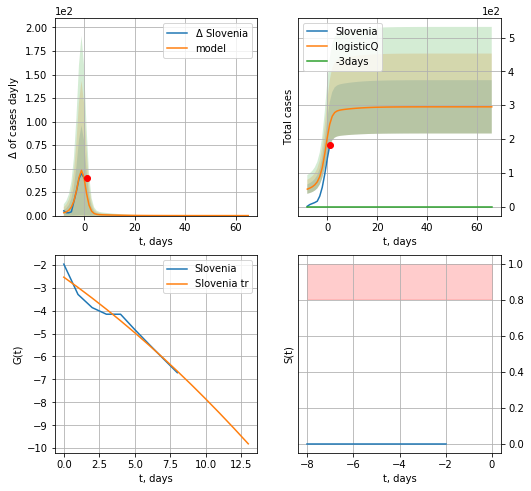

Slovenia data at: 2020-05-28
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 21 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


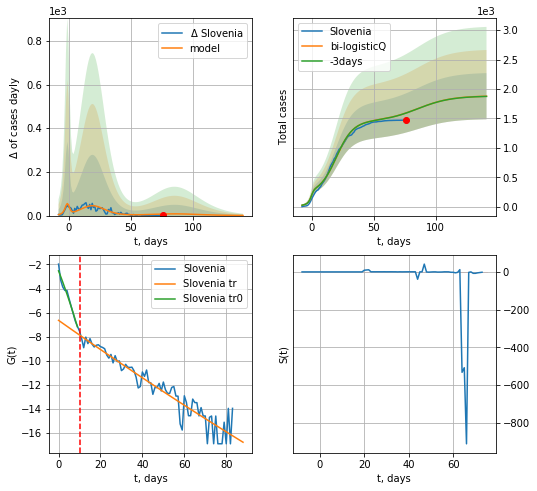

Slovenia data at: 2020-05-28
+3 day model MAPE: 0.001060
model: bi-logisticQ
coeffs: [ 1.23043502e+03  7.07743199e-07  1.96216112e+01 -2.07498912e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.209169
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 1877 ± 392
	 total death: 137 ± 85
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.907296
 intercept_: -6.641418362191655
 coeffs_: [ 0.00000000e+00 -1.22751222e-01  8.85358814e-05]


In [321]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
78 2020-05-27  11275  4758.0  240.0
79 2020-05-28  11300  4621.0  241.0
80 2020-05-29  11354  4588.0  242.0
81 2020-05-30  11381  4533.0  242.0
82 2020-05-31  11412  4471.0  243.0


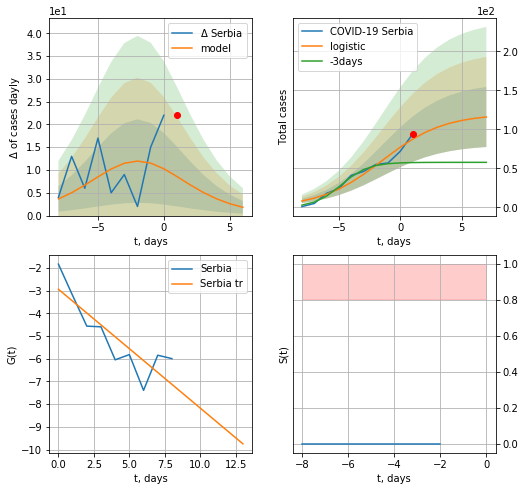

Serbia data at: 2020-05-31
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +6 days
	 deltaDaycases:  1
	 total cases:  115 ± 38
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


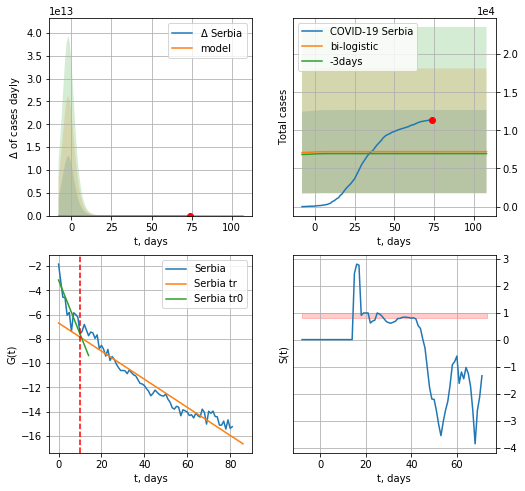

Serbia data at: 2020-05-31
+3 day model MAPE: 0.03767572486578889
model: bi-logistic
coeffs:  [5675.0196749   -19.37304458  289.15495291] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.7559305156144822
forecast at the end of period: +34 days
	 deltaDaycases:  0
	 total cases:  7213 ± 5453
	 total death:  153 ± 346
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.941650
 intercept: -6.693065
 slope: -0.115933


In [316]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,10*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


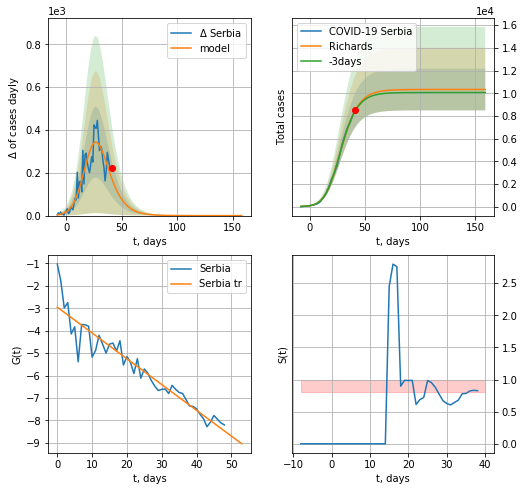

Serbia data at: 2020-05-31
+3 day model MAPE: 0.007628
model: Richards
coeffs: [1.03310156e+04 2.23147111e-01 2.10152369e+01 5.03005273e-01]
rational stdev: 0.178090
forecast at the end of period: +118 days
	 deltaDaycases: 0
	 total cases: 10331 ± 1839
	 total death: 219 ± 117
trend coefficient of determination: 0.905867
 intercept: -2.952078
 slope: -0.114857


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


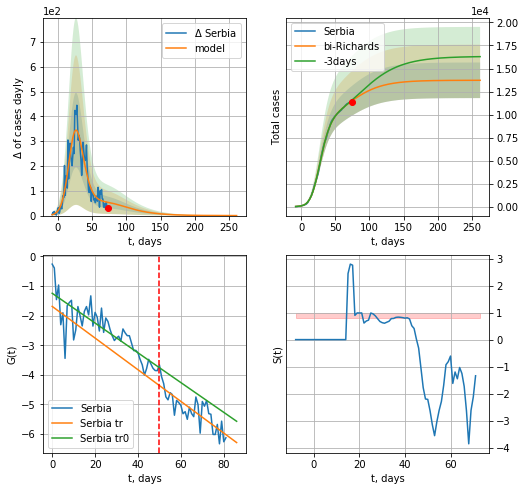

Serbia data at: 2020-05-31
+3 day model MAPE: 0.007574
model: bi-Richards
coeffs: [ 3.39206525e+03  1.66536361e+00 -2.24481870e+01  2.30988730e-02]
rational stdev: 0.140855
forecast at the end of period: +188 days
	 deltaDaycases: 0
	 total cases: 13720 ± 1932
	 total death: 292 ± 123
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.694859
 intercept: -1.244835
 slope: -0.050274
trend coefficient of determination: 0.656734
 intercept: -1.688265
 slope: -0.053474


In [317]:
vL=50
x = forecastRR("Serbia",dfSB[:vL],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


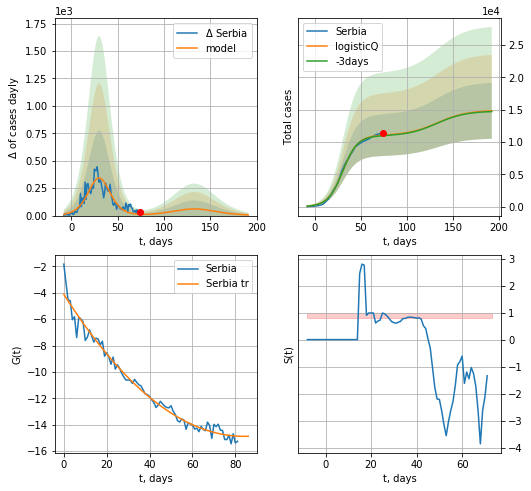

Serbia data at: 2020-05-31
+3 day model MAPE: 0.008117
model: logisticQ
coeffs: [ 1.10158247e+04  8.77612793e-07  3.05427693e+01 -1.41535650e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.292038
forecast at the end of period: +118 days
	 deltaDaycases: 6
	 total cases: 14821 ± 4328
	 total death: 315 ± 275
trend coefficient of determination: 0.978147
 intercept_: -4.11739354085406
 coeffs_: [ 0.         -0.25609588  0.00152356]


In [318]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
          date   cases  active  death
88 2020-05-27  2244.4    96.0  101.0
89 2020-05-28  2245.0    92.0  102.0
90 2020-05-29  2245.5    83.0  103.0
91 2020-05-30  2246.0    80.0  103.0
92 2020-05-31  2246.0    71.0  103.0


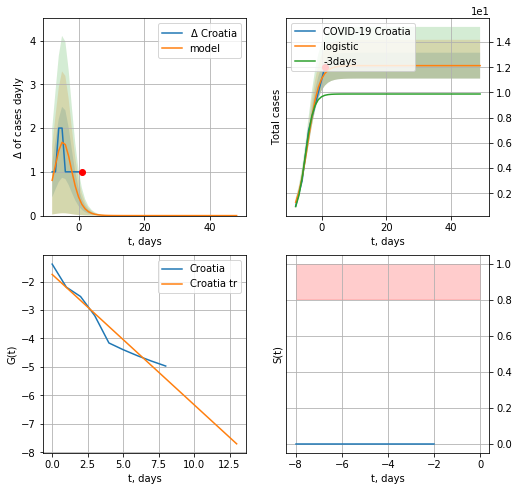

Croatia data at: 2020-05-31
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +48 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

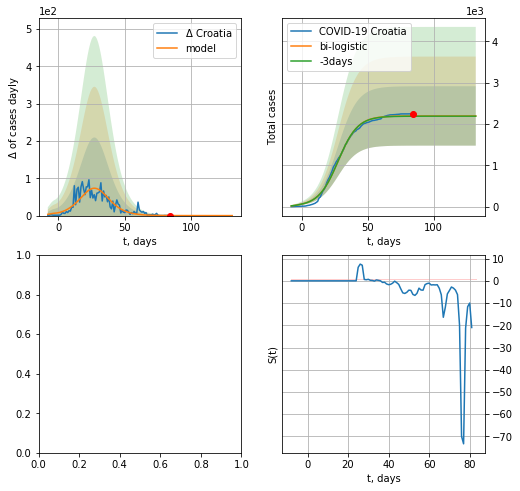

In [319]:
dfCT = read_df(pd.DataFrame(),"CT")
dfCT = dfCT.fillna(0)
x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


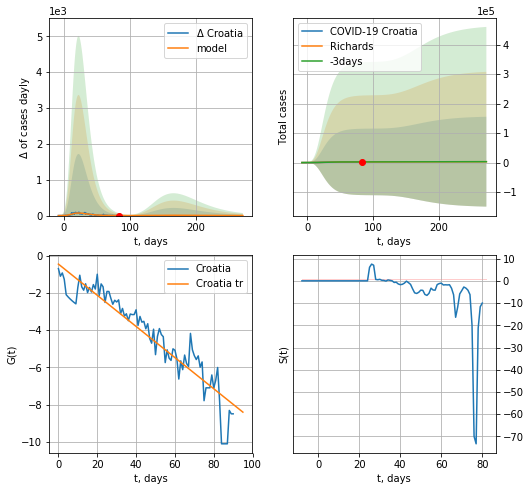

Croatia data at: 2020-05-30
+3 day model MAPE: 0.000512
model: Richards
coeffs: [ 2.25104972e+03  8.29276684e+00 -2.94783181e+01  1.04990384e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 50.248056
forecast at the end of period: +189 days
	 deltaDaycases: 1
	 total cases: 3032 ± 152358
	 total death: 139 ± 20953
trend coefficient of determination: 0.872409
 intercept: -0.459444
 slope: -0.083592


In [338]:
x = forecastRR("Croatia",dfCT[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


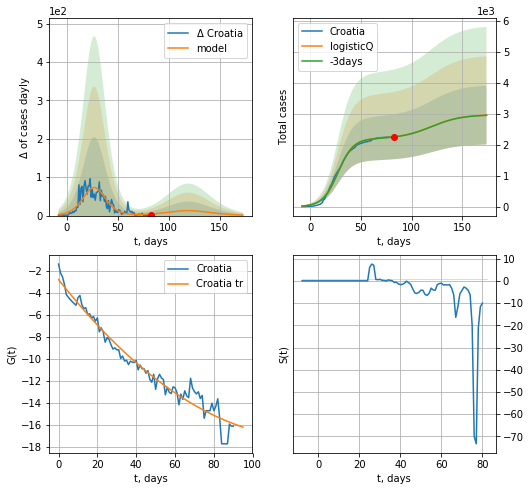

Croatia data at: 2020-05-30
+3 day model MAPE: 0.002735
model: logisticQ
coeffs: [ 2.19487638e+03  6.52286206e-07  2.74536232e+01 -2.04218889e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321172
forecast at the end of period: +91 days
	 deltaDaycases: 1
	 total cases: 2952 ± 948
	 total death: 135 ± 130
trend coefficient of determination: 0.960554
 intercept_: -2.7927550757638206
 coeffs_: [ 0.         -0.22407251  0.00087141]


In [339]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active  death
82 2020-05-27  19666   13645  816.0
83 2020-05-28  20793   14589  845.0
84 2020-05-29  22082   15692  879.0
85 2020-05-30  23449   16843  913.0
86 2020-05-31  24985   17989  959.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


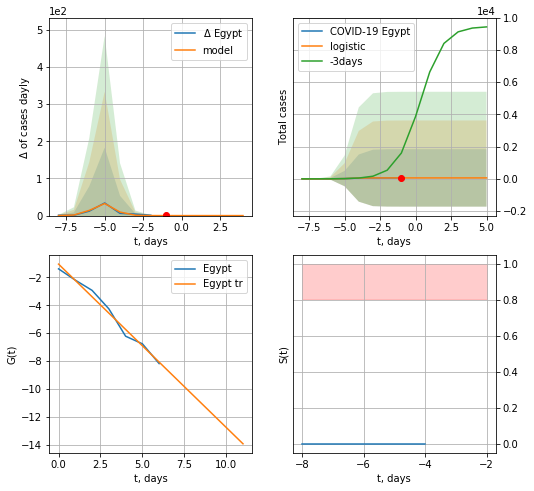

Egypt data at: 2020-05-31
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


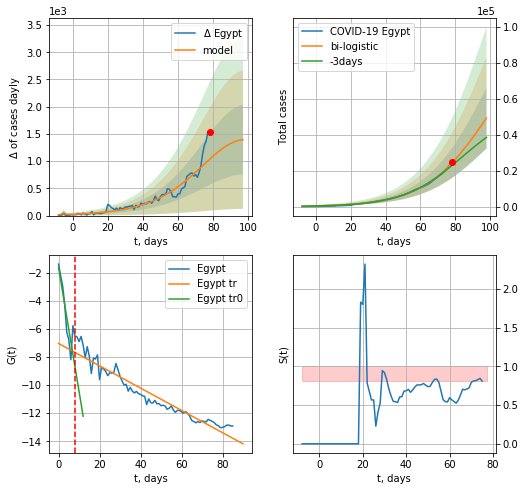

Egypt data at: 2020-05-31
+3 day model MAPE: 0.06690253151937817
model: bi-logistic
coeffs:  [9.76430614e+04 5.60226357e-02 9.81560391e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.34308990425110286
forecast at the end of period: +20 days
	 deltaDaycases:  1393
	 total cases:  49171 ± 16870
	 total death:  1887 ± 1942
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.923389
 intercept: -7.037950
 slope: -0.079352


In [320]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*10-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


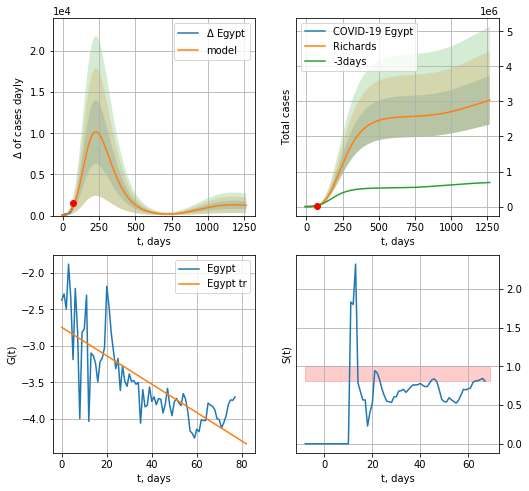

Egypt data at: 2020-05-31
+3 day model MAPE: 0.052919
model: Richards
coeffs: [2.57858936e+06 1.24650423e-01 1.21884449e+01 8.98543436e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.229609
forecast at the end of period: +1196 days
	 deltaDaycases: 1245
	 total cases: 3035396 ± 696955
	 total death: 116507 ± 80253
trend coefficient of determination: 0.607845
 intercept: -2.748154
 slope: -0.019417


In [321]:
x = forecastRR("Egypt",dfEG[8:],d1,180*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


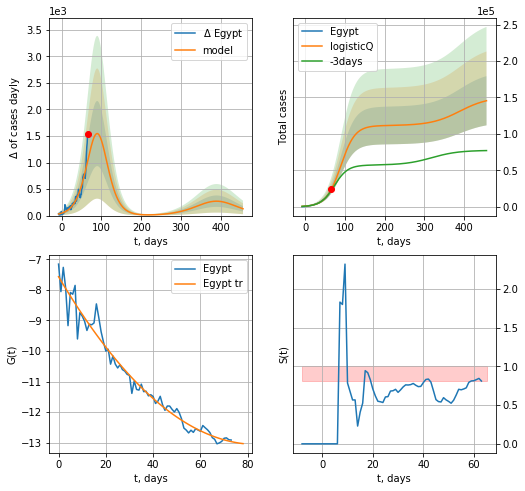

Egypt data at: 2020-05-31
+3 day model MAPE: 0.068976
model: logisticQ
coeffs: [ 1.11401090e+05  1.14026702e-05  8.94044286e+01 -4.77901888e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.232168
forecast at the end of period: +391 days
	 deltaDaycases: 128
	 total cases: 145517 ± 33784
	 total death: 5585 ± 3889
trend coefficient of determination: 0.968043
 intercept_: -7.566873597631377
 coeffs_: [ 0.         -0.13087621  0.0007796 ]


In [322]:
x = forecastRRR("Egypt",dfEG[12:],d1,65*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
          date  cases  active  death
85 2020-05-27   5135  2056.0  175.0
86 2020-05-28   5457  2307.0  179.0
87 2020-05-29   5873  2644.0  185.0
88 2020-05-30   6179  2874.0  195.0
89 2020-05-31   6439  3078.0  205.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


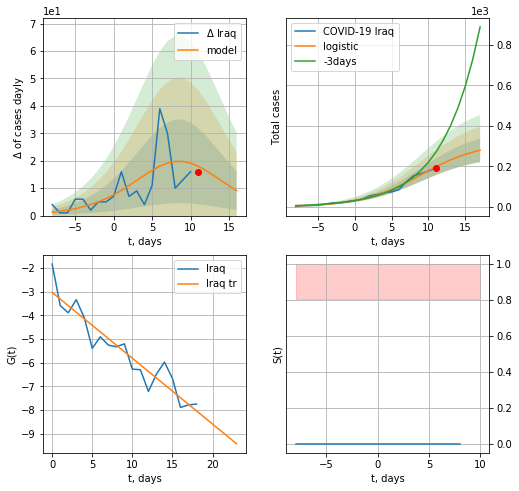

Iraq data at: 2020-05-31
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +6 days
	 deltaDaycases:  9
	 total cases:  279 ± 58
	 total death:  8 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


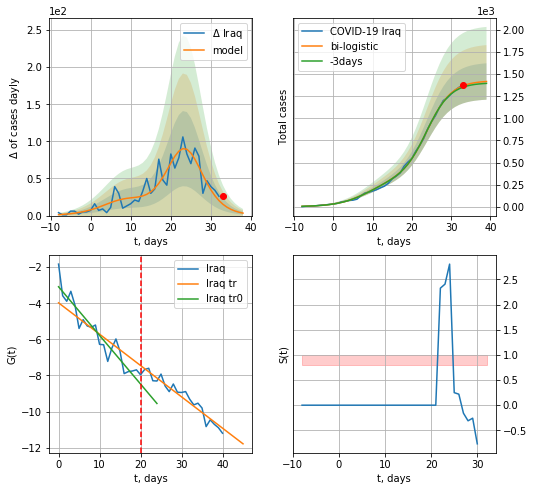

Iraq data at: 2020-05-31
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +6 days
	 deltaDaycases:  3
	 total cases:  1416 ± 205
	 total death:  45 ± 19
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


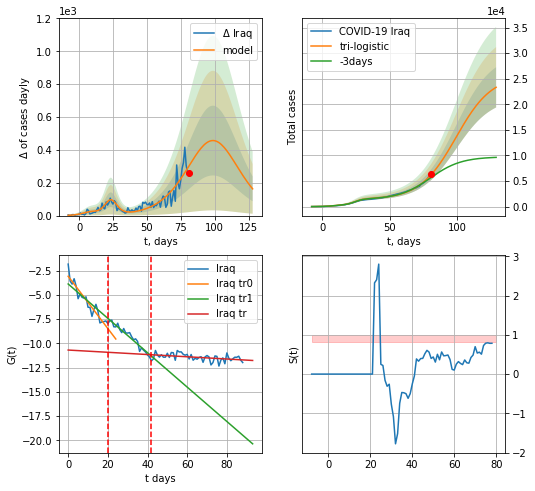

Iraq data at: 2020-05-31
+3 day model MAPE: 0.11578905367292046
model: tri-logistic
coeffs:  [2.42038324e+04 7.54555209e-02 9.92098400e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.16878406894277287
forecast at the end of period: +48 days
	 deltaDaycases:  162
	 total cases:  23317 ± 3935
	 total death:  742 ± 375
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.178568
 intercept: -10.690087
 slope: -0.011542


In [323]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,10*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

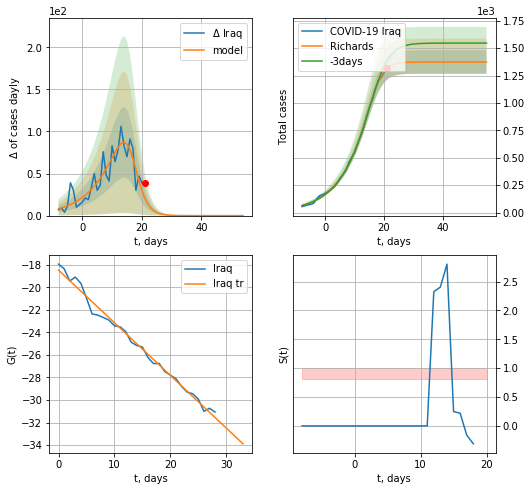

Iraq data at: 2020-05-31
+3 day model MAPE: 0.063091
model: Richards
coeffs: [1.37376214e+03 1.20916969e-01 1.73787930e+01 3.83489487e+00]
rational stdev: 0.077793
forecast at the end of period: +34 days
	 deltaDaycases: 0
	 total cases: 1373 ± 106
	 total death: 43 ± 10
trend coefficient of determination: 0.989067
 intercept: -18.464339
 slope: -0.467498


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


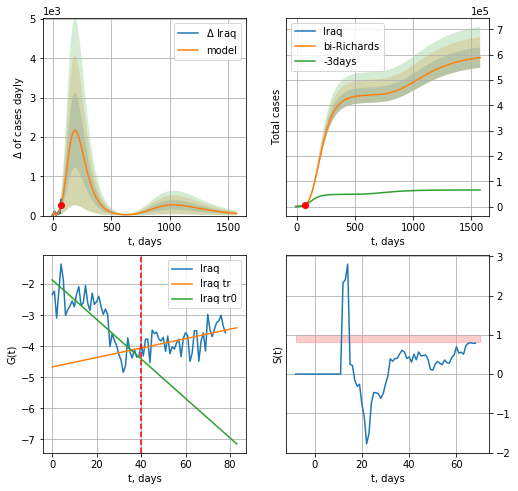

Iraq data at: 2020-05-31
+3 day model MAPE: 0.084737
model: bi-Richards
coeffs: [ 4.40019881e+05  3.36390969e-01 -4.63216372e+01  4.06446561e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.068736
forecast at the end of period: +1504 days
	 deltaDaycases: 54
	 total cases: 588704 ± 40465
	 total death: 18742 ± 3864
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.696024
 intercept: -1.860768
 slope: -0.063631
trend coefficient of determination: 0.195213
 intercept: -4.665163
 slope: 0.015187


In [324]:
vL=40
x = forecastRR("Iraq",dfIQ[10:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[10:],d1,224*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

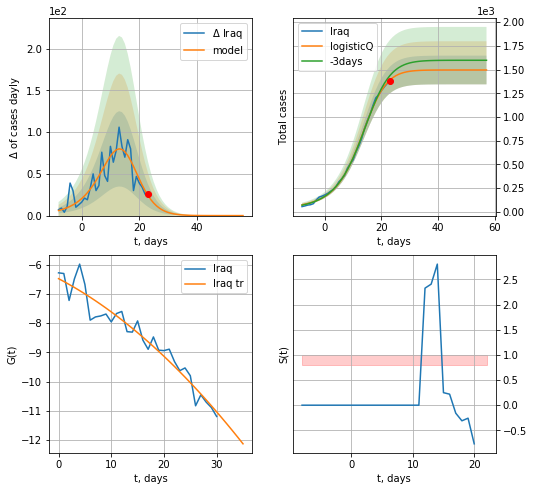

Iraq data at: 2020-05-31
+3 day model MAPE: 0.037622
model: logisticQ
coeffs: [ 1.49506808e+03  3.17947912e-03  1.23994223e+01 -5.37356409e+01]
rational stdev: 0.101331
forecast at the end of period: +34 days
	 deltaDaycases: 0
	 total cases: 1495 ± 151
	 total death: 47 ± 14
trend coefficient of determination: 0.935701
 intercept_: -6.475161114969037
 coeffs_: [ 0.         -0.094783   -0.00191217]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


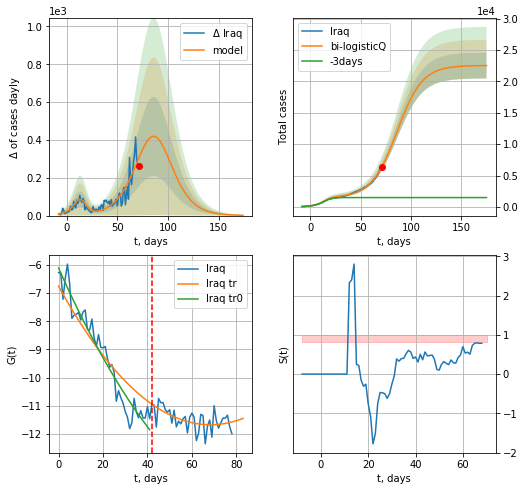

Iraq data at: 2020-05-31
+3 day model MAPE: 3.431177
model: bi-logisticQ
coeffs: [ 2.10539682e+04  7.06554885e-06  8.62438146e+01 -1.11835241e+04]
rational stdev: 0.091142
forecast at the end of period: +104 days
	 deltaDaycases: 1
	 total cases: 22532 ± 2053
	 total death: 717 ± 196
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.938502
 intercept_: -6.116864757771229
 coeffs_: [ 0.         -0.176838    0.00090835]
trend coefficient of determination: 0.324002
 intercept_: -6.757475403884477
 coeffs_: [ 0.         -0.1435494   0.00104977]


In [325]:
x = forecastRRR("Iraq",dfIQ[10:42],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,24*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=42)

In [326]:
#len(dfAR)

AR
          date   cases  active  death
84 2020-05-27  8857.0  3105.0  623.0
85 2020-05-28  8997.0  3090.0  630.0
86 2020-05-29  9134.0  3074.0  638.0
87 2020-05-30  9267.0  3072.0  646.0
88 2020-05-31  9394.0  2993.0  653.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


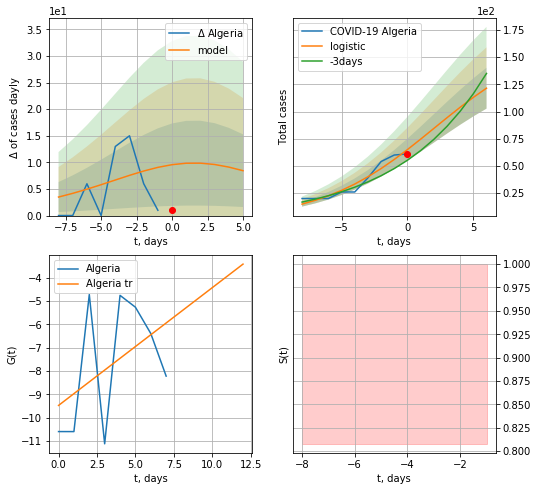

Algeria data at: 2020-05-31
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +6 days
	 deltaDaycases:  8
	 total cases:  121 ± 18
	 total death:  8 ± 3
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


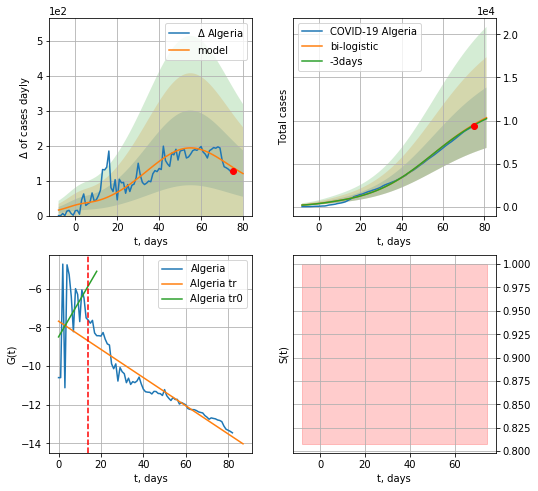

Algeria data at: 2020-05-31
+3 day model MAPE: 0.008957150139381915
model: bi-logistic
coeffs:  [1.15078713e+04 6.56547841e-02 5.46403779e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.33969789112990234
forecast at the end of period: +6 days
	 deltaDaycases:  120
	 total cases:  10334 ± 3510
	 total death:  718 ± 731
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.905145
 intercept: -7.680266
 slope: -0.072876


In [327]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*10-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*10-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


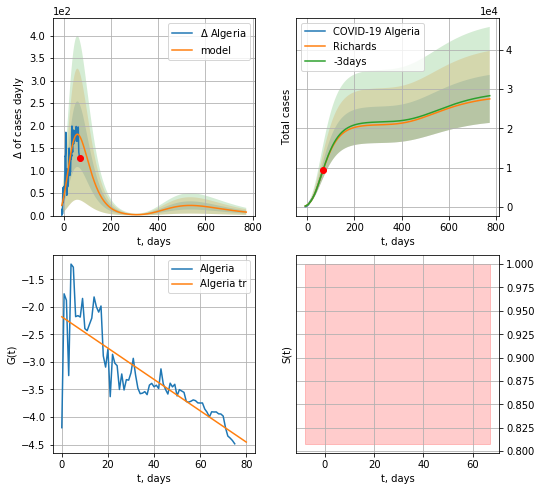

Algeria data at: 2020-05-31
+3 day model MAPE: 0.005360
model: Richards
coeffs: [ 2.09624728e+04  1.19269551e+00 -1.07052709e+02  1.98549074e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.222240
forecast at the end of period: +706 days
	 deltaDaycases: 7
	 total cases: 27527 ± 6117
	 total death: 1913 ± 1275
trend coefficient of determination: 0.689735
 intercept: -2.181391
 slope: -0.028406


In [328]:
x = forecastRR("Algeria",dfAR[12:],d1,110*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


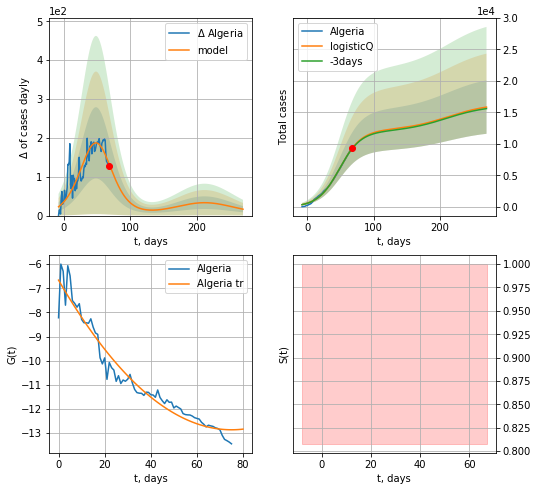

Algeria data at: 2020-05-31
+3 day model MAPE: 0.007064
model: logisticQ
coeffs: [ 1.21649228e+04  1.18418423e-06  4.85872037e+01 -5.17011595e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.267514
forecast at the end of period: +202 days
	 deltaDaycases: 16
	 total cases: 15859 ± 4242
	 total death: 1102 ± 884
trend coefficient of determination: 0.949300
 intercept_: -6.660707839117917
 coeffs_: [ 0.         -0.16538632  0.00110143]


In [329]:
x = forecastRRR("Algeria",dfAR[12:],d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
76 2020-05-27  939.5   328.0   17.0
77 2020-05-28  941.0   140.0   17.0
78 2020-05-29  942.0   141.0   17.0
79 2020-05-30  944.0   137.0   17.0
80 2020-05-31  944.0   137.0   17.0


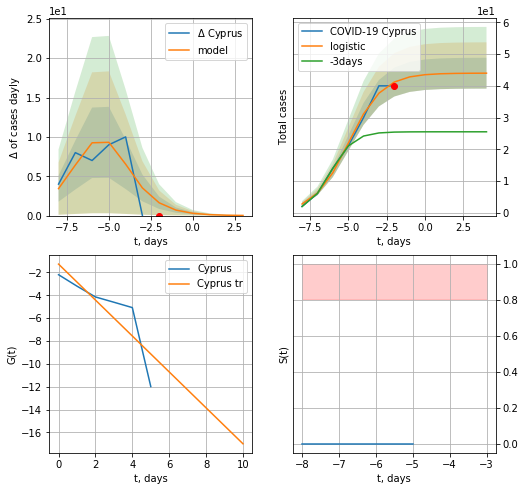

Cyprus data at: 2020-05-31
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

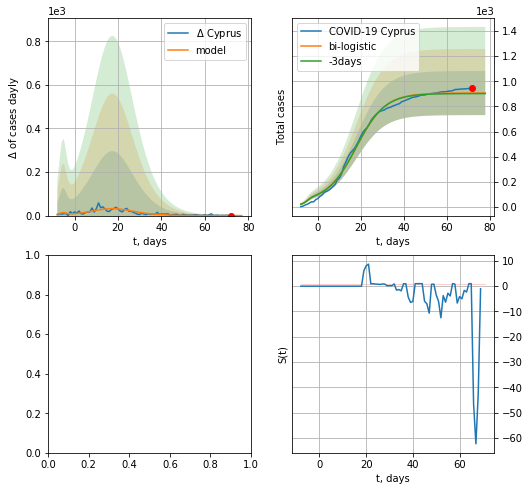

In [330]:
dfCP = read_df(pd.DataFrame(),"CP")
dfCP = dfCP.fillna(0)
x = forecast("Cyprus",dfCP[:7],d1,7*10-dT)
xx = forecast2("Cyprus",dfCP[:],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


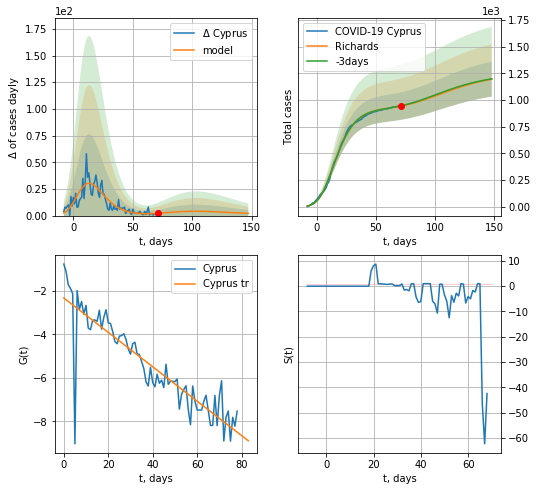

Cyprus data at: 2020-05-30
+3 day model MAPE: 0.002270
model: Richards
coeffs: [ 9.27643816e+02  4.86952522e-01 -2.74343060e+00  2.00415951e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.136542
forecast at the end of period: +77 days
	 deltaDaycases: 2
	 total cases: 1195 ± 163
	 total death: 21 ± 8
trend coefficient of determination: 0.790388
 intercept: -2.322687
 slope: -0.079152


In [356]:
vL=56
x = forecastRR("Cyprus",dfCP[:],d1,20*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#x = forecast2RR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


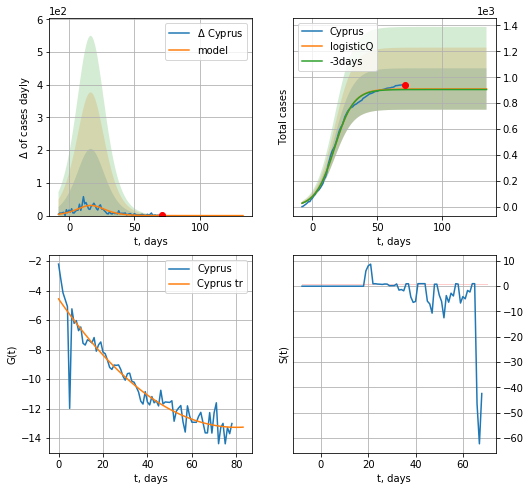

Cyprus data at: 2020-05-30
+3 day model MAPE: 0.004621
model: logisticQ
coeffs: [ 9.09412677e+02  7.94520220e-07  1.70297541e+01 -1.72078268e+05]
rational stdev: 0.175537
forecast at the end of period: +63 days
	 deltaDaycases: 0
	 total cases: 909 ± 159
	 total death: 16 ± 8
trend coefficient of determination: 0.887488
 intercept_: -4.554835107668598
 coeffs_: [ 0.         -0.2174064   0.00135648]


In [357]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date   cases   active   death
81 2020-05-27  135905  75753.0  3983.0
82 2020-05-28  141779  78238.0  4099.0
83 2020-05-29  148285  81264.0  4230.0
84 2020-05-30  155671  84853.0  4371.0
85 2020-05-31  164476  92762.0  4506.0


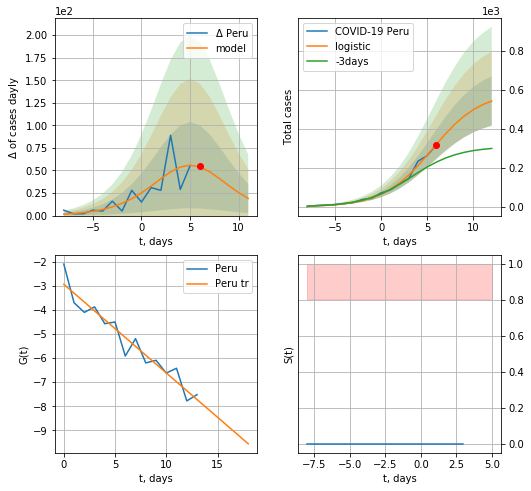

Peru data at: 2020-05-31
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +6 days
	 deltaDaycases:  19
	 total cases:  542 ± 126
	 total death:  14 ± 9
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


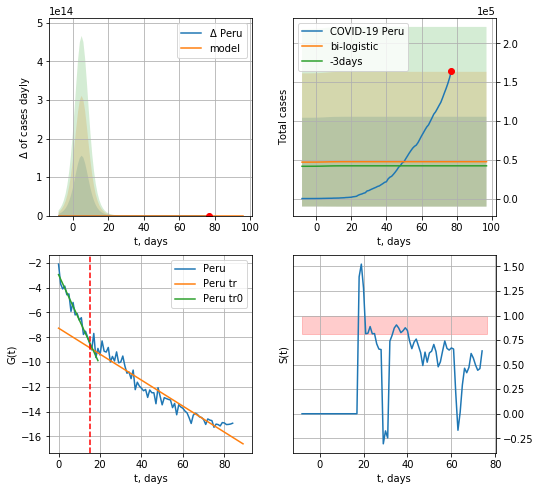

Peru data at: 2020-05-31
+3 day model MAPE: 0.12637358600177048
model: bi-logistic
coeffs:  [ 3.75463583e+04 -5.37414151e+00  1.42254781e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.217947364450043
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  47521 ± 57879
	 total death:  1301 ± 4753
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.930767
 intercept: -7.267192
 slope: -0.104858


In [331]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*10-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


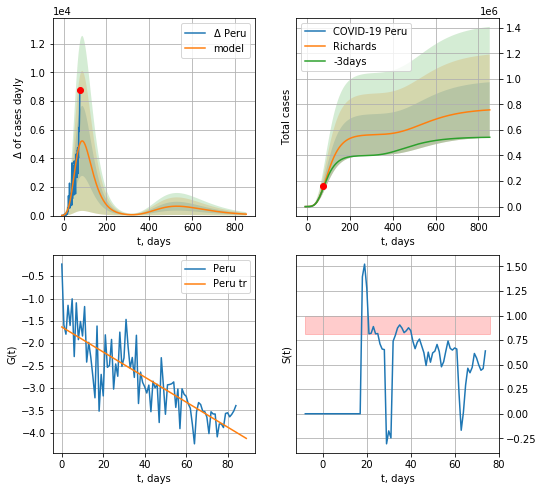

Peru data at: 2020-05-31
+3 day model MAPE: 0.042268
model: Richards
coeffs: [ 5.64140608e+05  6.55444515e-01 -3.89629406e+01  3.90947896e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.285949
forecast at the end of period: +776 days
	 deltaDaycases: 99
	 total cases: 756950 ± 216449
	 total death: 20737 ± 17789
trend coefficient of determination: 0.678336
 intercept: -1.637448
 slope: -0.028006


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


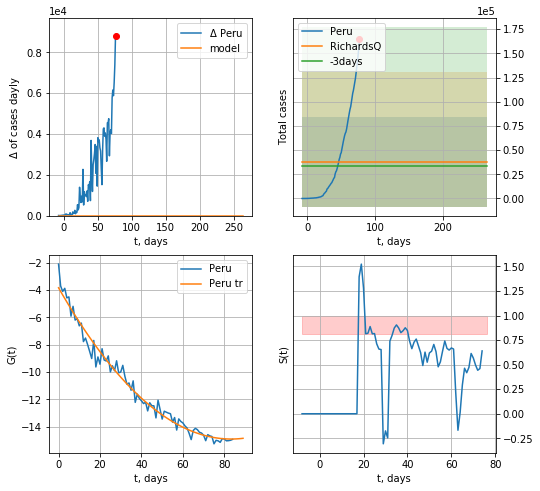

Peru data at: 2020-05-31
+3 day model MAPE: 0.126408
model: RichardsQ
coeffs: [ 3.80391511e+04  1.46226769e+01 -2.14783210e+03  1.84447593e+03
 -5.01171456e+00]
rational stdev: 1.221031
forecast at the end of period: +188 days
	 deltaDaycases: 0
	 total cases: 38039 ± 46446
	 total death: 1042 ± 3816
trend coefficient of determination: 0.977940
 intercept_: -3.834591331467747
 coeffs_: [ 0.         -0.26610659  0.00159781]


In [332]:
x = forecastRR("Peru",dfPU[:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


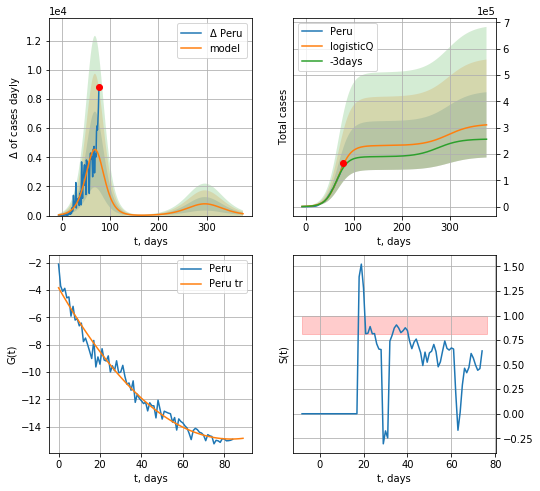

Peru data at: 2020-05-31
+3 day model MAPE: 0.072742
model: logisticQ
coeffs: [ 2.31966710e+05  1.48227395e-06  6.81287914e+01 -5.27230237e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.399387
forecast at the end of period: +300 days
	 deltaDaycases: 129
	 total cases: 310742 ± 124106
	 total death: 8513 ± 10199
trend coefficient of determination: 0.977940
 intercept_: -3.834591331467747
 coeffs_: [ 0.         -0.26610659  0.00159781]


In [333]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,52*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
          date   cases   active   death
88 2020-05-27  158333  86050.0  4534.0
89 2020-05-28  165799  89982.0  4711.0
90 2020-05-29  173763  86156.0  4980.0
91 2020-05-30  182490  90320.0  5186.0
92 2020-05-31  190622  93359.0  5408.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


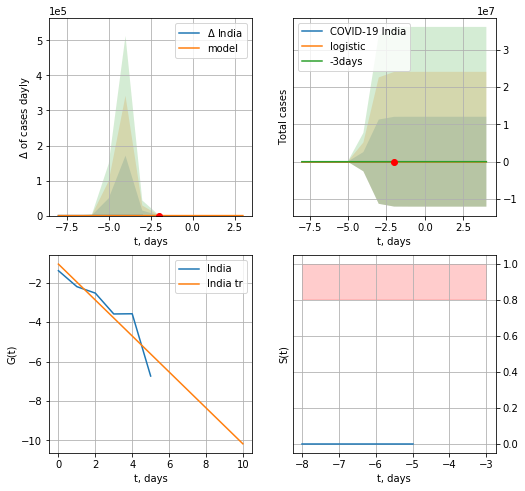

India data at: 2020-05-31
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


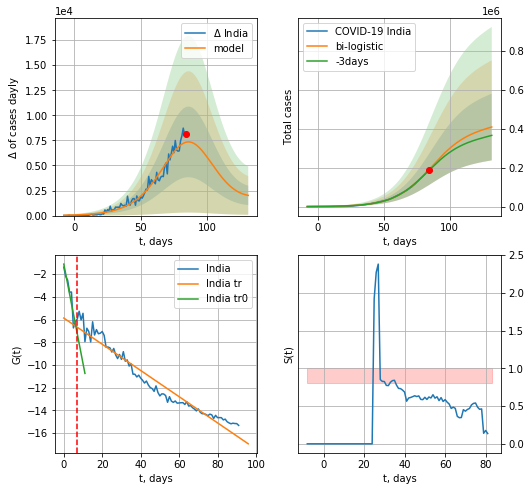

India data at: 2020-05-31
+3 day model MAPE: 0.02584101322124136
model: bi-logistic
coeffs:  [4.08301571e+05 7.15142772e-02 8.62443097e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.41890703976766014
forecast at the end of period: +48 days
	 deltaDaycases:  2017
	 total cases:  409693 ± 171623
	 total death:  11623 ± 14606
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.946130
 intercept: -5.864568
 slope: -0.115309


In [334]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*10-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


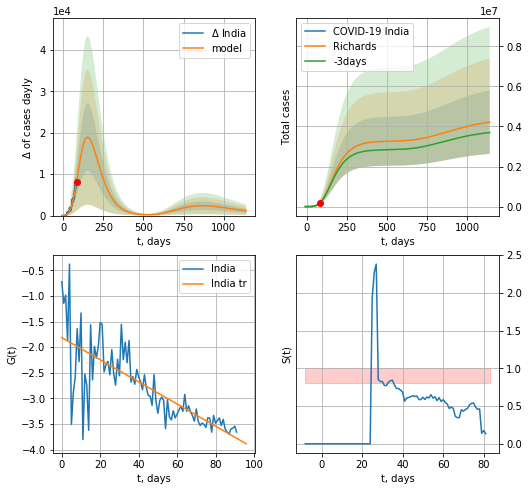

India data at: 2020-05-31
+3 day model MAPE: 0.007505
model: Richards
coeffs: [ 3.27035786e+06  3.88825834e-01 -4.57672441e+01  4.12580175e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.374911
forecast at the end of period: +1056 days
	 deltaDaycases: 1156
	 total cases: 4219593 ± 1581970
	 total death: 119711 ± 134642
trend coefficient of determination: 0.590663
 intercept: -1.813233
 slope: -0.021578


In [335]:
x = forecastRR("India",dfID[:],d1,160*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


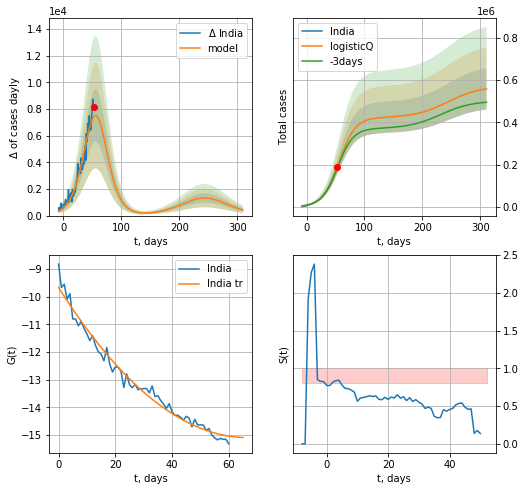

India data at: 2020-05-31
+3 day model MAPE: 0.022534
model: logisticQ
coeffs: [ 4.21640856e+05  2.14550375e-05  5.60036164e+01 -3.26756293e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.174788
forecast at the end of period: +258 days
	 deltaDaycases: 419
	 total cases: 558223 ± 97571
	 total death: 15836 ± 8303
trend coefficient of determination: 0.978679
 intercept_: -9.66803380531378
 coeffs_: [ 0.         -0.16245574  0.00121726]


In [336]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date    cases   active  death
84 2020-05-27  13933.0   9084.0  500.0
85 2020-05-28  14702.0   9577.0  508.0
86 2020-05-29  15419.0  10111.0  520.0
87 2020-05-30  16214.0  10898.0  528.0
88 2020-05-31  16851.0  10976.0  539.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


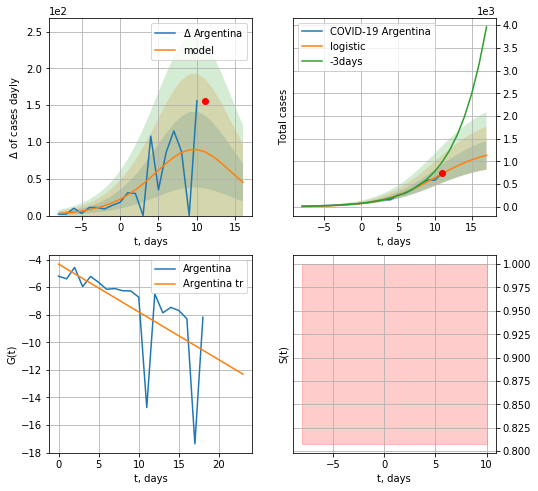

Argentina data at: 2020-05-31
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +6 days
	 deltaDaycases:  45
	 total cases:  1136 ± 315
	 total death:  36 ± 29
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


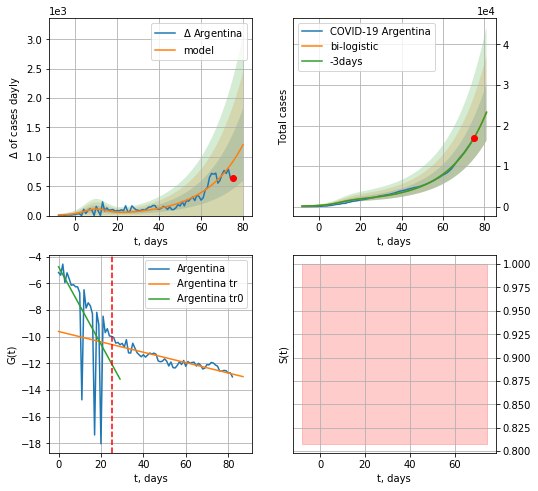

Argentina data at: 2020-05-31
+3 day model MAPE: 0.0011349053764322242
model: bi-logistic
coeffs:  [2.98952658e+06 5.68341624e-02 1.67295713e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.30081723873339156
forecast at the end of period: +6 days
	 deltaDaycases:  1206
	 total cases:  23304 ± 7010
	 total death:  745 ± 672
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.829920
 intercept: -9.611239
 slope: -0.038852


In [337]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*10-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


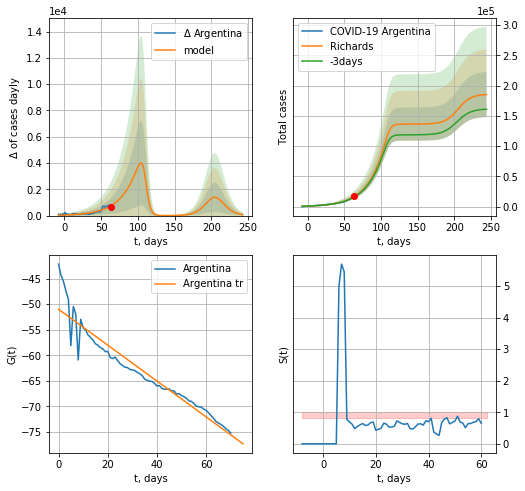

Argentina data at: 2020-05-31
+3 day model MAPE: 0.029918
model: Richards
coeffs: [1.36399032e+05 4.44409599e-02 1.10809899e+02 7.39130429e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.201065
forecast at the end of period: +181 days
	 deltaDaycases: 72
	 total cases: 185216 ± 37240
	 total death: 5924 ± 3573
trend coefficient of determination: 0.910507
 intercept: -50.999605
 slope: -0.350749


In [338]:
x = forecastRR('Argentina',dfAG[17:].fillna(0),d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


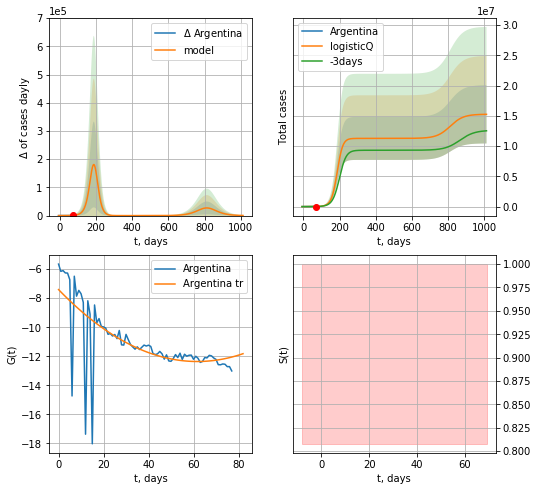

Argentina data at: 2020-05-31
+3 day model MAPE: 0.032834
model: logisticQ
coeffs: [ 1.12783574e+07  7.02002807e-05  1.86363431e+02 -7.28120204e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.315727
forecast at the end of period: +944 days
	 deltaDaycases: 431
	 total cases: 15257522 ± 4817217
	 total death: 488030 ± 462253
trend coefficient of determination: 0.445166
 intercept_: -7.405195134549585
 coeffs_: [ 0.         -0.16058888  0.0013019 ]


In [339]:
x = forecastRRR('Argentina',dfAG[10:],d1,144*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


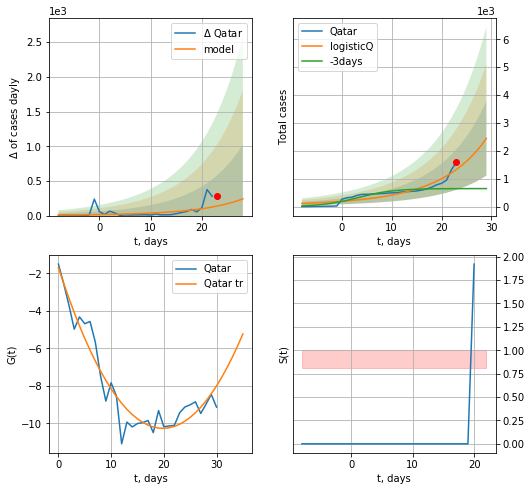

Qatar data at: 2020-05-31
+3 day model MAPE: 1.276947
model: logisticQ
coeffs: [ 3.06298216e+06  5.83123263e-04  8.16720504e+01 -2.03214903e+02]
rational stdev: 0.545415
forecast at the end of period: +6 days
	 deltaDaycases: 241
	 total cases: 2444 ± 1333
	 total death: 1 ± 1
trend coefficient of determination: 0.919409
 intercept_: -1.6852707465713292
 coeffs_: [ 0.         -0.86529683  0.02183056]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp


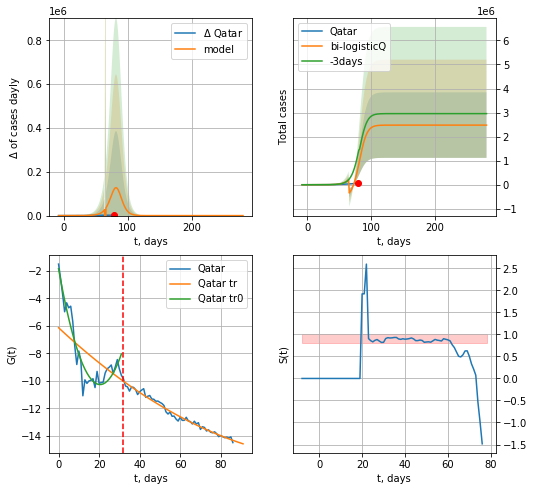

Qatar data at: 2020-05-31
+3 day model MAPE: 0.442294
model: bi-logisticQ
coeffs: [-5.84435849e+05  1.43352192e+02 -1.91149951e+02  6.57429147e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.549107
forecast at the end of period: +202 days
	 deltaDaycases: 0
	 total cases: 2478546 ± 1360986
	 total death: 1654 ± 2724
bi-logisticQ approximation splitting point: 32
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]
trend coefficient of determination: 0.979675
 intercept_: -6.131127340667176
 coeffs_: [ 0.         -0.13731829  0.00048887]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [340]:
vL=32
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*10-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


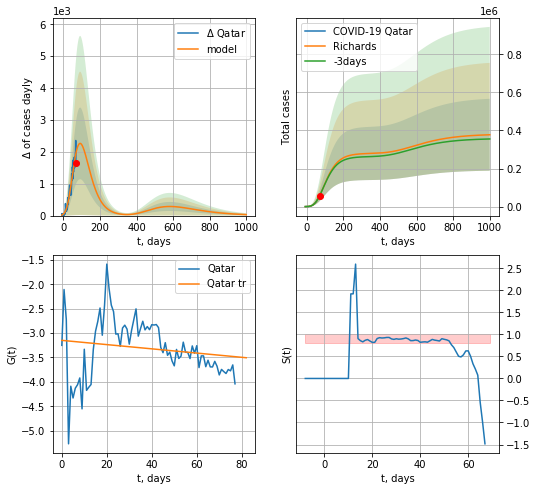

Qatar data at: 2020-05-31
+3 day model MAPE: 0.004663
model: Richards
coeffs: [ 2.80062530e+05  4.93380874e-01 -4.50111331e+01  4.55579216e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.500245
forecast at the end of period: +930 days
	 deltaDaycases: 30
	 total cases: 377545 ± 188865
	 total death: 252 ± 378
trend coefficient of determination: 0.027358
 intercept: -3.149992
 slope: -0.004341


In [341]:
x = forecastRR('Qatar',dfQR[9:].fillna(0),d1,142*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

In [342]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
102 2020-05-27  31969.0   15343  255.0
103 2020-05-28  32532.0   15589  258.0
104 2020-05-29  33170.0   15813  260.0
105 2020-05-30  33896.0   16088  262.0
106 2020-05-31  34557.0   16361  264.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


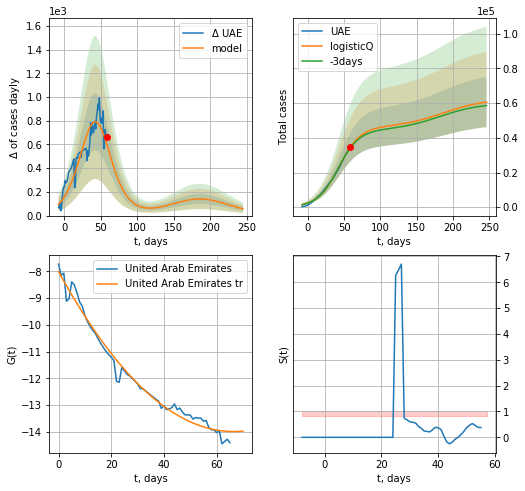

UAE data at: 2020-05-31
+3 day model MAPE: 0.013957
model: logisticQ
coeffs: [ 4.61081348e+04  1.26722796e-06  4.27130131e+01 -5.38442626e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.238626
forecast at the end of period: +188 days
	 deltaDaycases: 57
	 total cases: 60583 ± 14456
	 total death: 462 ± 330
trend coefficient of determination: 0.980769
 intercept_: -8.010648990632317
 coeffs_: [ 0.         -0.18006865  0.00135591]


In [343]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


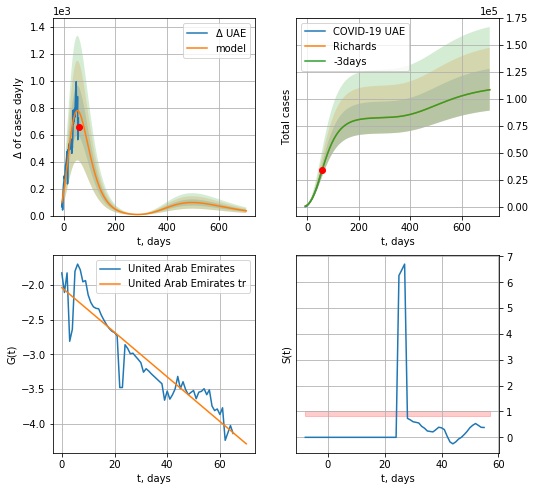

UAE data at: 2020-05-31
+3 day model MAPE: 0.000219
model: Richards
coeffs: [ 8.29112194e+04  1.50486098e+00 -1.04871784e+02  1.71188496e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.178407
forecast at the end of period: +650 days
	 deltaDaycases: 35
	 total cases: 108588 ± 19372
	 total death: 829 ± 443
trend coefficient of determination: 0.861020
 intercept: -2.040753
 slope: -0.032054


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


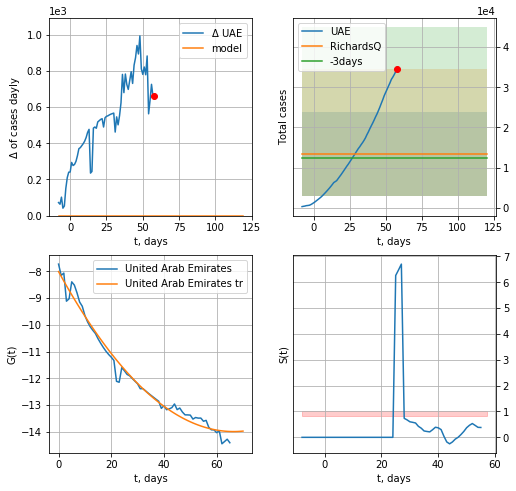

UAE data at: 2020-05-31
+3 day model MAPE: 0.077148
model: RichardsQ
coeffs: [ 1.33999403e+04 -6.30375804e+00 -8.06918632e+02  6.25822742e+02
  1.42771291e-02]
rational stdev: 0.786269
forecast at the end of period: +62 days
	 deltaDaycases: 0
	 total cases: 13399 ± 10535
	 total death: 102 ± 240
trend coefficient of determination: 0.980769
 intercept_: -8.010648990632317
 coeffs_: [ 0.         -0.18006865  0.00135591]


In [344]:
x = forecastRR('UAE',dfUAE[40:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [345]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
          date    cases  active  death
85 2020-05-27  78541.0   27094  425.0
86 2020-05-28  80185.0   25191  441.0
87 2020-05-29  81766.0   24295  458.0
88 2020-05-30  83384.0   24021  480.0
89 2020-05-31  85261.0   22316  503.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


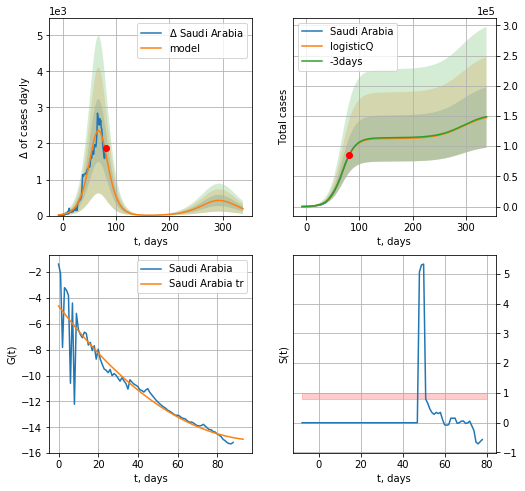

Saudi Arabia data at: 2020-05-31
+3 day model MAPE: 0.004530
model: logisticQ
coeffs: [ 1.12666516e+05  2.77303726e-06  6.73245168e+01 -3.01718156e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338826
forecast at the end of period: +258 days
	 deltaDaycases: 190
	 total cases: 147462 ± 49964
	 total death: 869 ± 883
trend coefficient of determination: 0.882055
 intercept_: -4.616284644214181
 coeffs_: [ 0.         -0.20153479  0.00097591]


In [346]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,46*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


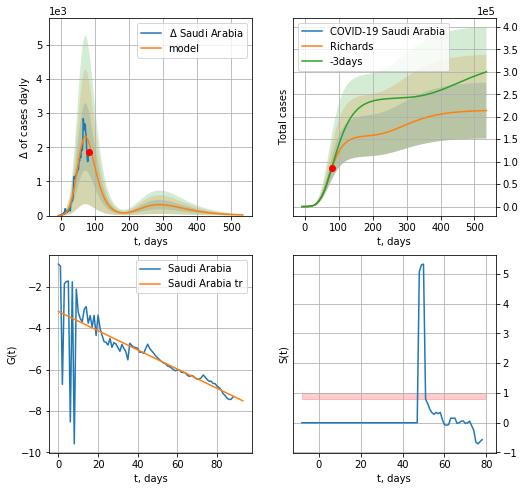

Saudi Arabia data at: 2020-05-31
+3 day model MAPE: 0.032689
model: Richards
coeffs: [1.57830960e+05 1.47996044e-01 4.61232253e+01 3.09074145e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.290213
forecast at the end of period: +454 days
	 deltaDaycases: 19
	 total cases: 213809 ± 62050
	 total death: 1261 ± 1097
trend coefficient of determination: 0.551278
 intercept: -3.197673
 slope: -0.046394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


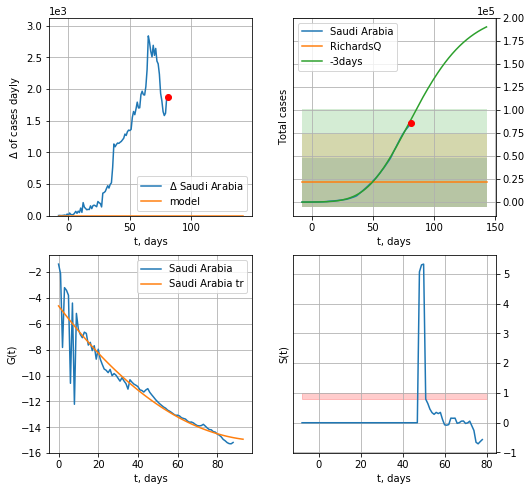

Saudi Arabia data at: 2020-05-31
+3 day model MAPE: 0.765621
model: RichardsQ
coeffs: [ 2.14972226e+04  8.40243632e+00 -1.17746185e+03  1.01844687e+03
 -2.75491558e+00]
rational stdev: 1.227218
forecast at the end of period: +62 days
	 deltaDaycases: 0
	 total cases: 21497 ± 26381
	 total death: 126 ± 463
trend coefficient of determination: 0.882055
 intercept_: -4.616284644214181
 coeffs_: [ 0.         -0.20153479  0.00097591]


In [347]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,74*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date   cases  active  death
78 2020-05-27  1469.0     727   10.0
79 2020-05-28  1530.0     775   10.0
80 2020-05-29  1558.0     794   10.0
81 2020-05-30  1620.0     829   10.0
82 2020-05-31  1633.0     821   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


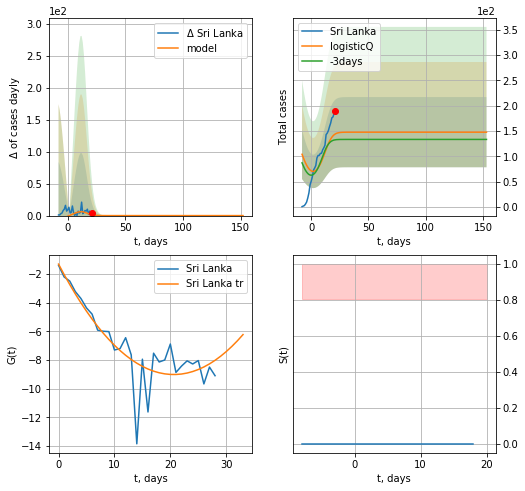

Sri Lanka data at: 2020-05-31
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +132 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


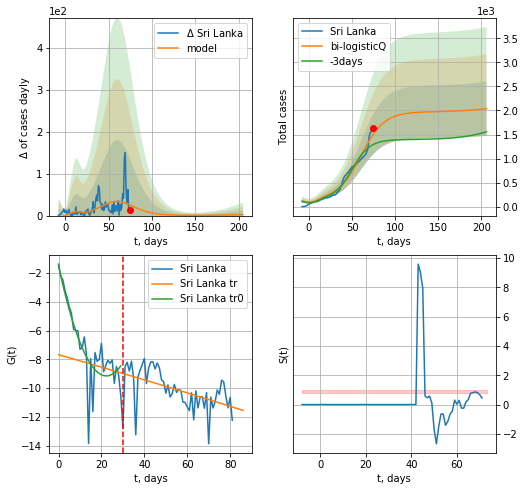

Sri Lanka data at: 2020-05-31
+3 day model MAPE: 0.169676
model: bi-logisticQ
coeffs: [ 1.82190028e+03  5.31754487e-07  6.02433863e+01 -1.40294965e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.277767
forecast at the end of period: +132 days
	 deltaDaycases: 2
	 total cases: 2038 ± 566
	 total death: 13 ± 10
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.253326
 intercept_: -7.6824386525232295
 coeffs_: [ 0.00000000e+00 -4.24747411e-02 -2.88602013e-05]


In [348]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


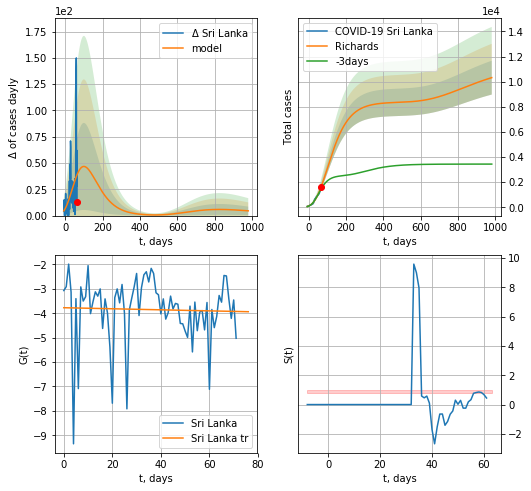

Sri Lanka data at: 2020-05-31
+3 day model MAPE: 0.098924
model: Richards
coeffs: [ 8.37105639e+03  5.93545439e-01 -1.37782940e+02  2.59077595e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.130463
forecast at the end of period: +916 days
	 deltaDaycases: 4
	 total cases: 10319 ± 1346
	 total death: 69 ± 27
trend coefficient of determination: 0.001105
 intercept: -3.772308
 slope: -0.002154


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


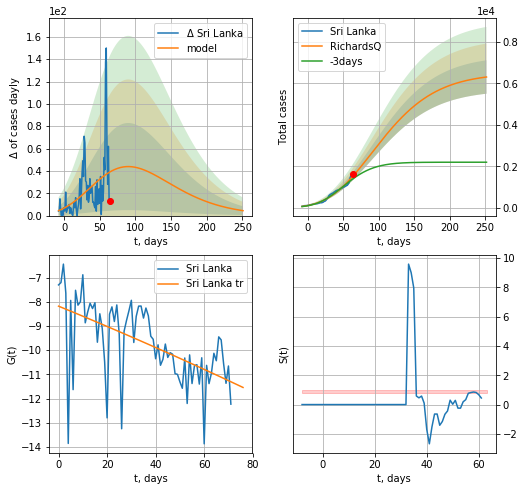

Sri Lanka data at: 2020-05-31
+3 day model MAPE: 0.103801
model: RichardsQ
coeffs: [ 6.48726583e+03  1.87314862e-03 -3.30801440e+02 -5.82117483e+02
  9.06391642e-03]
rational stdev: 0.127739
forecast at the end of period: +188 days
	 deltaDaycases: 4
	 total cases: 6303 ± 805
	 total death: 42 ± 16
trend coefficient of determination: 0.321298
 intercept_: -8.18017678446934
 coeffs_: [ 0.00000000e+00 -4.10961220e-02 -4.10239287e-05]


In [349]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,140*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
          date    cases  active   death
90 2020-05-27  61227.0   39736  1260.0
91 2020-05-28  64028.0   40406  1317.0
92 2020-05-29  66457.0   40931  1395.0
93 2020-05-30  69496.0   42742  1483.0
94 2020-05-31  72460.0   44834  1543.0


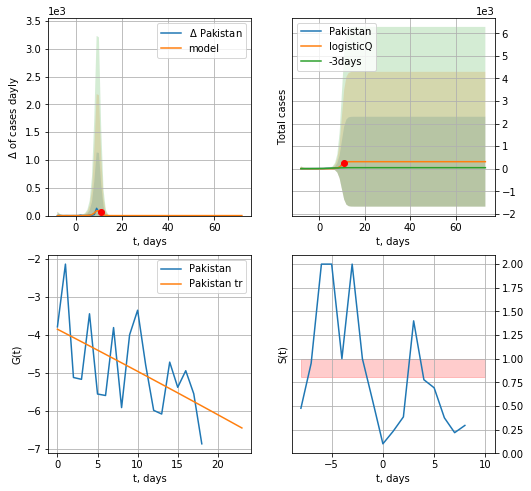

Pakistan data at: 2020-05-31
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +62 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


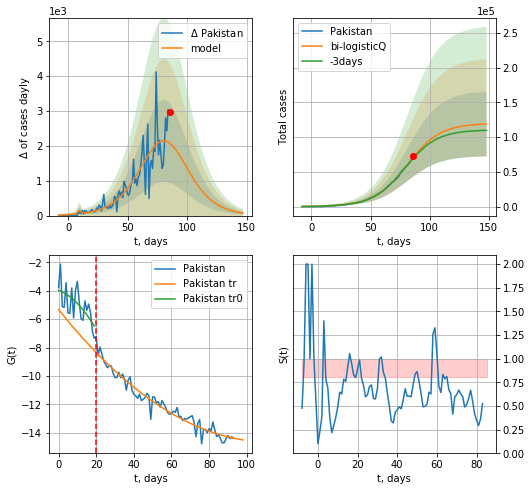

Pakistan data at: 2020-05-31
+3 day model MAPE: 0.021525
model: bi-logisticQ
coeffs: [ 1.19648204e+05  3.81908640e-06  8.09393927e+01 -1.86946016e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.391718
forecast at the end of period: +62 days
	 deltaDaycases: 71
	 total cases: 119033 ± 46627
	 total death: 2534 ± 2977
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.951856
 intercept_: -5.322701655761806
 coeffs_: [ 0.         -0.1663155   0.00074114]


In [350]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


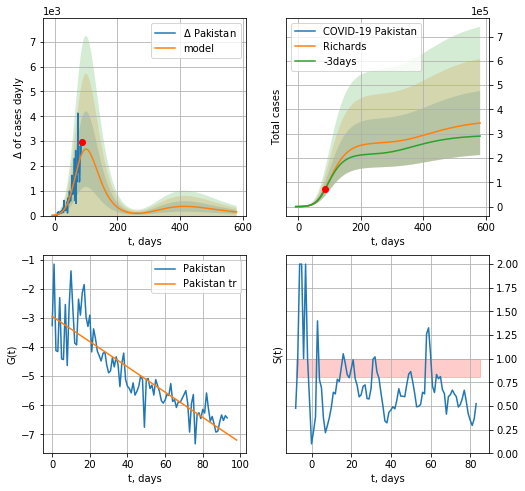

Pakistan data at: 2020-05-31
+3 day model MAPE: 0.006619
model: Richards
coeffs: [2.63290778e+05 1.09003376e-01 6.11447684e+01 2.89503665e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.383119
forecast at the end of period: +496 days
	 deltaDaycases: 144
	 total cases: 344185 ± 131863
	 total death: 7329 ± 8423
trend coefficient of determination: 0.760652
 intercept: -2.944397
 slope: -0.043410


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


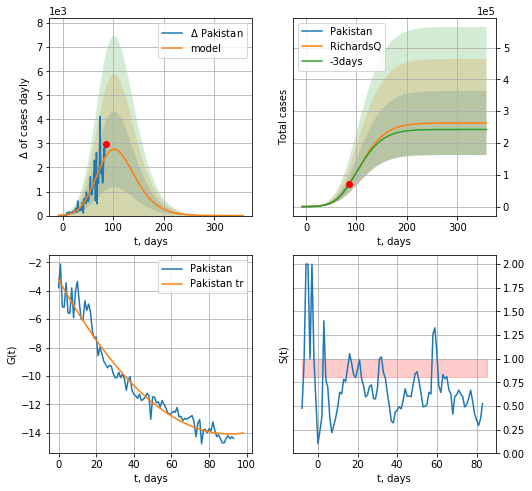

Pakistan data at: 2020-05-31
+3 day model MAPE: 0.003019
model: RichardsQ
coeffs: [ 2.62963849e+05  1.40019973e-03 -1.43219744e+02 -9.21553032e+01
  4.80112129e-02]
rational stdev: 0.382966
forecast at the end of period: +272 days
	 deltaDaycases: 0
	 total cases: 262962 ± 100705
	 total death: 5599 ± 6432
trend coefficient of determination: 0.957698
 intercept_: -3.215295832391506
 coeffs_: [ 0.         -0.23892932  0.00131343]


In [351]:
x = forecastRR('Pakistan',dfPS[:],d1,80*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
          date    cases  active  death
80 2020-05-27  38292.0   29823  544.0
81 2020-05-28  40321.0   31337  559.0
82 2020-05-29  42844.0   33247  582.0
83 2020-05-30  44608.0   34623  610.0
84 2020-05-31  47153.0   36722  650.0


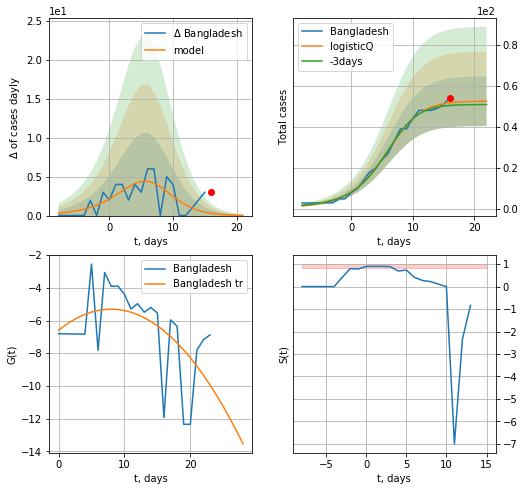

Bangladesh data at: 2020-05-31
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp


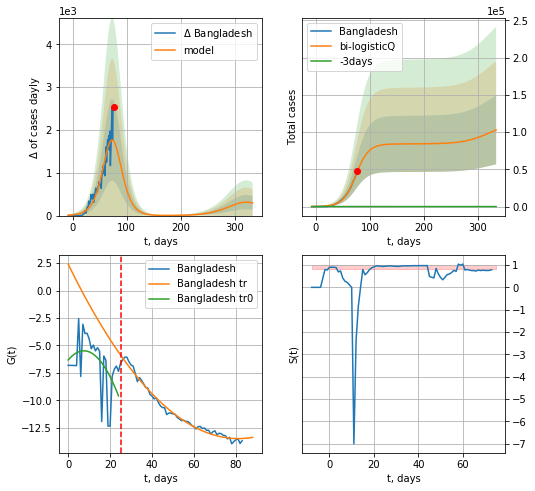

Bangladesh data at: 2020-05-31
+3 day model MAPE: 483.628020
model: bi-logisticQ
coeffs: [ 8.40596900e+04  3.52747248e-06  7.37640001e+01 -2.37576921e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.448133
forecast at the end of period: +258 days
	 deltaDaycases: 294
	 total cases: 102832 ± 46082
	 total death: 1417 ± 1905
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.985902
 intercept_: 2.410574677267883
 coeffs_: [ 0.         -0.39169873  0.00241299]


In [352]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,10*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,46*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


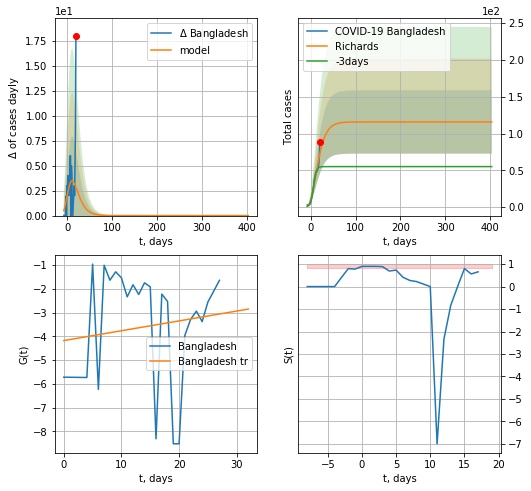

Bangladesh data at: 2020-05-31
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +384 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


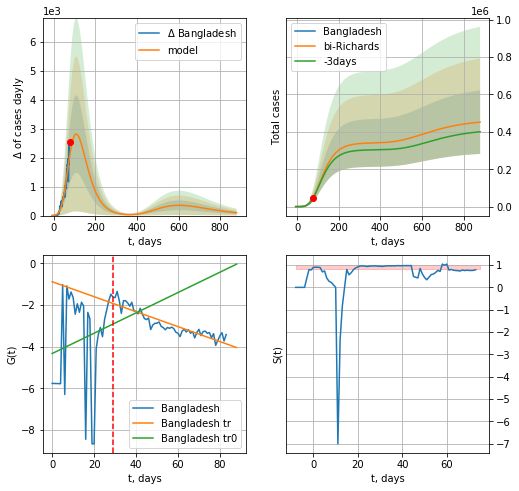

Bangladesh data at: 2020-05-31
+3 day model MAPE: 0.015780
model: bi-Richards
coeffs: [ 3.41417740e+05  4.98485726e-01 -2.60204230e+01  4.60275350e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.375904
forecast at the end of period: +804 days
	 deltaDaycases: 98
	 total cases: 452007 ± 169911
	 total death: 6230 ± 7025
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.031083
 intercept: -4.324994
 slope: 0.048724
trend coefficient of determination: 0.823987
 intercept: -0.881438
 slope: -0.035894


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


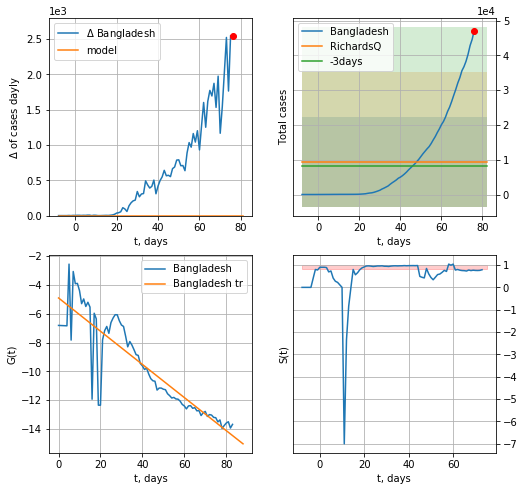

Bangladesh data at: 2020-05-31
+3 day model MAPE: 0.159233
model: RichardsQ
coeffs: [ 9.43696709e+03  1.13464784e+00 -1.16949212e+02  1.06783695e+02
 -2.49810257e-01]
rational stdev: 1.368879
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 9436 ± 12918
	 total death: 130 ± 533
trend coefficient of determination: 0.795994
 intercept_: -4.901533212562134
 coeffs_: [ 0.00000000e+00 -1.15661521e-01  6.26389130e-06]


In [353]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,124*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,10*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
          date    cases  active  death
93 2020-05-27  23267.0   15146  175.0
94 2020-05-28  24112.0   15229  185.0
95 2020-05-29  25184.0   15717  194.0
96 2020-05-30  26192.0   15831  205.0
97 2020-05-31  27043.0   15445  212.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


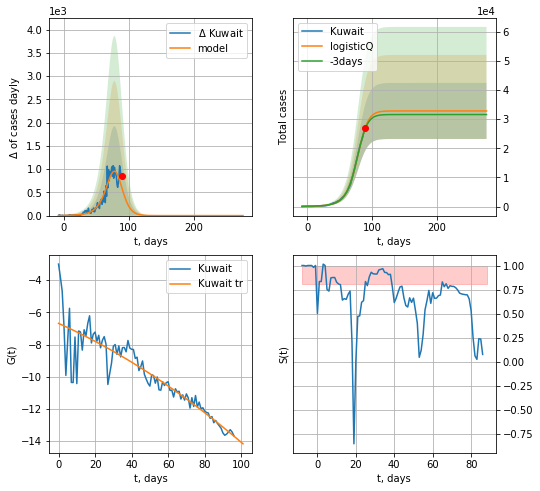

Kuwait data at: 2020-05-31
+3 day model MAPE: 0.015809
model: logisticQ
coeffs: [ 3.28080743e+04  5.73384205e-04  7.69651597e+01 -1.24531208e+02]
rational stdev: 0.292785
forecast at the end of period: +188 days
	 deltaDaycases: 0
	 total cases: 32808 ± 9605
	 total death: 257 ± 225
trend coefficient of determination: 0.814000
 intercept_: -6.686134714987848
 coeffs_: [ 0.         -0.05121209 -0.00022652]


In [354]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

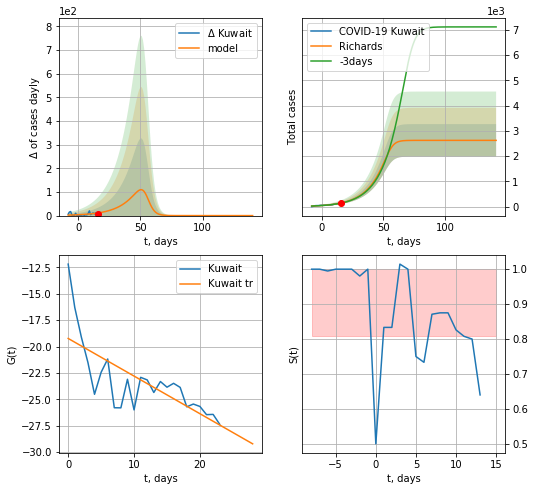

Kuwait data at: 2020-05-31
+3 day model MAPE: 0.021195
model: Richards
coeffs: [2.62618295e+03 7.26706329e-02 5.55128378e+01 4.83394479e+00]
rational stdev: 0.245134
forecast at the end of period: +125 days
	 deltaDaycases: 0
	 total cases: 2626 ± 643
	 total death: 20 ± 14
trend coefficient of determination: 0.533266
 intercept: -19.235922
 slope: -0.356305


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


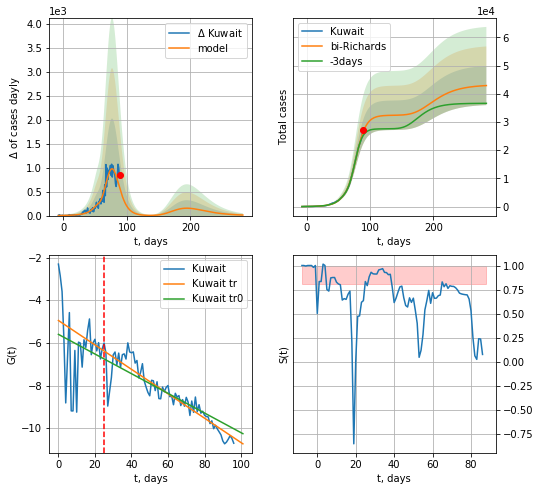

Kuwait data at: 2020-05-31
+3 day model MAPE: 0.058572
model: bi-Richards
coeffs: [2.97834832e+04 1.68252264e-01 7.41949556e+01 7.10111490e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.161515
forecast at the end of period: +195 days
	 deltaDaycases: 11
	 total cases: 42922 ± 6932
	 total death: 336 ± 162
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.037249
 intercept: -5.601884
 slope: -0.046098
trend coefficient of determination: 0.837105
 intercept: -4.951703
 slope: -0.057244


In [355]:
vL = 25
x = forecastRR('Kuwait',dfKW[:vL],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[:],d1,37*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

DM
          date    cases  active  death
87 2020-05-27  15723.0    6459  474.0
88 2020-05-28  16068.0    6631  485.0
89 2020-05-29  16531.0    6777  488.0
90 2020-05-30  16908.0    6853  498.0
91 2020-05-31  17285.0    6224  502.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


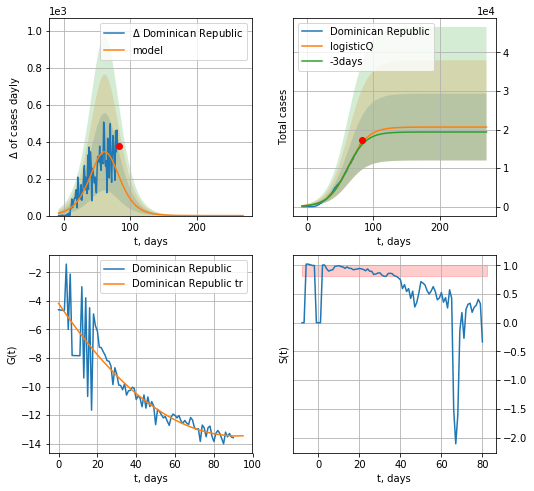

Dominican Republic data at: 2020-05-31
+3 day model MAPE: 0.029593
model: logisticQ
coeffs: [ 2.06407251e+04  7.65513781e-07  6.19681981e+01 -8.73859085e+04]
rational stdev: 0.419776
forecast at the end of period: +188 days
	 deltaDaycases: 0
	 total cases: 20640 ± 8664
	 total death: 599 ± 754
trend coefficient of determination: 0.839576
 intercept_: -4.174552851284496
 coeffs_: [ 0.         -0.2019191   0.00109751]


In [356]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


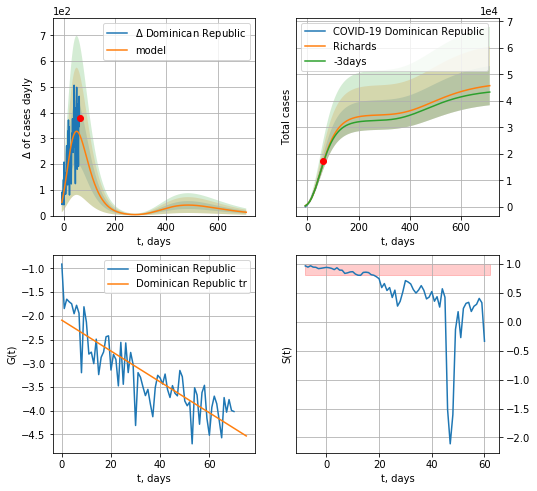

Dominican Republic data at: 2020-05-31
+3 day model MAPE: 0.011378
model: Richards
coeffs: [ 3.47174974e+04  1.32343237e+00 -1.01751327e+02  1.95567880e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.161515
forecast at the end of period: +650 days
	 deltaDaycases: 13
	 total cases: 45727 ± 7385
	 total death: 1328 ± 643
trend coefficient of determination: 0.712124
 intercept: -2.093214
 slope: -0.032500


In [357]:
x = forecastRR('Dominican Republic',dfDM[20:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [12]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=15:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"ActiveCases"
9:"Serious,Critical"
10:"Tot Cases/1M pop"
11:"Deaths/1M pop"
12:"TotalTests"
13:"Tests/
1M pop
"
14:"Population"
15:"Continent"
[463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463]


In [13]:
df.head(10)
#df.columns[18]

,#,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,"1,205,755",North America,\nNorth America\n,,"+3,872",171,,"19,376",,"2,070,299","124,899","739,645",,
1,,"485,681",South America,\nSouth America\n,,533,30,,"11,321",,"878,477","40,111","352,685",,
2,,"858,975",Europe,\nEurope\n,,,,,"8,766",,"2,019,781","173,726","987,080",,
3,,"413,804",Asia,\nAsia\n,,"+3,558",63,,"13,593",,"1,140,355","30,840","695,711",,
4,,"81,150",Africa,\nAfrica\n,,189,,,344,,"148,964","4,245","63,569",,
5,,486,Australia/Oceania,\nOceania\n,,7,,,3,,"8,811",125,"8,200",,
6,,55,,\n\n,,,,,4,,721,15,651,,
7,,"3,045,906",All,World,48.0,"+8,159",264,,"53,407",,"6,267,408","373,961","2,847,541",,804
8,1,"1,131,108",North America,USA,321,,,"330,843,477","17,075","53,417","1,837,170","106,195","599,867","17,672,567","5,553"
9,2,"279,096",South America,Brazil,138,143,27,"212,434,518","8,318","4,378","514,992","29,341","206,555","930,013","2,424"


In [14]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,"1,205,755",North America,\nNorth America\n,,"+3,872",171,,"19,376",,"2,070,299","124,899","739,645",,
1,,"485,681",South America,\nSouth America\n,,533,30,,"11,321",,"878,477","40,111","352,685",,
2,,"858,975",Europe,\nEurope\n,,,,,"8,766",,"2,019,781","173,726","987,080",,
3,,"413,804",Asia,\nAsia\n,,"+3,558",63,,"13,593",,"1,140,355","30,840","695,711",,
4,,"81,150",Africa,\nAfrica\n,,189,,,344,,"148,964","4,245","63,569",,


In [15]:
df[df["Country"]=="Lithuania"]

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
103,96,369,Europe,Lithuania,26,,,"2,725,022",17,"111,140","1,675",70,"1,236","302,859",615
336,97,369,Europe,Lithuania,26,5,,"2,725,022",17,"111,140","1,675",70,"1,236","302,859",615


In [16]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [17]:
df.head(30)

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,"1,205,755",North America,\nNorth America\n,,"+3,872",171,,"19,376",,"2,070,299","124,899","739,645",,
1,,"485,681",South America,\nSouth America\n,,533,30,,"11,321",,"878,477","40,111","352,685",,
2,,"858,975",Europe,\nEurope\n,,,,,"8,766",,"2,019,781","173,726","987,080",,
3,,"413,804",Asia,\nAsia\n,,"+3,558",63,,"13,593",,"1,140,355","30,840","695,711",,
4,,"81,150",Africa,\nAfrica\n,,189,,,344,,"148,964","4,245","63,569",,
5,,486,Australia/Oceania,\nOceania\n,,7,,,3,,"8,811",125,"8,200",,
6,,55,,\n\n,,,,,4,,721,15,651,,
7,,"3,045,906",All,World,48.0,"+8,159",264,,"53,407",,"6,267,408","373,961","2,847,541",,804
8,1,"1,131,108",North America,USA,321,,,"330,843,477","17,075","53,417","1,837,170","106,195","599,867","17,672,567","5,553"
9,2,"279,096",South America,Brazil,138,143,27,"212,434,518","8,318","4,378","514,992","29,341","206,555","930,013","2,424"


In [18]:
df.at[12, 'TotalRecovered'] = 0
df.at[28, 'TotalRecovered'] = 0
df.at[12,"ActiveCases"] = 0
df.at[28,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [19]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,1205755,North America,\nNorth America\n,NaN,3872.0,171.0,,19376.0,NaN,2070299,124899.0,739645.0,NaN,NaN
1,,485681,South America,\nSouth America\n,NaN,533.0,30.0,,11321.0,NaN,878477,40111.0,352685.0,NaN,NaN
2,,858975,Europe,\nEurope\n,NaN,NaN,NaN,,8766.0,NaN,2019781,173726.0,987080.0,NaN,NaN
3,,413804,Asia,\nAsia\n,NaN,3558.0,63.0,,13593.0,NaN,1140355,30840.0,695711.0,NaN,NaN
4,,81150,Africa,\nAfrica\n,NaN,189.0,NaN,,344.0,NaN,148964,4245.0,63569.0,NaN,NaN
5,,486,Australia/Oceania,\nOceania\n,NaN,7.0,NaN,,3.0,NaN,8811,125.0,8200.0,NaN,NaN
6,,55,,\n\n,NaN,NaN,NaN,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,3045906,All,World,48.0,8159.0,264.0,,53407.0,NaN,6267408,373961.0,2847541.0,NaN,804.0
8,1,1131108,North America,USA,321.0,NaN,NaN,"330,843,477",17075.0,53417.0,1837170,106195.0,599867.0,17672567.0,5553.0
9,2,279096,South America,Brazil,138.0,143.0,27.0,"212,434,518",8318.0,4378.0,514992,29341.0,206555.0,930013.0,2424.0


In [20]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,413804,Asia,Total:,NaN,3558.0,63.0,,13593.0,NaN,1140355,30840.0,695711.0,NaN,NaN
227,,81150,Africa,Total:,NaN,189.0,NaN,,344.0,NaN,148964,4245.0,63569.0,NaN,NaN
228,,486,Australia/Oceania,Total:,NaN,7.0,NaN,,3.0,NaN,8811,125.0,8200.0,NaN,NaN
229,,55,,Total:,NaN,NaN,NaN,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,306069,Europe,European Union,283.927802,0.0,0.0,NaN,4209.0,45936.441075,1204043,126419.0,731069.0,20453224.0,2704.192274


In [21]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,1205755,North America,North America,NaN,3872.0,171.0,,19376.0,NaN,2070299,124899.0,739645.0,NaN,NaN
1,,485681,South America,South America,NaN,533.0,30.0,,11321.0,NaN,878477,40111.0,352685.0,NaN,NaN
2,,858975,Europe,Europe,NaN,NaN,NaN,,8766.0,NaN,2019781,173726.0,987080.0,NaN,NaN
3,,413804,Asia,Asia,NaN,3558.0,63.0,,13593.0,NaN,1140355,30840.0,695711.0,NaN,NaN
4,,81150,Africa,Africa,NaN,189.0,NaN,,344.0,NaN,148964,4245.0,63569.0,NaN,NaN


In [22]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [23]:
#df

In [24]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,1205755,North America,North America,NaN,3872.0,171.0,,19376.0,NaN,2070299,124899.0,739645.0,NaN,NaN
1,,485681,South America,South America,NaN,533.0,30.0,,11321.0,NaN,878477,40111.0,352685.0,NaN,NaN
2,,858975,Europe,Europe,NaN,NaN,NaN,,8766.0,NaN,2019781,173726.0,987080.0,NaN,NaN
3,,413804,Asia,Asia,NaN,3558.0,63.0,,13593.0,NaN,1140355,30840.0,695711.0,NaN,NaN
4,,81150,Africa,Africa,NaN,189.0,NaN,,344.0,NaN,148964,4245.0,63569.0,NaN,NaN
5,,486,Australia/Oceania,Oceania,NaN,7.0,NaN,,3.0,NaN,8811,125.0,8200.0,NaN,NaN
7,,3045906,All,World,48.0,8159.0,264.0,,53407.0,NaN,6267408,373961.0,2847541.0,NaN,804.0
8,1,1131108,North America,USA,321.0,NaN,NaN,"330,843,477",17075.0,53417.0,1837170,106195.0,599867.0,17672567.0,5553.0
9,2,279096,South America,Brazil,138.0,143.0,27.0,"212,434,518",8318.0,4378.0,514992,29341.0,206555.0,930013.0,2424.0
10,3,229267,Europe,Russia,32.0,NaN,NaN,"145,929,507",2300.0,72933.0,405843,4693.0,171883.0,10643124.0,2781.0


In [25]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [26]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Slovenia SV
Morocco MR
Serbia SB
Dominican Republic DM
Argentina AG
New Zealand ZL
Slovakia SL
Panama PM
Australia AS
Pakistan PS
UAE UAE
Poland PL
Singapore SG
Turkey TR
Ukraine Ukr
Spain SP
Brazil BZ
Colombia CB
Bulgaria BL
Saudi Arabia SA
Iran IN
Malaysia ML
S. Korea KR
Estonia ES
Ecuador ED
Croatia CT
Denmark DK
Norway NG
China CN
Iraq IQ
France FR
Sweden SW
India ID
Belarus BR
Latvia LV
World World
USA US
Malta MT
Qatar QR
Czechia CH
Belgium BG
Kuwait KW
Switzerland SZ
Sri Lanka Sri
Luxembourg LX
Germany GR
Romania RM
Finland FI
Philippines PH
Hungary HG
Thailand TH
Cyprus CP
Israel IS
Lithuania LT
Japan JP
European Union EU
Canada CA
Italy IT
Portugal PT
Russia RS
UK GB
Algeria AR
Mexico MX
Egypt EG
Indonesia IE
Peru PU
Ireland IR
Austria AT
Netherlands NL
Greece GC
Chile CL
Iceland IC
Bangladesh BN


In [27]:
len(countryDic)

73

In [28]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-05-31,2070299,1205755,124899.0
South America
South America 2020-05-31,878477,485681,40111.0
Europe
Europe 2020-05-31,2019781,858975,173726.0
Asia
Asia 2020-05-31,1140355,413804,30840.0
Africa
Africa 2020-05-31,148964,81150,4245.0
Oceania
Oceania 2020-05-31,8811,486,125.0
World
World 2020-05-31,6267408,3045906,373961.0
USA
USA 2020-05-31,1837170,1131108,106195.0
Brazil
Brazil 2020-05-31,514992,279096,29341.0
Russia
Russia 2020-05-31,405843,229267,4693.0
Spain
Spain 2020-05-31,286509,62424,27127.0
UK
UK 2020-05-31,274762,0,38489.0
Italy
Italy 2020-05-31,232997,42075,33415.0
India
India 2020-05-31,190622,93359,5408.0
France
France 2020-05-31,188882,91725,28802.0
Germany
Germany 2020-05-31,183494,9689,8605.0
Peru
Peru 2020-05-31,164476,92762,4506.0
Turkey
Turkey 2020-05-31,163942,31429,4540.0
Iran
Iran 2020-05-31,151466,24821,7797.0
Chile
Chile 2020-05-31,99688,55907,1054.0
Canada
Canada 2020-05-31,90947,34773,7295.0
Mexico
Mexico 2020-05-31,90664,16408,993

Turks and Caicos
Turks and Caicos 2020-05-31,12,0,1.0
Vatican City
Vatican City 2020-05-31,12,10,nan
Montserrat
Montserrat 2020-05-31,11,0,1.0
Seychelles
Seychelles 2020-05-31,11,0,nan
MS Zaandam
MS Zaandam 2020-05-31,9,7,2.0
Western Sahara
Western Sahara 2020-05-31,9,2,1.0
British Virgin Islands
British Virgin Islands 2020-05-31,8,0,1.0
Papua New Guinea
Papua New Guinea 2020-05-31,8,0,nan
Caribbean Netherlands
Caribbean Netherlands 2020-05-31,6,0,nan
St. Barth
St. Barth 2020-05-31,6,0,nan
Anguilla
Anguilla 2020-05-31,3,0,nan
Lesotho
Lesotho 2020-05-31,2,1,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-05-31,1,0,nan
China
China 2020-05-31,83017,76,4634.0
Total:
Total: 2020-05-31,2070299,1205755,124899.0
Total:
Total: 2020-05-31,2070299,1205755,124899.0
Total:
Total: 2020-05-31,2070299,1205755,124899.0
Total:
Total: 2020-05-31,2070299,1205755,124899.0
Total:
Total: 2020-05-31,2070299,1205755,124899.0
Total:
Total: 2020-05-31,2070299,1205755,124899.0
Total:
Total: 2020-05-31,207029

In [29]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [30]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaSV.csv 2020-05-31,1473,7,108.0

append data/coronaMR.csv 2020-05-31,7807,2143,205.0

append data/coronaSB.csv 2020-05-31,11412,4471,243.0

append data/coronaDM.csv 2020-05-31,17285,6224,502.0

append data/coronaAG.csv 2020-05-31,16851,10976,539.0

append data/coronaZL.csv 2020-05-31,1504,1,22.0

append data/coronaSL.csv 2020-05-31,1521,127,28.0

append data/coronaPM.csv 2020-05-31,13463,3613,336.0

append data/coronaAS.csv 2020-05-31,7202,481,103.0

append data/coronaPS.csv 2020-05-31,72460,44834,1543.0

append data/coronaUAE.csv 2020-05-31,34557,16361,264.0

append data/coronaPL.csv 2020-05-31,23786,11451,1064.0

append data/coronaSG.csv 2020-05-31,34884,13162,23.0

append data/coronaTR.csv 2020-05-31,163942,31429,4540.0

append data/coronaUkr.csv 2020-05-31,23672,13426,708.0

append data/coronaSP.csv 2020-05-31,286509,62424,27127.0

append data/coronaBZ.csv 2020-05-31,514992,279096,29341.0

append data/coronaCB.csv 2020-05-31,29383,19901,939.0

append data/coronaBL.

In [21]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [22]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

FileNotFoundError: [Errno 2] File b'europa_corona.csv' does not exist: b'europa_corona.csv'

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [364]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

73588073.0 9461.539935198518


In [365]:
TT/7.7776e3

9461.539935198518

In [366]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

41267.80412880107

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [367]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

41042.88131153061

In [368]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [369]:
#dfAll

In [370]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

9765.488323996455

In [371]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait","Dominican Republic"
]

In [372]:
len(CList)

69

In [373]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

4078403521

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400